# Initialization

In [1]:
sc.addFile("s3://mist-production-jupyterhub-notebooks/jupyter/mayzarl@juniper.net/utils.py")
from utils import *

Starting Spark application


The code failed because of a fatal error:
	Session 286 unexpectedly reached final status 'dead'. See logs:
stdout: 

stderr: 
SLF4J: Class path contains multiple SLF4J bindings.
SLF4J: Found binding in [jar:file:/usr/lib/spark/jars/slf4j-log4j12-1.7.30.jar!/org/slf4j/impl/StaticLoggerBinder.class]
SLF4J: Found binding in [jar:file:/usr/share/aws/emr/emrfs/lib/slf4j-log4j12-1.7.12.jar!/org/slf4j/impl/StaticLoggerBinder.class]
SLF4J: Found binding in [jar:file:/usr/share/aws/redshift/jdbc/redshift-jdbc42-1.2.37.1061.jar!/org/slf4j/impl/StaticLoggerBinder.class]
SLF4J: See http://www.slf4j.org/codes.html#multiple_bindings for an explanation.
SLF4J: Actual binding is of type [org.slf4j.impl.Log4jLoggerFactory]
22/06/07 20:33:18 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable
22/06/07 20:33:19 INFO RMProxy: Connecting to ResourceManager at ip-172-31-18-8.us-west-1.compute.internal/172.31.18.8:8032
22/06/07 20:33:19

In [2]:
%%local
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px

In [3]:
df_device= spark.read.parquet("s3://mist-secorapp-production/dimension/device")
df_device.printSchema()

The code failed because of a fatal error:
	Session 286 unexpectedly reached final status 'dead'. See logs:
stdout: 

stderr: 
SLF4J: Class path contains multiple SLF4J bindings.
SLF4J: Found binding in [jar:file:/usr/lib/spark/jars/slf4j-log4j12-1.7.30.jar!/org/slf4j/impl/StaticLoggerBinder.class]
SLF4J: Found binding in [jar:file:/usr/share/aws/emr/emrfs/lib/slf4j-log4j12-1.7.12.jar!/org/slf4j/impl/StaticLoggerBinder.class]
SLF4J: Found binding in [jar:file:/usr/share/aws/redshift/jdbc/redshift-jdbc42-1.2.37.1061.jar!/org/slf4j/impl/StaticLoggerBinder.class]
SLF4J: See http://www.slf4j.org/codes.html#multiple_bindings for an explanation.
SLF4J: Actual binding is of type [org.slf4j.impl.Log4jLoggerFactory]
22/06/07 20:33:18 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable
22/06/07 20:33:19 INFO RMProxy: Connecting to ResourceManager at ip-172-31-18-8.us-west-1.compute.internal/172.31.18.8:8032
22/06/07 20:33:19

In [ ]:
df_device.show()

In [4]:
for d in range(1,3):
    current_date = datetime.now() - timedelta(days=d)
    date = "{}".format(current_date.date())
    input_files = "s3://mist-secorapp-production/cv-sle-roaming-multipartition-v2/cv-sle-roaming-multipartition-v2-production/dt={}/hr=*/*.seq".format(date)
    roam_rdd= spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1]))
    df = spark.createDataFrame(roam_rdd).persist()
    print(date)
    df.agg(F.count("site_id").alias("total_event")).show(10,truncate=False)
    df.groupby("classifier").agg(F.count("site_id").alias("event_count")).sort(F.desc("event_count")).show(10,truncate=False)
    df.unpersist()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

2022-04-11
+-----------+
|total_event|
+-----------+
|105796986  |
+-----------+

+---------------------------+-----------+
|classifier                 |event_count|
+---------------------------+-----------+
|                           |100126570  |
|signal-suboptimal-roam     |1905861    |
|signal-interband-roam      |1306410    |
|signal-sticky-client       |1202221    |
|latency-slow-roam          |636539     |
|stability-no-fast-roam     |583429     |
|latency-suboptimal-11r-roam|35956      |
+---------------------------+-----------+

DataFrame[ap_mac: string, band: string, classifier: string, classifier_code: bigint, classifier_rank: bigint, client_os: string, client_type: string, client_wcid: string, duration: bigint, en_client_sle_agg: bigint, ex_wl: bigint, latency: double, metric: string, metric_code: bigint, metric_rank: bigint, org_id: string, prev_ap_mac: string, prev_band: string, prev_rssi: bigint, reason: string, rssi: bigint, site_id: string, threshold: bigint, time: bi

# Get Site IDs

In [5]:
df_device_name = spark.read.parquet("s3://mist-secorapp-production/dimension/device")\
    .join(df_name,["org_id","site_id"]).select("org_id","org_name","site_id","site_id","site_name",F.col("mac").alias("ap_mac"),F.col("name").alias("ap_name"))
df_site_ap_count = df_device_name.groupby("org_id","org_name","site_id","site_name").agg(F.countDistinct("ap_mac").alias("total_ap")).persist()

df_site_ap_count.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+--------------------+--------------------+--------+
|              org_id|            org_name|             site_id|           site_name|total_ap|
+--------------------+--------------------+--------------------+--------------------+--------+
|2c6c1eaf-a5fc-458...|        Urban Mining|79cc1f9a-90c2-46f...|                  HQ|      13|
|a2ee8bba-43af-439...|          US - OTHER|34efbefc-b843-4c3...|               10657|      28|
|d9ca39f2-a2cd-40a...|             US - DC|9a10bc35-831f-47c...|          7006-OnGCP|     194|
|04263b80-a1f0-43b...|Charles Darwin Un...|6edf77f2-f2c5-4ff...|Katherine Rural K...|       3|
|5a578f3c-f094-4d1...|    AmazonOTN19-Prod|1fc5fa84-745e-4b7...|                DBE8|      49|
|39b04356-4cc3-41c...|              Meijer|e1096fd8-a291-4c5...|               ST217|      95|
|519dc383-1c8d-41b...|              TFORCE|f904b61a-6a45-4c1...|             USIADAN|       2|
|c14112b8-bec3-43e...|Fewstone Pty Ltd ...|60ad439

In [15]:
df_site_ap_count.filter((F.col("org_name").contains("Massachusetts Institute of Technology")) & (F.col("total_ap")>20)).sort(("total_ap")).show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------------------------------+-------------------------------------+------------------------------------+---------+--------+
|org_id                              |org_name                             |site_id                             |site_name|total_ap|
+------------------------------------+-------------------------------------+------------------------------------+---------+--------+
|0992350f-e897-4719-8671-010a7e4ebf9c|Massachusetts Institute of Technology|0d7dd77e-3fe8-4161-b800-61c5120f0534|TX       |21      |
|0992350f-e897-4719-8671-010a7e4ebf9c|Massachusetts Institute of Technology|aca8cc40-97a0-4fdd-a39e-703139e6fade|DKE      |21      |
|0992350f-e897-4719-8671-010a7e4ebf9c|Massachusetts Institute of Technology|75b73f0b-fdef-40fd-ae18-0e075488f987|E1       |21      |
|0992350f-e897-4719-8671-010a7e4ebf9c|Massachusetts Institute of Technology|1310c679-a3de-4d26-9b0b-3472b85e9437|TDC      |22      |
|0992350f-e897-4719-8671-010a7e4ebf9c|Massachusetts Institute of Tech

# Get Exp Flag from Redis

In [28]:
# get exp from redis

import redis,json

env = "production"
#env = "eu"
#env = "staging"

redis_server = "redis-proxy-rrm-{env}.mist.pvt".format(env=env)

connection_pool = redis.ConnectionPool(host=redis_server, port=6379)
redis_conn = redis.StrictRedis(connection_pool=connection_pool)
redis_conn.ping()


def getallList(keywords="orgs",field="experiment"):
        key = "rrm/all-{}-{}".format(field,keywords)
        print("Get {} from redis".format(key))
        data = redis_conn.smembers(key)
        return [i.decode('utf-8') for i in data]

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [36]:
exp_orgs = getallList(keywords="orgs")
exp_sites = getallList(keywords="sites")
print("Total orgs in exp >> {}".format(len(exp_orgs)))
print("Total sites in exp >> {}".format(len(exp_sites)))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

Get rrm/all-experiment-orgs from redis
Get rrm/all-experiment-sites from redis
Total orgs in exp >> 26
Total sites in exp >> 26

In [54]:
# checking exp sites. 
env = "production"
df_org= spark.read.parquet("s3://mist-secorapp-{}/dimension/org".format(env)).select(F.col("id").alias("org_id"),F.col("name").alias("org_name")).withColumn("exp_org", F.col("org_id").isin(exp_orgs))

df_site= spark.read.parquet("s3://mist-secorapp-{}/dimension/site".format(env)).select(F.col("id").alias("site_id"),F.col("name").alias("site_name"),"org_id").withColumn("exp_site", F.col("site_id").isin(exp_sites))

df_device_name = spark.read.parquet("s3://mist-secorapp-{}/dimension/device".format(env)).join(df_org,"org_id","inner").join(df_site,["org_id","site_id"])

df_select = df_device_name.groupby("org_name","site_name","site_id","org_id","exp_org","exp_site").agg(F.count("id").alias("ap_count"))\
            .withColumn("exp",F.col("exp_org") | F.col("exp_site"))
df_select.groupby("exp").agg(F.countDistinct("site_id")).show()
#df_select.sort(F.desc("ap_count")).show(10,truncate=False)



FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+-----+-----------------------+
|  exp|count(DISTINCT site_id)|
+-----+-----------------------+
| true|                   9120|
|false|                  24335|
+-----+-----------------------+

In [59]:
# all non exp sites and org in aws.
df_select.filter(~F.col("exp")).sort(F.desc("ap_count")).show(10,truncate=False)


site_ids = df_select.filter(~F.col("exp")).agg(F.collect_set("site_id").alias("site_ids")).collect()[0][0]
print("Total Sites {}".format(len(site_ids)))

org_ids = df_select.filter(~F.col("exp")).agg(F.collect_set("org_id").alias("org_ids")).collect()[0][0]
print("Total Org {}".format(len(org_ids)))
df_select.groupby("org_name","org_id").agg(F.countDistinct("site_id")).show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+-------------------------------------+-----------------------------+------------------------------------+------------------------------------+-------+--------+--------+-----+
|org_name                             |site_name                    |site_id                             |org_id                              |exp_org|exp_site|ap_count|exp  |
+-------------------------------------+-----------------------------+------------------------------------+------------------------------------+-------+--------+--------+-----+
|Massachusetts Institute of Technology|Main Campus                  |fdf1b743-a8cb-4227-a015-b3d587eb7caf|0992350f-e897-4719-8671-010a7e4ebf9c|false  |false   |2450    |false|
|NVIDIA Corp Wireless                 |Endeavor & Voyager           |cfeaeac2-2eb5-4a9d-92a9-435658ab5ffe|ec66b2e6-7108-4940-932c-74228ea0bf47|false  |false   |1319    |false|
|Corning Incorporated                 |SPZV - Cage                  |405fb2f8-aa66-455f-b326-84a38f1e8ada|1bc7fc2d-2def-

# RRM Migration

In [38]:
env = "production"
df_org= spark.read.parquet("s3://mist-secorapp-{}/dimension/org".format(env)).select(F.col("id").alias("org_id"),F.col("name").alias("org_name"))

df_site= spark.read.parquet("s3://mist-secorapp-{}/dimension/site".format(env)).select(F.col("id").alias("site_id"),F.col("name").alias("site_name"),"org_id")

df_device_name = spark.read.parquet("s3://mist-secorapp-{}/dimension/device".format(env)).join(df_org,"org_id","inner").join(df_site,["org_id","site_id"])

df_select = df_device_name.filter(F.col("org_name").contains("Amazon")).groupby("org_name","site_name","site_id","org_id").agg(F.count("id").alias("ap_count"))
df_select.sort(F.desc("ap_count")).show(10,truncate=False)
# | 
site_ids = df_select.agg(F.collect_set("site_id").alias("site_ids")).collect()[0][0]
print("Total Sites {}".format(len(site_ids)))

org_ids = df_select.agg(F.collect_set("org_id").alias("org_ids")).collect()[0][0]
print("Total Org {}".format(len(org_ids)))
df_select.groupby("org_name","org_id").agg(F.countDistinct("site_id")).show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+---------------+---------+------------------------------------+------------------------------------+--------+
|org_name       |site_name|site_id                             |org_id                              |ap_count|
+---------------+---------+------------------------------------+------------------------------------+--------+
|AmazonOTFC-Prod|SYR1     |f6144ffe-4731-488a-b20c-429984e3e314|56de201d-e63b-4312-9858-40f4cfe35c7f|3554    |
|AmazonOTFC-Prod|JAN1     |6dc4aa35-0f78-4f76-aa96-15d674ea5962|56de201d-e63b-4312-9858-40f4cfe35c7f|2360    |
|AmazonOTFC-Prod|OXR1     |3dae4981-b4cc-4b0b-838c-4972aa59b7c5|56de201d-e63b-4312-9858-40f4cfe35c7f|2002    |
|AmazonOTFC-Prod|TPA4     |64247487-ee12-45bb-93c8-c78e9e6d06ed|56de201d-e63b-4312-9858-40f4cfe35c7f|1987    |
|AmazonOTFC-Prod|ORD5     |fa5d74cf-6882-4681-8623-4bc7152d0ec2|56de201d-e63b-4312-9858-40f4cfe35c7f|1577    |
|AmazonOTFC-Prod|YOW3     |948b9b51-b56f-4c9d-87bf-5cc532ff0112|56de201d-e63b-4312-9858-40f4cfe35c7f|1572    |
|

In [46]:
site_ids = df_select.filter(F.col("ap_count") > 1000).agg(F.collect_set("site_id").alias("site_ids")).collect()[0][0]
print("Total Sites {}".format(len(site_ids)))
site_ids

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

Total Sites 11

In [9]:
df_select.withColumn("exp",F.col("exp_org") | F.col("exp_site")).filter(F.col("exp")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+--------------------+--------------------+-------+--------+--------+----+
|            org_name|           site_name|             site_id|              org_id|exp_org|exp_site|ap_count| exp|
+--------------------+--------------------+--------------------+--------------------+-------+--------+--------+----+
| T-Mobile USA Retail|            04-08788|0dc63cd0-baa9-41e...|a8c903ae-e6d0-42a...|   true|   false|       5|true|
| T-Mobile USA Retail|            99-0294F|2ed2931e-2400-4a9...|a8c903ae-e6d0-42a...|   true|   false|       2|true|
| T-Mobile USA Retail|            52-08445|25f9c126-f0a9-44d...|a8c903ae-e6d0-42a...|   true|   false|       6|true|
| T-Mobile USA Retail|            53-07769|477a58e7-7b84-4e4...|a8c903ae-e6d0-42a...|   true|   false|       5|true|
| T-Mobile USA Retail|            18-0541E|eda79472-f7b1-44a...|a8c903ae-e6d0-42a...|   true|   false|       5|true|
| T-Mobile USA Retail|            53-07532|b9b8dc8d-2798-458...|

In [39]:
## Get site config from papi
import requests
import time,json
from requests.adapters import HTTPAdapter
from urllib3.util.retry import Retry
def requests_retry_session(
        retries=3,
        backoff_factor=0.3,
        status_forcelist=(500, 502, 504),
        session=None,
):
    session = session or requests.Session()
    retry = Retry(
        total=retries,
        read=retries,
        connect=retries,
        backoff_factor=backoff_factor,
        status_forcelist=status_forcelist,
    )
    adapter = HTTPAdapter(max_retries=retry)
    session.mount('http://', adapter)
    session.mount('https://', adapter)
    return session

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [63]:
#env = "eu"
env = "production"
all_config_dict = {}
for band in ["5","24"]:
    all_config_dict[band] = {}


for site_id in site_ids:
    rrm_config = {}
    for band in ["24","5"]:
        query_url = "http://papi-{}.mist.pvt/internal/sites/{}/devices/rrm/{}?".format(env,site_id,band)
        headers={"X-FROM": "rrm-main"}
        response = requests_retry_session().get(query_url, params=None, headers=headers)
        rrm_config[band] = response.json()
        site_config = "band_24_usage={}, allow_rrm_disable={}".format(rrm_config[band].get(["band_24_usage"]),rrm_config[band].get(["allow_rrm_disable"]))
        if site_config in all_config_dict[band]:
            all_config_dict[band][site_config].append(site_id)
        else:
            all_config_dict[band][site_config] = [site_id]

print(len(all_config_dict))
#len(all_config_dict["24"])
#len(all_config_dict["5"])
#all_config_dict
#print(json.dumps(all_config,indent=2))
for k,site_config in all_config_dict.items():
    print("Band >> {}".format(k))
    for config,value in site_config.items():
        print("Config >> {}, number of sites = {}".format(config,len(value)))


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

An error was encountered:
unhashable type: 'list'
Traceback (most recent call last):
TypeError: unhashable type: 'list'



In [62]:
len(all_config_dict)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

2

In [40]:
# for each site get ch and power dist
import redis,json
from datetime import datetime,timedelta
env = "eu"

env = "production"
redis_server = "redis-proxy-rrm-{env}.mist.pvt".format(env=env)
connection_pool = redis.ConnectionPool(host=redis_server, port=6379)
redis_conn = redis.StrictRedis(connection_pool=connection_pool)
redis_conn.ping()

site_ap_dist = {}
error_site = 0
# site_ids = list(json_data.keys())
for site_id in site_ids:
    site_ap_dist[site_id] = {}
    #print("{} Site >> {}".format(datetime.now(),site_id))
    for band in ["24","5"]:
        a  = redis_conn.hget("rrm:global:{}:{}".format(site_id,band), "GraphStats")
        try:
            g = json.loads(a)
            temp = {}
            temp["disable_radio"] =  int(g["n_radios_disabled"])
            temp["total_ap"] = int(g["n_aps"])
            temp["channel"]={}
            temp["power"] = {}
            
            for c,n in g["naps_by_channel"].items():
                temp["channel"][c] = int(n)
            for c,n in g["naps_by_power"].items():
                temp["power"][c] = int(n)
            # get power range
            query_url = "http://papi-{}.mist.pvt/internal/sites/{}/devices/rrm/{}?".format(env,site_id,band)
            headers={"X-FROM": "rrm-main"}
            response = requests_retry_session().get(query_url, params=None, headers=headers)
            config = response.json()
            temp["min_power"] = 100
            temp["max_power"] = 0
            for ap in config["aps"]:
                temp["min_power"] = min(temp["min_power"],ap["power"]["min_power"])
                temp["max_power"] = max(temp["max_power"],ap["power"]["max_power"])
            temp["channel_range"] = config["channels"]
        
            site_ap_dist[site_id][band] = temp
        except Exception as e:
            error_site +=1
#             print("Error in getting >> {}".format(site_id))
#             print(e)
            if site_id in site_ap_dist:
                del site_ap_dist[site_id]
print("got {} sites".format(len(site_ap_dist)))
print("error site {}".format(error_site))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

got 1358 sites
error site 150

In [41]:
# dump json to s3
import json
import boto3

s3 = boto3.client('s3')
s3.put_object(
     Body=json.dumps(site_ap_dist),
     Bucket='mist-data-science-dev',
     Key='may/rrm-migration/all_aws_before_ap_dist.json')

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

{'ResponseMetadata': {'RequestId': 'Z26CYS5FZ5NYVE2T', 'HostId': 'QeYusvLqqwT5Xd+0Na7qkcW/srty+jj2uhkE3SzX9hpeuXmQMbrNDWycsebUJWii2/3Zyh00Ngc=', 'HTTPStatusCode': 200, 'HTTPHeaders': {'x-amz-id-2': 'QeYusvLqqwT5Xd+0Na7qkcW/srty+jj2uhkE3SzX9hpeuXmQMbrNDWycsebUJWii2/3Zyh00Ngc=', 'x-amz-request-id': 'Z26CYS5FZ5NYVE2T', 'date': 'Wed, 21 Jul 2021 18:52:23 GMT', 'x-amz-server-side-encryption': 'AES256', 'etag': '"20c28990ba94b6ce89cf6d2e8f020b49"', 'server': 'AmazonS3', 'content-length': '0'}, 'RetryAttempts': 0}, 'ETag': '"20c28990ba94b6ce89cf6d2e8f020b49"', 'ServerSideEncryption': 'AES256'}

## Compare the distribution

In [43]:
import json
import boto3
import scipy.stats

s3 = boto3.resource('s3')
bucket =  'mist-data-science-dev'
key = 'may/rrm-migration/amazon_before_ap_dist.json'
obj = s3.Object(bucket, key)
data = obj.get()['Body'].read().decode('utf-8')
before_data = json.loads(data)

key = 'may/rrm-migration/amazon_after_ap_dist.json'
obj = s3.Object(bucket, key)
data = obj.get()['Body'].read().decode('utf-8')
after_data = json.loads(data)

def dist_diff(before,after,range,signifiance_level=0.7):
    '''parameter
    before channel/power dist in dict before migration
    after  channel/power dist in dict after migration
    range   channel/power in list eg. [1,6,11]'''
    score = 0
    total_before = 0
    total_after = 0
    max_diff = 0
    #print(before,after)
    for v in range:
        #print(v)
        total_before += before.get(str(v),0)
        total_after += after.get(str(v),0)
        max_diff = max(max_diff,abs(before.get(str(v),0) - after.get(str(v),0))  )
        #         score += ((before.get(str(v),0) - after.get(str(v),0))**2)//before.get(str(v),1)
#     critical_value = scipy.stats.chi2.ppf(1-signifiance_level, df=max(len(before),len(after)))  
    return max_diff,max(total_before,total_after)*0.3

def compare(before_data,after_data,site_ids):
    i=0
    warning_sites = 0
    has_warning = False
    for site in site_ids:
        print("Index {}".format(i))
        try:
            for band in ["24","5"]:
                before = before_data[site][band]
                after = after_data[site][band]
                # Compare total_ap change
                if before["total_ap"] != after["total_ap"]:
                    print("WARNING >> Site {} band {} has different total_ap: before = {}, after = {}".format(site,band,before["total_ap"],after["total_ap"]))
                    has_warnings = True
                if before["disable_radio"] != after["disable_radio"]:
                    print("WARNING >> Site {} band {} has different disable_radio: before = {}, after = {}".format(site,band,before["disable_radio"],after["disable_radio"]))
                    has_warnings = True
                # ch dist.
                diff,threshold = dist_diff(before["channel"], after["channel"], after["channel_range"])
                
                if diff > threshold:
                    print("WARNING >> Site {} band {} has channel dist diff {} more than thresold {}".format(site,band,diff,threshold))
                    print("WARNING >> Site {} band {} before channel {} after channel {}".format(site,band,before["channel"],after["channel"]))
                    has_warnings = True
                # power dist.
                diff,threshold = dist_diff(before["power"], after["power"],range(after["min_power"],after["max_power"]+1))
                if diff > threshold:
                    print("WARNING >> Site {} band {} has power dist diff {} more than threshold {}".format(site,band,diff,threshold))
                    print("WARNING >> Site {} band {} before power {} after power {}".format(site,band,before["power"],after["power"]))
                    has_warning = True
            if has_warning:
                warning_sites +=1
                has_warning = False
        except Exception as e:
            print(e)
            print("Error while trying to compare site {} band {}. ERROR >> {}".format(site,band,str(e)))
        i+=1
    print("Total sites {}. Warning Site {}".format(len(site_ids),warning_sites))

compare(before_data,after_data,list(after_data.keys()))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

Index 0
Index 1
Index 2
Index 3
Index 4
Index 5
Index 6
Index 7
Index 8
Index 9
Index 10
Index 11
Index 12
Index 13
Index 14
Index 15
Index 16
Index 17
Index 18
Index 19
Index 20
Index 21
Index 22
Index 23
WARNING >> Site 149f92bf-687e-4600-9b5c-e34ed2899120 band 5 has power dist diff 2 more than threshold 1.2
WARNING >> Site 149f92bf-687e-4600-9b5c-e34ed2899120 band 5 before power {'13': 1, '11': 1, '14': 2} after power {'13': 3, '10': 1}
Index 24
Index 25
Index 26
Index 27
Index 28
Index 29
Index 30
Index 31
Index 32
Index 33
Index 34
Index 35
Index 36
Index 37
Index 38
Index 39
Index 40
Index 41
Index 42
Index 43
Index 44
Index 45
Index 46
Index 47
Index 48
Index 49
WARNING >> Site 389df545-4f20-498b-8ee5-ba7b7f032da9 band 5 has power dist diff 1 more than threshold 0.8999999999999999
WARNING >> Site 389df545-4f20-498b-8ee5-ba7b7f032da9 band 5 before power {'13': 3} after power {'13': 2, '14': 1}
Index 50
Index 51
Index 52
Index 53
Index 54
Index 55
Index 56
Index 57
Index 58
Index 

In [47]:
sites = ["1254aeb7-9bfd-4a9d-8821-d71923e71e5f","bb1b4c24-edfa-49ae-8651-76548da929b4","c38f6b00-f897-45b5-9c61-eff4aa7428c7","609c387a-eefa-43d7-b151-36cff38c858b","34500d8f-25d0-4094-bb91-18b4ac4026d1"]
#sites =["6a393579-4fa7-4663-b77e-daa0101096d5","03ba030e-2a1f-4d54-b614-7f28d7d2c380","7d4c33c3-fee1-4f2d-aee8-ece6cf594d19"]
sites = ["c075d9b5-3e73-44ea-910c-de7f9100b966","2190b279-4ae0-4c77-a571-da9407163d6a","a5eb512e-e6e7-4f8a-9ea0-7bf8aaf5f583"] # pet

# amzn site -XL 

compare(before_data,after_data,site_ids)


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

Index 0
Index 1
Index 2
Index 3
Index 4
WARNING >> Site 1976f559-95a3-4b02-bb50-66e0f3db0f1e band 24 has different total_ap: before = 990, after = 1024
WARNING >> Site 1976f559-95a3-4b02-bb50-66e0f3db0f1e band 5 has different total_ap: before = 990, after = 1024
Index 5
Index 6
WARNING >> Site 6dc4aa35-0f78-4f76-aa96-15d674ea5962 band 24 has different total_ap: before = 1816, after = 1817
WARNING >> Site 6dc4aa35-0f78-4f76-aa96-15d674ea5962 band 5 has different total_ap: before = 1816, after = 1817
Index 7
WARNING >> Site 64247487-ee12-45bb-93c8-c78e9e6d06ed band 24 has different total_ap: before = 1650, after = 1653
WARNING >> Site 64247487-ee12-45bb-93c8-c78e9e6d06ed band 5 has different total_ap: before = 1650, after = 1653
Index 8
WARNING >> Site 3dae4981-b4cc-4b0b-838c-4972aa59b7c5 band 24 has different total_ap: before = 963, after = 972
WARNING >> Site 3dae4981-b4cc-4b0b-838c-4972aa59b7c5 band 5 has different total_ap: before = 963, after = 972
Index 9
WARNING >> Site fa5d74cf-6

In [52]:
site = "1976f559-95a3-4b02-bb50-66e0f3db0f1e"
print("Before")
print(before_data[site])
print("After")
print(after_data[site])
compare(before_data,after_data,[site])


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

Before
{'24': {'disable_radio': 0, 'total_ap': 990, 'channel': {'6': 282, '11': 353, '1': 355}, 'power': {'8': 990}, 'min_power': 8, 'max_power': 18, 'channel_range': [1, 6, 11]}, '5': {'disable_radio': 0, 'total_ap': 990, 'channel': {'161': 84, '149': 102, '157': 92, '64': 89, '36': 101, '153': 92, '40': 86, '60': 61, '48': 86, '56': 58, '52': 62, '44': 77}, 'power': {'8': 946, '9': 27, '10': 12, '11': 2, '17': 2, '12': 1}, 'min_power': 8, 'max_power': 17, 'channel_range': [36, 40, 44, 48, 52, 56, 60, 64, 149, 153, 157, 161]}}
After
{'24': {'disable_radio': 0, 'total_ap': 1024, 'channel': {'11': 411, '6': 353, '1': 260}, 'power': {'8': 1024}, 'min_power': 8, 'max_power': 18, 'channel_range': [1, 6, 11]}, '5': {'disable_radio': 0, 'total_ap': 1024, 'channel': {'44': 82, '161': 106, '64': 96, '36': 91, '40': 89, '149': 109, '60': 65, '157': 89, '153': 84, '56': 58, '48': 87, '52': 68}, 'power': {'8': 981, '9': 24, '15': 1, '12': 1, '10': 11, '13': 1, '11': 2, '17': 3}, 'min_power': 8, '

## Set Exp Flag to Redis

In [25]:
# setting experiment flag
import redis,json

env = "production"
#env = "eu"
#env = "staging"

redis_server = "redis-proxy-rrm-{env}.mist.pvt".format(env=env)

connection_pool = redis.ConnectionPool(host=redis_server, port=6379)
redis_conn = redis.StrictRedis(connection_pool=connection_pool)
redis_conn.ping()

def addRedisData(id_name,ids):
    for id in ids:
        try:
            redis_key = "rrm/policy/" + id_name +'/'+ id
            status = redis_conn.hset(redis_key,"experiment",1)
            print("Set experiment =1 to {} {} and status ={}".format(id_name,id,status))
        except:
            print("Error while setting experiment flag to {} {}.".format(id_name,id))
            continue
        try:
            if id_name=="site":
                redis_conn.sadd("rrm/all-experiment-sites",id)
            elif id_name =="org":
                redis_conn.sadd("rrm/all-experiment-orgs",id)
            else:
                print("Invalid id_name. id_name can be either org or site only.")
        except Exception as e:
            print("Error while ading {} {} to to all-exp-{}s list.".format(id_name,id,id_name))
            print(e)

            
def removeRedisData(id_name,ids):
    for id in ids:
        try:
            redis_key = "rrm/policy/" + id_name +'/'+ id
            status = redis_conn.hdel(redis_key,"experiment")
            print("Remove {} {} and status ={}".format(id_name,id,status))
        except:
            print("Error while removing experiment flag to {} {}.".format(id_name,id))
            continue
        try:
            if id_name=="site":
                redis_conn.srem("rrm/all-experiment-sites",id)
            elif id_name =="org":
                redis_conn.srem("rrm/all-experiment-orgs",id)
            else:
                print("Invalid id_name. id_name can be either org or site only.")
        except Exception as e:
            print("Error while removing {} {} to to all-exp-{}s list.".format(id_name,id,id_name))
            print(e)

# for org_id in org_ids:
#     addRedisData("org",org_id)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [ ]:
# for org_id in org_ids:
#      addRedisData("org",org_id)

addRedisData("org",org_ids)
#removeRedisData("org",org_ids[0])

# RRM Local

In [6]:
start = True
for d in range(0,1):
    current_date = datetime.now() - timedelta(days=d)
    date = "{}".format(current_date.date())
    try:
        for h in range(0,24):
            hr ="{}".format(str(h).zfill(2))
            input_files = "s3://mist-secorapp-production/rrm-local/rrm-local-production/dt={}/hr={}/*.seq".format(date,hr)
            data_rdd = spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1]))
            if start:
                df_rrm_local = spark.createDataFrame(data_rdd).withColumn("date",F.lit("dt={}/hr={}".format(date,hr)))\
                                .groupby("date","site_id","command","reason").agg(F.count("when").alias("event_count"))
                start = False
            else:
                df_rrm_local = df_rrm_local.union(spark.createDataFrame(data_rdd).withColumn("date",F.lit("dt={}/hr={}".format(date,hr)))\
                                                 .groupby("date","site_id","command","reason").agg(F.count("when").alias("event_count")))
    except:
        continue
        
df_rrm_local.sort(F.desc("event_count")).show(100,truncate=False)
df_rrm_local.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+-------------------+------------------------------------+-----------------+-----------------+-----------+
|date               |site_id                             |command          |reason           |event_count|
+-------------------+------------------------------------+-----------------+-----------------+-----------+
|dt=2021-07-08/hr=16|2de099d3-7366-4cb8-97da-54c19783bd7d|rrm-global       |rrmG-scheduled   |687        |
|dt=2021-07-08/hr=06|5a8083c8-05cf-4f73-8f1e-a67ab5b76446|rrm-global       |rrmG-scheduled   |562        |
|dt=2021-07-08/hr=06|2776ab8d-b9e0-4ce7-8535-6babcd0d597f|rrm-global       |rrmG-scheduled   |514        |
|dt=2021-07-08/hr=09|5e8fe474-a9ee-4d01-a2b6-b022b0f9c869|rrm-global       |rrmG-scheduled   |509        |
|dt=2021-07-08/hr=01|f74495a9-6e7e-46ca-9e20-e8cfd1cd3921|rrm-global       |rrmG-scheduled   |479        |
|dt=2021-07-08/hr=03|6dc4aa35-0f78-4f76-aa96-15d674ea5962|scan-anomaly     |wifi-cochannel   |467        |
|dt=2021-07-08/hr=06|6dc4aa35-0f78-4f

In [4]:
%%spark -o df_rrm_local -n 40628

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

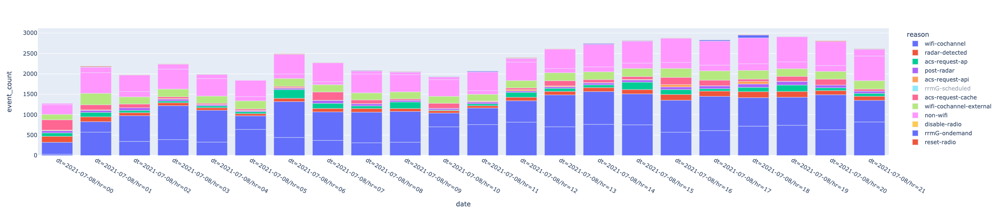

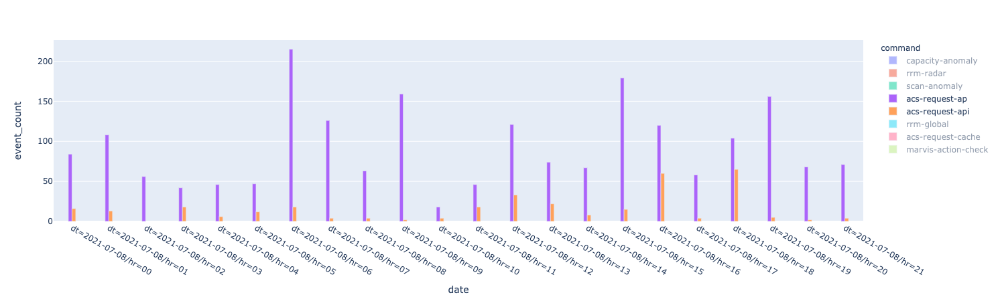

In [7]:
%%local
fig = px.bar(df_rrm_local,x="date",y="event_count",color="reason")
#fig.update_layout(height=600, width=1000)
fig.update_xaxes(categoryorder='category ascending')
fig.show()

fig = px.bar(df_rrm_local,x="date",y="event_count",color="command",barmode="group")
#fig.update_layout(height=600, width=1000)
fig.update_xaxes(categoryorder='category ascending')
fig.show()

In [16]:
start = True
for d in range(0,20):
    current_date = datetime.now() - timedelta(days=d)
    date = "{}".format(current_date.date())
    hr ="*"
    input_files = "s3://mist-secorapp-production/rrm-local/rrm-local-production/dt={}/hr={}/*.seq".format(date,hr)
    data_rdd = spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1]))
    if start:
        df_rrm_local = spark.createDataFrame(data_rdd).withColumn("date",F.lit("dt={}/hr={}".format(date,hr)))\
                                .groupby("date","command","reason").agg(F.count("when").alias("event_count"))
        start = False
    else:
        df_rrm_local = df_rrm_local.union(spark.createDataFrame(data_rdd).withColumn("date",F.lit("dt={}/hr={}".format(date,hr)))\
                                                 .groupby("date","command","reason").agg(F.count("when").alias("event_count")))
        
df_rrm_local.show(truncate=False)
df_rrm_local.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------------+-------------------+-----------------------+-----------+
|date              |command            |reason                 |event_count|
+------------------+-------------------+-----------------------+-----------+
|dt=2021-07-08/hr=*|rrm-global         |rrmG-scheduled         |111016     |
|dt=2021-07-08/hr=*|acs-request-api    |acs-request-api        |253        |
|dt=2021-07-08/hr=*|capacity-anomaly   |non-wifi               |1648       |
|dt=2021-07-08/hr=*|marvis-action-check|disable-radio          |5          |
|dt=2021-07-08/hr=*|scan-anomaly       |wifi-cochannel         |12187      |
|dt=2021-07-08/hr=*|rrm-radar          |radar-detected         |1454       |
|dt=2021-07-08/hr=*|scan-anomaly       |non-wifi               |7770       |
|dt=2021-07-08/hr=*|marvis-action-check|reset-radio            |88         |
|dt=2021-07-08/hr=*|rrm-radar          |post-radar             |764        |
|dt=2021-07-08/hr=*|capacity-anomaly   |wifi-cochannel         |7136       |

In [ ]:
%%spark -o df_rrm_local -n 200000

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [ ]:
%%local
fig = px.bar(df_rrm_local,x="date",y="event_count",color="reason")
#fig.update_layout(height=600, width=1000)
fig.update_xaxes(categoryorder='category ascending')
fig.show()

fig = px.bar(df_rrm_local,x="date",y="event_count",color="command",barmode="group")
#fig.update_layout(height=600, width=1000)
fig.update_xaxes(categoryorder='category ascending')
fig.show()

In [4]:

date = "2021-07-14"
hr ="*"
input_files = "s3://mist-secorapp-staging/rrm-local/rrm-local-staging/dt={}/hr={}/*.seq".format(date,hr)
data_rdd = spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1])).filter(lambda x: x["site_id"]=="faf7ea40-9f40-40dc-bcc1-1eaf87bc15d4")
df_rrm_local = spark.createDataFrame(data_rdd).withColumn("date",F.lit("dt={}/hr={}".format(date,hr)))\
                                .groupby("date","site_id","command","reason").agg(F.count("when").alias("event_count"))
                
df_rrm_local.sort(F.desc("event_count")).show(100,truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------------+------------------------------------+-----------------+-----------------------+-----------+
|date              |site_id                             |command          |reason                 |event_count|
+------------------+------------------------------------+-----------------+-----------------------+-----------+
|dt=2021-07-14/hr=*|faf7ea40-9f40-40dc-bcc1-1eaf87bc15d4|acs-request-cache|acs-request-cache      |24         |
|dt=2021-07-14/hr=*|faf7ea40-9f40-40dc-bcc1-1eaf87bc15d4|scan-anomaly     |non-wifi               |20         |
|dt=2021-07-14/hr=*|faf7ea40-9f40-40dc-bcc1-1eaf87bc15d4|scan-anomaly     |wifi-cochannel-external|19         |
|dt=2021-07-14/hr=*|faf7ea40-9f40-40dc-bcc1-1eaf87bc15d4|rrm-radar        |radar-detected         |3          |
|dt=2021-07-14/hr=*|faf7ea40-9f40-40dc-bcc1-1eaf87bc15d4|scan-anomaly     |wifi-cochannel         |3          |
|dt=2021-07-14/hr=*|faf7ea40-9f40-40dc-bcc1-1eaf87bc15d4|rrm-radar        |post-radar             |3    

# SLE Capacity Anomaly Volumne

In [7]:
date = "2021-07-08"
hr ="*"
input_files = "s3://mist-secorapp-production/sle-capacity-anomaly/sle-capacity-anomaly-production/dt={}/hr=*/*.seq".format(date,hr)
data_rdd = spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1]))
df_capacity = spark.createDataFrame(data_rdd).withColumn("date",F.lit(date))
df_capacity.agg(F.count("anomaly")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------+
|count(anomaly)|
+--------------+
|        232362|
+--------------+

In [9]:
start = True
for d in range(1,45):
    current_date = datetime.now() - timedelta(days=d)
    date = "{}".format(current_date.date())
    hr ="*"
    input_files = "s3://mist-secorapp-production/sle-capacity-anomaly/sle-capacity-anomaly-production/dt={}/hr=*/*.seq".format(date,hr)
    data_rdd = spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1]))
    if start:
        df_capacity = spark.createDataFrame(data_rdd).agg(F.count("anomaly").alias("event_count")).withColumn("date",F.lit(date)).select("date","event_count")
        start = False
    else:
        df_capacity = df_capacity.union(spark.createDataFrame(data_rdd).agg(F.count("anomaly").alias("event_count")).withColumn("date",F.lit(date)).select("date","event_count"))

df_capacity.sort("date").show(100,truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+----------+-----------+
|date      |event_count|
+----------+-----------+
|2021-05-26|140434     |
|2021-05-27|149400     |
|2021-05-28|145595     |
|2021-05-29|142663     |
|2021-05-30|131512     |
|2021-05-31|131228     |
|2021-06-01|136319     |
|2021-06-02|141007     |
|2021-06-03|138270     |
|2021-06-04|145756     |
|2021-06-05|135592     |
|2021-06-06|125817     |
|2021-06-07|139215     |
|2021-06-08|139415     |
|2021-06-09|143177     |
|2021-06-10|155527     |
|2021-06-11|163073     |
|2021-06-12|141019     |
|2021-06-13|130868     |
|2021-06-14|156345     |
|2021-06-15|171087     |
|2021-06-16|167152     |
|2021-06-17|208925     |
|2021-06-18|206032     |
|2021-06-19|184831     |
|2021-06-20|169851     |
|2021-06-21|195389     |
|2021-06-22|201407     |
|2021-06-23|216441     |
|2021-06-24|225727     |
|2021-06-25|233183     |
|2021-06-26|202813     |
|2021-06-27|185461     |
|2021-06-28|224833     |
|2021-06-29|218399     |
|2021-06-30|212359     |
|2021-07-01|212413     |


In [10]:
%%spark -o df_capacity

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

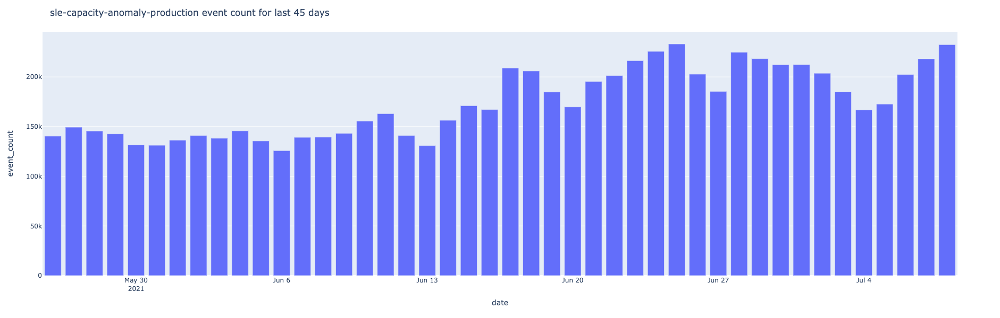

In [15]:
%%local
fig = px.bar(df_capacity,x="date",y="event_count")
fig.update_layout(height=600, width=1000)
fig.update_layout(
    title="sle-capacity-anomaly-production event count for last 45 days",
    
)
fig.show()

# RRM Local Event S3 Amzn Large Site

In [7]:
#BOI2 - AMAZON LARGE SITE site_id -> 0e7b925b-f31f-4a17-8fad-7aaf1670c346 band_24_usage = 24 and allow_rrm_disable=False
#5e8fe474-a9ee-4d01-a2b6-b022b0f9c869, GEG1 - band_24_usage = 24 and allow_rrm_disable=False
# 0129e71e-cf17-4ade-bb26-9a12adf38108, BFL1 - band_24_usage = 24 and allow_rrm_disable=False


site_ids = ["0e7b925b-f31f-4a17-8fad-7aaf1670c346","5e8fe474-a9ee-4d01-a2b6-b022b0f9c869","0129e71e-cf17-4ade-bb26-9a12adf38108"]
for d in range(1,45):
    current_date = datetime.now() - timedelta(days=d)
    date = "{}".format(current_date.date())
    hr ="*"
    input_files = "s3://mist-secorapp-production/rrm-local/rrm-local-production/dt={}/hr=*/*.seq".format(date,hr)
    data_rdd = spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1])).filter(lambda x: x["site_id"] in site_ids)
    df_rrm_local = spark.createDataFrame(data_rdd).join(df_name,["org_id","site_id"],"inner")
    df_rrm_local.coalesce(200).write.mode("overwrite")\
                            .parquet("s3://mist-data-science-dev/may/amzn-large-site/rrm-local-event/date={}".format(date))


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [6]:
site_ids = ["0e7b925b-f31f-4a17-8fad-7aaf1670c346","5e8fe474-a9ee-4d01-a2b6-b022b0f9c869","0129e71e-cf17-4ade-bb26-9a12adf38108"]
dates = ["2021-06-22","2021-06-23"]
start = True
for date in dates:
    for h in range(0,24):
        try:
            hr="{}".format(str(h).zfill(2))
            input_files = "s3://mist-secorapp-production/rrm-local/rrm-local-production/dt={}/hr={}/*.seq".format(date,hr)
            data_rdd = spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1])).filter(lambda x: x["site_id"] in site_ids)
            if start:
                df_rrm_local = spark.createDataFrame(data_rdd).join(df_name,["org_id","site_id"],"inner")\
                            .withColumn("hr",F.lit("{}-{}".format(date,hr))).groupby("org_name","site_name","site_id","command","reason","band","hr").agg(F.count("when").alias("event_count"))
                start = False
            else:
                df_rrm_local = df_rrm_local.union(spark.createDataFrame(data_rdd).join(df_name,["org_id","site_id"],"inner")\
                            .withColumn("hr",F.lit("{}-{}".format(date,hr))).groupby("org_name","site_name","site_id","command","reason","band","hr").agg(F.count("when").alias("event_count")))
        except Exception as e:
            #print(e)
            continue

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [ ]:
df_rrm_local.show()

In [31]:
df_rrm_local = spark.read.parquet("s3://mist-data-science-dev/may/amzn-large-site/rrm-local-event/")
df_rrm_local.groupby("org_name","site_name","site_id").agg(F.count("when").alias("event_count")).show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+---------------+---------+------------------------------------+-----------+
|org_name       |site_name|site_id                             |event_count|
+---------------+---------+------------------------------------+-----------+
|AmazonOTFC-Prod|GEG1     |5e8fe474-a9ee-4d01-a2b6-b022b0f9c869|96854      |
|AmazonOTFC-Prod|BFL1     |0129e71e-cf17-4ade-bb26-9a12adf38108|30752      |
|AmazonOTFC-Prod|BOI2     |0e7b925b-f31f-4a17-8fad-7aaf1670c346|20308      |
+---------------+---------+------------------------------------+-----------+

In [9]:
df_rrm_local.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+------------+----+---------+-------+-----------------------+--------------------+-------+----------------+-----+-------------+-----------+---------+---------+------+--------------+-------------+-----------+-----------+---------+----------+-------+-----+-------------------+---------------+---------+----------+
|              org_id|             site_id|       ap_id|band|bandwidth|channel|channel_update_interval|            channels|clients|         command|power|pre_bandwidth|pre_channel|pre_power|pre_usage|rad_id|        reason|rrm_bandwidth|rrm_channel|rrm_enabled|rrm_power| timestamp|updated|usage|               when|       org_name|site_name|      date|
+--------------------+--------------------+------------+----+---------+-------+-----------------------+--------------------+-------+----------------+-----+-------------+-----------+---------+---------+------+--------------+-------------+-----------+-----------+---------+----------+-------+--

In [10]:
df_rrm_local_count = df_rrm_local.groupby("site_name","command","reason","band","date").agg(F.count("when").alias("event_count"))
df_rrm_local_count.count()
#.sort("site_name","event_count").show(100,truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

An error was encountered:
"cannot resolve '`date`' given input columns: [site_name, reason, band, site_id, hr, org_name, event_count, command];;\n'Aggregate [site_name#51, command#10057, reason#10065, band#10051, 'date], [site_name#51, command#10057, reason#10065, band#10051, 'date, count('when) AS event_count#16302]\n+- Union\n   :- Aggregate [org_name#17, site_name#51, site_id#10070, command#10057, reason#10065, band#10051, hr#10127], [org_name#17, site_name#51, site_id#10070, command#10057, reason#10065, band#10051, hr#10127, count(when#10074) AS event_count#10186L]\n   :  +- Project [org_id#10058, site_id#10070, ap_id#10050, band#10051, bandwidth#10052L, channel#10053L, channel_update_interval#10054L, channels#10055, clients#10056L, command#10057, power#10059L, pre_bandwidth#10060L, pre_channel#10061L, pre_power#10062L, pre_usage#10063, rad_id#10064, reason#10065, rrm_bandwidth#10066L, rrm_channel#10067L, rrm_enabled#10068, rrm_power#10069L, timestamp#10071L, updated#10072, usage#1

In [36]:
df_rrm_local.filter(F.col("reason")=="wifi-cochannel").groupby("site_name","command","reason","band").agg(F.count("when").alias("event_count")).sort("site_name",F.desc("event_count")).show(100,truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+---------+----------------+--------------+----+-----------+
|site_name|command         |reason        |band|event_count|
+---------+----------------+--------------+----+-----------+
|BFL1     |capacity-anomaly|wifi-cochannel|5   |23090      |
|BFL1     |scan-anomaly    |wifi-cochannel|5   |1038       |
|BFL1     |scan-anomaly    |wifi-cochannel|24  |2          |
|BOI2     |capacity-anomaly|wifi-cochannel|5   |8217       |
|BOI2     |scan-anomaly    |wifi-cochannel|5   |656        |
|GEG1     |capacity-anomaly|wifi-cochannel|5   |82044      |
|GEG1     |scan-anomaly    |wifi-cochannel|5   |2226       |
|GEG1     |scan-anomaly    |wifi-cochannel|24  |22         |
+---------+----------------+--------------+----+-----------+

In [7]:
%%spark -o df_rrm_local

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

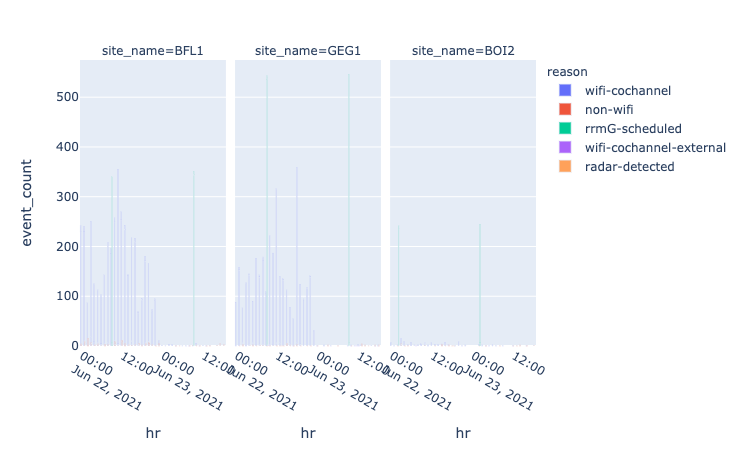

In [8]:
%%local 
fig = px.bar(df_rrm_local,x="hr",y="event_count",barmode="group",color="reason",facet_col="site_name")
#fig.update_layout(height=600, width=1000)
fig.show()

# AP Scan

In [42]:
site_ids = ["0e7b925b-f31f-4a17-8fad-7aaf1670c346","5e8fe474-a9ee-4d01-a2b6-b022b0f9c869","0129e71e-cf17-4ade-bb26-9a12adf38108"]
for d in range(1,45):
    current_date = datetime.now() - timedelta(days=d)
    date = "{}".format(current_date.date())
    input_files = "s3://mist-secorapp-production/rrm-apscan/rrm-apscan-production/dt={}/".format(date)
    df_rrm_apscan = spark.read.orc(input_files).filter(F.col("site").isin(site_ids))
    df_rrm_apscan.coalesce(200).write.mode("overwrite")\
                             .parquet("s3://mist-data-science-dev/may/amzn-large-site/rrm-apscan/date={}".format(date))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [41]:
df_rrm_apscan.printSchema()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

root
 |-- ap: string (nullable = true)
 |-- band: string (nullable = true)
 |-- bandwidth: short (nullable = true)
 |-- channel: short (nullable = true)
 |-- insite_channel_weight: float (nullable = true)
 |-- max_tx_power: short (nullable = true)
 |-- noise_floor: short (nullable = true)
 |-- num_clients: short (nullable = true)
 |-- org: string (nullable = true)
 |-- radar: short (nullable = true)
 |-- scan_channel: short (nullable = true)
 |-- scan_channel_weight: float (nullable = true)
 |-- scan_congest_nonwifi: float (nullable = true)
 |-- scan_congest_rxotherbss: float (nullable = true)
 |-- scan_external_avg_rssi: short (nullable = true)
 |-- scan_external_counts: short (nullable = true)
 |-- scan_external_loud_bssid: string (nullable = true)
 |-- scan_external_loud_ssid: string (nullable = true)
 |-- scan_external_max_rssi: short (nullable = true)
 |-- scan_insite_avg_rssi: short (nullable = true)
 |-- scan_insite_counts: short (nullable = true)
 |-- scan_insite_max_rssi: shor

In [43]:
df_rrm_apscan = spark.read.parquet("s3://mist-data-science-dev/may/amzn-large-site/rrm-apscan/")
df_rrm_apscan.groupby("site").agg(F.count("timestamp").alias("event_count")).show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------------------------------+-----------+
|site                                |event_count|
+------------------------------------+-----------+
|5e8fe474-a9ee-4d01-a2b6-b022b0f9c869|98109822   |
|0e7b925b-f31f-4a17-8fad-7aaf1670c346|98103897   |
|0129e71e-cf17-4ade-bb26-9a12adf38108|97839187   |
+------------------------------------+-----------+

In [44]:
df_rrm_apscan.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+----+---------+-------+---------------------+------------+-----------+-----------+--------------------+-----+------------+-------------------+--------------------+-----------------------+----------------------+--------------------+------------------------+-----------------------+----------------------+--------------------+------------------+--------------------+----------------+-----------------+--------------------+--------------------+-------------------+--------+-----------+------------+------------+---------------+-----------+----------+
|          ap|band|bandwidth|channel|insite_channel_weight|max_tx_power|noise_floor|num_clients|                 org|radar|scan_channel|scan_channel_weight|scan_congest_nonwifi|scan_congest_rxotherbss|scan_external_avg_rssi|scan_external_counts|scan_external_loud_bssid|scan_external_loud_ssid|scan_external_max_rssi|scan_insite_avg_rssi|scan_insite_counts|scan_insite_max_rssi|scan_noise_floor|scan_util_nonwifi|scan_util_rxotherbss|    

In [48]:
df_rrm_apscan.select("site","ap","scan_insite_avg_rssi","scan_external_avg_rssi","noise_floor","scan_noise_floor").show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+------------+--------------------+----------------------+-----------+----------------+
|                site|          ap|scan_insite_avg_rssi|scan_external_avg_rssi|noise_floor|scan_noise_floor|
+--------------------+------------+--------------------+----------------------+-----------+----------------+
|5e8fe474-a9ee-4d0...|5c5b35bf4032|                -100|                  -100|        -91|             -92|
|5e8fe474-a9ee-4d0...|5c5b35bf4032|                -100|                  -100|        -92|             -90|
|5e8fe474-a9ee-4d0...|5c5b35bf4032|                 -56|                  -100|        -91|             -92|
|5e8fe474-a9ee-4d0...|5c5b35bf4032|                 -67|                  -100|        -92|             -90|
|5e8fe474-a9ee-4d0...|5c5b35bf4032|                -100|                  -100|        -92|             -90|
|5e8fe474-a9ee-4d0...|5c5b35bf4032|                -100|                  -100|        -92|             -90|
|5e8fe474-a9ee-4d0.

# RRM ApScan

In [19]:
env = "production"
dt = "2021-07-20"
hr = "10"
s3_bucket = "s3://mist-secorapp-{env}/cv-ap-scans-multipartition/cv-ap-scans-multipartition-{env}/dt={dt}/hr={hr}".format(env=env, dt=dt, hr=hr)

df = spark.read.orc(s3_bucket)

df_site_edge = df.filter((F.col("band")=="5") &(F.col("org")=="56de201d-e63b-4312-9858-40f4cfe35c7f"))\
    .select("org", "site", "band", "ap", "ap2")\
    .groupBy(F.col("org").alias("org_id"), F.col("site").alias("site_id"), "band").agg(F.countDistinct("ap").alias("aps"),
                                         F.countDistinct("ap", "ap2").alias("edges"))\
    .withColumn("avg_edge",F.col("edges")/F.col("aps"))\
    .join(df_name,["org_id","site_id"])


df_site_edge_reduce_power = df.filter((F.col("band")=="5") &(F.col("org")=="56de201d-e63b-4312-9858-40f4cfe35c7f"))\
    .withColumn("rssi",F.col("rssi")-5)\
    .filter(F.col("rssi")>-72)\
    .select("org", "site", "band", "ap", "ap2")\
    .groupBy(F.col("org").alias("org_id"), F.col("site").alias("site_id"), "band").agg(F.countDistinct("ap").alias("aps_after_power_reduced_5dBm"),
                                         F.countDistinct("ap", "ap2").alias("edges_after_power_reduced_5dBm"))\
    .withColumn("avg_edge_after_power_reduced_5dBm",F.col("edges_after_power_reduced_5dBm")/F.col("aps_after_power_reduced_5dBm"))\
    

df_site_edge.join(df_site_edge_reduce_power,["site_id","org_id","band"])\
        .select("org_id","site_id","org_name","site_name","band","aps","aps_after_power_reduced_5dBm","edges","edges_after_power_reduced_5dBm","avg_edge","avg_edge_after_power_reduced_5dBm"
                                                                        ).orderBy(F.col("aps").desc()).show(100, truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------------------------------+------------------------------------+---------------+---------+----+----+----------------------------+------+------------------------------+------------------+---------------------------------+
|org_id                              |site_id                             |org_name       |site_name|band|aps |aps_after_power_reduced_5dBm|edges |edges_after_power_reduced_5dBm|avg_edge          |avg_edge_after_power_reduced_5dBm|
+------------------------------------+------------------------------------+---------------+---------+----+----+----------------------------+------+------------------------------+------------------+---------------------------------+
|56de201d-e63b-4312-9858-40f4cfe35c7f|f6144ffe-4731-488a-b20c-429984e3e314|AmazonOTFC-Prod|SYR1     |5   |3553|3546                        |386226|179413                        |108.70419363917816|50.59588268471517                |
|56de201d-e63b-4312-9858-40f4cfe35c7f|6dc4aa35-0f78-4f76-aa96-15d674ea59

In [20]:
df.filter((F.col("band")=="5") &(F.col("org")=="56de201d-e63b-4312-9858-40f4cfe35c7f"))\
    .withColumn("rssi",F.col("rssi")-5)\
    .filter(F.col("rssi")>-72).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+------------+----+-------+-------+--------------------+-----+--------------------+-------------------+-------------+
|          ap|         ap2|band|channel|in_site|                 org| rssi|                site|               time|radio_channel|
+------------+------------+----+-------+-------+--------------------+-----+--------------------+-------------------+-------------+
|d4dc09206851|d4dc09206888|   5|     36|   true|56de201d-e63b-431...|-59.0|64247487-ee12-45b...|2021-07-20 10:32:47|           48|
|d4dc09206851|d4dc0921ecd5|   5|    161|   true|56de201d-e63b-431...|-67.0|64247487-ee12-45b...|2021-07-20 10:32:47|           48|
|d4dc09206851|d4dc092068c9|   5|     36|   true|56de201d-e63b-431...|-64.0|64247487-ee12-45b...|2021-07-20 10:32:47|           48|
|d4dc09206851|d4dc0920671b|   5|     44|   true|56de201d-e63b-431...|-66.0|64247487-ee12-45b...|2021-07-20 10:32:47|           48|
|d4dc09206851|d4dc092085fc|   5|     36|   true|56de201d-e63b-431...|-62.0|64247487

# Amzn Across Switch Roaming

In [3]:
dt="2021-08-17"; 
hr="10"

s3_bucket = "s3://mist-aggregated-stats-production/aggregated-stats/graph/snapshots/"
s3_device_nodes_bucket ="{}device-nodes/dt={}/hr={}/".format(s3_bucket, dt, hr)
device_nodes_df = spark.read.parquet(s3_device_nodes_bucket)
s3_device_edges_bucket = "{}device-edges/dt={}/hr={}/".format(s3_bucket, dt, hr)
device_edges_df = spark.read.parquet(s3_device_edges_bucket)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [6]:
device_edges_df.printSchema()
device_edges_df.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

root
 |-- createdAt: long (nullable = true)
 |-- expiredAt: integer (nullable = true)
 |-- from: string (nullable = true)
 |-- id: string (nullable = true)
 |-- lastSeenAt: long (nullable = true)
 |-- orgId: string (nullable = true)
 |-- relType: string (nullable = true)
 |-- siteId: string (nullable = true)
 |-- source: string (nullable = true)
 |-- sourceIp: string (nullable = true)
 |-- sourceName: string (nullable = true)
 |-- sourcePort: string (nullable = true)
 |-- sourceVendor: string (nullable = true)
 |-- sourceVersion: string (nullable = true)
 |-- target: string (nullable = true)
 |-- targetIp: string (nullable = true)
 |-- targetName: string (nullable = true)
 |-- targetPort: string (nullable = true)
 |-- targetVendor: string (nullable = true)
 |-- targetVersion: string (nullable = true)
 |-- to: string (nullable = true)
 |-- lastModifiedAt: integer (nullable = true)

+----------+---------+--------------------+--------------------+----------+--------------------+-------+--

In [ ]:
# dt="2021-08-17"; 
#         hr="10"     
#         s3_bucket = "s3://mist-aggregated-stats-production/aggregated-stats/graph/snapshots/"
#         s3_device_nodes_bucket ="{}device-nodes/dt={}/hr={}/".format(s3_bucket, dt, hr)
#         device_nodes_df = spark.read.parquet(s3_device_nodes_bucket)
#         s3_device_edges_bucket = "{}device-edges/dt={}/hr={}/".format(s3_bucket, dt, hr)
#         device_edges_df = spark.read.parquet(s3_device_edges_bucket)
            
#         device_nodes_model_df = device_nodes_df.select("mac", "model", "deviceType")
#         device_edges_df = device_edges_df\
#                                     .join(device_nodes_model_df,\
#                                     [device_edges_df.source==device_nodes_model_df.mac], how="left")\
#                                         .withColumnRenamed("mac", "sourceMac")\
#                                         .withColumnRenamed("model", "sourceModel")\
#                                         .withColumnRenamed("deviceType", "sourceType")\
#                                     .join(device_nodes_model_df,\
#                                     [device_edges_df.target==device_nodes_model_df.mac], how="left")\
#                                         .withColumnRenamed("mac", "targetMac")\
#                                         .withColumnRenamed("model", "targetModel")\
#                                         .withColumnRenamed("deviceType", "targetType")
        
#         org_id = "56de201d-e63b-4312-9858-40f4cfe35c7f"  # AMAZONOTFC-PROD
#         #cols = ["orgId","siteId","relType", "source", "sourceIp", "sourceName", "sourcePort", "sourceVendor", "sourceVersion", "target", "targetIp", "targetName", "targetPort", "targetVendor", "sourceModel", "targetModel", "sourceType", "targetType"]
#         for d in range(3,5):
        
#             current_date = datetime.now() - timedelta(days=d)
#             date = "{}".format(current_date.date())
#             h = "*"
#             input_files = "s3://mist-secorapp-production/client-roam/client-roam-production/dt={}/hr={}/*.seq".format(date,h)
    
#             df_roam = spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1])).filter(lambda x: x["OrgID"]==org_id).toDF()\
#                         .withColumn("FromAP",F.regexp_replace("FromAP","-",""))\
#                         .withColumn("ToAP",F.regexp_replace("ToAP","-",""))\
#                         .join(device_edges_df.select("orgId","siteId",F.col("source").alias("FromAP"),F.col("sourceName").alias("FromAPName"),\
#                                                 F.col("sourceModel").alias("FromAPModel"),F.col("targetName").alias("FromAP-SW-Name")),["orgId","siteId","FromAP"])\
#                         .join(device_edges_df.select("orgId","siteId",F.col("source").alias("ToAP"),F.col("sourceName").alias("ToAPName"),\
#                                                 F.col("sourceModel").alias("ToAPModel"),F.col("targetName").alias("ToAP-SW-Name")),["orgId","siteId","ToAP"])

#             total = df_roam.groupby("orgId","siteId").agg(F.count("When").alias("total_roam"))

#             df_sw_roam = df_roam.groupby("orgId","siteId","FromAP-SW-Name","ToAP-SW-Name").agg(F.count("When").alias("event_count"))\
#                                 .join(total,["orgId","siteId"])\
#                                 .withColumn("event_%",100*F.col("event_count")/F.col("total_roam"))

#             df_sw_roam.write.mode("overwrite")\
#                                         .parquet("s3://mist-data-science-dev/may/roaming-exploration/amzn-sw-roam/date={}".format(date))


dt="2021-08-17"; 
hr="10"     
s3_bucket = "s3://mist-aggregated-stats-production/aggregated-stats/graph/snapshots/"
s3_device_nodes_bucket ="{}device-nodes/dt={}/hr={}/".format(s3_bucket, dt, hr)
device_nodes_df = spark.read.parquet(s3_device_nodes_bucket)
s3_device_edges_bucket = "{}device-edges/dt={}/hr={}/".format(s3_bucket, dt, hr)
device_edges_df = spark.read.parquet(s3_device_edges_bucket)

device_nodes_model_df = device_nodes_df.select("mac", "model", "deviceType")
device_edges_df = device_edges_df\
                                    .join(device_nodes_model_df,\
                                    [device_edges_df.source==device_nodes_model_df.mac], how="left")\
                                        .withColumnRenamed("mac", "sourceMac")\
                                        .withColumnRenamed("model", "sourceModel")\
                                        .withColumnRenamed("deviceType", "sourceType")\
                                    .join(device_nodes_model_df,\
                                    [device_edges_df.target==device_nodes_model_df.mac], how="left")\
                                        .withColumnRenamed("mac", "targetMac")\
                                        .withColumnRenamed("model", "targetModel")\
                                        .withColumnRenamed("deviceType", "targetType")
        
org_id = "56de201d-e63b-4312-9858-40f4cfe35c7f"  # AMAZONOTFC-PROD
        #cols = ["orgId","siteId","relType", "source", "sourceIp", "sourceName", "sourcePort", "sourceVendor", "sourceVersion", "target", "targetIp", "targetName", "targetPort", "targetVendor", "sourceModel", "targetModel", "sourceType", "targetType"]
for d in range(1,5):
        
            current_date = datetime.now() - timedelta(days=d)
            date = "{}".format(current_date.date())
            h = "*"
            input_files = "s3://mist-secorapp-production/client-roam/client-roam-production/dt={}/hr={}/*.seq".format(date,h)
    
            df_roam = spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1])).filter(lambda x: x["OrgID"]==org_id).toDF()\
                        .withColumn("FromAP",F.regexp_replace("FromAP","-",""))\
                        .withColumn("ToAP",F.regexp_replace("ToAP","-",""))\
                        .join(device_edges_df.select("orgId","siteId",F.col("source").alias("FromAP"),F.col("sourceName").alias("FromAPName"),\
                                                F.col("sourceModel").alias("FromAPModel"),F.col("targetName").alias("FromAP-SW-Name")),["orgId","siteId","FromAP"])\
                        .join(device_edges_df.select("orgId","siteId",F.col("source").alias("ToAP"),F.col("sourceName").alias("ToAPName"),\
                                                F.col("sourceModel").alias("ToAPModel"),F.col("targetName").alias("ToAP-SW-Name")),["orgId","siteId","ToAP"])

            total = df_roam.groupby("orgId","siteId").agg(F.count("When").alias("total_roam"))

            df_sw_roam = df_roam.groupby("orgId","siteId","FromAP","ToAP","FromAPName","ToAPName","FromAP-SW-Name","ToAP-SW-Name").agg(F.count("When").alias("event_count"))\
                                .join(total,["orgId","siteId"])\
                                .withColumn("event_%",100*F.col("event_count")/F.col("total_roam"))

            df_sw_roam.write.mode("overwrite")\
                                        .parquet("s3://mist-data-science-dev/may/roaming-exploration/amzn-sw-roam/date={}".format(date))




FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [4]:
df = spark.read.parquet("s3://mist-data-science-dev/may/roaming-exploration/amzn-sw-roam/")\
                .wtihColumn("FromAP-SW-Number",F.substring("FromAP-SW-Name", 12,7))
                .wtihColumn("ToAP-SW-Number",F.substring("ToAP-SW-Name", 12,7))
                .withColumn("across_switches", F.col("FromAP-SW-Number")!=F.col("ToAP-SW-Number"))
df.sort(F.desc("event_%")).show(truncate=False)

The code failed because of a fatal error:
	Session 507 unexpectedly reached final status 'dead'. See logs:
stdout: 

stderr: 
21/08/23 19:30:28 INFO RSCDriver: Connecting to: ip-172-31-27-180.us-west-1.compute.internal:10001
21/08/23 19:30:28 INFO RSCDriver: Starting RPC server...
21/08/23 19:30:29 INFO RpcServer: Connected to the port 10004
21/08/23 19:30:29 WARN RSCConf: Your hostname, ip-172-31-27-180.us-west-1.compute.internal, resolves to a loopback address, but we couldn't find any external IP address!
21/08/23 19:30:29 WARN RSCConf: Set livy.rsc.rpc.server.address if you need to bind to another address.
21/08/23 19:30:29 INFO RSCDriver: Received job request 304066e3-62fc-4189-8d3a-b08b8d4a20bb
21/08/23 19:30:29 INFO RSCDriver: SparkContext not yet up, queueing job request.
21/08/23 19:30:32 INFO SparkEntries: Starting Spark context...
21/08/23 19:30:32 INFO SparkContext: Running Spark version 2.4.7-amzn-1
21/08/23 19:30:32 INFO SparkContext: Submitted application: may
21/08/23 1

In [5]:
print("All Amznprod sites. OrgId = 56de201d-e63b-4312-9858-40f4cfe35c7f")
df.groupby("date","orgId","siteId","across_switches").agg(F.sum("event_%").alias("event_%"),F.mean("total_roam").alias("total_roam"))\
        .groupby("date","across_switches").agg(F.mean("event_%").alias("event_%"),F.sum("total_roam").alias("total_roam")).sort("date","across_switches").show(truncate=False)

The code failed because of a fatal error:
	Session 507 unexpectedly reached final status 'dead'. See logs:
stdout: 

stderr: 
21/08/23 19:30:28 INFO RSCDriver: Connecting to: ip-172-31-27-180.us-west-1.compute.internal:10001
21/08/23 19:30:28 INFO RSCDriver: Starting RPC server...
21/08/23 19:30:29 INFO RpcServer: Connected to the port 10004
21/08/23 19:30:29 WARN RSCConf: Your hostname, ip-172-31-27-180.us-west-1.compute.internal, resolves to a loopback address, but we couldn't find any external IP address!
21/08/23 19:30:29 WARN RSCConf: Set livy.rsc.rpc.server.address if you need to bind to another address.
21/08/23 19:30:29 INFO RSCDriver: Received job request 304066e3-62fc-4189-8d3a-b08b8d4a20bb
21/08/23 19:30:29 INFO RSCDriver: SparkContext not yet up, queueing job request.
21/08/23 19:30:32 INFO SparkEntries: Starting Spark context...
21/08/23 19:30:32 INFO SparkContext: Running Spark version 2.4.7-amzn-1
21/08/23 19:30:32 INFO SparkContext: Submitted application: may
21/08/23 1

In [8]:
def get_switch_number(APName):
    try:
        return APName.split("-")[1]
    except:
        return APName

get_switch_numberUDF = F.udf(get_switch_number,StringType())

df = spark.read.parquet("s3://mist-data-science-dev/may/roaming-exploration/amzn-sw-roam/")\
                .withColumn("FromAP-SW-Number",get_switch_numberUDF("FromAPName"))\
                .withColumn("ToAP-SW-Number",get_switch_numberUDF("ToAPName"))\
                .withColumn("across_switches", F.col("FromAP-SW-Number")!=F.col("ToAP-SW-Number"))
# df.sort(F.desc("event_%")).show(truncate=False)


# print("All Amznprod sites. OrgId = 56de201d-e63b-4312-9858-40f4cfe35c7f")
# df.groupby("date","orgId","siteId","across_switches").agg(F.sum("event_%").alias("event_%"),F.mean("total_roam").alias("total_roam"))\
#         .groupby("date","across_switches").agg(F.mean("event_%").alias("event_%"),F.sum("total_roam").alias("total_roam"))\
#             .sort("date","across_switches").show(truncate=False)


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [40]:
df_all = df.groupby("date","orgId","siteId","FromAP-SW-Number","ToAP-SW-Number","across_switches")\
        .agg(F.sum("event_%").alias("event_%"),F.mean("total_roam").alias("total_roam"))

df_all.count() # .sort("date","across_switches").show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

22998

In [43]:
%spark -o df_all -n 22998

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

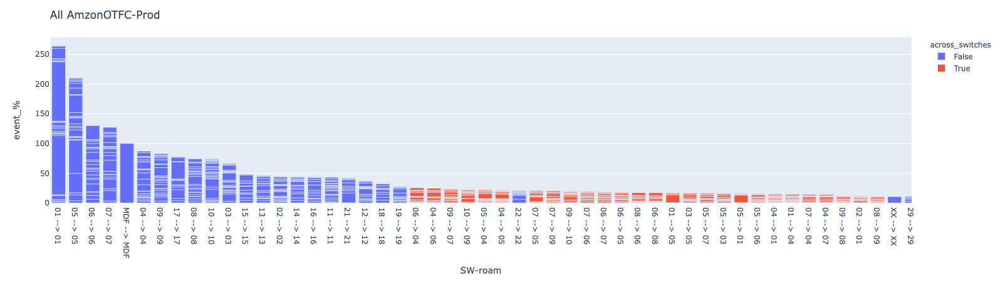

In [57]:
%%local
df_all["SW-roam"] = df_all["FromAP-SW-Number"].apply(str)  + " --> " + df_all["ToAP-SW-Number"].apply(str)
fig = px.bar(df_all.groupby(["SW-roam","across_switches","siteId"])["event_%"].mean().reset_index(),x="SW-roam",y="event_%",color="across_switches",hover_data=["siteId"])
#fig.update_layout(height=600, width=00)
fig.update_xaxes(range=(-0.5, 50),categoryorder='total descending')
fig.update_layout(
    title="All AmzonOTFC-Prod"
)
fig.show()


## Amzn GEG1

In [45]:
# https://manage.mist.com/admin/?org_id=56de201d-e63b-4312-9858-40f4cfe35c7f#!ap/5e8fe474-a9ee-4d01-a2b6-b022b0f9c869
# GEG1
site_id = "5e8fe474-a9ee-4d01-a2b6-b022b0f9c869"
df_filter = df.filter(F.col("siteId")==site_id).groupby("date","orgId","siteId","FromAP-SW-Number","ToAP-SW-Number","across_switches")\
        .agg(F.sum("event_%").alias("event_%"),F.mean("total_roam").alias("total_roam"))

df_filter.count() # .sort("date","across_switches").show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

1145

In [46]:
%spark -o df_filter

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

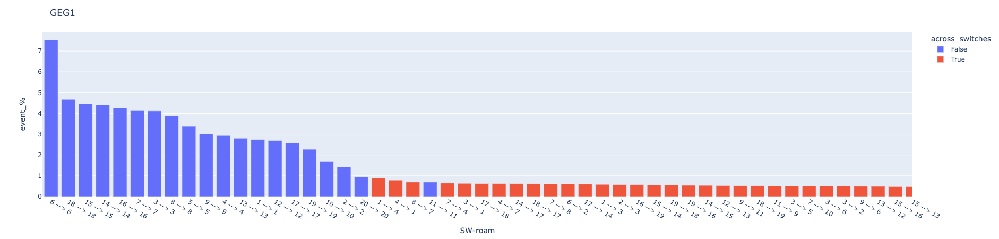

In [47]:
%%local
df_filter["SW-roam"] = df_filter["FromAP-SW-Number"].apply(str)  + " --> " + df_filter["ToAP-SW-Number"].apply(str)
fig = px.bar(df_filter.groupby(["SW-roam","across_switches"])["event_%"].mean().reset_index(),x="SW-roam",y="event_%",color="across_switches")
#fig.update_layout(height=600, width=00)
fig.update_xaxes(range=(-0.5, 50),categoryorder='total descending')
fig.update_layout(
    title="GEG1"
)
fig.show()


In [ ]:
For each switch (Compare within switch roam and across switch.)
Across closet roam (inter closet roam ) -> avg count of (inter|same) closet roam per sec (trend for a few hours)


## Amzn JAN1

In [31]:
# https://manage.mist.com/admin/?org_id=56de201d-e63b-4312-9858-40f4cfe35c7f#!ap/6dc4aa35-0f78-4f76-aa96-15d674ea5962
# JAN1
site_id = "6dc4aa35-0f78-4f76-aa96-15d674ea5962"
df_filter = df.filter(F.col("siteId")==site_id).groupby("date","orgId","siteId","FromAP-SW-Number","ToAP-SW-Number","across_switches")\
        .agg(F.sum("event_%").alias("event_%"),F.mean("total_roam").alias("total_roam"))

df_filter.count() # .sort("date","across_switches").show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

1192

In [32]:
%spark -o df_filter

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

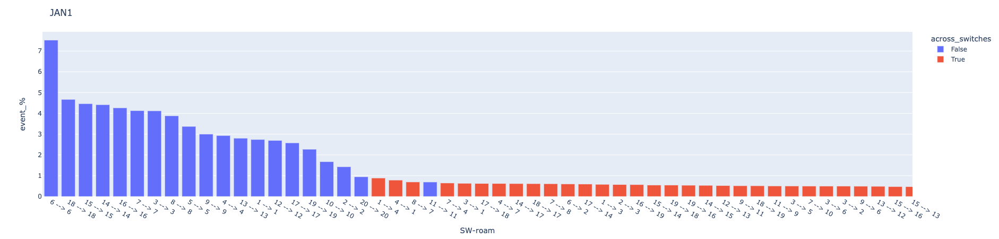

In [48]:
%%local
df_filter["SW-roam"] = df_filter["FromAP-SW-Number"].apply(str)  + " --> " + df_filter["ToAP-SW-Number"].apply(str)
fig = px.bar(df_filter.groupby(["SW-roam","across_switches"])["event_%"].mean().reset_index(),x="SW-roam",y="event_%",color="across_switches")
fig.update_xaxes(range=(-0.5, 50),categoryorder='total descending')
fig.update_layout(
    title="JAN1"
)
fig.show()


## Amzn BFL1

In [34]:
# https://manage.mist.com/admin/?org_id=56de201d-e63b-4312-9858-40f4cfe35c7f#!ap/0129e71e-cf17-4ade-bb26-9a12adf38108
# BFL1
site_id = "0129e71e-cf17-4ade-bb26-9a12adf38108"

df_filter = df.filter(F.col("siteId")==site_id).groupby("date","orgId","siteId","FromAP-SW-Number","ToAP-SW-Number","across_switches")\
        .agg(F.sum("event_%").alias("event_%"),F.mean("total_roam").alias("total_roam"))

df_filter.count() # .sort("date","across_switches").show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

1170

In [35]:
%spark -o df_filter

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

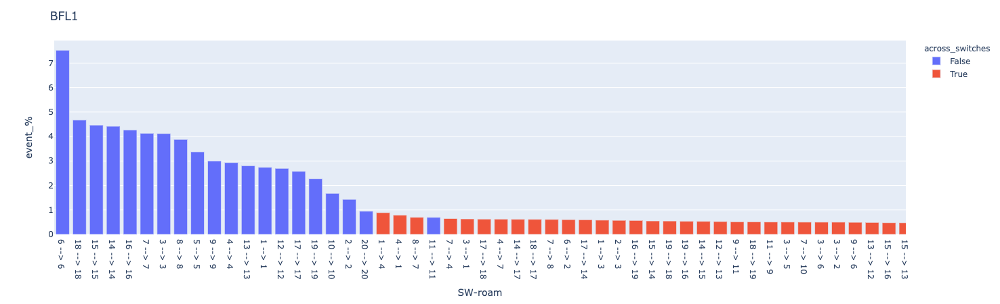

In [49]:
%%local
df_filter["SW-roam"] = df_filter["FromAP-SW-Number"].apply(str)  + " --> " + df_filter["ToAP-SW-Number"].apply(str)
fig = px.bar(df_filter.groupby(["SW-roam","across_switches"])["event_%"].mean().reset_index(),x="SW-roam",y="event_%",color="across_switches")
fig.update_xaxes(range=(-0.5, 50),categoryorder='total descending')
fig.update_layout(
    title="BFL1"
)
fig.show()


## Amzn BOI2

In [58]:
#https://manage.mist.com/admin/?org_id=56de201d-e63b-4312-9858-40f4cfe35c7f#!ap/0e7b925b-f31f-4a17-8fad-7aaf1670c346
site_id = "0e7b925b-f31f-4a17-8fad-7aaf1670c346"

df_filter = df.filter(F.col("siteId")==site_id).groupby("date","orgId","siteId","FromAP-SW-Number","ToAP-SW-Number","across_switches")\
        .agg(F.sum("event_%").alias("event_%"),F.mean("total_roam").alias("total_roam"))

df_filter.count() # .sort("date","across_switches").show(truncate=False)

An error was encountered:
Invalid status code '404' from http://ip-172-31-27-180.us-west-1.compute.internal:8998/sessions/513 with error payload: {"msg":"Session '513' not found."}


In [38]:
%spark -o df_filter

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

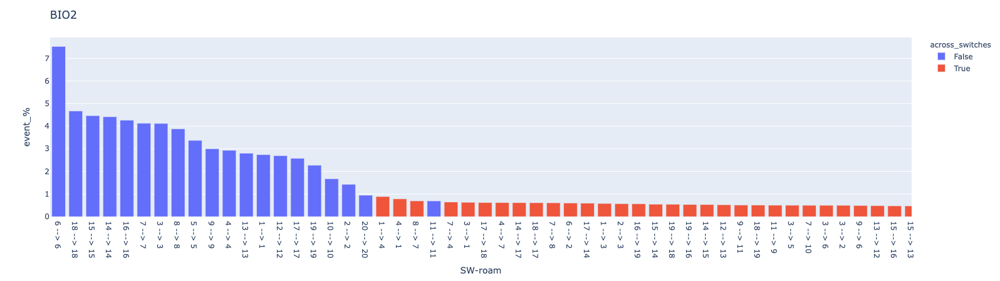

In [50]:
%%local
df_filter["SW-roam"] = df_filter["FromAP-SW-Number"].apply(str)  + " --> " + df_filter["ToAP-SW-Number"].apply(str)
fig = px.bar(df_filter.groupby(["SW-roam","across_switches"])["event_%"].mean().reset_index(),x="SW-roam",y="event_%",color="across_switches")
fig.update_xaxes(range=(-0.5, 50),categoryorder='total descending')
fig.update_layout(
    title="BIO2"
)
fig.show()

# AmazonOTN19 Total Roaming Count

In [6]:
df_org= spark.read.parquet("s3://mist-secorapp-production/dimension/org")\
        .select(F.col("id").alias("org_id"),F.col("name").alias("org_name"))

df_site= spark.read.parquet("s3://mist-secorapp-production/dimension/site")\
        .select(F.col("id").alias("site_id"),F.col("name").alias("site_name"),"org_id")

df_device_name = spark.read.parquet("s3://mist-secorapp-production/dimension/device").join(df_org,"org_id","inner")\
                .join(df_site,["org_id","site_id"]).select("org_id","org_name","site_id","site_id","site_name",F.col("mac").alias("ap_mac"),F.col("name").alias("ap_name"))\
                .groupby("org_id","site_id","org_name","site_name").agg(F.countDistinct("ap_mac").alias("distinct_ap_count"))
org_id = '5a578f3c-f094-4d13-a7dd-96f0aaecb5b6'
df_device_name.filter(F.col("org_id")==org_id).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+----------------+---------+-----------------+
|              org_id|             site_id|        org_name|site_name|distinct_ap_count|
+--------------------+--------------------+----------------+---------+-----------------+
|5a578f3c-f094-4d1...|f5797d4c-64fc-46c...|AmazonOTN19-Prod|     DMZ1|               32|
|5a578f3c-f094-4d1...|6fecb129-54a5-478...|AmazonOTN19-Prod|     DYV1|               45|
|5a578f3c-f094-4d1...|b78d90a5-9e2c-4d3...|AmazonOTN19-Prod|     DDX7|               96|
|5a578f3c-f094-4d1...|c7042fb9-d489-426...|AmazonOTN19-Prod|     DGT8|               79|
|5a578f3c-f094-4d1...|c0218e05-b8c8-4eb...|AmazonOTN19-Prod|     WMO1|               29|
|5a578f3c-f094-4d1...|e3174127-3134-4bf...|AmazonOTN19-Prod|     NCRE|                8|
|5a578f3c-f094-4d1...|0fa8a7e5-ebdc-4df...|AmazonOTN19-Prod|     DCM5|               72|
|5a578f3c-f094-4d1...|648baccf-2a0e-42d...|AmazonOTN19-Prod|     PBO6|               17|
|5a578f3c-f094-4d1...

In [ ]:
 site_id, site_name, ap_count, client_count and total_roam_count_per_day for 7 days are the columns I need?

In [6]:
org_id = '5a578f3c-f094-4d13-a7dd-96f0aaecb5b6'
for d in range(7,10):
            current_date = datetime.now() - timedelta(days=d)
            date = "{}".format(current_date.date())
            h = "*"
            input_files = "s3://mist-secorapp-production/cv-sle-roaming-multipartition-v2/cv-sle-roaming-multipartition-v2-production/dt={}/*".format(date)

            df_amzn_roam = spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1])).filter(lambda x: x["org_id"]==org_id).toDF()\
                        .join(df_device_name,["org_id","site_id"])\
                        .groupby("org_id","site_id","org_name","site_name").agg(F.mean("distinct_ap_count").alias("distinct_ap_count"),
                                                                                F.countDistinct("ap_mac").alias("distinct_tpap_count"),\
                                                                               F.countDistinct("prev_ap_mac").alias("distinct_fromap_count"),\
                                                                               F.count("time").alias("client_roam_count"),\
                                                                               F.countDistinct("client_wcid").alias("distinct_client_count"))

            df_amzn_roam.write.mode("overwrite")\
                                        .parquet("s3://mist-data-science-dev/may/roaming-exploration/amznOTN19-roam-count/date={}".format(date))



FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [4]:
df_amzn_count = spark.read.parquet("s3://mist-data-science-dev/may/roaming-exploration/amznOTN19-roam-count/").persist()
df_amzn_count.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+----------------+---------+-----------------+-------------------+---------------------+-----------------+---------------------+----------+
|              org_id|             site_id|        org_name|site_name|distinct_ap_count|distinct_tpap_count|distinct_fromap_count|client_roam_count|distinct_client_count|      date|
+--------------------+--------------------+----------------+---------+-----------------+-------------------+---------------------+-----------------+---------------------+----------+
|5a578f3c-f094-4d1...|25779c4a-e389-49e...|AmazonOTN19-Prod|     PDL2|             22.0|                 22|                   22|             3894|                   53|2021-10-01|
|5a578f3c-f094-4d1...|e9587d72-abba-488...|AmazonOTN19-Prod|     UCC2|             23.0|                 22|                   22|              997|                   45|2021-10-01|
|5a578f3c-f094-4d1...|064d54e8-ab97-42b...|AmazonOTN19-Prod|     GNNJ|              7.0|  

In [18]:
df_amzn_count.coalesce(1).write.format("csv").save("s3://mist-data-science-dev/may/roaming-exploration/amznOTN19-roam-count-csv/")

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [8]:
df_amzn_count.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

7925

In [12]:
df_amzn_count.groupby("org_name","site_id","site_name").agg(F.mean("distinct_ap_count").alias("distinct_ap_count")).sort(F.desc("distinct_ap_count")).show(20,truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+----------------+------------------------------------+---------+-----------------+
|org_name        |site_id                             |site_name|distinct_ap_count|
+----------------+------------------------------------+---------+-----------------+
|AmazonOTN19-Prod|19f45234-6da6-4c38-85b7-4bb1c9c8e494|DCM6     |209.0            |
|AmazonOTN19-Prod|635ad454-d06a-4b43-804e-3491c9fe9199|DAT6     |204.0            |
|AmazonOTN19-Prod|34b9c144-eb49-4dba-b974-b9c79b891ffb|TPX2     |188.0            |
|AmazonOTN19-Prod|677640cd-b858-4dd6-a704-ce3a08fca5ff|JED3     |187.0            |
|AmazonOTN19-Prod|637753c3-9fc3-4291-a239-f5f118bffd8f|DAT9     |182.0            |
|AmazonOTN19-Prod|28f116a0-eed8-429d-99ed-f084607a1e26|DGR6     |164.0            |
|AmazonOTN19-Prod|74860f1f-cd49-4a52-8ba7-1d344c64fba5|DIB6     |146.0            |
|AmazonOTN19-Prod|3bd6c539-0c1e-4536-9c2e-8e5e2deedd69|DFL7     |134.0            |
|AmazonOTN19-Prod|d4658557-09c5-4d19-94f7-a81efcccf59f|MHG9     |134.0      

In [5]:
%%spark -o df_amzn_count -n 7925

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

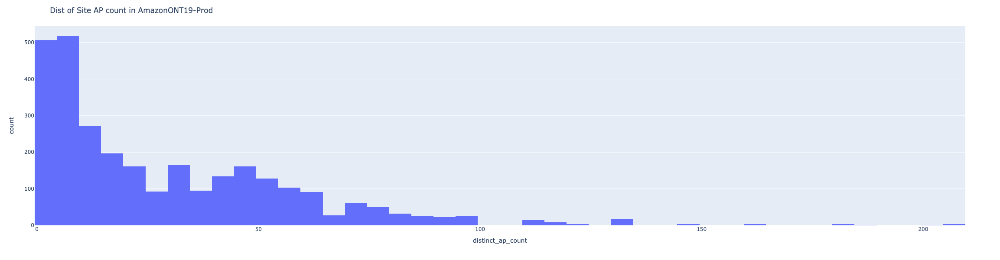

In [15]:
%%local
fig = px.histogram(df_amzn_count,x="distinct_ap_count")
fig.update_layout(height=600, width=800)
fig.update_layout(
    title="Dist of Site AP count in AmazonONT19-Prod")
fig.show()

/opt/conda/lib/python3.7/site-packages/sparkmagic/kernels/pysparkkernel/pysparkkernel.py:2: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



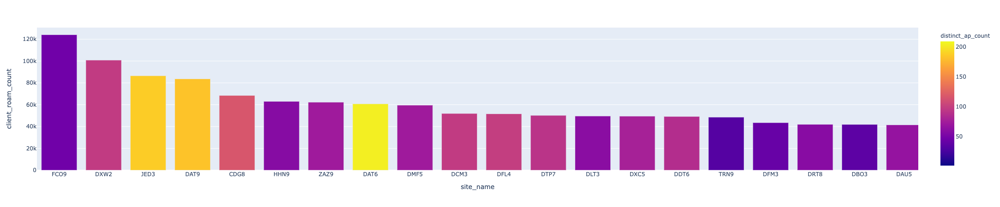

In [6]:
%%local
temp_01=df_amzn_count.rename(columns={"distinct_tpap_count": "distinct_toap_count"})
temp = temp_01.groupby("site_name")["client_roam_count","distinct_ap_count","distinct_toap_count","distinct_fromap_count"].mean().reset_index()

fig = px.bar(temp,y="client_roam_count",x="site_name",hover_data=["distinct_ap_count","distinct_toap_count","distinct_fromap_count"],color="distinct_ap_count")
fig.update_xaxes(categoryorder='total descending')
fig.show()

In [ ]:
%%local
t = {}
menu_list = []
temp = temp_01.sort_values(by=["date"])

show_all = {}
show_all["method"] ="update"
show_all["label"]= "ALL"
t["args"] = [{"visible":[True for i in range(len(temp["site_name"]))]},
                       {"title":site}]
menu_list.append(show_all)
for site in temp["site_name"]:
    t["label"] = site
    t["method"] = "update"
    t["args"] = [{"visible":temp["site_name"]==site},
                       {"title":site}]
    menu_list.append(t)
    t={}
fig = px.line(temp,y="client_roam_count",x="date",color="site_name")
fig.update_layout(
    updatemenus=[
        dict(active=0,
            buttons=menu_list
        )
    ]
)
fig.show()


## Amzn FCO9 Roaming

In [24]:
site_id = 'a94edc02-67a6-438e-8879-d6b083dfc1cf'
for d in range(1,2):
            current_date = datetime.now() - timedelta(days=d)
            date = "{}".format(current_date.date())
            h = "*"
            input_files = "s3://mist-secorapp-production/client-roam/client-roam-production/dt={}/*".format(date)

            df_FCO9 = spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1])).filter(lambda x: x["SiteID"]==site_id).toDF()\
                        .groupby("OrgID","SiteID","wc")\
                            .agg(F.count("when").alias("client_roam_count")).persist()

            df_FCO9.sort(F.desc("client_roam_count")).show(truncate=False)


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------------------------------+------------------------------------+-----------------+-----------------+
|OrgID                               |SiteID                              |wc               |client_roam_count|
+------------------------------------+------------------------------------+-----------------+-----------------+
|5a578f3c-f094-4d13-a7dd-96f0aaecb5b6|a94edc02-67a6-438e-8879-d6b083dfc1cf|94-fb-29-97-df-ba|3309             |
|5a578f3c-f094-4d13-a7dd-96f0aaecb5b6|a94edc02-67a6-438e-8879-d6b083dfc1cf|78-b8-d6-16-34-89|2823             |
|5a578f3c-f094-4d13-a7dd-96f0aaecb5b6|a94edc02-67a6-438e-8879-d6b083dfc1cf|94-fb-29-95-81-10|2538             |
|5a578f3c-f094-4d13-a7dd-96f0aaecb5b6|a94edc02-67a6-438e-8879-d6b083dfc1cf|94-fb-29-95-86-26|2535             |
|5a578f3c-f094-4d13-a7dd-96f0aaecb5b6|a94edc02-67a6-438e-8879-d6b083dfc1cf|78-b8-d6-16-30-8a|2348             |
|5a578f3c-f094-4d13-a7dd-96f0aaecb5b6|a94edc02-67a6-438e-8879-d6b083dfc1cf|78-b8-d6-16-32-ca|2253       

In [31]:
df_FCO9.select("SiteID","WC","client_roam_count").sort(F.desc("client_roam_count")).show(20,truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------------------------------+-----------------+-----------------+
|SiteID                              |WC               |client_roam_count|
+------------------------------------+-----------------+-----------------+
|a94edc02-67a6-438e-8879-d6b083dfc1cf|94-fb-29-97-df-ba|3309             |
|a94edc02-67a6-438e-8879-d6b083dfc1cf|78-b8-d6-16-34-89|2823             |
|a94edc02-67a6-438e-8879-d6b083dfc1cf|94-fb-29-95-81-10|2538             |
|a94edc02-67a6-438e-8879-d6b083dfc1cf|94-fb-29-95-86-26|2535             |
|a94edc02-67a6-438e-8879-d6b083dfc1cf|78-b8-d6-16-30-8a|2348             |
|a94edc02-67a6-438e-8879-d6b083dfc1cf|78-b8-d6-16-32-ca|2253             |
|a94edc02-67a6-438e-8879-d6b083dfc1cf|94-fb-29-97-da-17|2164             |
|a94edc02-67a6-438e-8879-d6b083dfc1cf|78-b8-d6-13-d2-e7|2161             |
|a94edc02-67a6-438e-8879-d6b083dfc1cf|78-b8-d6-16-35-d8|2060             |
|a94edc02-67a6-438e-8879-d6b083dfc1cf|78-b8-d6-13-d2-ba|2030             |
|a94edc02-67a6-438e-8879-

In [26]:
%%spark -o df_FCO9

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

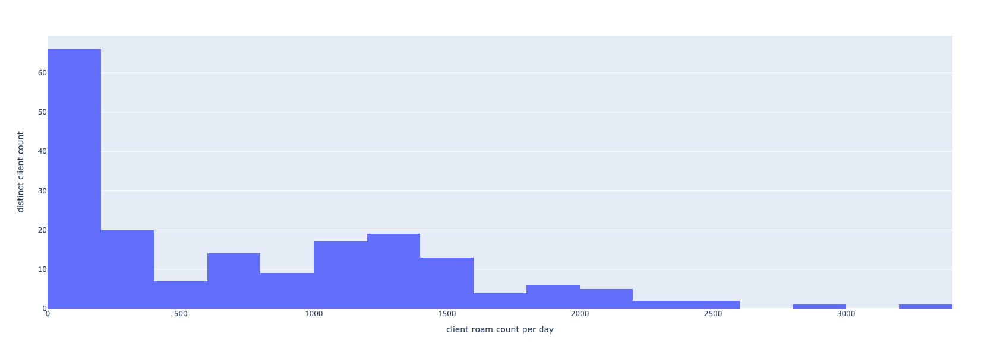

In [27]:
%%local
fig = px.histogram(df_FCO9,x="client_roam_count")
fig.update_layout(height=600, width=800)
fig.update_layout(
    xaxis_title="client roam count per day",
    yaxis_title="distinct client count",
)
fig.show()

In [29]:
%%local 
df_FCO9[df_FCO9["client_roam_count"]>1000].count()

OrgID                70
SiteID               70
wc                   70
client_roam_count    70
dtype: int64

In [30]:
df_FCO9.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

186

## Per AP

In [4]:
site_id = 'a94edc02-67a6-438e-8879-d6b083dfc1cf'
for d in range(1,2):
            current_date = datetime.now() - timedelta(days=d)
            date = "{}".format(current_date.date())
            h = "*"
            input_files = "s3://mist-secorapp-production/client-roam/client-roam-production/dt={}/*".format(date)

            df_FCO9 = spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1])).filter(lambda x: x["SiteID"]==site_id).toDF()\
                        .persist()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [6]:
env = "production"
df_device_name = spark.read.parquet("s3://mist-secorapp-{}/dimension/device".format(env))\
                .select("name","mac",F.col("site_id").alias("SiteID"))
df_FCO9_ap_pair = df_FCO9.groupby("SiteID","FromAP","ToAP").agg(F.count("When").alias("event_count"),F.countDistinct("WC").alias("distinct_client_count"))\
        .withColumn("FromAP",F.regexp_replace("FromAP","-",""))\
        .withColumn("ToAP",F.regexp_replace("ToAP","-",""))\
        .join(df_device_name.select(F.col("name").alias("FromAP_name"),F.col("mac").alias("FromAP"),"SiteID"),["FromAP","SiteID"])\
        .join(df_device_name.select(F.col("name").alias("ToAP_name"),F.col("mac").alias("ToAP"),"SiteID"),["ToAP","SiteID"])
#df_FCO9_ap_pair.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [53]:
df_FCO9_ap_pair.select("SiteID","FromAP","ToAP","FromAP_name","ToAP_name","event_count","distinct_client_count").sort(F.desc("event_count")).show(20)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+------------+------------+--------------+-------------+-----------+---------------------+
|              SiteID|      FromAP|        ToAP|   FromAP_name|    ToAP_name|event_count|distinct_client_count|
+--------------------+------------+------------+--------------+-------------+-----------+---------------------+
|a94edc02-67a6-438...|d420b080d697|d420b080d6bf| FCO9-03-00019|FCO9-03-00018|       2502|                  105|
|a94edc02-67a6-438...|d420b080d6bf|d420b080d697| FCO9-03-00018|FCO9-03-00019|       2451|                  109|
|a94edc02-67a6-438...|d420b080d4c6|d420b080d6d3| FCO9-04-00022|FCO9-04-00020|       2393|                  101|
|a94edc02-67a6-438...|d420b080d6bf|d420b080d6d3| FCO9-03-00018|FCO9-04-00020|       2197|                  101|
|a94edc02-67a6-438...|d420b080d6d3|d420b080d6b0| FCO9-04-00020|FCO9-04-00017|       2075|                   92|
|a94edc02-67a6-438...|d420b080d6b0|d420b080d6bf| FCO9-04-00017|FCO9-03-00018|       2054|               

In [7]:
%%spark -o df_FCO9_ap_pair -n 1118

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

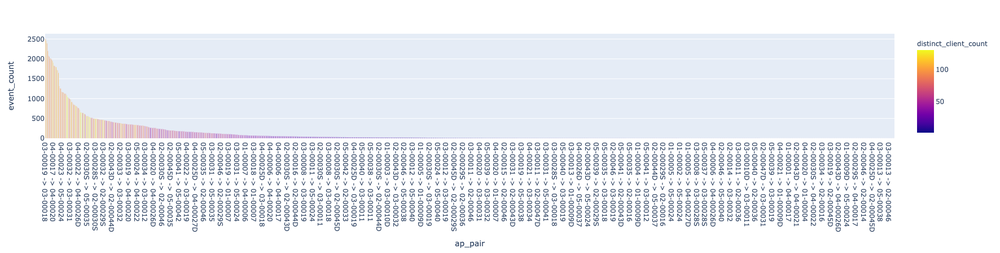

In [55]:
%%local
df_FCO9_ap_pair["ap_pair"] = df_FCO9_ap_pair[["FromAP_name","ToAP_name"]].apply(lambda x: "{} -> {}".format(x[0][5:],x[1][5:]),axis=1)
fig = px.bar(df_FCO9_ap_pair,y="event_count",x="ap_pair",color="distinct_client_count")
fig.update_xaxes(categoryorder='total descending')
fig.show()

compare the roaming ap pair distribution shape with other sites. 
(Roaming hotspot)

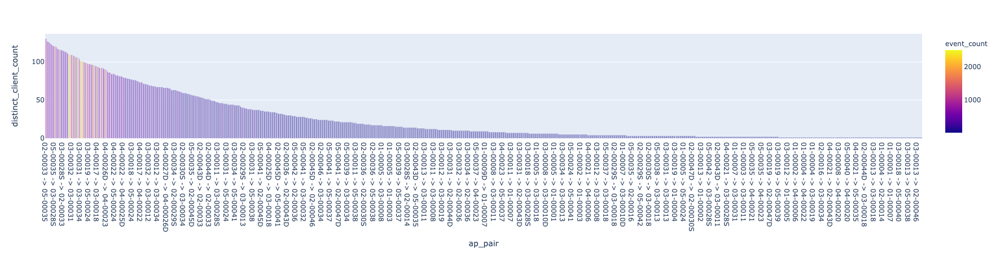

In [56]:
%%local
#df_FCO9_ap_pair["ap_pair"] = df_FCO9_ap_pair[["FromAP_name","ToAP_name"]].apply(lambda x: "{} -> {}".format(x[0][5:],x[1][5:]),axis=1)
fig = px.bar(df_FCO9_ap_pair,y="distinct_client_count",x="ap_pair",color="event_count")
fig.update_xaxes(categoryorder='total descending')
fig.show()

In [ ]:
## find excessive roam

def roam_time_diff(roam_time):
    roam_time_diff_sorted = sorted([datetime.strptime(rt[0:19].replace("T"," "), '%Y-%m-%d %H:%M:%S') for rt in roam_time])
    i = 0 ;
    t_diff = []
    while i < len(roam_time_diff_sorted)-1:
        temp = roam_time_diff_sorted[i+1] - roam_time_diff_sorted[i]
        t_diff.append(temp.total_seconds())
        i+=1
    return [int(i) for i in t_diff]

roam_time_diffUDF = F.udf(roam_time_diff,ArrayType(IntegerType()))
                      
                      
df_roam_time= df_FCO9.agg("SiteID","WC").agg(F.collect_list("when").alias("roaming_time"))\
                            .withColumn("roam_timedelta_in_sec",F.explode(roam_time_diffUDF("roaming_time")))\
                                .withColumn("roam_timedelta_in_sec",F.when(F.col("roam_timedelta_in_sec")>60,60).otherwise(F.col("roam_timedelta_in_sec")))\
                                .groupby("org_name","site_name","SiteID","roam_timedelta_in_sec").agg(F.count("WC").alias("event_count"))
    
df_roam_time.count()

In [12]:
import json
from pyspark.sql import SparkSession
import pyspark.sql.functions as F
from pyspark.sql.types import *
import json,boto3
from datetime import datetime,timedelta
import queue
from statistics import median

def frequent_roam(roam_stats):
    #print(roam_stats)
    roam_stats_sorted = sorted(roam_stats, key=lambda x:x[0])
    pingpong =[]
    max_size = 100
    q = queue.LifoQueue(max_size)
    q.put(roam_stats_sorted[0])
    current_node = roam_stats_sorted[0]
    potential_pingpong = []
    for r in range(1,len(roam_stats_sorted)):
        t_diff = roam_stats_sorted[r]["time"] - current_node["time"]
        #print(current_node)
        if t_diff.total_seconds() > 30 or r==(len(roam_stats_sorted)-1) or q.qsize()>=max_size: # if roams after more than 30 s cant be ping pong roam 
            number_of_roam = q.qsize()
            while not q.empty():
                if number_of_roam > 3:
                    temp = q.get()
                    potential_pingpong.append([temp["time"],temp["FromAP"],temp["ToAP"],\
                                                temp["Band"],temp["PrevBand"],temp["CurrentRSSI"],\
                                                temp["PrevRSSI"],temp["MsgType"],temp["SampleCount"]])
                else:
                    q.get()
        if len(potential_pingpong)>1:
            pingpong.append(potential_pingpong)
        potential_pingpong = []
        q.put(roam_stats_sorted[r])
        current_node = roam_stats_sorted[r]
    return pingpong


schema = ArrayType(ArrayType(StructType([StructField("time", TimestampType(),True),
                               StructField("FromAP", StringType(), True),
                               StructField("ToAP", StringType(), True),
                               StructField("Band", StringType(), True),
                               StructField("PrevBand", StringType(), True),
                               StructField("CurrentRSSI", StringType(), True),
                               StructField("PrevRSSI", StringType(), True),
                               StructField("MsgType", StringType(), True),
                               StructField("SampleCount", IntegerType(), True),
                               ])))
                               
   
frequent_roamUDF = F.udf(frequent_roam,schema)


def leaving_client(stats):
    for i in stats:
        if i["MsgType"] =="client_disassociate" or i["MsgType"]=="msg_expired":
            return True
    return False

def ap_count(stats):
    aps = set()
    for i in stats:
        aps.add(i["FromAP"])
        aps.add(i["ToAP"])
    return len(aps)

def pingpong_sequence(pingpong):
    for p in range(len(pingpong)-1):
        if (pingpong[p]["ToAP"] != pingpong[p+1]["FromAP"]) and  (pingpong[p]["Band"] != pingpong[p+1]["PrevBand"]):
            return False
    return True

pingpong_sequenceUDF = F.udf(pingpong_sequence,BooleanType())

ap_countUDF = F.udf(ap_count,IntegerType())

leaving_clientUDF = F.udf(leaving_client,BooleanType())

def pingpong_sequence(pingpong):
    pingpong_sorted = sorted(pingpong, key=lambda x:x[0])
    for p in range(len(pingpong_sorted)-1):
        if (pingpong_sorted[p]["ToAP"] != pingpong_sorted[p+1]["FromAP"]) and  (pingpong_sorted[p]["Band"] != pingpong_sorted[p+1]["PrevBand"]):
            return False
    return True

def pingpong_rssi(excessive_roams):
    min_rssi = 0
    max_rssi = -100
    rssi = []
    for p in excessive_roams:
        current_rssi = int(p["CurrentRSSI"])
        prev_rssi = int(p["PrevRSSI"])
        rssi.append(current_rssi)
        rssi.append(prev_rssi)
        max_rssi = max(max_rssi,current_rssi,prev_rssi)
        min_rssi = min(min_rssi,current_rssi,prev_rssi)
    return max_rssi,int(median(rssi)),min_rssi

schema = StructType([
    StructField("max_pingpong_rssi", IntegerType(), True),
    StructField("median_pingpong_rssi", IntegerType(), True),
    StructField("min_pingpong_rssi", IntegerType(), True)])


pingpong_sequenceUDF = F.udf(pingpong_sequence,BooleanType())
pingpong_rssiUDF = F.udf(pingpong_rssi,schema)


df_excessive_roam= df_FCO9\
                .groupby("SiteID","WC").agg(F.collect_list(F.struct(F.to_timestamp("When").alias("time"),\
                          "FromAP","ToAP","CurrentRSSI","PrevRSSI","Band","PrevBand","MsgType","SampleCount"))\
                                                                                .alias("roam_stats"))\
                .withColumn("total_roam_per_client",F.size("roam_stats"))\
                .withColumn("excessive_roams",F.explode(frequent_roamUDF("roam_stats")))\
                                .withColumn("#_roam",F.size("excessive_roams"))\
                                .withColumn("excessive_roam_ap_count",ap_countUDF("excessive_roams"))\
                                .withColumn("leaving_client",leaving_clientUDF("excessive_roams"))\
                                .withColumn("continuous_excessive_roams", pingpong_sequenceUDF("excessive_roams"))\
                                .withColumn("rssi", pingpong_rssiUDF("excessive_roams"))


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [15]:
df_pp = df_excessive_roam.filter((F.col("continuous_excessive_roams") == True) & (F.col("leaving_client")==False))
df_avg_roam = df_pp.groupby("#_roam","excessive_roam_ap_count").agg(F.count("WC").alias("event_count"))
df_avg_roam.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

367

In [16]:
%%spark -o df_avg_roam

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

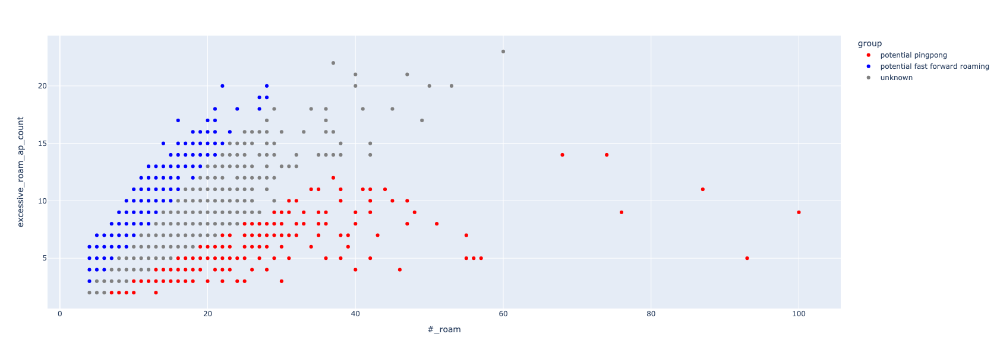

In [18]:
%%local
df_avg_roam["avg_roam_per_ap"] = df_avg_roam["#_roam"]/df_avg_roam["excessive_roam_ap_count"]
df_avg_roam["group"] = df_avg_roam["avg_roam_per_ap"].apply(lambda x:  "potential pingpong"  if x>3 else ("potential fast forward roaming") if x<=1.5 else "unknown")

fig = px.scatter(df_avg_roam,y = "excessive_roam_ap_count", x = "#_roam", hover_data = ["avg_roam_per_ap"],color = "group",
                color_discrete_sequence=["red","blue","gray"] )
fig.update_layout(height=600, width=1300)
fig.show()

In [20]:
%%local
df_avg_roam.groupby("group")["#_roam"].sum()

group
potential fast forward roaming    1251
potential pingpong                3752
unknown                           3536
Name: #_roam, dtype: int64

In [50]:
df_potential_pp = df_pp.withColumn("avg_roam_per_ap", F.col("#_roam")/F.col("excessive_roam_ap_count"))\
            .withColumn("group",excessive_roam_groupUDF("avg_roam_per_ap"))\
            .filter(F.col("group")=="potential pingpong")\
            .withColumn("excessive_roams",F.explode("excessive_roams"))\
            .select("WC","total_roam_per_client","#_roam","excessive_roam_ap_count","excessive_roams.FromAP","excessive_roams.ToAP",\
                    "excessive_roams.Band","excessive_roams.PrevBand","excessive_roams.CurrentRSSI","excessive_roams.PrevRSSI","excessive_roams.time")\
        .withColumn("FromAP",F.regexp_replace("FromAP","-",""))\
        .withColumn("ToAP",F.regexp_replace("ToAP","-",""))\
        .join(df_device_name.select(F.col("name").alias("FromAP_name"),F.col("mac").alias("FromAP")),["FromAP"])\
        .join(df_device_name.select(F.col("name").alias("ToAP_name"),F.col("mac").alias("ToAP")),["ToAP"])
df_potential_pp.sort("WC","time").show(500,truncate=False)
            
Find the rrm neightbor map

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+------------+-----------------+---------------------+------+-----------------------+----+--------+-----------+--------+--------------------------+--------------+--------------+
|ToAP        |FromAP      |WC               |total_roam_per_client|#_roam|excessive_roam_ap_count|Band|PrevBand|CurrentRSSI|PrevRSSI|time                      |FromAP_name   |ToAP_name     |
+------------+------------+-----------------+---------------------+------+-----------------------+----+--------+-----------+--------+--------------------------+--------------+--------------+
|d420b080d6ba|d420b080d6d3|78-b8-d6-08-34-38|331                  |15    |3                      |5   |5       |-65        |-63     |2021-10-06 08:33:11.150647|FCO9-04-00020 |FCO9-04-00023 |
|d420b080d6d3|d420b080d6ba|78-b8-d6-08-34-38|331                  |15    |3                      |5   |5       |-57        |-65     |2021-10-06 08:33:14.779148|FCO9-04-00023 |FCO9-04-00020 |
|d420b080d110|d420b080d6d3|78-b8-d6-08-34-38|

In [27]:
df_potential_pp = df_pp.withColumn("avg_roam_per_ap", F.col("#_roam")/F.col("excessive_roam_ap_count"))\
            .withColumn("group",excessive_roam_groupUDF("avg_roam_per_ap"))\
            .filter(F.col("group")=="potential pingpong")\
            .withColumn("excessive_roams",F.explode("excessive_roams"))\
            .select("WC","total_roam_per_client","#_roam","excessive_roam_ap_count","excessive_roams.FromAP","excessive_roams.ToAP",\
                    "excessive_roams.Band","excessive_roams.PrevBand","excessive_roams.CurrentRSSI","excessive_roams.PrevRSSI","excessive_roams.time")

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [28]:
df_potential_pp.printSchema()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

root
 |-- WC: string (nullable = true)
 |-- total_roam_per_client: integer (nullable = false)
 |-- #_roam: integer (nullable = false)
 |-- excessive_roam_ap_count: integer (nullable = true)
 |-- FromAP: string (nullable = true)
 |-- ToAP: string (nullable = true)
 |-- Band: string (nullable = true)
 |-- PrevBand: string (nullable = true)
 |-- CurrentRSSI: string (nullable = true)
 |-- PrevRSSI: string (nullable = true)
 |-- time: timestamp (nullable = true)

In [34]:
df_pp_ap_pair = df_potential_pp.withColumn("FromAP",F.regexp_replace("FromAP","-",""))\
        .withColumn("ToAP",F.regexp_replace("ToAP","-",""))\
        .join(df_device_name.select(F.col("name").alias("FromAP_name"),F.col("mac").alias("FromAP")),["FromAP"])\
        .join(df_device_name.select(F.col("name").alias("ToAP_name"),F.col("mac").alias("ToAP")),["ToAP"])\
        .groupby("FromAP","ToAP","FromAP_name","ToAP_name").agg(F.count("time").alias("potential_pingpong_roam_count"))
df_pp_ap_pair.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

389

In [35]:
%%spark -o df_pp_ap_pair

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

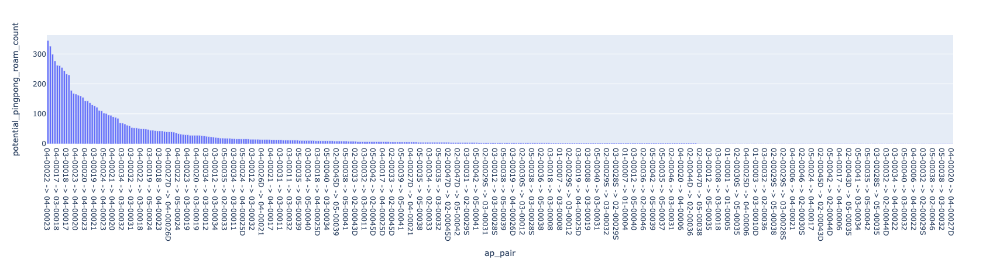

In [36]:
%%local
df_pp_ap_pair["ap_pair"] = df_pp_ap_pair[["FromAP_name","ToAP_name"]].apply(lambda x: "{} -> {}".format(x[0][5:],x[1][5:]),axis=1)
fig = px.bar(df_pp_ap_pair,y="potential_pingpong_roam_count",x="ap_pair")
fig.update_xaxes(categoryorder='total descending')
fig.show()

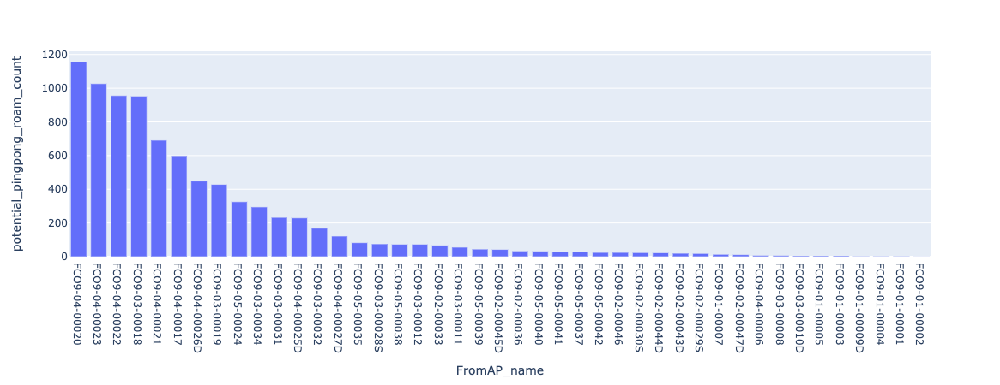

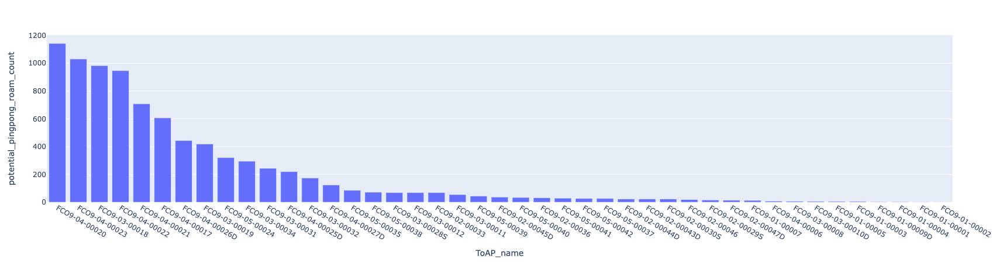

In [48]:
%%local
temp = df_pp_ap_pair.groupby(["FromAP_name","FromAP"])["potential_pingpong_roam_count"].sum().reset_index()
fig = px.bar(temp,y="potential_pingpong_roam_count",x="FromAP_name",hover_data=["FromAP"])
fig.update_xaxes(categoryorder='total descending')
fig.show()

temp = df_pp_ap_pair.groupby(["ToAP_name","ToAP"])["potential_pingpong_roam_count"].sum().reset_index()
fig = px.bar(temp,y="potential_pingpong_roam_count",x="ToAP_name",hover_data=["ToAP"])
fig.update_xaxes(categoryorder='total descending')
fig.show()

In [ ]:
RRM map
Roaming ap map 
Two graphs comparison on rrm strong neighbor and roaming graph. 

# Coppell IDS School Roam Per Sec

In [4]:
df_org= spark.read.parquet("s3://mist-secorapp-production/dimension/org")\
        .select(F.col("id").alias("org_id"),F.col("name").alias("org_name"))

df_site= spark.read.parquet("s3://mist-secorapp-production/dimension/site")\
        .select(F.col("id").alias("site_id"),F.col("name").alias("site_name"),"org_id")

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [8]:
d

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

5

In [9]:
site_id = 'ffb0eabf-2585-47dd-ad56-127c8c061683'

for d in range(5,15):
            current_date = datetime.now() - timedelta(days=d)
            date = "{}".format(current_date.date())
            h = "*"
            input_files = "s3://mist-secorapp-production/cv-sle-roaming-multipartition-v2/cv-sle-roaming-multipartition-v2-production/dt={}/*".format(date)

            df_coppell_roam = spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1])).filter(lambda x: x["site_id"]==site_id).toDF()\
                        .join(df_site,["org_id","site_id"])

            df_coppell_roam.coalesce(20).write.mode("overwrite")\
                                        .parquet("s3://mist-data-science-dev/may/roaming-exploration/coppell-roam-count/date={}".format(date))


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [5]:
df_roam = spark.read.parquet("s3://mist-data-science-dev/may/roaming-exploration/coppell-roam-count/")
df_roam.show(3)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+-----------------+----+----------+---------------+---------+-----------+--------------------+--------+-----------------+-----+-------+-------+-----------+-----------------+---------+---------+------+----+---------+-------------+-----+--------------------+---------+----------+
|              org_id|             site_id|           ap_mac|band|classifier|classifier_rank|client_os|client_type|         client_wcid|duration|en_client_sle_agg|ex_wl|latency| metric|metric_rank|      prev_ap_mac|prev_band|prev_rssi|reason|rssi|threshold|         time|value|             wlan_id|site_name|      date|
+--------------------+--------------------+-----------------+----+----------+---------------+---------+-----------+--------------------+--------+-----------------+-----+-------+-------+-----------+-----------------+---------+---------+------+----+---------+-------------+-----+--------------------+---------+----------+
|05ecd967-81cf-492...|ffb0eabf-2585-47d.

In [13]:
df_roam.withColumn("time",F.to_timestamp(F.col("time")/1000))\
                .withColumn("timestamp_hour", F.date_trunc('hour',F.to_timestamp("time","yyyy-MM-dd HH:mm:ss")))\
                .withColumn("second", F.date_trunc('second',F.to_timestamp("time","yyyy-MM-dd HH:mm:ss")))\
                .groupby("site_name","site_id","timestamp_hour","second").agg(F.count("time").alias("roam_count_per_sec"),F.countDistinct("client_wcid").alias("distinct_client_count")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+---------+--------------------+-------------------+-------------------+------------------+---------------------+
|site_name|             site_id|     timestamp_hour|             second|roam_count_per_sec|distinct_client_count|
+---------+--------------------+-------------------+-------------------+------------------+---------------------+
|      CHS|ffb0eabf-2585-47d...|2021-10-04 20:00:00|2021-10-04 20:42:18|                 7|                    7|
|      CHS|ffb0eabf-2585-47d...|2021-10-05 21:00:00|2021-10-05 21:52:04|                14|                   11|
|      CHS|ffb0eabf-2585-47d...|2021-09-28 13:00:00|2021-09-28 13:16:24|                14|                   13|
|      CHS|ffb0eabf-2585-47d...|2021-10-05 13:00:00|2021-10-05 13:22:34|                18|                   18|
|      CHS|ffb0eabf-2585-47d...|2021-10-04 17:00:00|2021-10-04 17:28:00|                12|                   11|
|      CHS|ffb0eabf-2585-47d...|2021-10-07 20:00:00|2021-10-07 20:48:35|                

In [15]:
df_roam_per_day = df_roam.withColumn("time",F.to_timestamp(F.col("time")/1000))\
        .withColumn("date", F.to_date('time'))\
        .groupby("date").agg(F.countDistinct("client_wcid").alias("distinct_client_count"),F.count("time").alias("client_roam_count"))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [16]:
%%spark -o df_roam_per_day

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

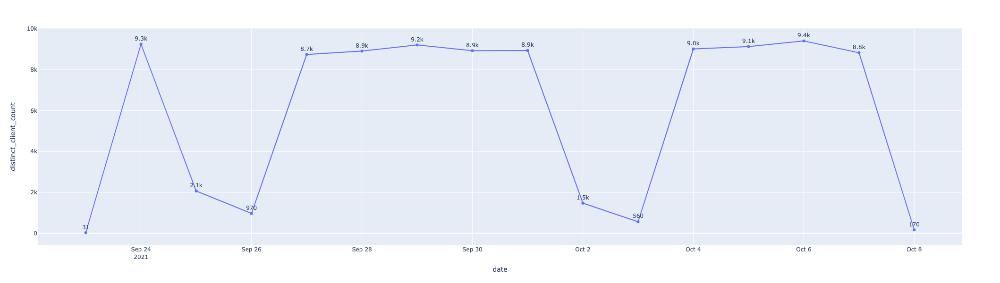

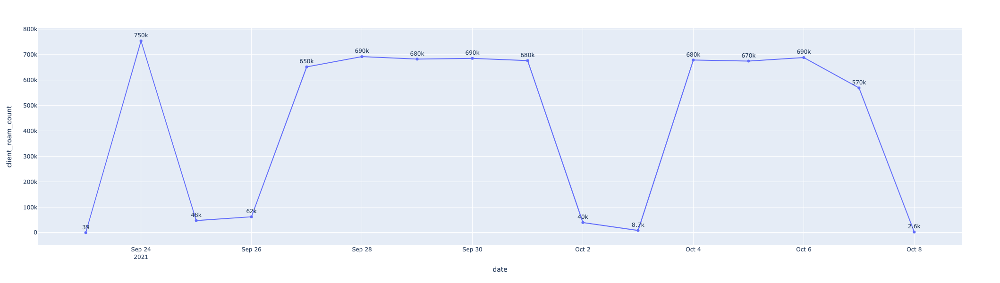

In [45]:
%%local
#df_roam_per_day = df_roam_per_day.sort_values("date")
fig = px.line(df_roam_per_day,x="date",y="distinct_client_count",text="distinct_client_count")
fig.update_traces(texttemplate='%{text:.2s}', textposition='top center')
#fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.update_layout(height=600, width=1500)
fig.show()
#fig.show()
fig = px.line(df_roam_per_day,x="date",y="client_roam_count",text="client_roam_count")
fig.update_traces(texttemplate='%{text:.2s}', textposition='top center')
#fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.update_layout(height=600, width=1500)
fig.show()
#fig.show()

In [47]:
df_roam_hourly = df_roam.withColumn("time",F.to_timestamp(F.col("time")/1000))\
                .withColumn("timestamp_hour", F.date_trunc('hour',F.to_timestamp("time","yyyy-MM-dd HH:mm:ss")))\
                .withColumn("second", F.date_trunc('second',F.to_timestamp("time","yyyy-MM-dd HH:mm:ss")))\
                .groupby("site_name","site_id","timestamp_hour","second").agg(F.count("time").alias("roam_count_per_sec"))\
                .groupby("site_name","site_id","timestamp_hour").agg(F.max("roam_count_per_sec").alias("max_roam_count_per_sec"),\
                                                                    F.min("roam_count_per_sec").alias("min_roam_count_per_sec"),\
                                                                    F.mean("roam_count_per_sec").alias("avg_roam_count_per_sec"))
df_roam_hourly.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

339

In [65]:
df_roam.withColumn("time",F.to_timestamp(F.col("time")/1000))\
                .withColumn("timestamp_hour", F.date_trunc('hour',F.to_timestamp("time","yyyy-MM-dd HH:mm:ss")))\
                .withColumn("second", F.date_trunc('second',F.to_timestamp("time","yyyy-MM-dd HH:mm:ss")))\
                .filter(F.col("timestamp_hour")=="2021-09-24 19:00:00+00:00")\
                .groupby("site_name","site_id","timestamp_hour","second").agg(F.count("time").alias("roam_count_per_sec"))\
                .filter(F.col("roam_count_per_sec")>300).show(truncate=False)
                

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+---------+------------------------------------+-------------------+-------------------+------------------+
|site_name|site_id                             |timestamp_hour     |second             |roam_count_per_sec|
+---------+------------------------------------+-------------------+-------------------+------------------+
|CHS      |ffb0eabf-2585-47dd-ad56-127c8c061683|2021-09-24 19:00:00|2021-09-24 19:30:46|306               |
|CHS      |ffb0eabf-2585-47dd-ad56-127c8c061683|2021-09-24 19:00:00|2021-09-24 19:30:50|312               |
|CHS      |ffb0eabf-2585-47dd-ad56-127c8c061683|2021-09-24 19:00:00|2021-09-24 19:30:51|305               |
|CHS      |ffb0eabf-2585-47dd-ad56-127c8c061683|2021-09-24 19:00:00|2021-09-24 19:30:57|303               |
|CHS      |ffb0eabf-2585-47dd-ad56-127c8c061683|2021-09-24 19:00:00|2021-09-24 19:30:49|324               |
|CHS      |ffb0eabf-2585-47dd-ad56-127c8c061683|2021-09-24 19:00:00|2021-09-24 19:30:44|302               |
|CHS      |ffb0eabf-2585-47d

In [68]:
df_roam.withColumn("time",F.to_timestamp(F.col("time")/1000))\
                .withColumn("timestamp_hour", F.date_trunc('hour',F.to_timestamp("time","yyyy-MM-dd HH:mm:ss")))\
                .withColumn("second", F.date_trunc('second',F.to_timestamp("time","yyyy-MM-dd HH:mm:ss")))\
                .filter((F.col("time")>"2021-09-24 19:30:45") &(F.col("time")<"2021-09-24 19:30:47"))\
                .select("site_id","ap_mac","prev_ap_mac","client_wcid","client_type","client_os","band","prev_band","rssi","prev_rssi","time","second").sort("client_wcid").show(100,truncate=False)


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------------------------------+-----------------+-----------------+------------------------------------+-----------+---------+----+---------+----+---------+-----------------------+-------------------+
|site_id                             |ap_mac           |prev_ap_mac      |client_wcid                         |client_type|client_os|band|prev_band|rssi|prev_rssi|time                   |second             |
+------------------------------------+-----------------+-----------------+------------------------------------+-----------+---------+----+---------+----+---------+-----------------------+-------------------+
|ffb0eabf-2585-47dd-ad56-127c8c061683|5c-5b-35-50-19-d7|5c-5b-35-50-1b-2b|003b809c-d0cb-01ed-97e2-a00de3e599c4|iPhone     |15.0     |5   |5        |-81 |-79      |2021-09-24 19:30:45.545|2021-09-24 19:30:45|
|ffb0eabf-2585-47dd-ad56-127c8c061683|5c-5b-35-50-50-14|5c-5b-35-50-3c-73|005dad7c-8a43-8d77-daef-0975d6251b5b|iPhone     |14.8     |5   |24       |-85 |-78      |2021-

In [48]:
%%spark -o df_roam_hourly

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [61]:
%%local
df_roam_hourly[df_roam_hourly["max_roam_count_per_sec"] > 300]

,site_name,site_id,timestamp_hour,max_roam_count_per_sec,min_roam_count_per_sec,avg_roam_count_per_sec
15,CHS,ffb0eabf-2585-47dd-ad56-127c8c061683,2021-09-24 19:00:00+00:00,334,1,27.855435
51,CHS,ffb0eabf-2585-47dd-ad56-127c8c061683,2021-09-29 17:00:00+00:00,320,3,37.578889
55,CHS,ffb0eabf-2585-47dd-ad56-127c8c061683,2021-09-30 17:00:00+00:00,344,1,38.596944
87,CHS,ffb0eabf-2585-47dd-ad56-127c8c061683,2021-09-28 17:00:00+00:00,314,2,37.537500
104,CHS,ffb0eabf-2585-47dd-ad56-127c8c061683,2021-10-01 19:00:00+00:00,311,1,26.145758
131,CHS,ffb0eabf-2585-47dd-ad56-127c8c061683,2021-10-04 19:00:00+00:00,313,1,25.749022
146,CHS,ffb0eabf-2585-47dd-ad56-127c8c061683,2021-09-29 19:00:00+00:00,317,1,25.363306
155,CHS,ffb0eabf-2585-47dd-ad56-127c8c061683,2021-10-06 19:00:00+00:00,301,1,26.322949
163,CHS,ffb0eabf-2585-47dd-ad56-127c8c061683,2021-10-05 17:00:00+00:00,337,2,38.176389
172,CHS,ffb0eabf-2585-47dd-ad56-127c8c061683,2021-09-27 19:00:00+00:00,316,1,25.777499


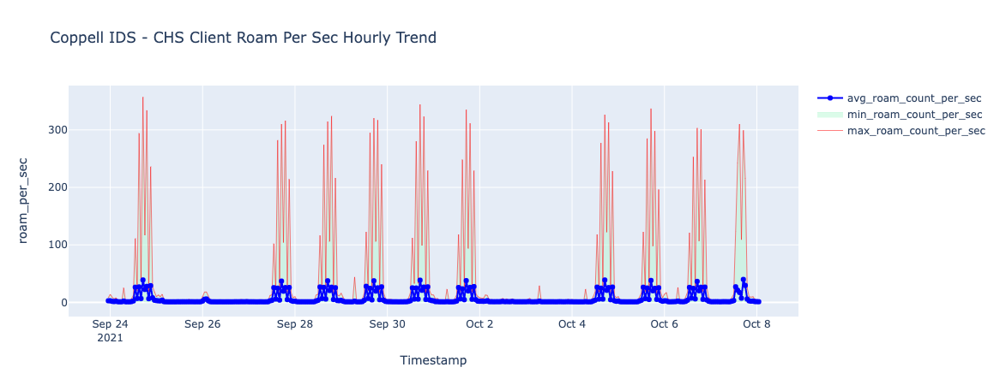

In [56]:
%%local
def roam_per_sec_trend(df):
    temp  =df.sort_values(by="timestamp_hour")
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=temp["timestamp_hour"],y=temp["max_roam_count_per_sec"],name="max_roam_count_per_sec", fill=None,line=dict(width=0.5, color='red')))# fill to trace0 y

    fig.add_trace(go.Scatter(x=temp["timestamp_hour"],y=temp["min_roam_count_per_sec"],name="min_roam_count_per_sec", fill='tonexty',line=dict(width=0.5,color= 'rgb(184, 247, 212)'))) # fill down to xaxis
    
    #fig.add_trace(go.Line(x=temp["date_hr"],y=temp["median_event_count"],name="median_roam_per_min")) # fill to trace0 y
    fig.add_trace(go.Scatter(x=temp["timestamp_hour"],y=temp["avg_roam_count_per_sec"],name="avg_roam_count_per_sec", mode='lines+markers',line=dict(color='blue', width=2))) # fill to trace0 y
    fig.update_layout(
        title="Coppell IDS - CHS Client Roam Per Sec Hourly Trend",
        xaxis_title="Timestamp",
        yaxis_title="roam_per_sec",
    )
    fig.show()


roam_per_sec_trend(df_roam_hourly) 

In [60]:
# Site AP pair distribution
df_roam_hourly = df_roam.withColumn("time",F.to_timestamp(F.col("time")/1000))\
                .withColumn("timestamp_hour", F.date_trunc('hour',F.to_timestamp("time","yyyy-MM-dd HH:mm:ss")))\
                .withColumn("second", F.date_trunc('second',F.to_timestamp("time","yyyy-MM-dd HH:mm:ss")))\
                .select("timestamp_hour","ap_mac","prev_ap_mac","client_wcid","second","time").show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+-------------------+-----------------+-----------------+--------------------+-------------------+--------------------+
|     timestamp_hour|           ap_mac|      prev_ap_mac|         client_wcid|             second|                time|
+-------------------+-----------------+-----------------+--------------------+-------------------+--------------------+
|2021-09-29 04:00:00|5c-5b-35-50-6f-63|5c-5b-35-50-68-6f|7961baa8-d0b3-d13...|2021-09-29 04:28:45|2021-09-29 04:28:...|
|2021-09-29 04:00:00|5c-5b-35-50-5b-c2|5c-5b-35-50-63-15|be30ed6f-e4c2-12d...|2021-09-29 04:29:42|2021-09-29 04:29:...|
|2021-09-29 04:00:00|5c-5b-35-50-5b-c2|5c-5b-35-50-63-15|be30ed6f-e4c2-12d...|2021-09-29 04:31:06|2021-09-29 04:31:...|
|2021-09-29 04:00:00|5c-5b-35-50-69-82|5c-5b-35-50-3f-2a|9c2a30b3-382b-691...|2021-09-29 04:31:41|2021-09-29 04:31:...|
|2021-09-29 04:00:00|5c-5b-35-50-5a-f5|5c-5b-35-50-6b-e9|4af25d5e-f3f8-4b3...|2021-09-29 04:32:08|2021-09-29 04:32:...|
|2021-09-29 04:00:00|5c-5b-35-50-69-dc|5

In [6]:
df_roam = spark.read.parquet("s3://mist-data-science-dev/may/roaming-exploration/coppell-roam-count/")
df_roam.show(3)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+-----------------+----+----------+---------------+---------+-----------+--------------------+--------+-----------------+-----+-------+-------+-----------+-----------------+---------+---------+------+----+---------+-------------+-----+--------------------+---------+----------+
|              org_id|             site_id|           ap_mac|band|classifier|classifier_rank|client_os|client_type|         client_wcid|duration|en_client_sle_agg|ex_wl|latency| metric|metric_rank|      prev_ap_mac|prev_band|prev_rssi|reason|rssi|threshold|         time|value|             wlan_id|site_name|      date|
+--------------------+--------------------+-----------------+----+----------+---------------+---------+-----------+--------------------+--------+-----------------+-----+-------+-------+-----------+-----------------+---------+---------+------+----+---------+-------------+-----+--------------------+---------+----------+
|05ecd967-81cf-492...|ffb0eabf-2585-47d.

In [ ]:
df_roam.groupby("ap_mac","prev_ap_mac").agg(F.count("time").alias("roam_event"))

In [10]:
env = "production"
df_device_name = spark.read.parquet("s3://mist-secorapp-{}/dimension/device".format(env))\
                .select("name","mac","site_id")
df_ap_pair = df_roam.groupby("site_id","ap_mac","prev_ap_mac").agg(F.count("time").alias("event_count"),F.countDistinct("client_wcid").alias("distinct_client_count"))\
        .withColumn("ap_mac",F.regexp_replace("ap_mac","-",""))\
        .withColumn("prev_ap_mac",F.regexp_replace("prev_ap_mac","-",""))\
        .join(df_device_name.select(F.col("name").alias("FromAP_name"),F.col("mac").alias("prev_ap_mac"),"site_id"),["prev_ap_mac","site_id"])\
        .join(df_device_name.select(F.col("name").alias("ToAP_name"),F.col("mac").alias("ap_mac"),"site_id"),["ap_mac","site_id"])
df_ap_pair.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

18283

In [11]:
%%spark -o df_ap_pair -n 18283

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

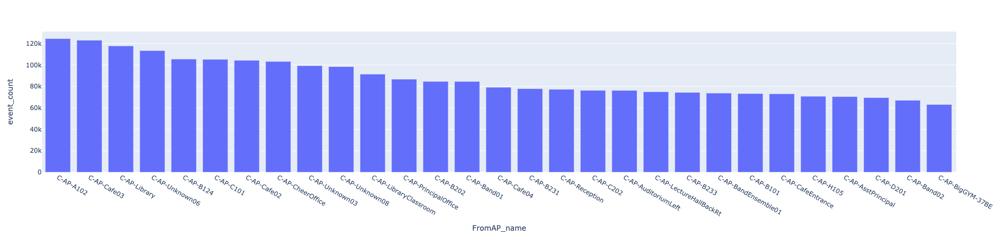

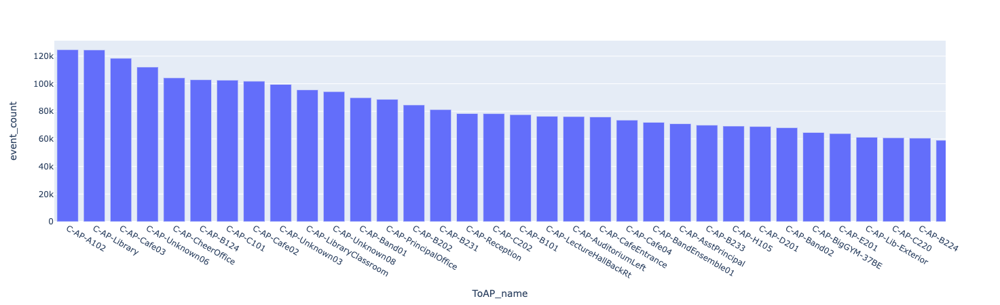

In [14]:
%%local
temp = df_ap_pair.groupby(["FromAP_name","prev_ap_mac"])["event_count"].sum().reset_index()
fig = px.bar(temp,y="event_count",x="FromAP_name",hover_data=["prev_ap_mac"])
fig.update_xaxes(categoryorder='total descending')
fig.show()

temp = df_ap_pair.groupby(["ToAP_name","ap_mac"])["event_count"].sum().reset_index()
fig = px.bar(temp,y="event_count",x="ToAP_name",hover_data=["ap_mac"])
fig.update_xaxes(categoryorder='total descending')
fig.show()

# AP Stats Full Beacon Data (Chan Util Analysis)

In [5]:
df = spark.read.parquet("s3://mist-secorapp-production/ap-stats-full/ap-stats-full-production/dt=2021-11-04/hr=10/")
df.printSchema()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

root
 |-- id: binary (nullable = true)
 |-- org_id: binary (nullable = true)
 |-- groups: array (nullable = true)
 |    |-- element: string (containsNull = true)
 |-- site_id: binary (nullable = true)
 |-- when: struct (nullable = true)
 |    |-- seconds: long (nullable = true)
 |    |-- nanos: integer (nullable = true)
 |-- map_id: binary (nullable = true)
 |-- xyz: array (nullable = true)
 |    |-- element: double (containsNull = true)
 |-- uptime: integer (nullable = true)
 |-- model: string (nullable = true)
 |-- firmware_version: string (nullable = true)
 |-- configured: boolean (nullable = true)
 |-- license_expired: boolean (nullable = true)
 |-- interval: double (nullable = true)
 |-- proc: struct (nullable = true)
 |    |-- mem_info: struct (nullable = true)
 |    |    |-- total_kb: long (nullable = true)
 |    |    |-- available_kb: long (nullable = true)
 |    |-- slab_info: struct (nullable = true)
 |    |    |-- top: struct (nullable = true)
 |    |    |    |-- name: strin

In [7]:
# https://manage.mist.com/admin/?org_id=d8cec22e-e0c2-11e5-8d0f-02e208b2d34f#!ap/de78f6cc-425f-4620-ab03-ee53334b057a
site_id = "de78f6cc-425f-4620-ab03-ee53334b057a"
save_file_name = "non_wifi_data_comp_ABE5"

for date in ["2021-12-22" ]: #","2021-12-24"]:
#for d in range(0,6):
    #current_date = datetime.now() - timedelta(days=d)
    #date = "{}".format(current_date.date())
    for h in range(0,24):
        hr = "{}".format(str(h).zfill(2))
        try:
            df = spark.read.parquet("s3://mist-secorapp-production/ap-stats-full/ap-stats-full-production/dt={}/hr={}/".format(date,hr))\
                .withColumn("radios",F.explode("radios"))\
                        .filter(F.col("radios.bandwidth")>0)\
                        .select(convert_bytes_to_uuidUDF("org_id").alias("org_id"),\
                        convert_bytes_to_uuidUDF("site_id").alias("site_id"),\
                        convert_bytes_to_macUDF("id").alias("ap_id"),\
                        band_from_indexUDF(F.col("radios.band")).alias("band"),"radios.channel","radios.bandwidth","radios.num_clients",\
                        F.col("radios.chan_util.max.unknown_wifi").alias("unknown_wifi_max"),\
                         F.col("radios.chan_util.max.non_wifi").alias("non_wifi_max"),\
                         F.col("radios.chan_util.mean.unknown_wifi").alias("unknown_wifi_mean"),\
                         F.col("radios.chan_util.mean.non_wifi").alias("non_wifi_mean"),\
                         F.col("radios.chan_util.chan_im_mean.non_wifi").alias("chan_im_non_wifi_mean"),\
                         F.col("radios.chan_util.chan_im_mean.unknown_wifi").alias("chan_im_unknown_wifi_mean"),\
                         F.col("radios.chan_util.chan_im_max.unknown_wifi").alias("chan_im_unknown_wifi_max"),\
                         F.col("radios.chan_util.chan_im_max.non_wifi").alias("chan_im_non_wifi_max"),\
                         F.col("radios.noise_floor").alias("noise_floor"),\
                         F.col("radios.utilization.tx").alias("util_tx"),\
                         F.to_timestamp("When.seconds").alias("When"))\
                        .filter(F.col("site_id")==site_id)\
                        .groupby("site_id","ap_id","band","channel").agg(F.mean("util_tx").alias("util_tx"),\
                                                                         F.mean("noise_floor").alias("avg_noise_floor"),\
                                                                            F.mean("non_wifi_max").alias("avg_non_wifi_max"),\
                                                                                     F.mean("non_wifi_mean").alias("avg_non_wifi_mean"),\
                                                                                     F.mean("chan_im_non_wifi_max").alias("avg_chan_im_non_wifi_max"),\
                                                                                     F.mean("chan_im_non_wifi_mean").alias("avg_chan_im_non_wifi_mean"),\
                                                                                     F.mean("unknown_wifi_max").alias("avg_unknown_wifi_max"),\
                                                                                     F.mean("unknown_wifi_mean").alias("avg_unknown_wifi_mean"),\
                                                                                     F.mean("chan_im_unknown_wifi_mean").alias("avg_chan_im_unknown_wifi_mean"),\
                                                                                     F.mean("chan_im_unknown_wifi_max").alias("avg_chan_im_unknown_wifi_max"),
                                                                                      F.mean("num_clients").alias("avg_num_clients"),\
                                                                                      F.max("num_clients").alias("max_num_clients"))\
                        .withColumn("avg_non_wifi_max_diff", F.round(100*F.col("avg_non_wifi_max") - F.col("avg_chan_im_non_wifi_max"),0))\
                        .withColumn("avg_unknown_wifi_max_diff", F.round(100*F.col("avg_unknown_wifi_max") - F.col("avg_chan_im_unknown_wifi_max"),0))\
                        .withColumn("avg_non_wifi_mean_diff", F.round(100*F.col("avg_non_wifi_mean") - F.col("avg_chan_im_non_wifi_mean"),0))\
                        .withColumn("avg_unknown_wifi_mean_diff", F.round(100*F.col("avg_unknown_wifi_mean") - F.col("avg_chan_im_unknown_wifi_mean"),0))\


        #                          "non_wifi_max_diff","unknown_wifi_max_diff","non_wifi_mean_diff","unknown_wifi_mean_diff")\
        #                     .agg(F.count("site_id").alias("msg_count"))
            df.coalesce(1).write.mode("overwrite").parquet("s3://mist-data-science-dev/may/rrm/{}/date={}/hr={}".format(save_file_name,date,hr))
        except:
            None
    
#.withColumn("utilization_non_wifi_final",non_wifi_finalUDF("utilization_non_wifi","utilization_unknown_wifi"))\
#.withColumn("non_wifi_max_final",non_wifi_finalUDF("non_wifi_max","unknown_wifi_max"))\
#.withColumn("non_wifi_mean_final",non_wifi_finalUDF("non_wifi_mean","unknown_wifi_mean"))\
# F.col("radios.utilization.non_wifi").alias("utilization_non_wifi"),\
# F.col("radios.utilization.unknown_wifi").alias("utilization_unknown_wifi"),\
# .withColumn("non_wifi_max_diff", F.round(100*F.col("non_wifi_max") - F.col("chan_im_non_wifi_max"),0))\
#                 .withColumn("unknown_wifi_max_diff", F.round(100*F.col("unknown_wifi_max") - F.col("chan_im_unknown_wifi_max"),0))\
#                 .withColumn("non_wifi_mean_diff", F.round(100*F.col("non_wifi_mean") - F.col("chan_im_non_wifi_mean"),0))\
#                 .withColumn("unknown_wifi_mean_diff", F.round(100*F.col("unknown_wifi_mean") - F.col("chan_im_unknown_wifi_mean"),0))\
                

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

## One Hr Scatter Plot

In [6]:
date = '2021-11-09'
hr="00"
df = spark.read.parquet("s3://mist-secorapp-production/ap-stats-full/ap-stats-full-production/dt={}/hr={}/".format(date,hr))\
                .withColumn("radios",F.explode("radios"))\
                .filter(F.col("radios.bandwidth")>0)\
                .select(convert_bytes_to_uuidUDF("org_id").alias("org_id"),\
                convert_bytes_to_uuidUDF("site_id").alias("site_id"),\
                convert_bytes_to_macUDF("id").alias("ap_id"),\
                band_from_indexUDF(F.col("radios.band")).alias("band"),"radios.channel","radios.bandwidth","radios.num_clients",\
                F.round(100*F.col("radios.chan_util.max.unknown_wifi"),0).alias("unknown_wifi_max"),\
                 F.round(100*F.col("radios.chan_util.max.non_wifi"),0).alias("non_wifi_max"),\
                 F.round(100*F.col("radios.chan_util.mean.unknown_wifi"),0).alias("unknown_wifi_mean"),\
                 F.round(100*F.col("radios.chan_util.mean.non_wifi"),0).alias("non_wifi_mean"),\
                 F.col("radios.chan_util.chan_im_mean.non_wifi").alias("chan_im_non_wifi_mean"),\
                 F.col("radios.chan_util.chan_im_mean.unknown_wifi").alias("chan_im_unknown_wifi_mean"),\
                 F.col("radios.chan_util.chan_im_max.unknown_wifi").alias("chan_im_unknown_wifi_max"),\
                 F.col("radios.chan_util.chan_im_max.non_wifi").alias("chan_im_non_wifi_max"),\
                 F.to_timestamp("When.seconds").alias("When")).persist()
 
df_non_wifi_max = df.groupby("non_wifi_max","chan_im_non_wifi_max").agg(F.count("site_id").alias("msg_count"))
df_non_wifi_mean = df.groupby("non_wifi_mean","chan_im_non_wifi_mean").agg(F.count("site_id").alias("msg_count"))
df_unknown_wifi_max = df.groupby("unknown_wifi_max","chan_im_unknown_wifi_max").agg(F.count("site_id").alias("msg_count"))
df_unknown_wifi_mean = df.groupby("unknown_wifi_mean","chan_im_unknown_wifi_mean").agg(F.count("site_id").alias("msg_count"))

print("%%spark -o df_non_wifi_max -n {}".format(df_non_wifi_max.count()))
print("%%spark -o df_non_wifi_mean -n {}".format(df_non_wifi_mean.count()))
print("%%spark -o df_unknown_wifi_max -n {}".format(df_unknown_wifi_max.count()))
print("%%spark -o df_unknown_wifi_mean -n {}".format(df_unknown_wifi_mean.count()))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

%%spark -o df_non_wifi_max -n 4928
%%spark -o df_non_wifi_mean -n 2987
%%spark -o df_unknown_wifi_max -n 5950
%%spark -o df_unknown_wifi_mean -n 3154

In [7]:
%%spark -o df_non_wifi_max -n 4928

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [8]:
%%spark -o df_non_wifi_mean -n 2987

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [9]:
%%spark -o df_unknown_wifi_max -n 5950

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [10]:
%%spark -o df_unknown_wifi_mean -n 3154

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

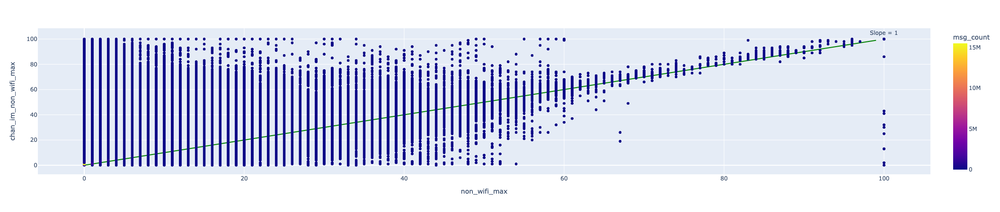

In [27]:
%%local
df_non_wifi_max["non_wifi_max"] = df_non_wifi_max["non_wifi_max"].apply(lambda x: x if x<100 else 100)
fig = px.scatter(df_non_wifi_max,x="non_wifi_max",y="chan_im_non_wifi_max",color="msg_count")
fig.add_trace(
    go.Scatter(x=list(range(0,100)), y=list(range(0,100)), line_shape='linear',line_color="green",showlegend=False),row="all", col="all", exclude_empty_subplots=True,
)
fig.add_annotation(x=100, y=105,
             text="Slope = 1",
             row="all", col="all",showarrow=False,exclude_empty_subplots=True)
fig.show()

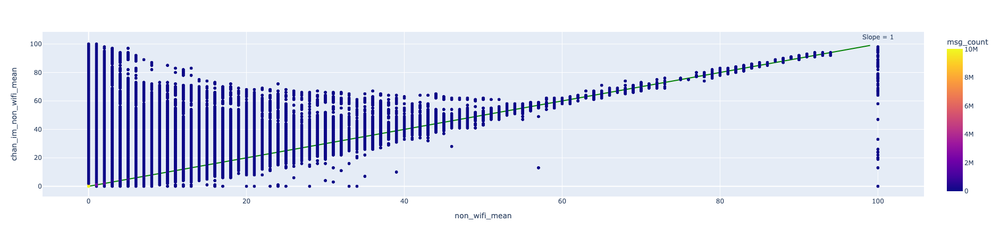

In [30]:
%%local
df_non_wifi_mean["non_wifi_mean"] = df_non_wifi_mean["non_wifi_mean"].apply(lambda x: x if x<100 else 100)
fig = px.scatter(df_non_wifi_mean,x="non_wifi_mean",y="chan_im_non_wifi_mean",color="msg_count")
fig.add_trace(
    go.Scatter(x=list(range(0,100)), y=list(range(0,100)), line_shape='linear',line_color="green",showlegend=False),row="all", col="all", exclude_empty_subplots=True,
)
fig.add_annotation(x=100, y=105,
             text="Slope = 1",
             row="all", col="all",showarrow=False,exclude_empty_subplots=True)
fig.show()

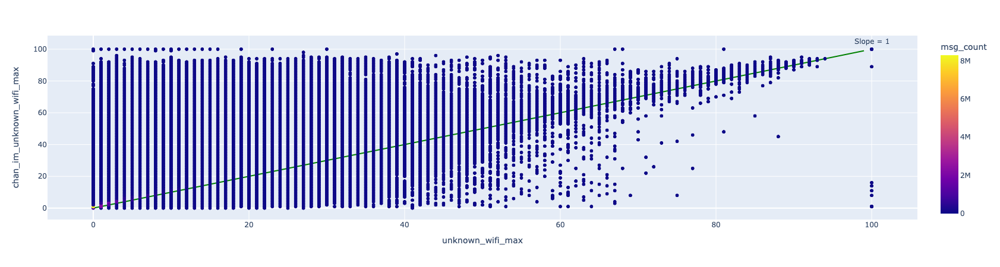

In [28]:
%%local
df_unknown_wifi_max["unknown_wifi_max"] = df_unknown_wifi_max["unknown_wifi_max"].apply(lambda x: x if x<100 else 100)
fig = px.scatter(df_unknown_wifi_max,x="unknown_wifi_max",y="chan_im_unknown_wifi_max",color="msg_count")
fig.add_trace(
    go.Scatter(x=list(range(0,100)), y=list(range(0,100)), line_shape='linear',line_color="green",showlegend=False),row="all", col="all", exclude_empty_subplots=True,
)
fig.add_annotation(x=100, y=105,
             text="Slope = 1",
             row="all", col="all",showarrow=False,exclude_empty_subplots=True)
fig.show()

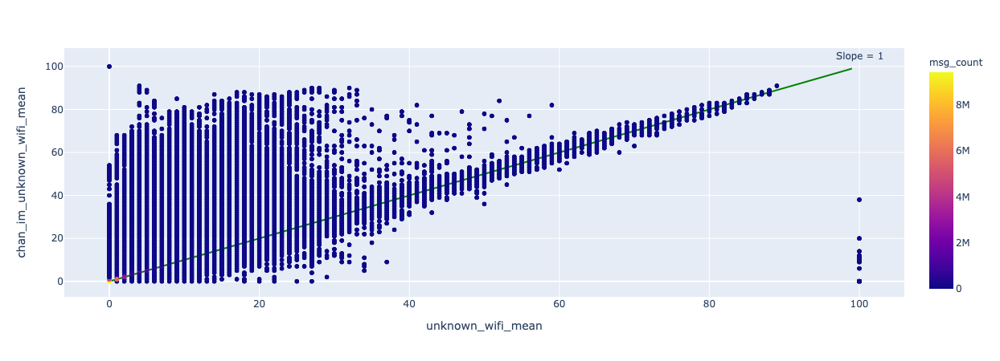

In [31]:
%%local
df_unknown_wifi_mean["unknown_wifi_mean"] = df_unknown_wifi_mean["unknown_wifi_mean"].apply(lambda x: x if x<100 else 100)
fig = px.scatter(df_unknown_wifi_mean,x="unknown_wifi_mean",y="chan_im_unknown_wifi_mean",color="msg_count")
fig.add_trace(
    go.Scatter(x=list(range(0,100)), y=list(range(0,100)), line_shape='linear',line_color="green",showlegend=False),row="all", col="all", exclude_empty_subplots=True,
)
fig.add_annotation(x=100, y=105,
             text="Slope = 1",
             row="all", col="all",showarrow=False,exclude_empty_subplots=True)
fig.show()

In [33]:
df.join(df_name,["org_id","site_id"]).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+------------+----+-------+---------+-----------+----------------+------------+-----------------+-------------+---------------------+-------------------------+------------------------+--------------------+-------------------+---------------+--------------------+
|              org_id|             site_id|       ap_id|band|channel|bandwidth|num_clients|unknown_wifi_max|non_wifi_max|unknown_wifi_mean|non_wifi_mean|chan_im_non_wifi_mean|chan_im_unknown_wifi_mean|chan_im_unknown_wifi_max|chan_im_non_wifi_max|               When|       org_name|           site_name|
+--------------------+--------------------+------------+----+-------+---------+-----------+----------------+------------+-----------------+-------------+---------------------+-------------------------+------------------------+--------------------+-------------------+---------------+--------------------+
|002e2a36-35f0-4ca...|a6fb1698-d352-4ae...|d420b08014af|  24|      6|       20|      

In [ ]:
# non wifi analysis 

df.withColumn("non_wifi_max_ratio",F.col("non_wifi_max")/F.col("chan_im_non_wifi_max"))\
            .groupby("org_name","site_name","site_id","ap_id","band","channel").agg(F.mean("non_wifi_max_ratio").alias('avg_non_wifi_max_ratio'))\
            .withColumn("")
.agg(F.count("site_id").alias("msg_count"))

## Diff Histogram

In [4]:
df_chanutil_comp = spark.read.parquet("s3://mist-data-science-dev/may/rrm/non_wifi_data_comp/")\
                .withColumn("avg_non_wifi_max_diff", F.round(F.col("avg_non_wifi_max_diff"),0))\
                .withColumn("avg_unknown_wifi_max_diff", F.round(F.col("avg_unknown_wifi_max_diff"),0))\
                .withColumn("avg_non_wifi_mean_diff", F.round(F.col("avg_non_wifi_mean_diff"),0))\
                .withColumn("avg_unknown_wifi_mean_diff", F.round(F.col("avg_unknown_wifi_mean_diff"),0)).persist()
df_chanutil_comp.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------+--------------------+------------+----+---------------------+----------------------+-------------------------+--------------------------+----------+---+
|            org_name|     site_name|             site_id|       ap_id|band|avg_non_wifi_max_diff|avg_non_wifi_mean_diff|avg_unknown_wifi_max_diff|avg_unknown_wifi_mean_diff|      date| hr|
+--------------------+--------------+--------------------+------------+----+---------------------+----------------------+-------------------------+--------------------------+----------+---+
|             UPS OPS|       USGAFRP|0cad60c6-771b-499...|d420b04470b8|  24|                 -6.0|                  -1.0|                     -3.0|                      -1.0|2021-11-10| 13|
|    AmazonOTN19-Prod|          DDF5|203d998a-793b-46b...|d4dc09b08dd5|  24|                 -2.0|                   0.0|                     -1.0|                       0.0|2021-11-10| 13|
|Doddridge County ...|Doddridge High|d08ccc2b-93f7

In [12]:
df_chanutil_comp.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

15807036

In [5]:
df_chanutil_comp.select("avg_non_wifi_max_diff","avg_unknown_wifi_max_diff","avg_non_wifi_mean_diff","avg_unknown_wifi_mean_diff").summary().show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+-------+---------------------+-------------------------+----------------------+--------------------------+
|summary|avg_non_wifi_max_diff|avg_unknown_wifi_max_diff|avg_non_wifi_mean_diff|avg_unknown_wifi_mean_diff|
+-------+---------------------+-------------------------+----------------------+--------------------------+
|count  |27536263             |27536263                 |27536263              |27536263                  |
|mean   |1.503321855983145    |1.82562179915263         |-0.10635618929119031  |0.2897191968278339        |
|stddev |4432.683095205084    |4642.384200151937        |562.277255715347      |641.6500448907561         |
|min    |-100.0               |-96.0                    |-100.0                |-72.0                     |
|25%    |-1.0                 |-1.0                     |-1.0                  |0.0                       |
|50%    |-1.0                 |-1.0                     |0.0                   |0.0                       |
|75%    |-1.0               

In [6]:
df_non_wifi_max = df_chanutil_comp.filter(F.col("avg_non_wifi_max_diff").isNotNull())\
                                .withColumn("avg_non_wifi_max_diff", F.when(F.col("avg_non_wifi_max_diff")>100,100).otherwise(F.col("avg_non_wifi_max_diff")))\
                                .groupby("band","avg_non_wifi_max_diff").agg(F.count("ap_id").alias("msg_count"))

df_non_wifi_mean= df_chanutil_comp.filter(F.col("avg_non_wifi_mean_diff").isNotNull())\
                                .withColumn("avg_non_wifi_mean_diff", F.when(F.col("avg_non_wifi_mean_diff")>100,100).otherwise(F.col("avg_non_wifi_mean_diff")))\
                                .groupby("band","avg_non_wifi_mean_diff").agg(F.count("ap_id").alias("msg_count"))

df_unknown_wifi_max = df_chanutil_comp.filter(F.col("avg_unknown_wifi_max_diff").isNotNull())\
                                .withColumn("avg_unknown_wifi_max_diff",F.when(F.col("avg_unknown_wifi_max_diff")>100,100).otherwise(F.col("avg_unknown_wifi_max_diff")))\
                                .groupby("band","avg_unknown_wifi_max_diff").agg(F.count("ap_id").alias("msg_count"))

df_unknown_wifi_mean = df_chanutil_comp.filter(F.col("avg_unknown_wifi_mean_diff").isNotNull())\
                                .withColumn("avg_unknown_wifi_mean_diff", F.when(F.col("avg_unknown_wifi_mean_diff")>100,100).otherwise(F.col("avg_unknown_wifi_mean_diff")))\
                                .groupby("band","avg_unknown_wifi_mean_diff").agg(F.count("ap_id").alias("msg_count"))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [7]:

print("%%spark -o df_non_wifi_max -n {}".format(df_non_wifi_max.count()))
print("%%spark -o df_non_wifi_mean -n {}".format(df_non_wifi_mean.count()))
print("%%spark -o df_unknown_wifi_max -n {}".format(df_unknown_wifi_max.count()))
print("%%spark -o df_unknown_wifi_mean -n {}".format(df_unknown_wifi_mean.count()))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

%%spark -o df_non_wifi_max -n 275
%%spark -o df_non_wifi_mean -n 278
%%spark -o df_unknown_wifi_max -n 234
%%spark -o df_unknown_wifi_mean -n 199

In [8]:
%%spark -o df_non_wifi_max -n 275

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [9]:
%%spark -o df_non_wifi_mean -n 278

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [10]:
%%spark -o df_unknown_wifi_max -n 234

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [11]:
%%spark -o df_unknown_wifi_mean -n 199

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [12]:
%%local
def show_figures(df,title,x):
    df["band"] = df["band"].apply(str)
    df["{}_group".format(x)] = df[x].apply(lambda x: x if x < 100 else 100)
    fig = px.bar(df,x="{}_group".format(x),y="msg_count",color="band",log_y=True)
    fig.update_layout(height=600, width=800,
                     title=title)
    fig.show()

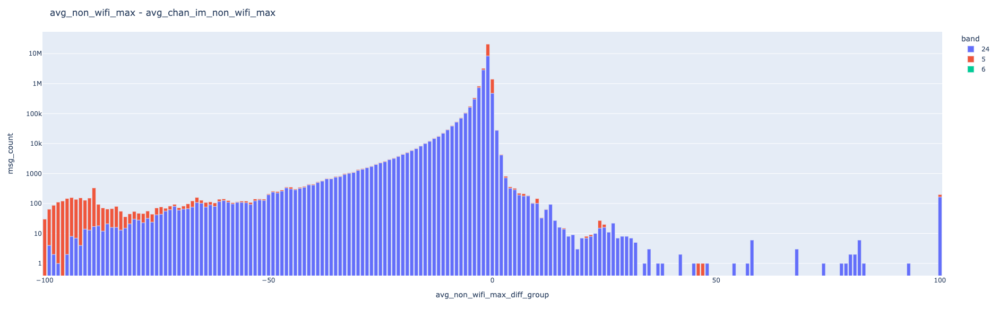

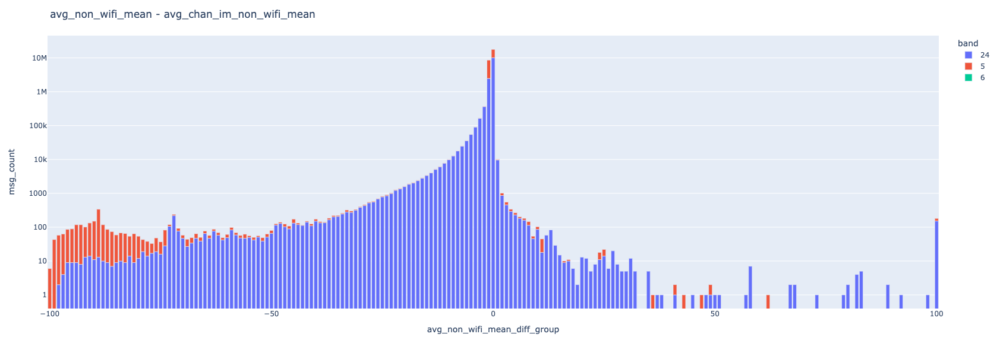

In [13]:
%%local
show_figures(df_non_wifi_max,"avg_non_wifi_max - avg_chan_im_non_wifi_max","avg_non_wifi_max_diff")
show_figures(df_non_wifi_mean,"avg_non_wifi_mean - avg_chan_im_non_wifi_mean","avg_non_wifi_mean_diff")

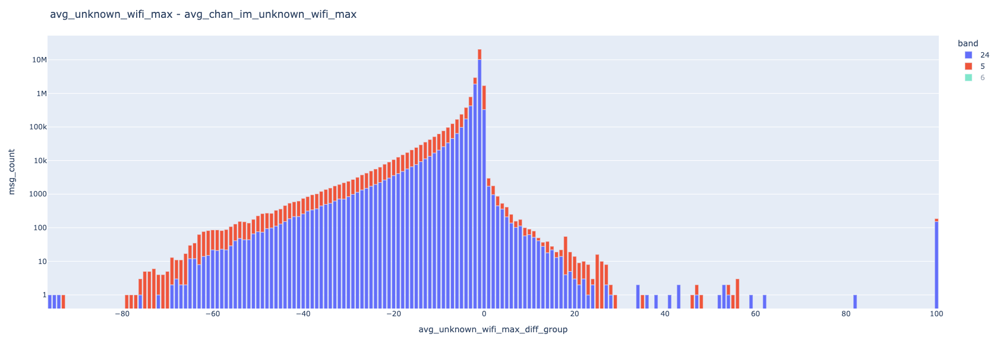

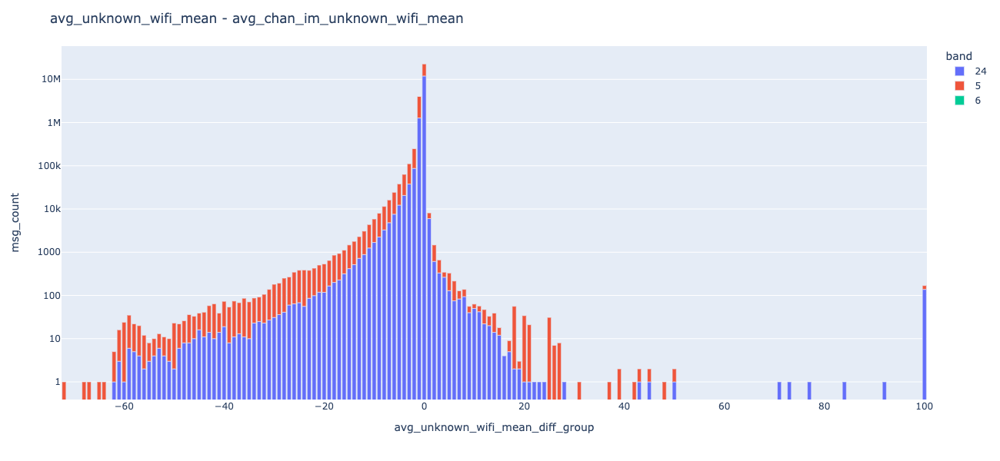

In [14]:
%%local
show_figures(df_unknown_wifi_max,"avg_unknown_wifi_max - avg_chan_im_unknown_wifi_max","avg_unknown_wifi_max_diff")
show_figures(df_unknown_wifi_mean,"avg_unknown_wifi_mean - avg_chan_im_unknown_wifi_mean","avg_unknown_wifi_mean_diff")

In [6]:
date = '2021-12-08'
hr="01"
df = spark.read.parquet("s3://mist-secorapp-production/ap-stats-full/ap-stats-full-production/dt={}/hr={}/".format(date,hr))\
                .withColumn("radios",F.explode("radios"))\
                .filter(F.col("radios.bandwidth")>0)\
                .select(convert_bytes_to_uuidUDF("org_id").alias("org_id"),\
                convert_bytes_to_uuidUDF("site_id").alias("site_id"),\
                convert_bytes_to_macUDF("id").alias("ap_id"),\
                band_from_indexUDF(F.col("radios.band")).alias("band"),"radios.channel","radios.bandwidth","radios.num_clients",\
                F.col("radios.chan_util.max.unknown_wifi").alias("unknown_wifi_max"),\
                 F.col("radios.chan_util.max.non_wifi").alias("non_wifi_max"),\
                F.col("radios.chan_util.mean.unknown_wifi").alias("unknown_wifi_mean"),\
                 F.col("radios.chan_util.mean.non_wifi").alias("non_wifi_mean"),\
                 F.col("radios.chan_util.chan_im_mean.non_wifi").alias("chan_im_non_wifi_mean"),\
                 F.col("radios.chan_util.chan_im_mean.unknown_wifi").alias("chan_im_unknown_wifi_mean"),\
                 F.col("radios.chan_util.chan_im_max.unknown_wifi").alias("chan_im_unknown_wifi_max"),\
                 F.col("radios.chan_util.chan_im_max.non_wifi").alias("chan_im_non_wifi_max"),\
                 F.to_timestamp("When.seconds").alias("When")).persist()
 

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [9]:
df.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

42366349

In [10]:
df.filter(F.col("chan_im_non_wifi_mean").isNotNull()).count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

37936560

## Non wifi interference weighted sliding window comp

In [7]:
date = '2022-01-04'
hr="*"
df = spark.read.parquet("s3://mist-secorapp-production/ap-stats-full/ap-stats-full-production/dt={}/hr={}/".format(date,hr))\
                .withColumn("radios",F.explode("radios"))\
                .filter(F.col("radios.bandwidth")>0)\
                .select(convert_bytes_to_uuidUDF("org_id").alias("org_id"),\
                convert_bytes_to_uuidUDF("site_id").alias("site_id"),\
                convert_bytes_to_macUDF("id").alias("ap_id"),\
                band_from_indexUDF(F.col("radios.band")).alias("band"),"radios.channel","radios.bandwidth","radios.num_clients",\
                F.col("radios.chan_util.max.unknown_wifi").alias("unknown_wifi_max"),\
                 F.col("radios.chan_util.max.non_wifi").alias("non_wifi_max"),\
                F.col("radios.chan_util.mean.unknown_wifi").alias("unknown_wifi_mean"),\
                 F.col("radios.chan_util.mean.non_wifi").alias("non_wifi_mean"),\
                 F.col("radios.chan_util.chan_im_mean.non_wifi").alias("chan_im_non_wifi_mean"),\
                 F.col("radios.chan_util.chan_im_mean.unknown_wifi").alias("chan_im_unknown_wifi_mean"),\
                 F.col("radios.chan_util.chan_im_max.unknown_wifi").alias("chan_im_unknown_wifi_max"),\
                 F.col("radios.chan_util.chan_im_max.non_wifi").alias("chan_im_non_wifi_max"),\
                 F.to_timestamp("When.seconds").alias("When")).persist()


def get_non_wifi(non_wifi,unknown_wifi,scale=1):
    try:
        non_wifi = non_wifi/scale
        unknown_wifi = unknown_wifi/scale
        wt = 1 + non_wifi
        non_wifi = (non_wifi * 2 + unknown_wifi) / wt
        if (non_wifi > 1):
            non_wifi = 1
        return int(100*non_wifi)
    except:
        return -1

get_non_wifiUDF = F.udf(get_non_wifi,IntegerType())
import math 

def weighted_nonwifi(util_values,time_window_in_sec=1200):
    util_values_sorted = sorted(util_values,key=lambda x:x["When"])
    start_time =None
    weighted_non_wifi = []
    util_nonwifi_low_threshold = 20
    util_nonwifi_threshold = 40
    deviation = []
    for t,v in util_values_sorted:
        #print(t,v,start_time)
        if v < 0:
            continue
        if not start_time:
            start_time = t
            util_nonwifi_mean_base = v
            util_nonwifi_mean2_base = v*v
            util_nonwifi_mean= v
            util_nonwifi_mean2 = v*v
        else:
            util_nonwifi_mean = (0.5*util_nonwifi_mean) + (0.5*v)
            if abs(util_nonwifi_mean) > 100:
                util_nonwifi_mean =v 
            util_nonwifi_mean2 = (0.5*util_nonwifi_mean2) + (0.5*v)
            if abs(util_nonwifi_mean2) > 10000:
                util_nonwifi_mean2 = v*v
            t_diff =  t - start_time
            if t_diff.total_seconds() > time_window_in_sec:
                util_nonwifi_error = 2*(util_nonwifi_mean2-(util_nonwifi_mean*util_nonwifi_mean))
                if (util_nonwifi_error < 9.0):
                    util_nonwifi_error = 9.0
                elif (util_nonwifi_error > 100.0):
                    util_nonwifi_error = 100.0
                util_nonwifi_error = math.sqrt(util_nonwifi_error)
                util_threshold = max(util_nonwifi_low_threshold, min(util_nonwifi_threshold, util_nonwifi_mean))
                util_nonwifi_deviation = (util_nonwifi_mean - util_threshold)/util_nonwifi_error
                print(util_nonwifi_mean,util_nonwifi_error,util_threshold,util_nonwifi_deviation)
                weighted_non_wifi.append([start_time,int(util_nonwifi_mean),int(util_nonwifi_deviation)])
                start_time = None
    return weighted_non_wifi if len(weighted_non_wifi) > 0 else [[None,None,None]]
    
schema = ArrayType(StructType([StructField("start_time", TimestampType(),True),StructField("mean", IntegerType(),True),StructField("deviation",IntegerType(),True),]))
  
weighted_nonwifiudf = F.udf(weighted_nonwifi,schema)


df_group = df.withColumn("non_wifi",get_non_wifiUDF("non_wifi_mean","unknown_wifi_mean"))\
        .withColumn("chan_im_non_wifi",get_non_wifiUDF("chan_im_non_wifi_mean","chan_im_unknown_wifi_mean",F.lit(100)))\
        .groupby("org_id","site_id","ap_id","band","channel").agg(F.collect_list(F.struct('When',"non_wifi")).alias("non_wifi_list"),\
                                                                 F.collect_list(F.struct("When","chan_im_non_wifi")).alias("chan_im_non_wifi_list"))\
        .withColumn("non_wifi",weighted_nonwifiudf("non_wifi_list"))\
        .withColumn("chan_im_non_wifi",weighted_nonwifiudf("chan_im_non_wifi_list"))

df_group.write.mode("overwrite").parquet("s3://mist-data-science-dev/may/chan_im_weighted_comp_01_04/")



FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [4]:
#df_g = spark.read.parquet("s3://mist-data-science-dev/may/chan_im_weighted_comp/").persist()
df_g = spark.read.parquet("s3://mist-data-science-dev/may/chan_im_weighted_comp_01_04/").persist()
df_g.show(3)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+------------+----+-------+--------------------+---------------------+--------------------+--------------------+
|              org_id|             site_id|       ap_id|band|channel|       non_wifi_list|chan_im_non_wifi_list|            non_wifi|    chan_im_non_wifi|
+--------------------+--------------------+------------+----+-------+--------------------+---------------------+--------------------+--------------------+
|01592620-989a-4d0...|58f2b530-4163-472...|5c5b354e80b1|   5|    100|[{2022-01-04 18:1...| [{2022-01-04 18:1...|[{2022-01-04 14:0...|[{2022-01-04 14:0...|
|01592620-989a-4d0...|58f2b530-4163-472...|5c5b354e80d9|  24|      6|[{2022-01-04 06:5...| [{2022-01-04 06:5...|[{2022-01-04 00:0...|[{2022-01-04 00:0...|
|020c0397-e282-44b...|0a2d2fee-f1dc-44e...|5c5b352f037e|   5|     52|[{2022-01-04 06:3...| [{2022-01-04 06:3...|[{2022-01-04 00:0...|[{null, null, null}]|
+--------------------+--------------------+------------+----+-------+-

In [5]:
def channel_comp(non_wifi,chan_im_non_wifi):
    all_non_wifi = {}
    diff = []
    for i in non_wifi:
        if i["start_time"] not in all_non_wifi:
            all_non_wifi[i["start_time"]] = {}
        all_non_wifi[i["start_time"]]["non_wifi_mean"] = i["mean"] if i["mean"] else 0
        all_non_wifi[i["start_time"]]["non_wifi_deviation"] = i["deviation"] if i["deviation"] else 0
    for i in chan_im_non_wifi:
        if i["start_time"] not in all_non_wifi:
            all_non_wifi[i["start_time"]] = {}
        all_non_wifi[i["start_time"]]["chan_im_non_wifi_mean"] = i["mean"] if i["mean"] else 0
        all_non_wifi[i["start_time"]]["chan_im_non_wifi_deviation"] = i["deviation"] if i["deviation"] else 0
    for k,v in all_non_wifi.items():
        #print(k,v)
        diff.append([v.get("chan_im_non_wifi_mean",0) - v.get("non_wifi_mean",0),\
                     v.get("chan_im_non_wifi_deviation",0) - v.get("non_wifi_deviation",0)])
    return diff



schema = ArrayType(StructType([StructField("mean_diff", IntegerType(),True),StructField("deviation_diff",IntegerType(),True),]))

channel_comp_udf = F.udf(channel_comp,schema)

#b = df_g.limit(5).collect()
#channel_comp(b[3]["non_wifi"],b[3]["chan_im_non_wifi"])
        

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [15]:
df_mean_diff_dist = df_g.withColumn("diff",channel_comp_udf("non_wifi","chan_im_non_wifi")).select("band",F.explode("diff").alias("diff"))\
                    .groupby("band","diff.mean_diff").agg(F.count("diff").alias("count"))
df_mean_diff_dist.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

385

In [17]:
%%spark -o df_mean_diff_dist

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

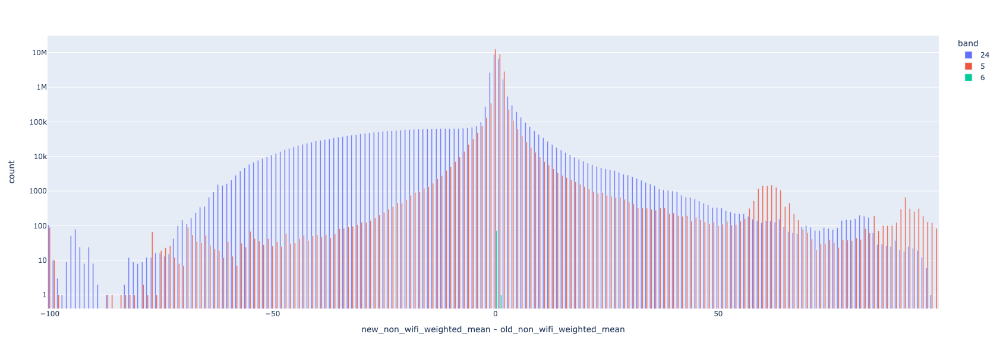

In [18]:
%%local
df_mean_diff_dist["band"] = df_mean_diff_dist["band"].apply(str)
fig = px.bar(df_mean_diff_dist,x="mean_diff",y="count",log_y=True,color="band",barmode="group")
fig.update_layout(height=600, width=800)
fig.update_layout(xaxis_title = "new_non_wifi_weighted_mean - old_non_wifi_weighted_mean")
fig.show()

In [6]:
def chan_im_anomaly_comp(non_wifi,chan_im_non_wifi):
    all_non_wifi = {}
    diff = []
    for i in non_wifi:
        if i["start_time"] not in all_non_wifi:
            all_non_wifi[i["start_time"]] = {}
        all_non_wifi[i["start_time"]]["non_wifi_mean"] = i["mean"] if i["mean"] else 0
        all_non_wifi[i["start_time"]]["non_wifi_deviation"] = i["deviation"] if i["deviation"] else 0
    for i in chan_im_non_wifi:
        if i["start_time"] not in all_non_wifi:
            all_non_wifi[i["start_time"]] = {}
        all_non_wifi[i["start_time"]]["chan_im_non_wifi_mean"] = i["mean"] if i["mean"] else 0
        all_non_wifi[i["start_time"]]["chan_im_non_wifi_deviation"] = i["deviation"] if i["deviation"] else 0
    for k,v in all_non_wifi.items():
        #print(k,v)
        if v.get("chan_im_non_wifi_mean",0) > 40:
            diff.append([v.get("chan_im_non_wifi_mean",0) - v.get("non_wifi_mean",0),\
                         v.get("chan_im_non_wifi_deviation",0) - v.get("non_wifi_deviation",0)])
    return diff

schema = ArrayType(StructType([StructField("mean_diff", IntegerType(),True),StructField("deviation_diff",IntegerType(),True),]))

chan_im_anomaly_comp_udf = F.udf(chan_im_anomaly_comp,schema)


df_non_wifi_anomaly_diff_dist = df_g.withColumn("non_wifi_anomaly_diff",chan_im_anomaly_comp_udf("non_wifi","chan_im_non_wifi"))\
                .select("org_id","site_id","band","ap_id",F.explode("non_wifi_anomaly_diff.mean_diff").alias("anomaly_non_wifi_mean_diff"))\
                .groupby("band","anomaly_non_wifi_mean_diff").agg(F.count("anomaly_non_wifi_mean_diff").alias("count"),\
                                                                  F.countDistinct("ap_id").alias("distinct_ap_count"))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [14]:
%%spark -o df_non_wifi_anomaly_diff_dist

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

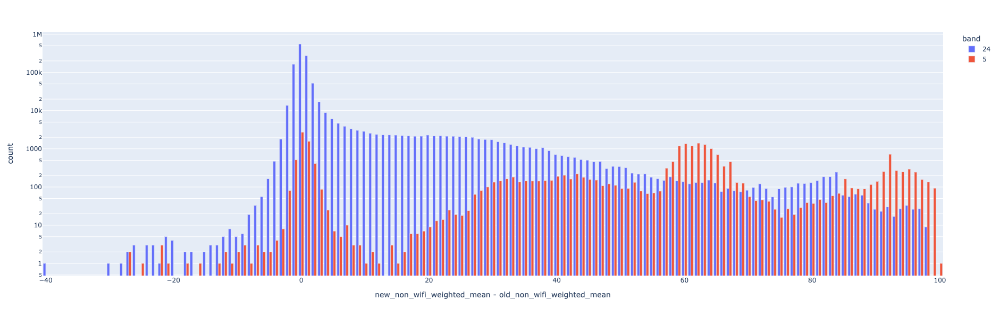

In [15]:
%%local
df_non_wifi_anomaly_diff_dist["band"] = df_non_wifi_anomaly_diff_dist["band"].apply(str)
fig = px.bar(df_non_wifi_anomaly_diff_dist,x="anomaly_non_wifi_mean_diff",y="count",color="band",barmode="group",log_y=True)
fig.update_layout(height=600, width=800)
fig.update_layout(xaxis_title = "new_non_wifi_weighted_mean - old_non_wifi_weighted_mean")
fig.show()

In [16]:
df_non_wifi_anomaly_diff_dist = df_g.withColumn("non_wifi_anomaly_diff",chan_im_anomaly_comp_udf("non_wifi","chan_im_non_wifi"))\
                .select("org_id","site_id","ap_id",F.explode("non_wifi_anomaly_diff.mean_diff").alias("anomaly_non_wifi_mean_diff"))\
                .groupby("anomaly_non_wifi_mean_diff").agg(F.count("anomaly_non_wifi_mean_diff").alias("count"))
#df_non_wifi_anomaly_diff_dist.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [7]:
df_device_name = spark.read.parquet("s3://mist-secorapp-production/dimension/device")\
    .join(df_name,["org_id","site_id"]).select("org_id","org_name","site_id","site_id","site_name",F.col("mac").alias("ap_mac"),F.col("name").alias("ap_name"))
df_site_ap_count = df_device_name.groupby("org_id","org_name","site_id","site_name").agg(F.countDistinct("ap_mac").alias("total_ap"))


df_chan_im_non_wifi_anomaly = df_g.withColumn("non_wifi_anomaly_diff",chan_im_anomaly_comp_udf("non_wifi","chan_im_non_wifi"))\
                                .select("org_id","site_id","ap_id","band",F.explode("non_wifi_anomaly_diff.mean_diff").alias("anomaly_non_wifi_mean_diff"))\
                               .filter(F.col("anomaly_non_wifi_mean_diff") > 40)\
                                .join(df_site_ap_count,["site_id","org_id"])\
                                .join(df_device_name.select("site_id",F.col("ap_mac").alias("ap_id"),"ap_name"),["site_id","ap_id"])\
                                .groupby("org_name","site_name","org_id","site_id","ap_id","ap_name","band","total_ap").agg(F.count("ap_id").alias("anomaly_event"))
df_chan_im_non_wifi_anomaly.sort(F.desc("anomaly_event")).show(20,truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+-----------------------------------------+----------------------------+------------------------------------+------------------------------------+------------+-------------+----+--------+-------------+
|org_name                                 |site_name                   |org_id                              |site_id                             |ap_id       |ap_name      |band|total_ap|anomaly_event|
+-----------------------------------------+----------------------------+------------------------------------+------------------------------------+------------+-------------+----+--------+-------------+
|SVL MIST LAB                             |Primary Site                |36e8d5d6-133b-499f-8251-9e67b78c13f4|c947adba-b2c7-48e1-a22a-50383426a232|5c5b35f25ec8|             |5   |183     |67           |
|SVL MIST LAB                             |Primary Site                |36e8d5d6-133b-499f-8251-9e67b78c13f4|c947adba-b2c7-48e1-a22a-50383426a232|d4dc09207e22|             |5   |183     |67   

In [21]:
df_chan_im_non_wifi_anomaly.filter(F.col("org_name") !="SVL MIST LAB").sort(F.desc("anomaly_event")).show(20,truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+-----------------------------+-----------------------------+------------------------------------+------------------------------------+------------+-------------------------+----+--------+-------------+
|org_name                     |site_name                    |org_id                              |site_id                             |ap_id       |ap_name                  |band|total_ap|anomaly_event|
+-----------------------------+-----------------------------+------------------------------------+------------------------------------+------------+-------------------------+----+--------+-------------+
|Netflix                      |sjc004                       |31f3bf67-c408-49ed-81ac-6113c80704a9|ba7998c2-2104-4053-8635-de287c39ab9e|d420b0c20b07|AP257.SJC004             |24  |453     |67           |
|Enclave (College Station, TX)|Enclave (College Station, TX)|aa695314-1b41-4638-acee-4b283588e661|f72faa5c-0814-43e7-a57a-cee7feef4b90|5c5b35f1d360|Enclave-601              |24  |343     |

In [22]:
df_chan_im_non_wifi_anomaly.agg(F.countDistinct("ap_id")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+
|count(ap_id)|
+------------+
|        2411|
+------------+

In [23]:
df_chan_im_non_wifi_anomaly.agg(F.countDistinct("site_id")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------+
|count(site_id)|
+--------------+
|          1034|
+--------------+

In [24]:
df_chan_im_non_wifi_anomaly.groupby("org_name","site_name","site_id","band","total_ap").agg(F.sum("anomaly_event").alias("anomaly_event"),\
                                                                                     F.countDistinct("ap_id").alias("anomaly_ap_count"))\
                .sort(F.desc("anomaly_event")).show(20,truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+-----------------------------+-------------------------------------+------------------------------------+----+--------+-------------+----------------+
|org_name                     |site_name                            |site_id                             |band|total_ap|anomaly_event|anomaly_ap_count|
+-----------------------------+-------------------------------------+------------------------------------+----+--------+-------------+----------------+
|SVL MIST LAB                 |Primary Site                         |c947adba-b2c7-48e1-a22a-50383426a232|5   |183     |9036         |135             |
|NVIDIA Corp Wireless         |Endeavor & Voyager                   |cfeaeac2-2eb5-4a9d-92a9-435658ab5ffe|24  |1319    |1033         |36              |
|Best Buy 2020                |BBY00710 Chicago                     |cebb3f34-10ac-4404-8ac5-63ae4dae945d|24  |140     |572          |9               |
|Fewstone Pty Ltd (City Beach)|MSDWP26967001 - Murarrie             |9e29a4b1-c85b-4ea7-

In [25]:
df_chan_im_non_wifi_anomaly.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

2423

In [8]:
%%spark -o df_chan_im_non_wifi_anomaly -n 2423

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

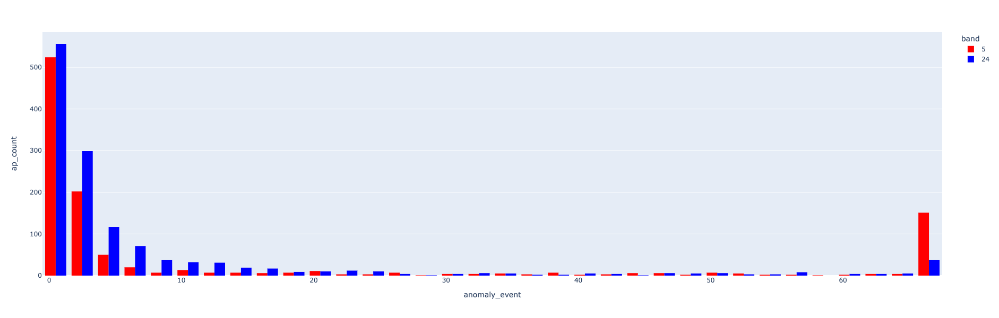

In [10]:
%%local
fig = px.histogram(df_chan_im_non_wifi_anomaly,x="anomaly_event",color="band",barmode="group",color_discrete_sequence=["red", "blue"])
fig.update_layout(height=600, width=800)
fig.update_layout(
   yaxis_title="ap_count",
)
fig.show()

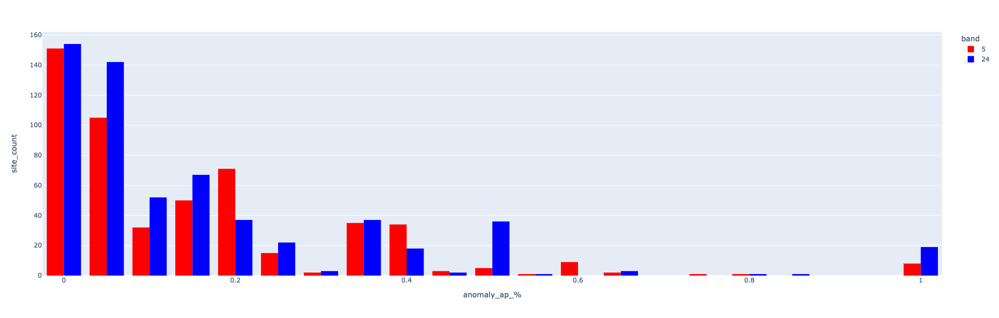

In [15]:
%%local
temp = df_chan_im_non_wifi_anomaly.groupby(["site_id","site_name","org_name","band","total_ap"])["ap_id"].nunique().reset_index()
temp["anomaly_ap_%"] = temp["ap_id"]/temp["total_ap"]
fig = px.histogram(temp,x="anomaly_ap_%",color="band",barmode="group",color_discrete_sequence=["red", "blue"])
fig.update_layout(height=600, width=800)
fig.update_layout(
   yaxis_title="site_count",
)
fig.show()

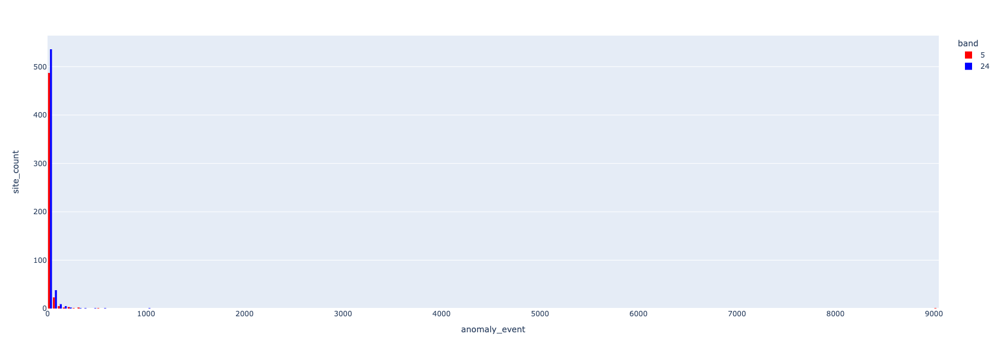

In [17]:
%%local
fig = px.histogram(df_chan_im_non_wifi_anomaly.groupby(["site_id",'band'])["anomaly_event"].sum().reset_index(),x="anomaly_event",color="band",barmode="group",color_discrete_sequence=["red", "blue"])
fig.update_layout(height=600, width=800)
fig.update_layout(
   yaxis_title="site_count",
)
fig.show()

## Top AP with large non wifi interference Investigation

In [4]:
df_g = spark.read.parquet("s3://mist-data-science-dev/may/chan_im_weighted_comp_01_04/").persist()
df_g.show(3)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+------------+----+-------+--------------------+---------------------+--------------------+--------------------+
|              org_id|             site_id|       ap_id|band|channel|       non_wifi_list|chan_im_non_wifi_list|            non_wifi|    chan_im_non_wifi|
+--------------------+--------------------+------------+----+-------+--------------------+---------------------+--------------------+--------------------+
|01592620-989a-4d0...|58f2b530-4163-472...|5c5b354e80b1|   5|    100|[{2022-01-04 18:1...| [{2022-01-04 18:1...|[{2022-01-04 14:0...|[{2022-01-04 14:0...|
|01592620-989a-4d0...|58f2b530-4163-472...|5c5b354e80d9|  24|      6|[{2022-01-04 06:5...| [{2022-01-04 06:5...|[{2022-01-04 00:0...|[{2022-01-04 00:0...|
|020c0397-e282-44b...|0a2d2fee-f1dc-44e...|5c5b352f037e|   5|     52|[{2022-01-04 06:3...| [{2022-01-04 06:3...|[{2022-01-04 00:0...|[{null, null, null}]|
+--------------------+--------------------+------------+----+-------+-

In [5]:
def chan_im_anomaly_time(non_wifi,chan_im_non_wifi):
    all_non_wifi = {}
    diff = []
    for i in non_wifi:
        if i["start_time"] not in all_non_wifi:
            all_non_wifi[i["start_time"]] = {}
        all_non_wifi[i["start_time"]]["non_wifi_mean"] = i["mean"] if i["mean"] else 0
        all_non_wifi[i["start_time"]]["non_wifi_deviation"] = i["deviation"] if i["deviation"] else 0
    for i in chan_im_non_wifi:
        if i["start_time"] not in all_non_wifi:
            all_non_wifi[i["start_time"]] = {}
        all_non_wifi[i["start_time"]]["chan_im_non_wifi_mean"] = i["mean"] if i["mean"] else 0
        all_non_wifi[i["start_time"]]["chan_im_non_wifi_deviation"] = i["deviation"] if i["deviation"] else 0
    for k,v in all_non_wifi.items():
        #print(k,v)
        if v.get("chan_im_non_wifi_mean",0) > 40:
            diff.append([v.get("chan_im_non_wifi_mean",0) - v.get("non_wifi_mean",0),\
                         v.get("chan_im_non_wifi_deviation",0) - v.get("non_wifi_deviation",0),k])
    return diff

schema = ArrayType(StructType([StructField("mean_diff", IntegerType(),True),StructField("deviation_diff",IntegerType(),True),StructField("time",TimestampType())]))

chan_im_anomaly_comp_udf = F.udf(chan_im_anomaly_time,schema)


df_chan_im_non_wifi_anomaly = df_g.withColumn("non_wifi_anomaly_diff",F.explode(chan_im_anomaly_comp_udf("non_wifi","chan_im_non_wifi")))\
                                .select("org_id","site_id","ap_id","band",F.col("non_wifi_anomaly_diff.mean_diff").alias("anomaly_non_wifi_mean_diff"),\
                                       F.col("non_wifi_anomaly_diff.time").alias("anomaly_time"))\
                               .filter(F.col("anomaly_non_wifi_mean_diff") > 40)
df_chan_im_non_wifi_anomaly.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+------------+----+--------------------------+-------------------+
|              org_id|             site_id|       ap_id|band|anomaly_non_wifi_mean_diff|       anomaly_time|
+--------------------+--------------------+------------+----+--------------------------+-------------------+
|a8c903ae-e6d0-42a...|c4e82c3c-fd34-445...|d420b04469fb|  24|                        48|2022-01-04 02:30:45|
|38a18d4d-1623-498...|bf8158b6-c52b-488...|5c5b35d16f6c|  24|                        61|2022-01-04 16:49:09|
|38a18d4d-1623-498...|bf8158b6-c52b-488...|5c5b35d16f6c|  24|                        67|2022-01-04 18:36:27|
|38a18d4d-1623-498...|bf8158b6-c52b-488...|5c5b35d16f6c|  24|                        67|2022-01-04 18:57:57|
|38a18d4d-1623-498...|bf8158b6-c52b-488...|5c5b35d16f6c|  24|                        42|2022-01-04 21:28:17|
|38a18d4d-1623-498...|bf8158b6-c52b-488...|5c5b35d16f6c|  24|                        51|2022-01-04 21:49:47|
|38a18d4d-1623-498.

In [15]:
# find the capacity and client count for next plus/minus anomaly time
df_capacity = spark.read.orc("s3://mist-secorapp-production/cv-sle-cap-multipartition/cv-sle-cap-multipartition-production/dt=2022-01-04/")\
                    .withColumn("ap_id",F.regexp_replace("ap_mac","-","")).persist()
df_capacity.show(3)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+-----------------+----+-------+-------------+----------+---------------+---------+-----------+--------------------+--------+-----------------+--------+-----------+--------------------+--------------------+---------+--------------------+----------+--------------------+------------+
|           ap_mac|band|channel|channel_width|classifier|classifier_rank|client_os|client_type|         client_wcid|duration|en_client_sle_agg|  metric|metric_rank|              org_id|             site_id|threshold|                time|     value|             wlan_id|       ap_id|
+-----------------+----+-------+-------------+----------+---------------+---------+-----------+--------------------+--------+-----------------+--------+-----------+--------------------+--------------------+---------+--------------------+----------+--------------------+------------+
|d4-20-b0-84-cf-8b|   5|     36|           20|          |           null|         |           |3bbe0e65-ebb9-4a9...|    62.0|            false|capacity

In [19]:
# join top aps with chan im non wifi anomaly and their capacity

def related_event(time,anomaly_time):
    try:
        d = anomaly_time - time
        if abs(d.total_seconds()) < 1800:
            return True
        return False
    except:
        return False

related_eventUDF = F.udf(related_event,BooleanType())

df_non_wifi_capacity = df_capacity.join(df_chan_im_non_wifi_anomaly,["site_id","org_id","ap_id","band"])\
                                    .withColumn("related",related_eventUDF("time","anomaly_time"))\
                                    .filter(F.col("related")==True)

df_non_wifi_capacity.coalesce(16).write.mode("overwrite").parquet("s3://mist-data-science-dev/may/chan_im_anomaly_capacity/")


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [5]:
df_non_wifi_capacity = spark.read.parquet("s3://mist-data-science-dev/may/chan_im_anomaly_capacity/").persist()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [ ]:
# ap with new non wifi anomaly (10 mins window on 01-04)
+------------+
|count(ap_id)|
+------------+
|        2411|
+------------+

In [6]:
# ap with new non wifi anomaly and capacity data on 01-04
df_non_wifi_capacity.agg(F.countDistinct("ap_id")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+
|count(ap_id)|
+------------+
|        1597|
+------------+

In [7]:
df_non_wifi_capacity.agg(F.countDistinct("site_id")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------+
|count(site_id)|
+--------------+
|           787|
+--------------+

In [29]:
df_non_wifi_capacity.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+------------+----+-----------------+-------+-------------+----------+---------------+---------+-----------+--------------------+--------+-----------------+--------+-----------+---------+--------------------+----------+--------------------+--------------------------+-------------------+-------+
|             site_id|              org_id|       ap_id|band|           ap_mac|channel|channel_width|classifier|classifier_rank|client_os|client_type|         client_wcid|duration|en_client_sle_agg|  metric|metric_rank|threshold|                time|     value|             wlan_id|anomaly_non_wifi_mean_diff|       anomaly_time|related|
+--------------------+--------------------+------------+----+-----------------+-------+-------------+----------+---------------+---------+-----------+--------------------+--------+-----------------+--------+-----------+---------+--------------------+----------+--------------------+--------------------------+---------------

## Non Wifi Vs Client Count

In [32]:
%%spark -o df_ap_wifi_capacity -n 6401

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

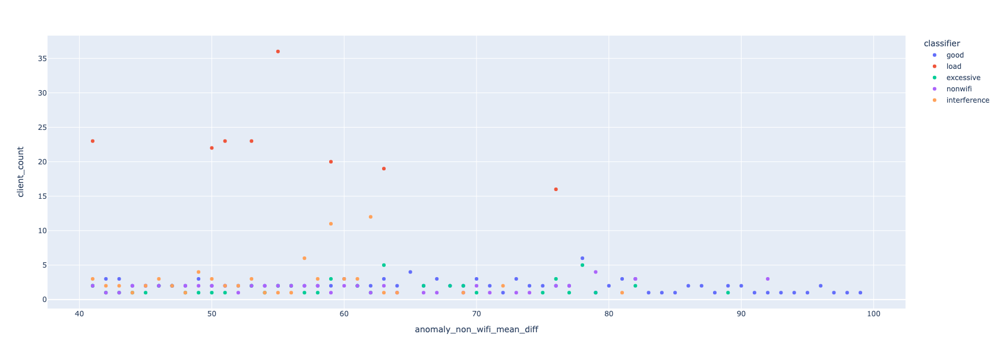

In [64]:
%%local
df_ap_wifi_capacity["classifier"] = df_ap_wifi_capacity["classifier"].apply(lambda x: x if x!= "" else "good")
temp = df_ap_wifi_capacity.groupby(["anomaly_non_wifi_mean_diff","classifier"])["client_count"].median().reset_index()
temp["client_count"] = temp["client_count"].apply(lambda x: round(x))
fig = px.scatter(temp,x= "anomaly_non_wifi_mean_diff",y="client_count",color="classifier",
                category_orders={"classifier": ["good", "load", "excessive", "nonwifi","interference"]})
fig.update_layout(height = 600,width = 800)
fig.show()


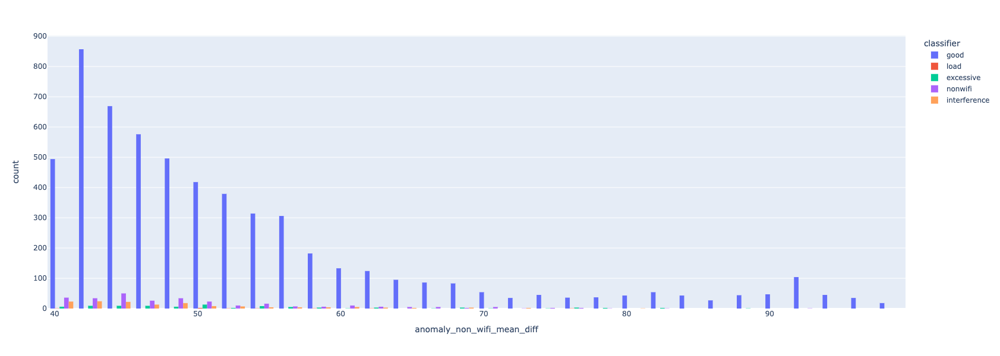

In [67]:
%%local

fig = px.histogram(df_ap_wifi_capacity,x= "anomaly_non_wifi_mean_diff",color="classifier",nbins=50,barmode="group",
                category_orders={"classifier": ["good", "load", "excessive", "nonwifi","interference"]})
fig.update_layout(height = 600,width = 800)
fig.show()



In [71]:
df_device_name = spark.read.parquet("s3://mist-secorapp-production/dimension/device")\
    .join(df_name,["org_id","site_id"]).select("org_id","org_name","site_id","site_id","site_name",F.col("mac").alias("ap_mac"),F.col("name").alias("ap_name"))
df_site_ap_count = df_device_name.groupby("org_id","org_name","site_id","site_name").agg(F.countDistinct("ap_mac").alias("total_ap"))

df_non_wifi_capacity.groupby("org_id","site_id","ap_id","band").agg(F.countDistinct("anomaly_time").alias("chan_im_nonwifi_anomaly_count"))\
                            .join(df_site_ap_count,["org_id","site_id"]).sort(F.desc("chan_im_nonwifi_anomaly_count")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+------------+----+-----------------------------+--------------------+--------------------+--------+
|              org_id|             site_id|       ap_id|band|chan_im_nonwifi_anomaly_count|            org_name|           site_name|total_ap|
+--------------------+--------------------+------------+----+-----------------------------+--------------------+--------------------+--------+
|a8c903ae-e6d0-42a...|1ad6643e-acf1-41a...|d420b04410cd|  24|                           67| T-Mobile USA Retail|            23-01SBV|       5|
|aa695314-1b41-463...|f72faa5c-0814-43e...|5c5b35f1d398|  24|                           67|Enclave (College ...|Enclave (College ...|     343|
|d5eab1c6-e448-421...|b03401df-b00e-44a...|5c5b35528a46|   5|                           65|          FloraCraft|FloraCraft Luding...|      68|
|790be815-af8f-4dc...|b3fc49e0-0810-44e...|5c5b3551bcb5|  24|                           64|   Dartmouth College|               BERRY|     201|

## Non wifi for Selected AP Analysis

### 787 Carolina Pines

In [10]:
df = spark.read.parquet("s3://mist-data-science-dev/may/rrm/non_wifi_data_comp_787_caroline_pines/").persist()
df.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+------------+----+-------+--------------------+--------------------+------------------------+-------------------------+--------------------+---------------------+-----------------------------+----------------------------+------------------+---------------+---------------------+-------------------------+----------------------+--------------------------+----------+---+
|             site_id|       ap_id|band|channel|    avg_non_wifi_max|   avg_non_wifi_mean|avg_chan_im_non_wifi_max|avg_chan_im_non_wifi_mean|avg_unknown_wifi_max|avg_unknown_wifi_mean|avg_chan_im_unknown_wifi_mean|avg_chan_im_unknown_wifi_max|   avg_num_clients|max_num_clients|avg_non_wifi_max_diff|avg_unknown_wifi_max_diff|avg_non_wifi_mean_diff|avg_unknown_wifi_mean_diff|      date| hr|
+--------------------+------------+----+-------+--------------------+--------------------+------------------------+-------------------------+--------------------+---------------------+-----------------------------+--

In [11]:
df.printSchema()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

root
 |-- site_id: string (nullable = true)
 |-- ap_id: string (nullable = true)
 |-- band: string (nullable = true)
 |-- channel: integer (nullable = true)
 |-- avg_non_wifi_max: double (nullable = true)
 |-- avg_non_wifi_mean: double (nullable = true)
 |-- avg_chan_im_non_wifi_max: double (nullable = true)
 |-- avg_chan_im_non_wifi_mean: double (nullable = true)
 |-- avg_unknown_wifi_max: double (nullable = true)
 |-- avg_unknown_wifi_mean: double (nullable = true)
 |-- avg_chan_im_unknown_wifi_mean: double (nullable = true)
 |-- avg_chan_im_unknown_wifi_max: double (nullable = true)
 |-- avg_num_clients: double (nullable = true)
 |-- max_num_clients: integer (nullable = true)
 |-- avg_non_wifi_max_diff: double (nullable = true)
 |-- avg_unknown_wifi_max_diff: double (nullable = true)
 |-- avg_non_wifi_mean_diff: double (nullable = true)
 |-- avg_unknown_wifi_mean_diff: double (nullable = true)
 |-- date: date (nullable = true)
 |-- hr: integer (nullable = true)

In [14]:
df_filtered = df.filter(F.col("ap_id").isin("d4dc0923585e","d4dc092357dc"))
df_filtered.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

409

In [15]:
%%spark -o df_filtered 

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [39]:
%%local
df_filtered["timestamp"]=df_filtered[["date","hr"]].apply(lambda x: "{} {}:00".format(x[0].date(),x[1]),axis=1)
df_filtered["band"] = df_filtered["band"].apply(str)
df_filtered[["ap_id","band","channel","avg_non_wifi_max","avg_chan_im_non_wifi_max","date","hr","timestamp"]].head()
ap_id = "d4dc0923585e"
band ="5"
#ch=161
temp = df_filtered[(df_filtered["ap_id"]==ap_id) & (df_filtered["band"]==band)] #& (df_filtered["channel"]==ch)]
set(temp["channel"])

Output()

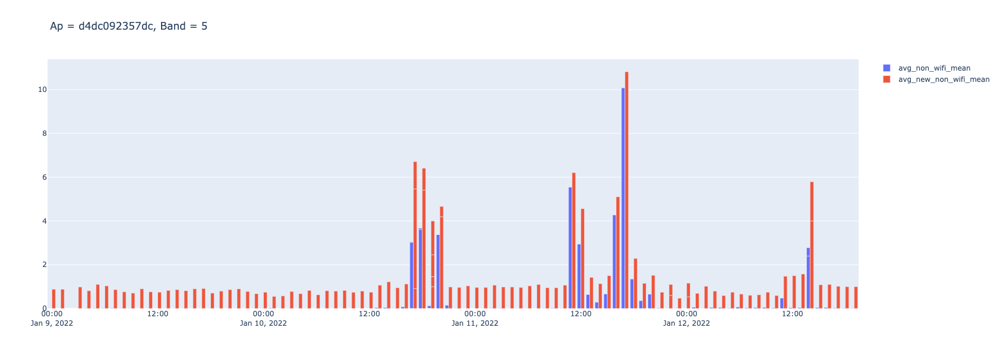

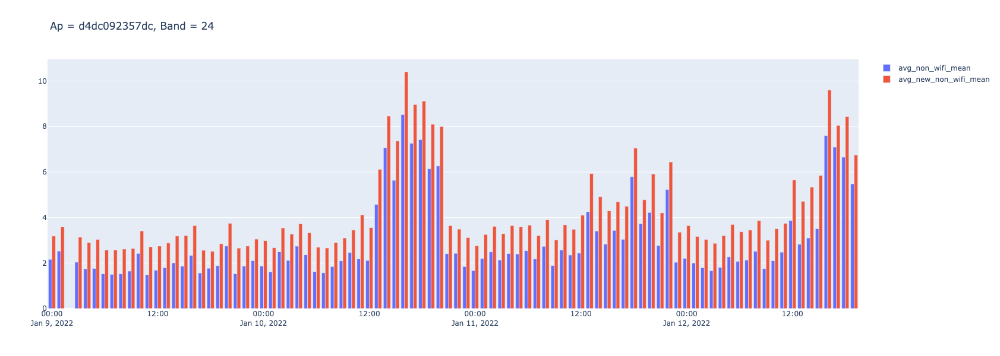

In [80]:
%%local
import plotly.graph_objects as go
def plot_non_wifi(df_filtered,ap_id,band,ch=None):
    if ch:
        temp = df_filtered[(df_filtered["ap_id"]==ap_id) & (df_filtered["band"]==band) & (df_filtered["channel"]==ch)]
    else:
        temp = df_filtered[(df_filtered["ap_id"]==ap_id) & (df_filtered["band"]==band)]
    fig = go.Figure()
    fig.add_bar(x=temp["timestamp"],y=100*temp["avg_non_wifi_max"],name = "avg_non_wifi_mean")
    fig.add_bar(x=temp["timestamp"],y=temp["avg_chan_im_non_wifi_max"],name = "avg_new_non_wifi_mean")
    #fig.add_bar(x=temp["timestamp"],y=100*temp["avg_unknown_wifi_max"],name = "avg_unknown_wifi_mean")

    #fig.add_bar(x=temp["timestamp"],y=temp["avg_chan_im_unknown_wifi_max"],name = "avg_new_unknown_wifi_mean")
    fig.update_layout(height=600, width=1800)
    fig.update_layout(
        title="Ap = {}, Band = {} Ch = {}".format(ap_id,band,ch) if ch else "Ap = {}, Band = {}".format(ap_id,band)
    )
    fig.show()
plot_non_wifi(df_filtered,"d4dc092357dc","5")
plot_non_wifi(df_filtered,"d4dc092357dc","24")

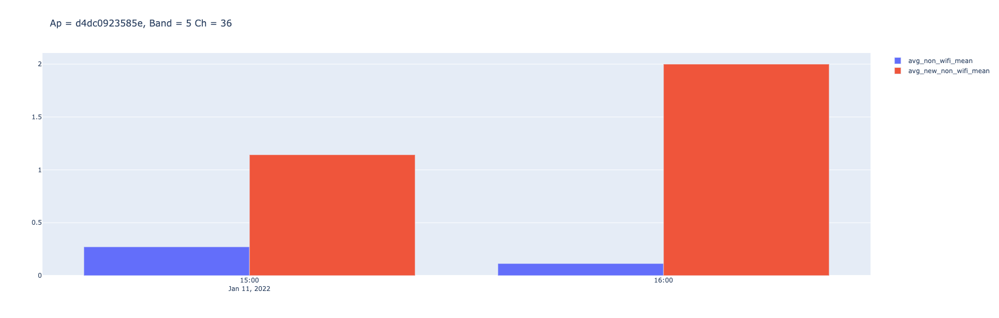

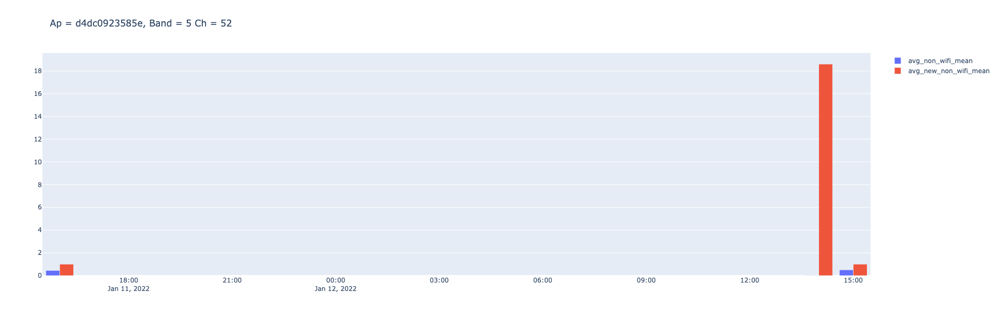

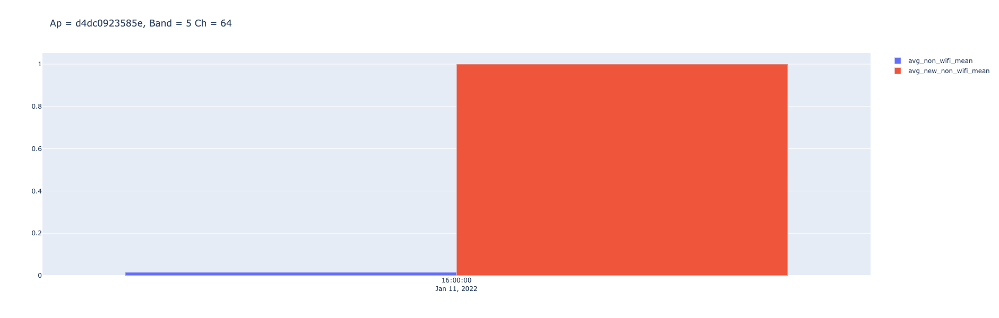

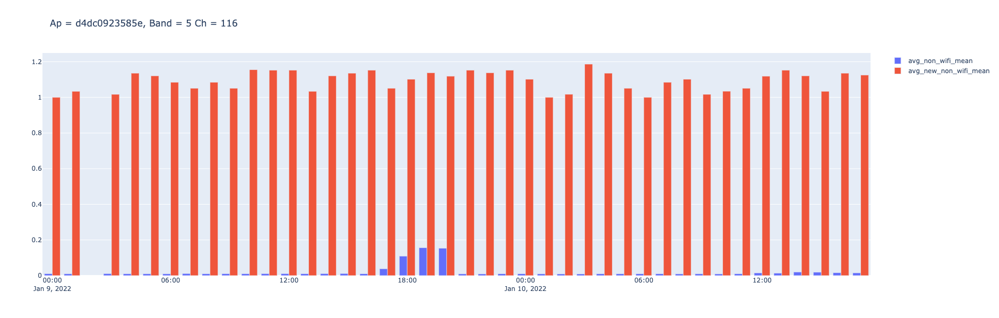

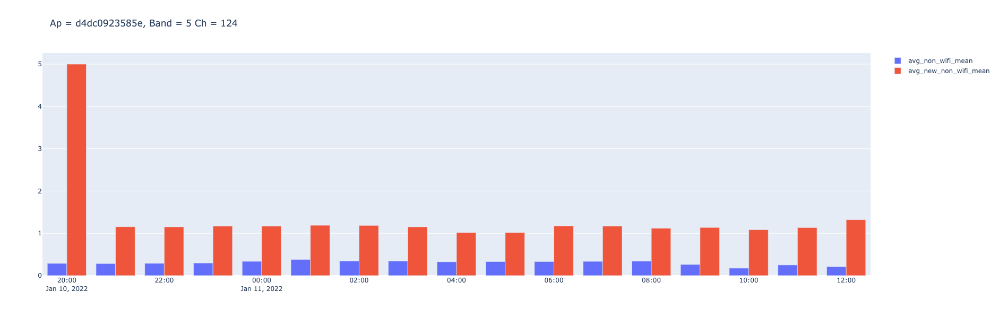

...

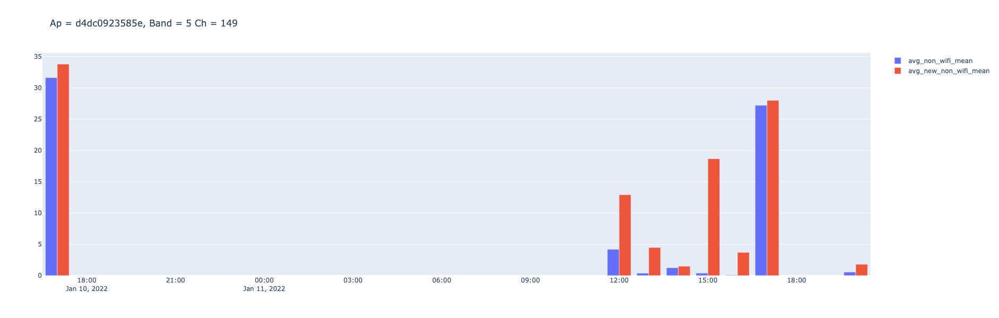

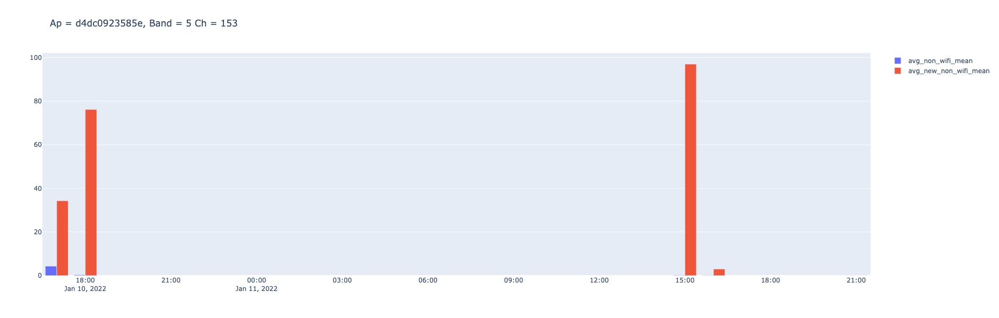

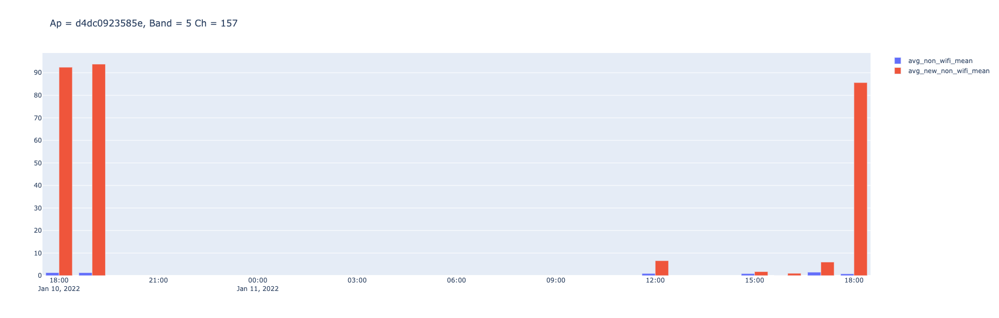

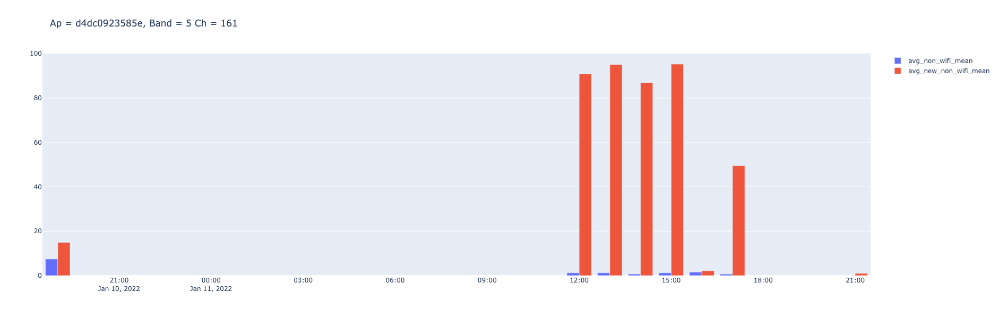

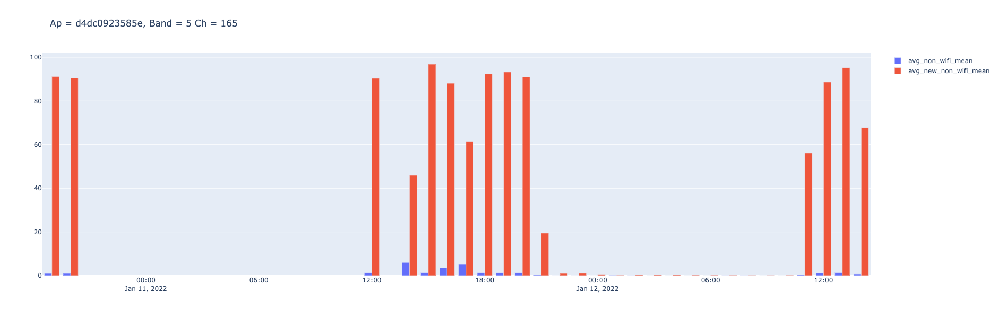

In [81]:
%%local
for ch in [36, 52, 64, 116, 124, 136, 149, 153, 157, 161, 165]:
    plot_non_wifi(df_filtered,"d4dc0923585e","5",ch=ch)
#plot_non_wifi(df_filtered,"d4dc0923585e","24")

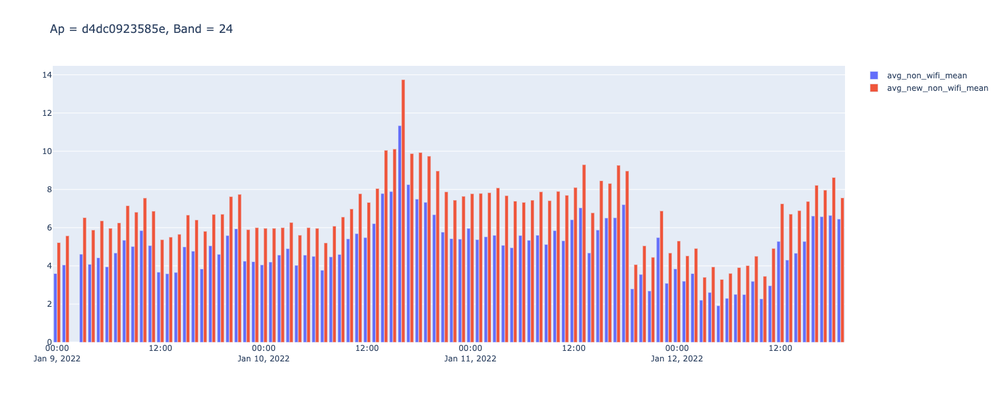

In [83]:
%%local
plot_non_wifi(df_filtered,"d4dc0923585e","24")

### Amazon Prod ABE5

In [7]:
df = spark.read.parquet("s3://mist-data-science-dev/may/rrm/non_wifi_data_comp_ABE5/").persist()
df.show()
df_filtered = df.filter(F.col("ap_id").isin("d420b0814b0e"))
df_filtered.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+------------+----+-------+-------+------------------+--------------------+--------------------+------------------------+-------------------------+--------------------+---------------------+-----------------------------+----------------------------+------------------+---------------+---------------------+-------------------------+----------------------+--------------------------+----------+---+
|             site_id|       ap_id|band|channel|util_tx|   avg_noise_floor|    avg_non_wifi_max|   avg_non_wifi_mean|avg_chan_im_non_wifi_max|avg_chan_im_non_wifi_mean|avg_unknown_wifi_max|avg_unknown_wifi_mean|avg_chan_im_unknown_wifi_mean|avg_chan_im_unknown_wifi_max|   avg_num_clients|max_num_clients|avg_non_wifi_max_diff|avg_unknown_wifi_max_diff|avg_non_wifi_mean_diff|avg_unknown_wifi_mean_diff|      date| hr|
+--------------------+------------+----+-------+-------+------------------+--------------------+--------------------+------------------------+--------------------

In [8]:
%%spark -o df_filtered

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [12]:
%%local
df_filtered[df_filtered["util_tx"]==0.0]

Output()

In [4]:
%%local
df_filtered["timestamp"]=df_filtered[["date","hr"]].apply(lambda x: "{} {}:00".format(x[0].date(),str(x[1]).zfill(2)),axis=1)
df_filtered["band"] = df_filtered["band"].apply(str)
df_filtered[["ap_id","band","channel","avg_non_wifi_max","avg_chan_im_non_wifi_max","date","hr","timestamp"]].head()
ap_id = "d4dc0923585e"
band ="5"
#ch=161
temp = df_filtered[(df_filtered["ap_id"]==ap_id) & (df_filtered["band"]==band)] #& (df_filtered["channel"]==ch)]
set(temp["channel"])
df_filtered["timestamp"]=df_filtered[["date","hr"]].apply(lambda x: "{} {}:00".format(x[0],str(x[1]).zfill(2)),axis=1)
df_filtered["band"] = df_filtered["band"].apply(str)
#df_filtered[["ap_id","band","channel","avg_non_wifi_max","avg_chan_im_non_wifi_max","date","hr","timestamp"]].head()
# ap_id = "d4dc0923585e"
# band ="5"
# #ch=161
# temp = df_filtered[(df_filtered["ap_id"]==ap_id) & (df_filtered["band"]==band)] #& (df_filtered["channel"]==ch)]
# set(temp["channel"])
def plot_non_wifi(df_filtered,ap_id,ch=None):
    if ch:
        temp_01 = df_filtered[(df_filtered["ap_id"]==ap_id) & (df_filtered["channel"]==ch)]
    else:
        temp_01 = df_filtered[(df_filtered["ap_id"]==ap_id)]
    
    fig = make_subplots(rows=2, cols=2,subplot_titles=['5G Avg Non Wifi Mean Vs Avg New Non Wifi Mean', '24G Avg Non Wifi Mean Vs Avg New Non Wifi Mean ', '5G Avg Noise Floor', '24G Avg Noise Floor'])
    c=0
    for band in ["5","24"]:
        c +=1
        temp = temp_01[temp_01["band"]==band].sort_values(by="timestamp")
        
        fig.add_bar(x=temp["timestamp"],y=100*temp["avg_non_wifi_max"],name = "avg_non_wifi_mean",row=1,col=c)
        fig.add_bar(x=temp["timestamp"],y=temp["avg_chan_im_non_wifi_max"],name = "avg_new_non_wifi_mean",row=1,col=c)

        fig.update_layout(
            title="Ap = {}".format(ap_id)
        )
        #fig.update_layout(height=600, width=1000)
        #fig = go.Figure()
        fig.add_trace(go.Scatter(x=temp["timestamp"],y=temp["avg_noise_floor"],mode = 'lines',name="avg_noise_floor"),row=2,col=c)
#         fig.update_layout(
#             title="Ap = {}, Band = {} Ch = {}".format(ap_id,band,ch) if ch else "Ap = {}, Band = {}".format(ap_id,band)
#         )
    fig.update_layout(height=900, width=1200)
    fig.show()
    

plot_non_wifi(df_filtered,"d420b0814b0e","5")

NameError: name 'df_filtered' is not defined

# RRM Ap Density and Power Distribution

In [4]:
df_site= spark.read.parquet("s3://mist-secorapp-production/dimension/site").select(F.col("id").alias("site_id"),F.col("name").alias("site_name"),"org_id")
df_site.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+------------+--------------------+
|             site_id|   site_name|              org_id|
+--------------------+------------+--------------------+
|9bd9c17c-0e94-4f0...|  San Carlos|6976f16d-210b-45f...|
|2248fcb9-bf19-4a1...|Primary Site|e3e76067-d9aa-49b...|
|8fa143d3-a668-410...|        CASA|500a7ff2-bae7-487...|
|7043359e-1c1b-4c9...|Primary Site|bb77c96b-250c-4ca...|
|da3a10a9-7daa-4ab...|  Store 0128|edf702f6-1ded-435...|
|7be4cdd5-5053-410...|Primary Site|5e83f257-c937-4b8...|
|1201f11e-1c65-11e...|      dspmy1|1200f16a-1c65-11e...|
|5a96cf74-3c38-11e...|      iuwio0|5a95a5ea-3c38-11e...|
|159dccd4-1d29-11e...|      y6sqpr|159cea8a-1d29-11e...|
|a4ce489e-3e34-11e...|      pv8aaa|a4cd56be-3e34-11e...|
|31eb1528-3f06-11e...|      tadx6c|31ea1ca4-3f06-11e...|
|67227ac6-e090-11e...| Matawan, NJ|1cfb284e-c95c-11e...|
|17ffe822-f46a-11e...|      nnarqy|17fe357c-f46a-11e...|
|2f7d67f0-2210-443...|      tjvkbz|58d107c1-7822-485...|
|54136144-e0c6-11e...|    New S

In [12]:
sites = df_site.agg(F.collect_set("site_id").alias("sites")).collect()[0]["sites"]

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [13]:
len(sites)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

90539

In [6]:
from datetime import datetime,timedelta
import redis,json
env = "production"
redis_server = "redis-proxy-rrm-{env}.mist.pvt".format(env=env)
connection_pool = redis.ConnectionPool(host=redis_server, port=6379)
redis_conn = redis.StrictRedis(connection_pool=connection_pool)
redis_conn.ping()

#user_site_id = "91d877fb-f17b-4f9b-b0c9-db0fdb3bf97c"
#band = "5"
#a = redis_conn.hget("rrm:global:{}:{}".format(user_site_id,band), "GraphStats")


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [21]:
site_graph_data = []
error_site=[]
for i in range(len(sites)):
    print("index {}".format(i))
    for band in ["24","5"]:
        try:
            site_graph = json.loads(redis_conn.hget("rrm:global:{}:{}".format(sites[i],band), "GraphStats"))
            temp = {}
            temp["site"] = sites[i]
            temp["band"] = band
            temp["avgNeighbors"] = site_graph["avgNeighbors"]
            temp["naps_by_power"]  = site_graph["naps_by_power"]
            site_graph_data.append(temp)
        except Exception as e:
            error_site.append(sites[i])

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

index 0
index 1
index 2
index 3
index 4
index 5
index 6
index 7
index 8
index 9
index 10
index 11
index 12
index 13
index 14
index 15
index 16
index 17
index 18
index 19
index 20
index 21
index 22
index 23
index 24
index 25
index 26
index 27
index 28
index 29
index 30
index 31
index 32
index 33
index 34
index 35
index 36
index 37
index 38
index 39
index 40
index 41
index 42
index 43
index 44
index 45
index 46
index 47
index 48
index 49
index 50
index 51
index 52
index 53
index 54
index 55
index 56
index 57
index 58
index 59
index 60
index 61
index 62
index 63
index 64
index 65
index 66
index 67
index 68
index 69
index 70
index 71
index 72
index 73
index 74
index 75
index 76
index 77
index 78
index 79
index 80
index 81
index 82
index 83
index 84
index 85
index 86
index 87
index 88
index 89
index 90
index 91
index 92
index 93
index 94
index 95
index 96
index 97
index 98
index 99
index 100
index 101
index 102
index 103
index 104
index 105
index 106
index 107
index 108
index 109
index 110


In [22]:
len(site_graph_data)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

60952

In [26]:
# find the median power of the site. avg power
site_graph_data[5]

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

{'site': '23879927-b49c-47dd-9740-8d6d466f4594', 'band': '5', 'avgNeighbors': 8.82, 'naps_by_power': {'10': 1.0, '8': 3.0, '11': 4.0, '13': 1.0, '9': 2.0}}

In [70]:
x = median(p)
type(x)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

<class 'int'>

In [73]:
# find median power and mean power
for data in site_graph_data:
    d,n=1,0
    p=[]
    for k,v in data["naps_by_power"].items():
            d += int(v) # naps
            n += int(k)*int(v)
            for i in range(int(v)):
                p.append(int(k))
    data["avg_power"] = int(round(n/d,0))
    data["median_power"] = int(median(p)) if len(p)>0 else 0
    

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [74]:
df = spark.createDataFrame(site_graph_data)
df.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+---------+----+------------+--------------------+--------------------+
|avgNeighbors|avg_power|band|median_power|       naps_by_power|                site|
+------------+---------+----+------------+--------------------+--------------------+
|        0.83|        0|  24|           0|                  {}|b30a8d1f-4e89-4ff...|
|         2.5|       11|   5|          13|{11 -> 2.0, 12 ->...|b30a8d1f-4e89-4ff...|
|         3.4|        4|  24|           5|          {5 -> 5.0}|a4ab220a-e017-441...|
|         3.2|       10|   5|          11|{11 -> 3.0, 12 ->...|a4ab220a-e017-441...|
|        10.0|        7|  24|           8|         {8 -> 11.0}|23879927-b49c-47d...|
|        8.82|        9|   5|          10|{11 -> 4.0, 8 -> ...|23879927-b49c-47d...|
|        1.67|        4|  24|           5|{5 -> 2.0, 7 -> 1.0}|127785b3-fb08-43c...|
|         2.0|        9|   5|          12|{12 -> 2.0, 13 ->...|127785b3-fb08-43c...|
|        4.54|        5|  24|           3|{12 -> 2.0, 14 ->...|7c

In [75]:
df.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

60952

In [76]:
%%spark -o df -n 60952

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [77]:
%%local
df.head()

,avgNeighbors,avg_power,band,median_power,naps_by_power,site
0,0.83,0,24,0,{},b30a8d1f-4e89-4ffd-8363-da9580a775d2
1,2.50,11,5,13,"{'12': 1.0, '11': 2.0, '13': 5.0, '16': 1.0, '...",b30a8d1f-4e89-4ffd-8363-da9580a775d2
2,3.40,4,24,5,{'5': 5.0},a4ab220a-e017-4414-8ffa-69815674d73e
3,3.20,10,5,11,"{'11': 3.0, '12': 2.0}",a4ab220a-e017-4414-8ffa-69815674d73e
4,10.00,7,24,8,{'8': 11.0},23879927-b49c-47dd-9740-8d6d466f4594


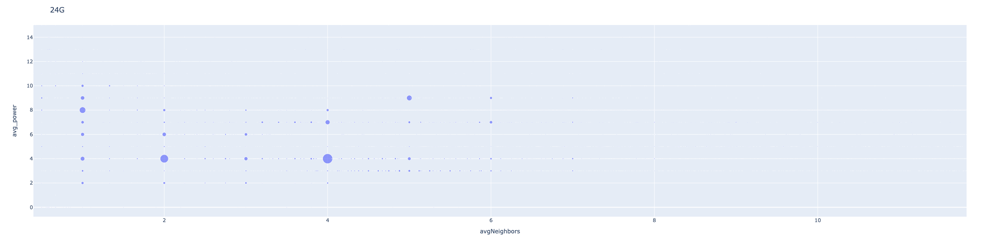

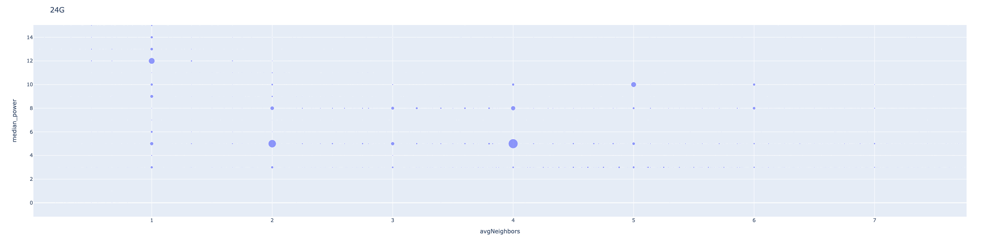

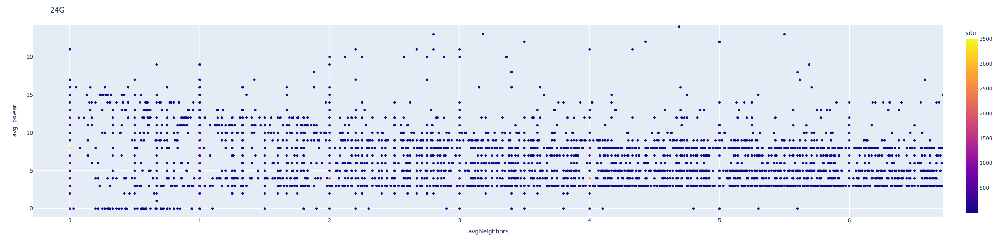

In [87]:
%%local
temp = df[df["band"]==24].groupby(["band","avgNeighbors","avg_power"])["site"].count().reset_index()
fig = px.scatter(temp,x="avgNeighbors",y="avg_power",size="site")
fig.update_layout(height=600, width=800)
fig.update_layout(title ="24G")
fig.show()

temp_median = df[df["band"]==24].groupby(["band","avgNeighbors","median_power"])["site"].count().reset_index()

fig = px.scatter(temp_median,x="avgNeighbors",y="median_power",size="site")
fig.update_layout(height=600, width=800)
fig.update_layout(title ="24G")
fig.show()

fig = px.scatter(temp,x="avgNeighbors",y="avg_power",color="site")
fig.update_layout(height=600, width=800)
fig.update_layout(title ="24G")
fig.show()


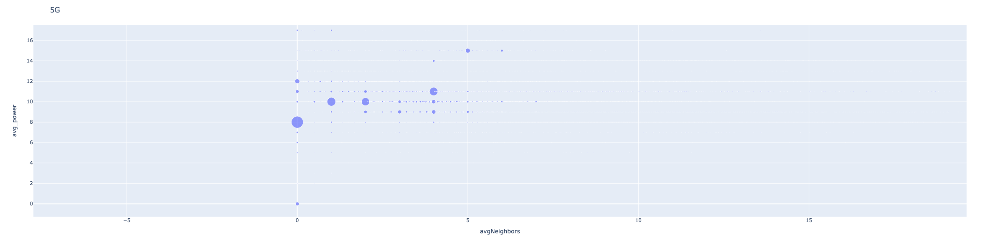

In [88]:
%%local
temp = df[df["band"]==5].groupby(["band","avgNeighbors","avg_power"])["site"].count().reset_index()
fig = px.scatter(temp,x="avgNeighbors",y="avg_power",size="site")
fig.update_layout(height=600, width=800)
fig.update_layout(title ="5G")
fig.show()
# fig = px.scatter(temp,x="avgNeighbors",y="avg_power",color="site")
# fig.update_layout(height=600, width=800)
# fig.update_layout(title ="5G")

# Num Client in Aps Analysis

In [25]:
from uuid import UUID
def band_from_index(band_index):
    if band_index ==0:
        return "24"
    elif band_index == 1:
        return "5"
    elif band_index == 2:
        return "4.9"
    elif band_index == 3:
        return "2.4FH"
    elif band_index == 5:
        return "6"
    else:
        return "?"
    
def convert_bytes_to_uuid(uuid_bytearray):
    '''
    Convert protobuf UUID bytearray generated by GO to uuid string
    >>> convert_bytes_to_uuid(bytearray(b'\xcd\xa2\x8b\x7fw\xc1El\xae/\x12\xb7\x03\xd8,\x16'))
    'cda28b7f-77c1-456c-ae2f-12b703d82c16'
    >>> convert_bytes_to_uuid(bytearray(b'v\xd6\x9c<\x05\xaeO\x8a\xae\x16\x0c\x08\x98\xc2\xf2\xf0'))
    '76d69c3c-05ae-4f8a-ae16-0c0898c2f2f0'
    :param uuid_bytearray:
    :return:
    '''
    int_val = int.from_bytes(uuid_bytearray, byteorder='big')
    return str(UUID(int=int_val))

convert_bytes_to_uuidUDF = F.udf(convert_bytes_to_uuid,StringType())

def convert_bytes_to_mac(mac_bytes, sep=''):
    '''
    Convert protobuf Mac bytearray generated by GO to mac string
    >>> convert_bytes_to_mac(bytearray(b'\x88\xc6&\xb2B\xad'))
    '88c626b242ad'
    >>> convert_bytes_to_mac(bytearray(b'\x88\xc6&\xb2B\xad'), sep='-')
    '88-c6-26-b2-42-ad'
    :param mac_bytes:
    :return:
    '''
    if mac_bytes is None or len(mac_bytes) != 6:
        return ""
    return sep.join(["{:02x}".format(b) for b in mac_bytes])
    
convert_bytes_to_macUDF = F.udf(convert_bytes_to_mac,StringType())
band_from_indexUDF = F.udf(band_from_index,StringType())

def non_wifi_final(non_wifi,unknown_wifi):
    return (non_wifi * 2.0 + unknown_wifi) / (1 + non_wifi)

non_wifi_finalUDF = F.udf(non_wifi_final,DoubleType())


from statistics import median

def rssi_variation(antenna_rssis):
    try:
        if len(antenna_rssis) > 0:
            v = [0 for i in range(len(antenna_rssis[0]))]
            total = 0
            for antenna_rssi in antenna_rssis:
                if len(antenna_rssi) > 0:
                    total +=1
                    m = median(antenna_rssi)
                    t = [i-m for i in antenna_rssi]
                    for i in range(len(antenna_rssi)):
                        v[i] += t[i]
            return [round(r/total,1) for r in v]
    except Exception as e:
        return [-1.0]

rssi_variationUDF = F.udf(rssi_variation,ArrayType(FloatType()))    

for d in range(1,3):
    current_date = datetime.now() - timedelta(days=d)
    date = "{}".format(current_date.date())
    for h in range(0,24):
        hr= str(h).zfill(2)
        try:
            df = spark.read.parquet("s3://mist-data-science-dev/may/ap_client_count/date={}/hr={}".format(date,hr))
            df.show(1)
        except:
            df = spark.read.parquet("s3://mist-secorapp-production/ap-stats-full/ap-stats-full-production/dt={}/hr={}".format(date,hr))\
                    .withColumn("radios",F.explode("radios"))\
                                    .filter(F.col("radios.bandwidth")>0)\
                                    .select(convert_bytes_to_uuidUDF("org_id").alias("org_id"),\
                                    convert_bytes_to_uuidUDF("site_id").alias("site_id"),\
                                    convert_bytes_to_macUDF("id").alias("ap_id"),\
                                    band_from_indexUDF(F.col("radios.band")).alias("band"),""\
                                    "radios.num_clients","radios.channel",F.from_unixtime("when.seconds").alias("when"))
            df_num_client = df.groupby("org_id","site_id","ap_id","band").agg(F.max("num_clients").alias('max_client_count'),\
                                                                          F.percentile_approx("num_clients", 0.5).alias("median_client_count"))
            df_num_client.coalesce(50).write.mode("overwrite")\
                    .parquet("s3://mist-data-science-dev/may/ap_client_count/date={}/hr={}".format(date,hr))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [6]:
df_c  = spark.read.parquet("s3://mist-data-science-dev/may/ap_client_count").persist()
df_c.show(2)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+------------+----+----------------+-------------------+----------+---+
|              org_id|             site_id|       ap_id|band|max_client_count|median_client_count|      date| hr|
+--------------------+--------------------+------------+----+----------------+-------------------+----------+---+
|002e2a36-35f0-4ca...|0a5d2cbb-8993-417...|d420b080572b|  24|               0|                  0|2021-12-26|  8|
|002e2a36-35f0-4ca...|0cefc624-13bd-4a6...|d420b080123e|  24|               0|                  0|2021-12-26|  8|
+--------------------+--------------------+------------+----+----------------+-------------------+----------+---+
only showing top 2 rows

In [17]:
df_dist_max_client = df_c.withColumn("max_client_count", 10*F.round(0.1*F.col("max_client_count"))).groupby("band","max_client_count").agg(F.count("ap_id").alias("ap_count"),F.countDistinct("ap_id").alias("unique_ap_count"))
df_dist_max_client.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

58

In [19]:
df_dist_median_client = df_c.withColumn("median_client_count", 10*F.round(0.1*F.col("median_client_count"))).groupby("band","median_client_count").agg(F.count("ap_id").alias("ap_count"),F.countDistinct("ap_id").alias("unique_ap_count"))
df_dist_median_client.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

55

In [20]:
%%spark -o df_dist_max_client

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [21]:
%%spark -o df_dist_median_client

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

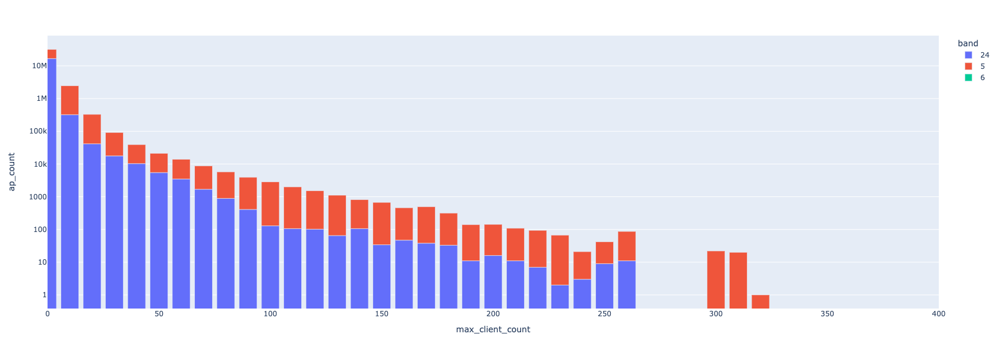

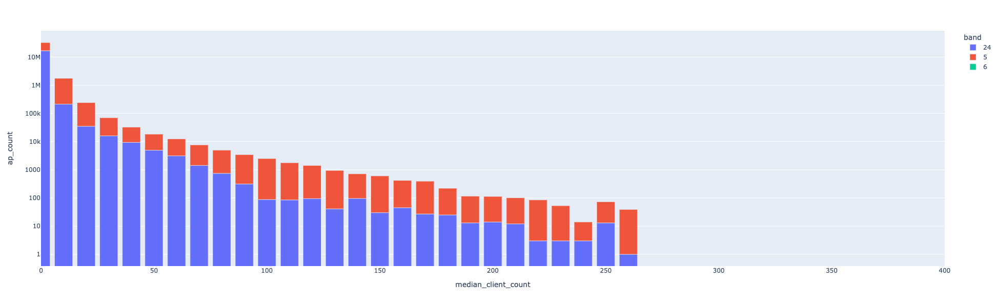

In [22]:
%%local
df_dist_max_client["band"] = df_dist_max_client["band"].apply(str)
fig = px.bar(df_dist_max_client,x="max_client_count",y="ap_count",color="band",log_y=True)
fig.update_layout(height=600, width=800)
fig.update_xaxes(range=(0, 400))
fig.show()


df_dist_median_client["band"] = df_dist_median_client["band"].apply(str)
fig = px.bar(df_dist_median_client,x="median_client_count",y="ap_count",color="band",log_y=True)
fig.update_layout(height=600, width=800)
fig.update_xaxes(range=(0, 400))
fig.show()

In [11]:
df_c.agg(F.countDistinct("ap_id").alias("unique_ap_count")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+---------------+
|unique_ap_count|
+---------------+
|         378535|
+---------------+

In [12]:
df_c.filter(F.col("max_client_count")>100).agg(F.countDistinct("ap_id").alias("unique_ap_count")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+---------------+
|unique_ap_count|
+---------------+
|            454|
+---------------+

In [15]:
df_device_name = spark.read.parquet("s3://mist-secorapp-production/dimension/device")\
    .join(df_name,["org_id","site_id"]).select("org_id","org_name","site_id","site_id","site_name",F.col("mac").alias("ap_mac"),F.col("name").alias("ap_name"))
df_site_ap_count = df_device_name.groupby("org_id","org_name","site_id","site_name").agg(F.countDistinct("ap_mac").alias("total_ap"))


df_c.filter(F.col("max_client_count")>100).groupby("org_id","site_id","band").agg(F.countDistinct("ap_id").alias("unique count of ap with more than 100 clients"),\
                                                                                  F.avg("max_client_count").alias("avg_client_count"),\
                                                                                 F.max("max_client_count").alias("max_client_count"))\
        .join(df_site_ap_count,["org_id","site_id"]).sort(F.desc("unique count of ap with more than 100 clients"))\
    .select("org_name","site_name","site_id","band","total_ap","avg_client_count","max_client_count","unique count of ap with more than 100 clients").show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------------+------------------------+------------------------------------+----+--------+------------------+----------------+---------------------------------------------+
|org_name          |site_name               |site_id                             |band|total_ap|avg_client_count  |max_client_count|unique count of ap with more than 100 clients|
+------------------+------------------------+------------------------------------+----+--------+------------------+----------------+---------------------------------------------+
|AmazonOTFC-Prod   |KSBD                    |96ea4b59-df97-4c1f-b740-c53e22fbd7eb|5   |290     |122.33333333333333|170             |11                                           |
|UPS OPS           |BEBEBSE                 |b717a244-8601-4ccf-bc95-9ebe86df32bb|5   |34      |149.54545454545453|242             |6                                            |
|UPS OPS           |USCARVE                 |56266c7e-661a-4f62-9cc0-e13233a3912e|24  |123     |136.5    

In [27]:
df_c.filter(F.col("max_client_count")>100).join(df_site_ap_count,["org_id","site_id"]).show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------------------------------+------------------------------------+------------+----+----------------+-------------------+----------+---+----------------+---------+--------+
|org_id                              |site_id                             |ap_id       |band|max_client_count|median_client_count|date      |hr |org_name        |site_name|total_ap|
+------------------------------------+------------------------------------+------------+----+----------------+-------------------+----------+---+----------------+---------+--------+
|5a578f3c-f094-4d13-a7dd-96f0aaecb5b6|557ae512-0ae0-4e37-bf91-79ec51e3ac1e|5c5b35ceffb9|5   |146             |146                |2021-12-27|18 |AmazonOTN19-Prod|DBY2     |28      |
|5a578f3c-f094-4d13-a7dd-96f0aaecb5b6|557ae512-0ae0-4e37-bf91-79ec51e3ac1e|5c5b35ceffb9|5   |115             |111                |2021-12-26|14 |AmazonOTN19-Prod|DBY2     |28      |
|5a578f3c-f094-4d13-a7dd-96f0aaecb5b6|557ae512-0ae0-4e37-bf91-79ec51e3ac1e|5c5b35ceffb9|5 

In [12]:
a = df_c.filter(F.col("max_client_count")>100).select("org_id","site_id","ap_id","band").distinct().limit(20).collect()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [19]:
for i in a:
    print("[\"{}\",\"{}\",\"{}\",\"{}\"],".format(i["org_id"],i["site_id"],i["ap_id"],i["band"]))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

["0f2adb1c-8843-448f-8753-91a3d2fdbd14","6f3f4667-f92a-4dd0-bd75-a10fb8239cc1","d420b0011819","5"],
["3362755c-5ef1-46d8-b541-f576a81f600d","b3c32004-a0dc-4353-b697-1065fbd4f639","5c5b352edb2e","24"],
["38a18d4d-1623-4985-86d0-1bb06e5e2a48","898f0422-d548-40cf-a2df-73d4ea5aff0d","d420b02027ba","24"],
["0f2adb1c-8843-448f-8753-91a3d2fdbd14","fb703880-238b-45d6-9ece-c7414d7cc026","5c5b352eec4a","5"],
["5a578f3c-f094-4d13-a7dd-96f0aaecb5b6","f7358fde-4543-4f39-9ae5-33630bbfa2a2","d420b001bf8f","5"],
["0f2adb1c-8843-448f-8753-91a3d2fdbd14","7e957fc3-2642-4d4f-bbf7-0c943fa8bb5d","5c5b35ceaf46","5"],
["0f2adb1c-8843-448f-8753-91a3d2fdbd14","e4a3014b-0685-4b8d-b59e-9d42451dc94b","d420b02032cd","5"],
["5a578f3c-f094-4d13-a7dd-96f0aaecb5b6","8045b895-699c-4c87-b23b-d963534756ce","d420b085248b","5"],
["d8cec22e-e0c2-11e5-8d0f-02e208b2d34f","56926e4a-b51a-43ad-b4a9-930d61fcec26","d420b0027d9e","5"],
["0f2adb1c-8843-448f-8753-91a3d2fdbd14","5022b114-6e23-4427-928d-4b30a4b9fa96","5c5b35be69b4","5"]

In [32]:
for r in a:
    print("https://manage.mist.com/admin/?org_id={}#!dashboard/serviceLevels/page2/\
stats/-/-/device/00000000-0000-0000-1000-{}/capacity/-/-/customRange/1640494800/1640667600/{}".format(r["org_id"],r["ap_id"],r["site_id"]))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

https://manage.mist.com/admin/?org_id=0f2adb1c-8843-448f-8753-91a3d2fdbd14#!dashboard/serviceLevels/page2/stats/-/-/device/00000000-0000-0000-1000-5c5b352ee5e2/capacity/-/-/customRange/1640494800/1640667600/eb236ced-26ef-4086-9ad2-d691996dc286
https://manage.mist.com/admin/?org_id=0f2adb1c-8843-448f-8753-91a3d2fdbd14#!dashboard/serviceLevels/page2/stats/-/-/device/00000000-0000-0000-1000-5c5b352eec4a/capacity/-/-/customRange/1640494800/1640667600/fb703880-238b-45d6-9ece-c7414d7cc026
https://manage.mist.com/admin/?org_id=0f2adb1c-8843-448f-8753-91a3d2fdbd14#!dashboard/serviceLevels/page2/stats/-/-/device/00000000-0000-0000-1000-d420b0805f46/capacity/-/-/customRange/1640494800/1640667600/21224cec-d51e-4495-b2de-2cd26e6a3e6d
https://manage.mist.com/admin/?org_id=0f2adb1c-8843-448f-8753-91a3d2fdbd14#!dashboard/serviceLevels/page2/stats/-/-/device/00000000-0000-0000-1000-d420b0807873/capacity/-/-/customRange/1640494800/1640667600/7e957fc3-2642-4d4f-bbf7-0c943fa8bb5d
https://manage.mist.com/

In [ ]:
df

In [ ]:
https://manage.mist.com/admin/?org_id=0f2adb1c-8843-448f-8753-91a3d2fdbd14#!dashboard/serviceLevels/page2/stats/-/-/device/00000000-0000-0000-1000-5c5b352ee5e2/capacity/-/-/customRange/1640494800/1640667600/eb236ced-26ef-4086-9ad2-d691996dc286?org_id=0f2adb1c-8843-448f-8753-91a3d2fdbd14
https://manage.mist.com/admin/?org_id=0f2adb1c-8843-448f-8753-91a3d2fdbd14#!dashboard/serviceLevels/page2/stats/-/-/device/00000000-0000-0000-1000-d420b0805f46/capacity/-/-/customRange/1640494800/1640667600/21224cec-d51e-4495-b2de-2cd26e6a3e6d?org_id=0f2adb1c-8843-448f-8753-91a3d2fdbd14
https://manage.mist.com/admin/?org_id=0f2adb1c-8843-448f-8753-91a3d2fdbd14#!dashboard/serviceLevels/page2/stats/-/-/device/00000000-0000-0000-1000-d420b02009c9/capacity/-/-/customRange/1640494800/1640667600/ae37433d-a6df-41e8-8701-0cfc8ec02b2e?org_id=0f2adb1c-8843-448f-8753-91a3d2fdbd14

In [ ]:
# get client utilization from cassandra.






(stormconf, keyspace="rrm"):
    # keyspace = "rrm"
    cassandra_host = stormconf.get('cassandra.v3cluster', [])
    try:
        # cluster = stormconf.get('cassandra.cluster', {})
        # cluster = Cluster(cluster.get('hosts'),
        #                   protocol_version=cluster.get("proto", 3),  # 4 for cassandra 3.X
        #                   port=cluster.get('port', 9042),
        #                   cql_version='3.2.1',
        #                   connect_timeout=cluster.get("connect_timeout", 50))
        #
        if not cassandra_host:
            storm.logError("No Cassandra host {} {}".format(cassandra_host, keyspace))
            return
        if "v3" in cassandra_host[0]:
            #
            #
            cluster = Cluster(cassandra_host,
                              protocol_version=4,
                              port=9042,
                              cql_version='3.4.4',
                              connect_timeout=50.0
                              )
        else:
            cluster = Cluster(cassandra_host,
                              protocol_version=3,
                              port=9042,
                              cql_version='3.2.1',
                              connect_timeout=50.0
                              )

        session = cluster.connect(keyspace)
        if not session:
            storm.logError("FAILED. No Cassandra host-session {} {}".format(cassandra_host, keyspace))
        return session
    except Exception as e:
        storm.logErrorb
        #('FAILED. E_BOLT_FAILED: cassandra error configuration or connection - {} {}'.format(
            cassandra_host, str(e)))
        # storm.logWarn('E_BOLT_FAILED'+ str(e))
        return None


# Scan Data for CVS

In [29]:
from pyspark.sql.functions import udf, size, avg, count, col,sum, explode

import pyspark.sql.functions as F

import json
from datetime import datetime,timedelta
env = "production"
# env = "staging"

now = datetime.now()  - timedelta(hours=3)
date_day = now.strftime("%Y-%m-%d")
date_hour = now.strftime("%H")
date_hour = "2*"

s3_bucket = "s3://mist-secorapp-{env}/ap-stats-full/ap-stats-full-{env}/".format(env=env)
s3_bucket += "dt={date}/hr={hr}/*.parquet".format(date=date_day, hr=date_hour)

print(s3_bucket)

df= spark.read.parquet(s3_bucket)
#df.printSchema()

from uuid import UUID
def convert_bytes_to_mac(mac_bytes, sep=''):
    '''
    Convert protobuf Mac bytearray generated by GO to mac string
    >>> convert_bytes_to_mac(bytearray(b'\x88\xc6&\xb2B\xad'))
    '88c626b242ad'
    >>> convert_bytes_to_mac(bytearray(b'\x88\xc6&\xb2B\xad'), sep='-')
    '88-c6-26-b2-42-ad'
    :param mac_bytes:
    :return:
    '''
    if mac_bytes is None or len(mac_bytes) != 6:
        return ""

    return sep.join(["{:02x}".format(b) for b in mac_bytes])


def convert_bytes_to_uuid(uuid_bytearray):
    '''
    Convert protobuf UUID bytearray generated by GO to uuid string
    >>> convert_bytes_to_uuid(bytearray(b'\xcd\xa2\x8b\x7fw\xc1El\xae/\x12\xb7\x03\xd8,\x16'))
    'cda28b7f-77c1-456c-ae2f-12b703d82c16'
    >>> convert_bytes_to_uuid(bytearray(b'v\xd6\x9c<\x05\xaeO\x8a\xae\x16\x0c\x08\x98\xc2\xf2\xf0'))
    '76d69c3c-05ae-4f8a-ae16-0c0898c2f2f0'
    :param uuid_bytearray:
    :return:
    '''
    int_val = int.from_bytes(uuid_bytearray, byteorder='big')
    return str(UUID(int=int_val))


def convert_bytes_to_string(uuid_bytearray):
    '''
    '''
    return str(bytes(uuid_bytearray), "utf-8")


# from pyspark.sql.types import *
from pyspark.sql.types import *
bytes_to_uuid = F.udf(convert_bytes_to_uuid, StringType())
bytes_to_mac = F.udf(convert_bytes_to_mac, StringType())
bytes_to_string = F.udf(convert_bytes_to_string, StringType())


df = df.withColumn("org_id", bytes_to_uuid(F.col("org_id")) ) \
    .withColumn("site_id", bytes_to_uuid(F.col("site_id")) ) \
    .withColumn("id", bytes_to_mac(F.col("id")) )


site_id = "7487264a-2214-42cf-ada7-f19bdb09c059"   # saurabh
site_id = "825c05a6-0f21-4e88-b84d-fc8068ad292c"  # CVS site

df_site = df.filter(F.col("site_id") == site_id)
#df_site.count()


# 'scan' includes all scan24Ghz, Scan5Ghz and Scan6GHz
# df_site.select("id", "scan").show()
df_scan = df_site.select("org_id", "site_id", "id", "firmware_version" , "model", F.explode("scan").alias("scan"), F.to_timestamp("When.seconds").alias("when"))\
    .select("org_id", "site_id", "id", "firmware_version", "model", F.col("scan.*"),"when")

df_scan = df_scan.withColumn("bssid", bytes_to_mac(F.col("bssid")) ) \
    .withColumn("ssid", bytes_to_string(F.col("ssid")))


#df_scan.printSchema()
#df_scan.count()



FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

s3://mist-secorapp-production/ap-stats-full/ap-stats-full-production/dt=2022-02-20/hr=2*/*.parquet

In [28]:
df_scan.unpersist()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

DataFrame[org_id: string, site_id: string, id: string, firmware_version: string, model: string, ssid: string, bssid: string, rssi: int, channel: struct<primary:int,width:int,secondary:int>, potential_rogue: boolean, is_spoof: boolean, listen_channel: int, when: timestamp]

In [30]:
df_scan.persist()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

DataFrame[org_id: string, site_id: string, id: string, firmware_version: string, model: string, ssid: string, bssid: string, rssi: int, channel: struct<primary:int,width:int,secondary:int>, potential_rogue: boolean, is_spoof: boolean, listen_channel: int, when: timestamp]

In [5]:
df_site.printSchema()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

root
 |-- id: string (nullable = true)
 |-- org_id: string (nullable = true)
 |-- groups: array (nullable = true)
 |    |-- element: string (containsNull = true)
 |-- site_id: string (nullable = true)
 |-- when: struct (nullable = true)
 |    |-- seconds: long (nullable = true)
 |    |-- nanos: integer (nullable = true)
 |-- map_id: binary (nullable = true)
 |-- xyz: array (nullable = true)
 |    |-- element: double (containsNull = true)
 |-- uptime: integer (nullable = true)
 |-- model: string (nullable = true)
 |-- firmware_version: string (nullable = true)
 |-- configured: boolean (nullable = true)
 |-- license_expired: boolean (nullable = true)
 |-- interval: double (nullable = true)
 |-- proc: struct (nullable = true)
 |    |-- mem_info: struct (nullable = true)
 |    |    |-- total_kb: long (nullable = true)
 |    |    |-- available_kb: long (nullable = true)
 |    |-- slab_info: struct (nullable = true)
 |    |    |-- top: struct (nullable = true)
 |    |    |    |-- name: strin

In [31]:
df_scan = df_site.select("org_id", "site_id", "id", "firmware_version" , "model", F.explode("scan").alias("scan"),F.col("when.seconds").alias("when"))\
    .select("org_id", "site_id", "id", "firmware_version", "model", F.col("scan.*"),F.to_timestamp("when"))

df_scan = df_scan.withColumn("bssid", bytes_to_mac(F.col("bssid")))
    #.withColumn("ssid", bytes_to_string(F.col("ssid")))

df_scan.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+------------+--------------------+-------+--------------------+------------+----+------------+---------------+--------+--------------+-------------------+
|              org_id|             site_id|          id|    firmware_version|  model|                ssid|       bssid|rssi|     channel|potential_rogue|is_spoof|listen_channel| to_timestamp(when)|
+--------------------+--------------------+------------+--------------------+-------+--------------------+------------+----+------------+---------------+--------+--------------+-------------------+
|bf105f5e-2490-453...|825c05a6-0f21-4e8...|ac23164034f8|apfw-0.8.21022-ho...|AP33-US|[00 00 00 00 00 0...|ac231647fd85| -67|{157, 20, 0}|           true|   false|           157|2022-02-20 21:02:35|
|bf105f5e-2490-453...|825c05a6-0f21-4e8...|ac23164034f8|apfw-0.8.21022-ho...|AP33-US|[00 00 00 00 00 0...|ac231647fd84| -67|{157, 20, 0}|           true|   false|           157|2022-02-20 21:02:35|
|bf105f5e-

In [23]:
df_scan.agg(F.countDistinct("id")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

An error was encountered:

  An exception was thrown from the Python worker. Please see the stack trace below.
Traceback (most recent call last):
  File "/mnt/yarn/usercache/livy/appcache/application_1640120671103_0396/container_1640120671103_0396_01_000119/pyspark.zip/pyspark/worker.py", line 604, in main
    process()
  File "/mnt/yarn/usercache/livy/appcache/application_1640120671103_0396/container_1640120671103_0396_01_000119/pyspark.zip/pyspark/worker.py", line 596, in process
    serializer.dump_stream(out_iter, outfile)
  File "/mnt/yarn/usercache/livy/appcache/application_1640120671103_0396/container_1640120671103_0396_01_000119/pyspark.zip/pyspark/serializers.py", line 211, in dump_stream
    self.serializer.dump_stream(self._batched(iterator), stream)
  File "/mnt/yarn/usercache/livy/appcache/application_1640120671103_0396/container_1640120671103_0396_01_000119/pyspark.zip/pyspark/serializers.py", line 132, in dump_stream
    for obj in iterator:
  File "/mnt/yarn/usercache/l

In [33]:
df_scan.select("id","model").distinct().show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+-------+
|id          |model  |
+------------+-------+
|ac23164034f8|AP33-US|
|ac23164034cb|AP33-US|
|ac23164034d0|AP33-US|
|ac2316403345|AP33-US|
|ac23164034da|AP33-US|
|ac23164032d7|AP33-US|
+------------+-------+

In [18]:
df_scan.filter(F.col("id")=="d4dc09ae1325").show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------+-------+---+----------------+-----+----+-----+----+-------+---------------+--------+--------------+------------------+
|org_id|site_id| id|firmware_version|model|ssid|bssid|rssi|channel|potential_rogue|is_spoof|listen_channel|to_timestamp(when)|
+------+-------+---+----------------+-----+----+-----+----+-------+---------------+--------+--------------+------------------+
+------+-------+---+----------------+-----+----+-----+----+-------+---------------+--------+--------------+------------------+

## AP-wifi-scan-results from S3

In [12]:
df_device = spark.read.parquet("s3://mist-secorapp-production/dimension/device")\
                .select(F.col("mac").alias("ap_id"),"model")
df_device.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+------------+
|       ap_id|       model|
+------------+------------+
|5c5b350f2d97|        AP41|
|5c5b351e2c7e|        BT11|
|5c5b352e78be|        AP41|
|5c5b358e01d1|        AP41|
|e74489000005|        MOTE|
|007888e626fe|AIR-VBLE1-K9|
|e70004145632|        MOTE|
|e74489000007|        MOTE|
|5c5b35bf0e96|        AP41|
|5c5b3552da9b|        AP43|
|007888e65fca|AIR-VBLE1-K9|
|5c5b350e6172|       AP41E|
|5c5b352e46d7|        AP41|
|5c5b350f29b9|        AP41|
|d420b0850bbd|        AP41|
|5c5b350e7d23|        BT11|
|5c5b350e1a45|        AP41|
|5c5b359f706b|        AP41|
|5c5b35d267ff|       AP43E|
|5c5b359f0dab|        AP41|
+------------+------------+
only showing top 20 rows

In [14]:

convert_bytes_to_uuidUDF = F.udf(convert_bytes_to_uuid, StringType())
convert_bytes_to_macUDF = F.udf(convert_bytes_to_mac, StringType())

df_scan = spark.read.parquet("s3://mist-secorapp-production/ap-wifi-scan-results/ap-wifi-scan-results-production/dt=2022-02-28/hr=07/")\
                .select(convert_bytes_to_uuidUDF("info_from_terminator.site_id").alias("site_id"),\
                convert_bytes_to_uuidUDF("info_from_terminator.org_id").alias("org_id"),F.col("copied.firmware_version"),\
                convert_bytes_to_macUDF("id").alias("ap_id"),"scan24GHz","scan5GHz","scan6_ghz",\
                F.to_timestamp("info_from_terminator.timestamp.seconds").alias("when"),\
                 ).join(df_device,"ap_id")\
                 .persist()
df_scan.printSchema()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

root
 |-- ap_id: string (nullable = true)
 |-- site_id: string (nullable = true)
 |-- org_id: string (nullable = true)
 |-- firmware_version: string (nullable = true)
 |-- scan24GHz: array (nullable = true)
 |    |-- element: struct (containsNull = true)
 |    |    |-- ssid: binary (nullable = true)
 |    |    |-- bssid: binary (nullable = true)
 |    |    |-- rssi: integer (nullable = true)
 |    |    |-- channel: struct (nullable = true)
 |    |    |    |-- primary: integer (nullable = true)
 |    |    |    |-- secondary: integer (nullable = true)
 |    |    |    |-- width: integer (nullable = true)
 |    |    |-- potential_rogue: boolean (nullable = true)
 |    |    |-- is_spoof: boolean (nullable = true)
 |    |    |-- listen_channel: integer (nullable = true)
 |-- scan5GHz: array (nullable = true)
 |    |-- element: struct (containsNull = true)
 |    |    |-- ssid: binary (nullable = true)
 |    |    |-- bssid: binary (nullable = true)
 |    |    |-- rssi: integer (nullable = true

In [15]:
df_scan.groupby("model").agg(F.countDistinct("ap_id").alias("ap_count")).sort(F.desc("ap_count")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+---------------+--------+
|          model|ap_count|
+---------------+--------+
|           AP41|  138001|
|           AP43|  127066|
|           AP32|   16496|
|           AP33|   13376|
|           AP61|   10262|
|           AP12|    9777|
|          AP41E|    6386|
|          AP43E|    5239|
|          AP32E|    5198|
|           AP63|    3710|
|          AP61E|    1341|
|          AP63E|     942|
|AIR-RM-VBLE2-K9|     811|
|   AIR-VBLE1-K9|     302|
|           AP45|      30|
|           AP21|      10|
|           BT11|       4|
+---------------+--------+

In [ ]:
def convert_bytes_to_mac(mac_bytes, sep=''):
    '''
    Convert protobuf Mac bytearray generated by GO to mac string
    >>> convert_bytes_to_mac(bytearray(b'\x88\xc6&\xb2B\xad'))
    '88c626b242ad'
    >>> convert_bytes_to_mac(bytearray(b'\x88\xc6&\xb2B\xad'), sep='-')
    '88-c6-26-b2-42-ad'
    :param mac_bytes:
    :return:
    '''
    if mac_bytes is None or len(mac_bytes) != 6:
        return ""
    return sep.join(["{:02x}".format(b) for b in mac_bytes])
  
def convert_bssids(bssids):
    op=[]
    for bssid in bssids:
        op.append(convert_bytes_to_mac(bssid))
    return op
                  
                  
convert_bssidsUDF = F.udf(convert_bssids,ArrayType(StringType()))
        

aps = ["5c5b355009f1","5c5b35500357","d420b0f10438","d420b0f1016d"]

site_id = "825c05a6-0f21-4e88-b84d-fc8068ad292c"  # CVS site


df_scan_comp = df_scan.filter(F.col("ap_id").isin(aps)).select("ap_id",F.col("scan24GHz.ssid").alias("scan_24_ssids"),\
                                                        F.col("scan24GHz.bssid").alias("scan_24_bssids"),\
                                                        F.col("scan5GHz.ssid").alias("scan_5_ssids"),F.col("scan5GHz.bssid").alias("scan_5_bssids"),\
                                                        F.col("scan6_ghz.ssid").alias("scan_6_ssids"),F.col("scan6_ghz.bssid").alias("scan_6_bssids"),\
                                                        F.size("scan24GHz.bssid").alias("scan24_bssid_count"),\
                                                        F.size("scan5GHz.bssid").alias("scan5_bssid_count"),\
                                                        F.size("scan6_ghz.bssid").alias("scan6_bssid_count"),"When")\
                                                        .withColumn("scan_24_bssids",convert_bssidsUDF("scan_24_bssids"))\
                                                        .withColumn("scan_5_bssids",convert_bssidsUDF("scan_5_bssids"))\
                                                        .withColumn("scan_6_bssids",convert_bssidsUDF("scan_6_bssids"))\
                                                        .withColumn("when",(F.round((F.unix_timestamp("when")+600)/600)*600).cast("timestamp"))
df_scan_comp.show(3)

# Auto Conversion and SLE Capacity

In [13]:
df_device_name = spark.read.parquet("s3://mist-secorapp-production/dimension/device")\
                        .groupby("org_id","site_id").agg(F.countDistinct("mac").alias("ap_count")).persist()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [14]:
# ap conversion count
date = "2022-03-09"
hr= "*"
rrm_local = "s3://mist-secorapp-production/rrm-local/rrm-local-production/dt={}/hr={}".format(date,hr)

rrm_local_rdd = spark.sparkContext.sequenceFile(rrm_local).map(lambda r: json.loads(r[1])).filter(lambda x: x["command"]=="rrm-global")
df_rrm= spark.createDataFrame(rrm_local_rdd)\
            .join(df_device_name,["org_id","site_id"]).persist()
df_rrm.filter((F.col('rrm_usage')=="5") & (F.col("pre_usage") =="24"))\
            .select("org_id","site_id","ap_id","band","bandwidth","channel","rrm_usage","pre_usage","when","command").show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+------------+----+---------+-------+---------+---------+-------------------+----------+
|              org_id|             site_id|       ap_id|band|bandwidth|channel|rrm_usage|pre_usage|               when|   command|
+--------------------+--------------------+------------+----+---------+-------+---------+---------+-------------------+----------+
|93dd060e-3719-4b8...|d0417d6d-097a-442...|ac231680a172|  24|       40|    149|        5|       24|2022-03-09T01:22:59|rrm-global|
|d8cec22e-e0c2-11e...|ff8faa13-acac-4c4...|5c5b353ec904|   5|       20|     40|        5|       24|2022-03-09T02:16:09|rrm-global|
|86d96a41-9e4d-40f...|931639ed-438d-46b...|ac2316801ac2|  24|       20|    161|        5|       24|2022-03-09T07:48:29|rrm-global|
|d6a1ec7f-a046-4d6...|5a8083c8-05cf-4f7...|5c5b35d0e1a0|  24|       20|    153|        5|       24|2022-03-09T07:56:51|rrm-global|
|8c4cd205-1f73-42d...|a1b5a9ea-6fda-4cb...|d4dc09251c2f|  24|       40|    149|    

In [16]:
df_rrm.filter((F.col('rrm_usage')=="5") & (F.col("pre_usage") =="24") & (F.col("site_id")=="93da770b-a9a0-496b-a495-f76054f7d547"))\
            .select("org_id","site_id","ap_id","band","bandwidth","channel","rrm_usage","pre_usage","when","command").show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+------------+----+---------+-------+---------+---------+-------------------+----------+
|              org_id|             site_id|       ap_id|band|bandwidth|channel|rrm_usage|pre_usage|               when|   command|
+--------------------+--------------------+------------+----+---------+-------+---------+---------+-------------------+----------+
|72351385-5211-42b...|93da770b-a9a0-496...|ac23168490e8|  24|       40|    149|        5|       24|2022-03-09T08:52:01|rrm-global|
|72351385-5211-42b...|93da770b-a9a0-496...|ac2316848f44|  24|       40|    124|        5|       24|2022-03-09T08:52:01|rrm-global|
|72351385-5211-42b...|93da770b-a9a0-496...|ac231684910b|  24|       40|    140|        5|       24|2022-03-09T08:52:01|rrm-global|
|72351385-5211-42b...|93da770b-a9a0-496...|ac2316848f94|  24|       40|    100|        5|       24|2022-03-09T08:52:01|rrm-global|
|72351385-5211-42b...|93da770b-a9a0-496...|ac2316848f6c|  24|       40|    140|    

In [15]:
df_converted_site = df_rrm.filter((F.col('rrm_usage')=="5") & (F.col("pre_usage") =="24")).groupby("site_id","ap_count")\
                    .agg(F.count("ap_id").alias("converted_ap_count")).sort(F.desc("converted_ap_count"))\
                    .withColumn("conversion_percentage",F.round(100*F.col("converted_ap_count")/F.col("ap_count"),0))\
                    .groupby("conversion_percentage").agg(F.countDistinct("site_id").alias("site_count"))
df_converted_site.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+---------------------+----------+
|conversion_percentage|site_count|
+---------------------+----------+
|                  1.0|        10|
|                  6.0|         1|
|                  5.0|         1|
|                 42.0|         1|
|                  2.0|         5|
|                  4.0|         1|
|                  8.0|         1|
|                  0.0|         8|
|                 50.0|         2|
|                 11.0|         1|
|                  3.0|         3|
+---------------------+----------+

In [16]:
%%spark -o df_converted_site

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

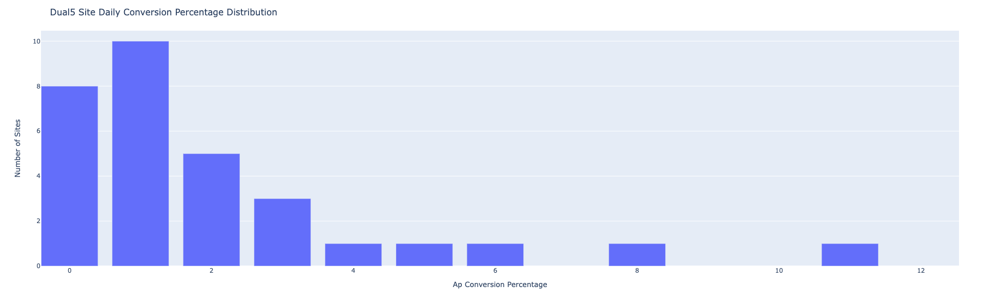

In [19]:
%%local 
fig = px.bar(df_converted_site,y="site_count",x="conversion_percentage")
fig.update_layout(height=600, width=700)
fig.update_layout(
    title="Dual5 Site Daily Conversion Percentage Distribution",
    xaxis_title="Ap Conversion Percentage",
    yaxis_title="Number of Sites"
)
fig.show()

In [5]:
df_conversion_sites = spark.read.parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_ap/").persist()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

An error was encountered:
name 'df' is not defined
Traceback (most recent call last):
NameError: name 'df' is not defined



In [32]:
dates = set()
sites = set()
for s in conversion_sites:
    dates.add(str(s["date"]-timedelta(days=1)))
    dates.add(str(s["date"]+timedelta(days=1)))
    dates.add(str(s["date"]))
    sites.add(s["site_id"])

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [5]:
## site utilization data for day
sites=['fdf1b743-a8cb-4227-a015-b3d587eb7caf', '61d36fa1-8159-4304-9573-ac31590f90ee', '6f530bcc-101c-4dfd-b770-491a6ff43c7c', \
           '58ba3e72-536e-48af-9db2-fe2a797f1834', '366fe977-00ed-4bf3-bc76-a894a47c1094', 'ca87df05-a4c4-432e-b551-266b805ceb0a', 'cc2bb0ab-dddd-4e72-bd0f-fd2f7ddb4f65', \
       'a1b5a9ea-6fda-4cb4-b8e1-b070cd7c09b6', '6ea4f104-97ac-4b94-979b-efa19b6b8a32', '6cf57059-af1c-4bac-a2cc-524144e3d5fc', 'ab07e1a3-e2dc-41c6-88b5-84ccf6104cb9', '20e1f48b-3c79-4cd5-bafb-342c8902e5ce', \
       'db8cfb98-8326-4649-9a93-d5ab760ae28f', '3ec4a548-22d3-41fa-9c74-3b557ce2fa8e', '6760c075-6e5f-49f0-8cd4-ca341f3887a9', 'd2720294-eb58-4214-b70c-bee9b8a2e018']
dates = ['2022-02-16', '2022-02-25', '2022-02-15', '2022-02-08', '2022-02-04', '2022-02-24', '2022-02-02', '2022-02-28', \
         '2022-02-07', '2022-02-17', '2022-02-03', '2022-03-10', '2022-02-23', '2022-03-09', '2022-03-04', '2022-02-26', '2022-03-05', '2022-02-27', \
         '2022-03-03', '2022-03-08', '2022-02-21', '2022-03-01', '2022-02-22', '2022-03-06', '2022-02-01', '2022-02-06']
for date in dates:
    try:
        df_ap_stats = spark.read.parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_site_utilization/date={}".format(date))
        df_ap_stats.show(1)
    except:
        df_ap_stats = spark.read.parquet("s3://mist-secorapp-production/ap-stats-analytics/ap-stats-analytics-production/dt={}/hr=*".format(date))\
                    .withColumn("radios",F.explode("radios"))\
                    .filter(F.col("site_id").isin(sites))\
                        .select("org_id","site_id","id","model","radios.band","radios.bandwidth","radios.utilization_all","radios.utilization_tx",\
                        "radios.utilization_rx_in_bss","radios.utilization_rx_other_bss","radios.utilization_unknown_wifi",\
                        "radios.utilization_non_wifi",F.to_timestamp(F.col("when")/1000000).alias("when"))
        df_ap_stats.write.mode("overwrite").parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_site_utilization/date={}".format(date))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

An error was encountered:
An error occurred while calling o338.parquet.
: org.apache.spark.SparkException: Job aborted.
	at org.apache.spark.sql.execution.datasources.FileFormatWriter$.write(FileFormatWriter.scala:231)
	at org.apache.spark.sql.execution.datasources.InsertIntoHadoopFsRelationCommand.run(InsertIntoHadoopFsRelationCommand.scala:195)
	at org.apache.spark.sql.execution.command.DataWritingCommandExec.sideEffectResult$lzycompute(commands.scala:108)
	at org.apache.spark.sql.execution.command.DataWritingCommandExec.sideEffectResult(commands.scala:106)
	at org.apache.spark.sql.execution.command.DataWritingCommandExec.doExecute(commands.scala:131)
	at org.apache.spark.sql.execution.SparkPlan.$anonfun$execute$1(SparkPlan.scala:194)
	at org.apache.spark.sql.execution.SparkPlan.$anonfun$executeQuery$1(SparkPlan.scala:232)
	at org.apache.spark.rdd.RDDOperationScope$.withScope(RDDOperationScope.scala:151)
	at org.apache.spark.sql.execution.SparkPlan.executeQuery(SparkPlan.scala:229)
	

In [13]:
df_ap_stats.withColumn("radios",F.explode("radios"))\
            .select("org_id","site_id","id","model","radios.band","radios.bandwidth","radios.utilization_all","radios.utilization_tx",\
                    "radios.utilization_rx_in_bss","radios.utilization_rx_other_bss","radios.utilization_unknown_wifi",\
                    "radios.utilization_non_wifi",F.to_timestamp(F.col("when")/1000000).alias("when")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+-----------------+-------+----+---------+--------------------+--------------------+---------------------+------------------------+------------------------+--------------------+--------------------+
|              org_id|             site_id|               id|  model|band|bandwidth|     utilization_all|      utilization_tx|utilization_rx_in_bss|utilization_rx_other_bss|utilization_unknown_wifi|utilization_non_wifi|                when|
+--------------------+--------------------+-----------------+-------+----+---------+--------------------+--------------------+---------------------+------------------------+------------------------+--------------------+--------------------+
|70642c2f-1c0d-4e6...|662b253f-d32d-446...|5c-5b-35-f1-e1-d8|AP12-US|   5|       20|0.059490837156772614| 0.03354084491729736| 0.001802167738787...|    0.004575452301651239|     0.01862896792590618| 9.43406019359827E-4|2022-03-09 23:59:...|
|70642c2f-1c0d-4e6...|662b253f-d32d-

In [ ]:
# conversion sites sle coverage, capacity and roaming sle
for date in dates:
    df_ap_stats = spark.read.parquet("s3://mist-secorapp-production/ap-stats-analytics/ap-stats-analytics-production/dt={}/hr=*".format(date))\
                .withColumn("radios",F.explode("radios"))\
                .filter(F.col("site_id").isin(sites))\
                    .select("org_id","site_id","id","model","radios.band","radios.bandwidth","radios.utilization_all","radios.utilization_tx",\
                    "radios.utilization_rx_in_bss","radios.utilization_rx_other_bss","radios.utilization_unknown_wifi",\
                    "radios.utilization_non_wifi",F.to_timestamp(F.col("when")/1000000).alias("when"))
    df_ap_stats.coalesce(16).write.mode("overwrite").parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_site_utilization/date={}".format(date))

In [ ]:
sites=['fdf1b743-a8cb-4227-a015-b3d587eb7caf', '61d36fa1-8159-4304-9573-ac31590f90ee', '6f530bcc-101c-4dfd-b770-491a6ff43c7c', \
           '58ba3e72-536e-48af-9db2-fe2a797f1834', '366fe977-00ed-4bf3-bc76-a894a47c1094', 'ca87df05-a4c4-432e-b551-266b805ceb0a', 'cc2bb0ab-dddd-4e72-bd0f-fd2f7ddb4f65', \
       'a1b5a9ea-6fda-4cb4-b8e1-b070cd7c09b6', '6ea4f104-97ac-4b94-979b-efa19b6b8a32', '6cf57059-af1c-4bac-a2cc-524144e3d5fc', 'ab07e1a3-e2dc-41c6-88b5-84ccf6104cb9', '20e1f48b-3c79-4cd5-bafb-342c8902e5ce', \
       'db8cfb98-8326-4649-9a93-d5ab760ae28f', '3ec4a548-22d3-41fa-9c74-3b557ce2fa8e', '6760c075-6e5f-49f0-8cd4-ca341f3887a9', 'd2720294-eb58-4214-b70c-bee9b8a2e018']
dates = ['2022-02-16', '2022-02-25', '2022-02-15', '2022-02-08', '2022-02-04', '2022-02-24', '2022-02-02', '2022-02-28', \
         '2022-02-07', '2022-02-17', '2022-02-03', '2022-03-10', '2022-02-23', '2022-03-09', '2022-03-04', '2022-02-26', '2022-03-05', '2022-02-27', \
         '2022-03-03', '2022-03-08', '2022-02-21', '2022-03-01', '2022-02-22', '2022-03-06', '2022-02-01', '2022-02-06']

for date in dates:
    try:
        df = spark.read.parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_site_sle/date={}".format(date))
        df.show(1)
    except:
        df_cov = spark.read.orc("s3://mist-secorapp-production/cv-sle-cov-multipartition/cv-sle-cov-multipartition-production/dt={}".format(date))\
                        .filter(F.col("site_id").isin(sites))\
                        .groupby("site_id","classifier","ap_mac","band").agg(F.count("site_id").alias("event_count")).persist()
        df_capacity = spark.read.orc("s3://mist-secorapp-production/cv-sle-cap-multipartition/cv-sle-cap-multipartition-production/dt={}".format(date))\
                        .filter(F.col("site_id").isin(sites))\
                        .groupby("site_id","classifier","ap_mac","band").agg(F.count("site_id").alias("event_count")).persist()

        input_files = "s3://mist-secorapp-production/cv-sle-roaming-multipartition-v2/cv-sle-roaming-multipartition-v2-production/dt={}/hr=*/*.seq".format(date)
        roam_rdd= spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1]))\
                        .filter(lambda x: x["site_id"] in sites)
        df_roaming = spark.createDataFrame(roam_rdd)\
                    .groupby("site_id","classifier","ap_mac","band").agg(F.count("site_id").alias("event_count")).persist()

        df_final = df_cov.union(df_capacity).union(df_roaming)

        df_final.coalesce(16).write.mode("overwrite").parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_site_sle/date={}".format(date))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [ ]:
# Utilization Comparision
df_util = spark.read.parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_site_utilization/")
df_util.withColumn("total_utilization", F.col("utilization_rx_in_bss") + F.col("utilization_rx_other_bss")+ F.col("util_non_wifi") + F.col("util_unknown_wifi"))\
        .groupby("site_id","band","date")


In [8]:
df_util = spark.read.parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_site_utilization/").persist()
df_util.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+-----------------+-------+----+---------+--------------------+--------------------+---------------------+------------------------+------------------------+--------------------+--------------------+----------+
|              org_id|             site_id|               id|  model|band|bandwidth|     utilization_all|      utilization_tx|utilization_rx_in_bss|utilization_rx_other_bss|utilization_unknown_wifi|utilization_non_wifi|                when|      date|
+--------------------+--------------------+-----------------+-------+----+---------+--------------------+--------------------+---------------------+------------------------+------------------------+--------------------+--------------------+----------+
|0992350f-e897-471...|fdf1b743-a8cb-422...|5c-5b-35-d3-4b-93|AP43-US|   5|       20|  0.0221843384206295|0.005774972029030323|                  0.0|    0.011169594712555408|    0.005238423123955727|1.350533239019569E-6|2022-03-09 14:03:...|2022

In [9]:
df_util.printSchema()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

root
 |-- org_id: string (nullable = true)
 |-- site_id: string (nullable = true)
 |-- id: string (nullable = true)
 |-- model: string (nullable = true)
 |-- band: string (nullable = true)
 |-- bandwidth: integer (nullable = true)
 |-- utilization_all: double (nullable = true)
 |-- utilization_tx: double (nullable = true)
 |-- utilization_rx_in_bss: double (nullable = true)
 |-- utilization_rx_other_bss: double (nullable = true)
 |-- utilization_unknown_wifi: double (nullable = true)
 |-- utilization_non_wifi: double (nullable = true)
 |-- when: timestamp (nullable = true)
 |-- date: date (nullable = true)

In [163]:

sites=["366fe977-00ed-4bf3-bc76-a894a47c1094","6760c075-6e5f-49f0-8cd4-ca341f3887a9","6cf57059-af1c-4bac-a2cc-524144e3d5fc","ab07e1a3-e2dc-41c6-88b5-84ccf6104cb9",\
       "ca87df05-a4c4-432e-b551-266b805ceb0a","d2720294-eb58-4214-b70c-bee9b8a2e018"]
       #'fdf1b743-a8cb-4227-a015-b3d587eb7caf', '6f530bcc-101c-4dfd-b770-491a6ff43c7c', \
       #    , 'ca87df05-a4c4-432e-b551-266b805ceb0a', 'cc2bb0ab-dddd-4e72-bd0f-fd2f7ddb4f65', \
       #'a1b5a9ea-6fda-4cb4-b8e1-b070cd7c09b6', '6ea4f104-97ac-4b94-979b-efa19b6b8a32', '6cf57059-af1c-4bac-a2cc-524144e3d5fc', 'ab07e1a3-e2dc-41c6-88b5-84ccf6104cb9', \
       #'db8cfb98-8326-4649-9a93-d5ab760ae28f', '6760c075-6e5f-49f0-8cd4-ca341f3887a9', 'd2720294-eb58-4214-b70c-bee9b8a2e018']

df_conversion_sites = df.groupby("org_name","site_name","site_id","date").agg(F.count("ap_id").alias("converted_ap_count"))\
                        .join(df_device_name.filter(F.col("site_id").isin(sites)),"site_id","inner")\
                        .filter((F.col("converted_ap_count")>3) & (F.col("ap_count")<1000))
df_conversion_sites.show()
def before_and_after(band,conversion_date,avg_util):
    before_date=conversion_date
    after_date=conversion_date+timedelta(days=1)
    after = 0
    before= 0
    for i in avg_util:
        if i["date"] == before_date:
            before= (1-i["avg_utilization"]) if band =="24" else (1-i["avg_utilization"])
        elif i["date"] == after_date:
            after = (1-i["avg_utilization"]) if band =="24" else (1-i["avg_utilization"])
    return [round(before,3),round(after,3)]

before_and_afterUDF = F.udf(before_and_after,ArrayType(FloatType()))

df_before_after = df_util.filter(F.col("bandwidth")>0).withColumn("total_utilization", F.col("congest_nonwifi"))\
        .groupby("site_id","band","date").agg(F.mean("total_utilization").alias("avg_utilization"))\
        .groupby("site_id","band").agg(F.collect_list(F.struct("date","avg_utilization")).alias("avg_util"))\
        .join(df_conversion_sites,["site_id"],"inner")\
        .withColumn("capacity",before_and_afterUDF("band","date","avg_util"))\
        .select("org_name","site_name","site_id","band",F.col("capacity")[0].alias("before"),F.col("capacity")[1].alias("after"),"date","converted_ap_count","ap_count")\
        .filter((F.col("before").isNotNull()) & (F.col("after").isNotNull()) & (F.col("band").isin("24","5")))

df_before_after.sort("site_id","date").show(100,truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+--------------------+----------+------------------+--------------------+--------+
|             site_id|            org_name|           site_name|      date|converted_ap_count|              org_id|ap_count|
+--------------------+--------------------+--------------------+----------+------------------+--------------------+--------+
|6cf57059-af1c-4ba...|Tyler Junior College|Tyler Junior Coll...|2022-02-01|                 7|c6ea753e-ef55-4ba...|     497|
|6cf57059-af1c-4ba...|Tyler Junior College|Tyler Junior Coll...|2022-02-02|                11|c6ea753e-ef55-4ba...|     497|
|6cf57059-af1c-4ba...|Tyler Junior College|Tyler Junior Coll...|2022-02-03|                 7|c6ea753e-ef55-4ba...|     497|
|6cf57059-af1c-4ba...|Tyler Junior College|Tyler Junior Coll...|2022-02-09|                 4|c6ea753e-ef55-4ba...|     497|
|ab07e1a3-e2dc-41c...|  Sentara Healthcare|IND-Sentara Indep...|2022-02-03|                 8|a046fd41-91c1-473...|     147|


In [164]:
%%spark -o df_before_after

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

<ipython-input-165-d32db30b26a4>:2: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



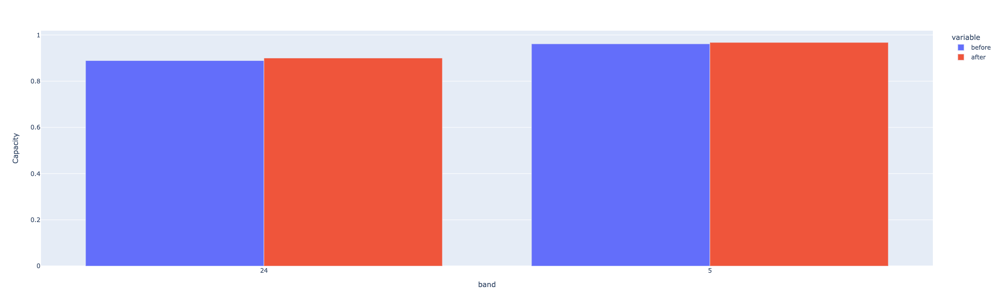

In [165]:
%%local

df_before_after["band"] = df_before_after["band"].apply(str)
fig = px.bar(df_before_after.groupby("band")["before","after"].mean().reset_index(),y=["before","after"],x="band",barmode="group")
fig.update_layout(height=600, width=800)
fig.update_layout(
    yaxis_title="Capacity",
)
fig.show()

In [6]:
sites=['fdf1b743-a8cb-4227-a015-b3d587eb7caf', '61d36fa1-8159-4304-9573-ac31590f90ee', '6f530bcc-101c-4dfd-b770-491a6ff43c7c', \
           '58ba3e72-536e-48af-9db2-fe2a797f1834', '366fe977-00ed-4bf3-bc76-a894a47c1094', 'ca87df05-a4c4-432e-b551-266b805ceb0a', 'cc2bb0ab-dddd-4e72-bd0f-fd2f7ddb4f65', \
       'a1b5a9ea-6fda-4cb4-b8e1-b070cd7c09b6', '6ea4f104-97ac-4b94-979b-efa19b6b8a32', '6cf57059-af1c-4bac-a2cc-524144e3d5fc', 'ab07e1a3-e2dc-41c6-88b5-84ccf6104cb9', '20e1f48b-3c79-4cd5-bafb-342c8902e5ce', \
       'db8cfb98-8326-4649-9a93-d5ab760ae28f', '3ec4a548-22d3-41fa-9c74-3b557ce2fa8e', '6760c075-6e5f-49f0-8cd4-ca341f3887a9', 'd2720294-eb58-4214-b70c-bee9b8a2e018']
dates = ['2022-02-16', '2022-02-25', '2022-02-15', '2022-02-08', '2022-02-04', '2022-02-24', '2022-02-02', '2022-02-28', \
         '2022-02-07', '2022-02-17', '2022-02-03', '2022-03-10', '2022-02-23', '2022-03-09', '2022-03-04', '2022-02-26', '2022-03-05', '2022-02-27', \
         '2022-03-03', '2022-03-08', '2022-02-21', '2022-03-01', '2022-02-22', '2022-03-06', '2022-02-01', '2022-02-06']


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [11]:
df_sle.unpersist()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

DataFrame[site_id: string, classifier: string, ap_mac: string, band: string, event_count: bigint, date: date]

In [18]:
schema = StructType([
    StructField("site_id", StringType(), True),
    StructField("ap_mac", StringType(), True),
    StructField("classifier", StringType(), True),
    StructField("band", StringType(), True),
    StructField("sle", StringType(), True),
    StructField("event_count", LongType(), True),
     ])


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [22]:
# sle
df_sle = spark.read.schema(schema).parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_site_sle/")\
            .filter(F.col("sle").isNotNull()).persist()
df_sle.show()


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+-----------------+--------------------+----+-----------+-----------+----------+
|             site_id|           ap_mac|          classifier|band|        sle|event_count|      date|
+--------------------+-----------------+--------------------+----+-----------+-----------+----------+
|fdf1b743-a8cb-422...|5c-5b-35-d3-4b-20|                    |   5|  good_roam|       3463|2022-02-28|
|ab07e1a3-e2dc-41c...|d4-20-b0-c0-a6-a4|                    |   5|  good_roam|        259|2022-02-28|
|6cf57059-af1c-4ba...|d4-dc-09-29-30-30|                    |  24|  good_roam|        989|2022-02-28|
|6f530bcc-101c-4df...|d4-dc-09-2b-28-a4|                    |  24|  good_roam|         16|2022-02-28|
|ca87df05-a4c4-432...|d4-20-b0-44-c0-ae|   latency-slow-roam|   5|roaming_sle|         12|2022-02-28|
|fdf1b743-a8cb-422...|5c-5b-35-d3-3e-19|signal-suboptimal...|   5|roaming_sle|          6|2022-02-28|
|fdf1b743-a8cb-422...|5c-5b-35-d3-4a-17|                    |   5|  good_roam|    

In [26]:
def sle_rate(sle_count):
    total_cov  = 1
    total_cap = 1
    total_roam = 1
    good_cap = 1
    good_cov = 1
    good_roam =1
    for i in sle_count:
        if i["sle"] == "good_roam":
            good_roam += i["event_count"]
            total_roam +=i["event_count"]
        elif i["sle"] == "roaming_sle":
            total_roam +=i["event_count"]
            
        if i["sle"] == "good_cov":
            good_cov += i["event_count"]
            total_cov +=i["event_count"]
        elif i["sle"] == "coverage_sle":
            total_cov +=i["event_count"]
            
        if i["sle"] == "good_cap":
            good_cap += i["event_count"]
            total_cap +=i["event_count"]
        elif i["sle"] == "capacity_sle":
            total_cap +=i["event_count"]
    return [round(good_cap/total_cap,2),round(good_cov/total_cov,2),round(good_roam/total_roam,2)]

        
sle_rateUDF = F.udf(sle_rate,ArrayType(FloatType()))
    
df_sle.groupby("site_id","band","sle","date").agg(F.sum("event_count").alias("event_count"))\
        .groupby('site_id',"band","date").agg(F.collect_list(F.struct("sle","event_count")).alias("sle_event_count"))\
        .withColumn("sle_rate",sle_rateUDF("sle_event_count")).select("site_id","band","date",F.col("sle_rate")[0].alias("capacity_sle"),\
                                                                      F.col("sle_rate")[1].alias("coverage_sle"),\
                                                                     F.col("sle_rate")[2].alias("roaming_sle")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+----+----------+------------+------------+-----------+
|             site_id|band|      date|capacity_sle|coverage_sle|roaming_sle|
+--------------------+----+----------+------------+------------+-----------+
|d2720294-eb58-421...|   5|2022-03-10|         1.0|         1.0|        1.0|
|61d36fa1-8159-430...|   5|2022-02-15|         1.0|        0.87|        0.9|
|cc2bb0ab-dddd-4e7...|  24|2022-02-15|        0.96|        0.98|       0.96|
|366fe977-00ed-4bf...|   5|2022-03-10|         1.0|        0.98|       0.93|
|366fe977-00ed-4bf...|  24|2022-02-16|         1.0|        0.95|       0.98|
|6cf57059-af1c-4ba...|   5|2022-02-02|        0.99|        0.88|       0.95|
|6f530bcc-101c-4df...|   5|2022-02-24|         1.0|        0.75|        1.0|
|6760c075-6e5f-49f...|  24|2022-02-07|        0.76|        0.84|       0.96|
|db8cfb98-8326-464...|  24|2022-03-04|         1.0|        0.25|       0.96|
|61d36fa1-8159-430...|  24|2022-02-24|        0.99|         1.0|        1.0|

In [52]:

sites=['fdf1b743-a8cb-4227-a015-b3d587eb7caf', '61d36fa1-8159-4304-9573-ac31590f90ee', '6f530bcc-101c-4dfd-b770-491a6ff43c7c', \
           '58ba3e72-536e-48af-9db2-fe2a797f1834', '366fe977-00ed-4bf3-bc76-a894a47c1094', 'ca87df05-a4c4-432e-b551-266b805ceb0a', 'cc2bb0ab-dddd-4e72-bd0f-fd2f7ddb4f65', \
       'a1b5a9ea-6fda-4cb4-b8e1-b070cd7c09b6', '6ea4f104-97ac-4b94-979b-efa19b6b8a32', '6cf57059-af1c-4bac-a2cc-524144e3d5fc', 'ab07e1a3-e2dc-41c6-88b5-84ccf6104cb9', '20e1f48b-3c79-4cd5-bafb-342c8902e5ce', \
       'db8cfb98-8326-4649-9a93-d5ab760ae28f', '3ec4a548-22d3-41fa-9c74-3b557ce2fa8e', '6760c075-6e5f-49f0-8cd4-ca341f3887a9', 'd2720294-eb58-4214-b70c-bee9b8a2e018']
dates = ['2022-02-16', '2022-02-25', '2022-02-15', '2022-02-08', '2022-02-04', '2022-02-24', '2022-02-02', '2022-02-28', \
         '2022-02-07', '2022-02-17', '2022-02-03', '2022-03-10', '2022-02-23', '2022-03-09', '2022-03-04', '2022-02-26', '2022-03-05', '2022-02-27', \
         '2022-03-03', '2022-03-08', '2022-02-21', '2022-03-01', '2022-02-22', '2022-03-06', '2022-02-01', '2022-02-06']


df_filter_sites =df_conversion_sites.groupby("org_name","site_name","site_id","date").agg(F.count("ap_id").alias("converted_ap_count"))\
                        .join(df_device_name.filter(F.col("site_id").isin(sites)),"site_id","inner")\
                        .filter((F.col("converted_ap_count")>3) & (F.col("ap_count")<1000))
df_filter_sites.show()
def before_and_after(band,conversion_date,sle,sle_name):
    before_date=conversion_date-timedelta(days=1)
    after_date=conversion_date
    after = 1.0
    before= 1.0
    for i in sle:
        if i["date"] == before_date:
            before= i[sle_name]
        elif i["date"] == after_date:
            after = i[sle_name]
    return [round(before,3),round(after,3)]

before_and_afterUDF = F.udf(before_and_after,ArrayType(FloatType()))

df_before_after = df_sle.groupby("site_id","band","sle","date").agg(F.sum("event_count").alias("event_count"))\
        .groupby('site_id',"band","date").agg(F.collect_list(F.struct("sle","event_count")).alias("sle_event_count"))\
        .withColumn("sle_rate",sle_rateUDF("sle_event_count")).select("site_id","band","date",F.col("sle_rate")[0].alias("capacity_sle"),\
                                                                      F.col("sle_rate")[1].alias("coverage_sle"),\
                                                                     F.col("sle_rate")[2].alias("roaming_sle"))\
        .groupby("site_id","band").agg(F.collect_set(F.struct("date","coverage_sle")).alias("coverage_sle"),\
                                       F.collect_set(F.struct("date","capacity_sle")).alias("capacity_sle"),\
                                       F.collect_set(F.struct("date","roaming_sle")).alias("roaming_sle"))\
        .join(df_filter_sites,["site_id"],"inner")\
        .withColumn("coverage",before_and_afterUDF("band","date","coverage_sle",F.lit("coverage_sle")))\
        .withColumn("capacity",before_and_afterUDF("band","date","capacity_sle",F.lit("capacity_sle")))\
        .withColumn("roaming",before_and_afterUDF("band","date","roaming_sle",F.lit("roaming_sle")))\
        .select("org_name","site_name","site_id","band",F.col("capacity")[0].alias("cap_before"),F.col("capacity")[1].alias("cap_after"),\
                F.col("coverage")[0].alias("cov_before"),F.col("coverage")[1].alias("cov_after"),\
                F.col("roaming")[0].alias("roaming_before"),F.col("roaming")[1].alias("roaming_after"),"date","converted_ap_count","ap_count")\
        .filter((F.col("band").isin("24","5")))

df_before_after.sort("site_id","date").show(100,truncate=False)


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+--------------------+----------+------------------+--------------------+--------+
|             site_id|            org_name|           site_name|      date|converted_ap_count|              org_id|ap_count|
+--------------------+--------------------+--------------------+----------+------------------+--------------------+--------+
|3ec4a548-22d3-41f...|Corning Incorporated|                SHHQ|2022-02-28|                11|1bc7fc2d-2def-488...|      60|
|6f530bcc-101c-4df...|ConocoPhillips - L48|       Kermit Office|2022-02-27|                10|8c599e0e-372d-4f9...|      34|
|6cf57059-af1c-4ba...|Tyler Junior College|Tyler Junior Coll...|2022-02-01|                 7|c6ea753e-ef55-4ba...|     497|
|6cf57059-af1c-4ba...|Tyler Junior College|Tyler Junior Coll...|2022-02-02|                11|c6ea753e-ef55-4ba...|     497|
|6cf57059-af1c-4ba...|Tyler Junior College|Tyler Junior Coll...|2022-02-03|                 7|c6ea753e-ef55-4ba...|     497|


In [37]:
df_before_after.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

38

In [53]:
%%spark -o df_before_after

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

<ipython-input-56-8cc74ce57f22>:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



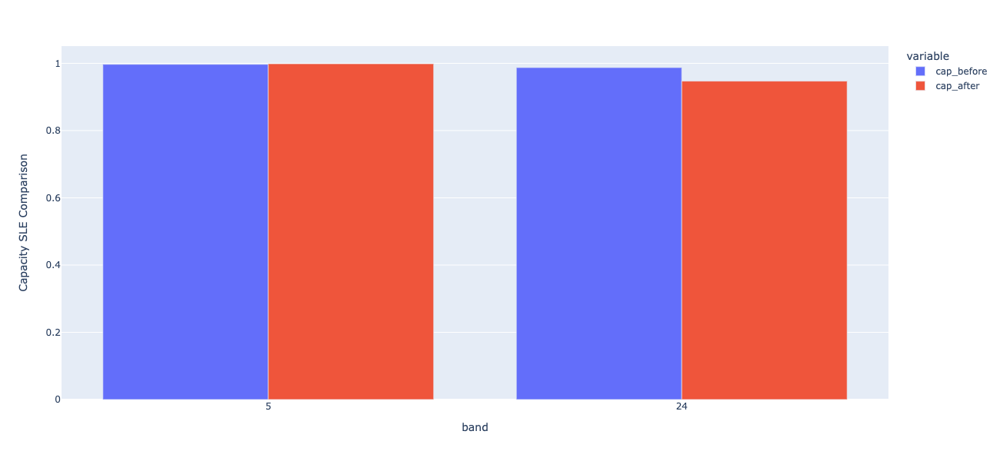

<ipython-input-56-8cc74ce57f22>:8: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



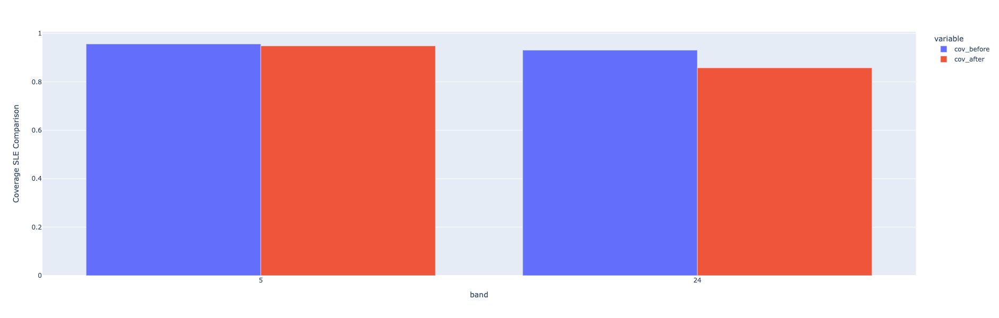

<ipython-input-56-8cc74ce57f22>:16: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



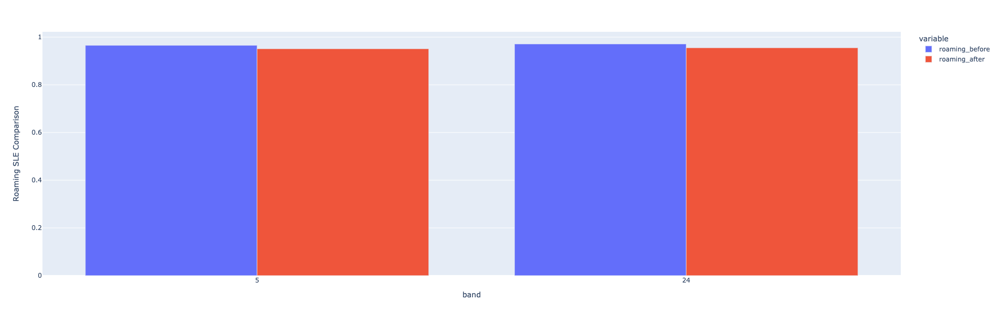

In [56]:
%local
fig = px.bar(df_before_after.groupby(["band"])["cap_before","cap_after"].mean().reset_index(),x="band",y=["cap_before","cap_after"],barmode="group")
fig.update_layout(height=600, width=700)
fig.update_layout(
    yaxis_title="Capacity SLE Comparison",
)
fig.show()

fig = px.bar(df_before_after.groupby(["band"])["cov_before","cov_after"].mean().reset_index(),x="band",y=["cov_before","cov_after"],barmode="group")
fig.update_layout(height=600, width=700)
fig.update_layout(
    yaxis_title="Coverage SLE Comparison",
)
fig.show()


fig = px.bar(df_before_after.groupby(["band"])["roaming_before","roaming_after"].mean().reset_index(),x="band",y=["roaming_before","roaming_after"],barmode="group")
fig.update_layout(height=600, width=700)
fig.update_layout(
    yaxis_title="Roaming SLE Comparison",
)
fig.show()

## Conversion on 03/09

In [ ]:
dates = ["2022-03-08","2022-03-09","2022-03-10"]
for date in dates:
    df_ap_stats = spark.read.parquet("s3://mist-secorapp-production/ap-stats-analytics/ap-stats-analytics-production/dt={}/hr=*".format(date))\
                .withColumn("radios",F.explode("radios"))\
                .select("org_id","site_id","id","model","radios.band","radios.bandwidth",\
                    F.col("radios.congest.non_wifi"(),"radios.congest."
                    "radios.utilization_all","radios.utilization_tx",\
                    "radios.utilization_rx_in_bss","radios.utilization_rx_other_bss","radios.utilization_unknown_wifi",\
                    "radios.utilization_non_wifi",F.to_timestamp(F.col("when")/1000000).alias("when"))


sites=['fdf1b743-a8cb-4227-a015-b3d587eb7caf', '61d36fa1-8159-4304-9573-ac31590f90ee', '6f530bcc-101c-4dfd-b770-491a6ff43c7c', \
           '58ba3e72-536e-48af-9db2-fe2a797f1834', '366fe977-00ed-4bf3-bc76-a894a47c1094', 'ca87df05-a4c4-432e-b551-266b805ceb0a', 'cc2bb0ab-dddd-4e72-bd0f-fd2f7ddb4f65', \
       'a1b5a9ea-6fda-4cb4-b8e1-b070cd7c09b6', '6ea4f104-97ac-4b94-979b-efa19b6b8a32', '6cf57059-af1c-4bac-a2cc-524144e3d5fc', 'ab07e1a3-e2dc-41c6-88b5-84ccf6104cb9', '20e1f48b-3c79-4cd5-bafb-342c8902e5ce', \
       'db8cfb98-8326-4649-9a93-d5ab760ae28f', '3ec4a548-22d3-41fa-9c74-3b557ce2fa8e', '6760c075-6e5f-49f0-8cd4-ca341f3887a9', 'd2720294-eb58-4214-b70c-bee9b8a2e018']
dates = ['2022-02-16', '2022-02-25', '2022-02-15', '2022-02-08', '2022-02-04', '2022-02-24', '2022-02-02', '2022-02-28', \
         '2022-02-07', '2022-02-17', '2022-02-03', '2022-03-10', '2022-02-23', '2022-03-09', '2022-03-04', '2022-02-26', '2022-03-05', '2022-02-27', \
         '2022-03-03', '2022-03-08', '2022-02-21', '2022-03-01', '2022-02-22', '2022-03-06', '2022-02-01', '2022-02-06']

for date in dates:
        df_cov = spark.read.orc("s3://mist-secorapp-production/cv-sle-cov-multipartition/cv-sle-cov-multipartition-production/dt={}".format(date))\
                        .filter(F.col("site_id").isin(sites))\
                            .withColumn("sle",F.when(F.col("classifier")=="","good_cov").otherwise(F.lit("coverage_sle")))\
                        .groupby("site_id","classifier","ap_mac","band","sle").agg(F.count("site_id").alias("event_count"))\
                        .persist()
        df_capacity = spark.read.orc("s3://mist-secorapp-production/cv-sle-cap-multipartition/cv-sle-cap-multipartition-production/dt={}".format(date))\
                        .filter(F.col("site_id").isin(sites))\
                        .withColumn("sle",F.when(F.col("classifier")=="","good_cap").otherwise(F.lit("capacity_sle")))\
                        .groupby("site_id","classifier","ap_mac","band","sle").agg(F.count("site_id").alias("event_count"))\
                        .persist()

        input_files = "s3://mist-secorapp-production/cv-sle-roaming-multipartition-v2/cv-sle-roaming-multipartition-v2-production/dt={}/hr=*/*.seq".format(date)
        roam_rdd= spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1]))\
                        .filter(lambda x: x["site_id"] in sites)
        df_roaming = spark.createDataFrame(roam_rdd)\
                    .withColumn("sle",F.when(F.col("classifier")=="","good_roam").otherwise(F.lit("roaming_sle")))\
                    .groupby("site_id","classifier","ap_mac","band","sle").agg(F.count("site_id").alias("event_count"))\
                    .persist()

        df_final = df_cov.union(df_capacity).union(df_roaming)

        df_final.coalesce(16).write.mode("overwrite").parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_site_sle_03_09/date={}".format(date))
### Mesh ID

In [ ]:
site_id = "ab07e1a3-e2dc-41c6-88b5-84ccf6104cb9"
convresion_hr = 7
conversion_date = datetime.strptime("2022-03-09", "%Y-%m-%d")+timedelta(hours=convresion_hr)
dates = set()
dates.add(conversion_date.date())
dates.add((conversion_date-timedelta(hours=24)).date())
dates.add((conversion_date+timedelta(hours=24)).date())
for date in dates:
    df_ap_stats = spark.read.parquet("s3://mist-secorapp-production/ap-stats-analytics/ap-stats-analytics-production/dt={}/hr=*".format(date))\
                .filter(F.col("site_id")==site_id)\
                .withColumn("radios",F.explode("radios"))\
                .filter(F.col("radios.bandwidth")>0)\
                .select("org_id","site_id","id","model","radios.band","radios.bandwidth",\
                    "radios.utilization_all","radios.utilization_tx",\
                    "radios.utilization_rx_in_bss","radios.utilization_rx_other_bss","radios.utilization_unknown_wifi",\
                    "radios.utilization_non_wifi",F.to_timestamp(F.col("when")/1000000).alias("when"))\
    .withColumn("before_conversion",F.col("when") < str(conversion_date))
    df_ap_stats.write.mode("append").parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_site_utilization_sentara_healthcare/")


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

## Morianie Valley Dual5 Conversion

In [96]:
df_conversion_stats.unpersist()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

DataFrame[org_id: string, site_id: string, id: string, model: string, band: string, bandwidth: int, utilization_all: double, utilization_tx: double, utilization_rx_in_bss: double, utilization_rx_other_bss: double, utilization_unknown_wifi: double, utilization_non_wifi: double, when: timestamp, before_conversion: boolean]

In [4]:
df_conversion_stats = spark.read.parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_site_utilization_moraine_valley_03_09").persist()
# 93da770b-a9a0-496b-a495-f76054f7d547
#df_conversion_stats = spark.read.parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_site_utilization_sentara_healthcare/").persist()
df_conversion_stats.show(3)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+-----------------+-------+----+---------+-------+--------------------+--------------------+---------------------+------------------------+------------------------+--------------------+--------------------+-----------------+
|              org_id|             site_id|               id|  model|band|bandwidth|channel|     utilization_all|      utilization_tx|utilization_rx_in_bss|utilization_rx_other_bss|utilization_unknown_wifi|utilization_non_wifi|                when|before_conversion|
+--------------------+--------------------+-----------------+-------+----+---------+-------+--------------------+--------------------+---------------------+------------------------+------------------------+--------------------+--------------------+-----------------+
|72351385-5211-42b...|93da770b-a9a0-496...|ac-23-16-84-86-61|AP43-US|   5|       40|     60| 0.45588693022727966| 0.02439642883837223| 8.344904199475423E-5|      0.3231414258480072|     0.10685082525

In [21]:
df_conversion_stats.groupby("before_conversion","band").agg(F.countDistinct("id")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+-----------------+----+---------+
|before_conversion|band|count(id)|
+-----------------+----+---------+
|            false|  24|      104|
|             true|  24|      108|
|            false|   5|      147|
|             true|   5|      147|
+-----------------+----+---------+

In [5]:
date = "2022-03-09"
hr = "09"
df_ap_stats = spark.read.parquet("s3://mist-secorapp-production/ap-stats-analytics/ap-stats-analytics-production/dt={}/hr={}".format(date,hr))\
                .withColumn("radios",F.explode("radios"))\
                .filter(F.col("radios.bandwidth")>0)\
                .select("org_id","site_id","id","model","radios.band","radios.bandwidth","radios.channel",\
                    "radios.utilization_all","radios.utilization_tx",\
                    "radios.utilization_rx_in_bss","radios.utilization_rx_other_bss","radios.utilization_unknown_wifi",\
                    "radios.utilization_non_wifi",F.to_timestamp(F.col("when")/1000000).alias("when"))
df_ap_stats.filter(F.col("id")=="ac-23-16-84-90-e8").show()
  

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+-----------------+-------+----+---------+-------+--------------------+--------------------+---------------------+------------------------+------------------------+--------------------+--------------------+
|              org_id|             site_id|               id|  model|band|bandwidth|channel|     utilization_all|      utilization_tx|utilization_rx_in_bss|utilization_rx_other_bss|utilization_unknown_wifi|utilization_non_wifi|                when|
+--------------------+--------------------+-----------------+-------+----+---------+-------+--------------------+--------------------+---------------------+------------------------+------------------------+--------------------+--------------------+
|72351385-5211-42b...|93da770b-a9a0-496...|ac-23-16-84-90-e8|AP43-US|   5|       40|     60|0.024862101301550865| 0.00839906930923462|                  0.0|     0.01326525118201971|    0.003167698159813881|3.008514613611623...|2022-03-09 09:07:...|
|723

In [104]:
df_conversion_stats\
                    .withColumn("utilization_rx_in_bss", F.when(F.col("utilization_rx_in_bss")>1,0).otherwise(F.col('utilization_rx_in_bss')))\
                    .withColumn("utilization_unknown_wifi", F.when(F.col("utilization_unknown_wifi")>1,0).otherwise(F.col('utilization_unknown_wifi')))\
                    .withColumn("utilization_non_wifi", F.when(F.col("utilization_non_wifi")>1,0).otherwise(F.col('utilization_non_wifi')))\
                    .groupby("site_id","band","before_conversion","id").agg(
                                                                        F.max("bandwidth").alias("max_bandwidth").
                                                                        F.max("utilization_all").alias("max_util_all"),\
                                                                        F.max("utilization_rx_in_bss").alias("max_util_rx_in_bss"),\
                                                                        F.max("utilization_rx_other_bss").alias("max_util_rx_other_bss"),\
                                                                     F.max("utilization_unknown_wifi").alias("max_util_unknown_wifi"),\
                                                                     F.max("utilization_non_wifi").alias("max_util_non_wifi")).sort("id","band",F.desc("before_conversion")).show(100)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+----+-----------------+-----------------+-------------------+--------------------+---------------------+--------------------+
|             site_id|band|before_conversion|               id|       max_util_all|  max_util_rx_in_bss|max_util_unknown_wifi|   max_util_non_wifi|
+--------------------+----+-----------------+-----------------+-------------------+--------------------+---------------------+--------------------+
|93da770b-a9a0-496...|  24|            false|ac-23-16-84-83-55|  0.743593156337738|0.021328184753656387|  0.24380667507648468|  0.2563496232032776|
|93da770b-a9a0-496...|   5|            false|ac-23-16-84-83-55|0.16059304773807526|0.001802253187634...|  0.08137445896863937|0.002623757347464...|
|93da770b-a9a0-496...|  24|             true|ac-23-16-84-86-61|  0.446597158908844|0.009305093437433243|  0.12565509974956512| 0.10880032181739807|
|93da770b-a9a0-496...|  24|            false|ac-23-16-84-86-61|0.21096424758434296|0.009467992931604385|   0.028

In [5]:
df_conversion_stats\
                    .withColumn("utilization_rx_other_bss", F.when(F.col("utilization_rx_other_bss")>=1,0).otherwise(F.col('utilization_rx_other_bss')))\
                    .withColumn("utilization_unknown_wifi", F.when(F.col("utilization_unknown_wifi")>=1,0).otherwise(F.col('utilization_unknown_wifi')))\
                    .withColumn("utilization_non_wifi", F.when(F.col("utilization_non_wifi")>=1,0).otherwise(F.col('utilization_non_wifi')))\
                    .groupby("site_id","band","before_conversion","id").agg(F.max("bandwidth").alias("max_bandwidth"),\
                                                                        F.max("utilization_all").alias("max_util_all"),\
                                                                        F.max("utilization_rx_other_bss").alias("max_util_rx_other_bss"),\
                                                                     F.max("utilization_unknown_wifi").alias("max_util_unknown_wifi"),\
                                                                     F.max("utilization_non_wifi").alias("max_util_non_wifi"))\
                    .groupby("site_id","band","before_conversion").agg(F.mean("max_bandwidth").alias("avg_site_bandwidth"),\
                                                                    F.mean("max_util_all").alias("avg_util_all"),\
                                                                        F.mean("max_util_rx_other_bss").alias("avg_util_rx_other_bss"),\
                                                                     F.mean("max_util_unknown_wifi").alias("avg_util_unknown_wifi"),\
                                                                     F.mean("max_util_non_wifi").alias("avg_util_non_wifi"))\
                    .withColumn("avg_util",F.col("avg_util_rx_other_bss")+ F.col("avg_util_non_wifi")+F.col("avg_util_non_wifi"))\
                    .sort("band",F.desc("before_conversion")).show()


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+----+-----------------+------------------+-------------------+---------------------+---------------------+--------------------+-------------------+
|             site_id|band|before_conversion|avg_site_bandwidth|       avg_util_all|avg_util_rx_other_bss|avg_util_unknown_wifi|   avg_util_non_wifi|           avg_util|
+--------------------+----+-----------------+------------------+-------------------+---------------------+---------------------+--------------------+-------------------+
|93da770b-a9a0-496...|  24|             true|              20.0| 0.6032328239601591|   0.3935505338013172|  0.18051505157643039| 0.17846290127414724| 0.7504763363496116|
|93da770b-a9a0-496...|  24|            false|              20.0| 0.4423828661619198|  0.24197559400151172|   0.1200629423727237| 0.15443440145879453| 0.5508443969191008|
|93da770b-a9a0-496...|   5|             true|              40.0|0.24297554556118406|  0.12669512412875242|  0.07293950634725067|0.031090122799429555|0

In [7]:
df_conversion_stats\
                    .withColumn("utilization_rx_other_bss", F.when(F.col("utilization_rx_other_bss")>=1,0).otherwise(F.col('utilization_rx_in_bss')))\
                    .withColumn("utilization_unknown_wifi", F.when(F.col("utilization_unknown_wifi")>=1,0).otherwise(F.col('utilization_unknown_wifi')))\
                    .withColumn("utilization_non_wifi", F.when(F.col("utilization_non_wifi")>=1,0).otherwise(F.col('utilization_non_wifi')))\
                    .groupby("site_id","band","before_conversion","id").agg(F.max("bandwidth").alias("max_bandwidth"),\
                                                                        F.max("utilization_all").alias("mean_util_all"),\
                                                                        F.max("utilization_rx_other_bss").alias("mean_util_rx_other_bss"),\
                                                                     F.max("utilization_unknown_wifi").alias("mean_util_unknown_wifi"),\
                                                                     F.max("utilization_non_wifi").alias("mean_util_non_wifi"))\
                    .withColumn("mean_bandwidth_per_ap",F.col("max_bandwidth")*(1-F.col("mean_util_rx_other_bss")+ F.col("mean_util_non_wifi")+F.col("mean_util_non_wifi")))\
                    .sort("id","band",F.desc("before_conversion")).show(100)
                    
  

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+----+-----------------+-----------------+-------------+--------------------+----------------------+----------------------+--------------------+---------------------+
|             site_id|band|before_conversion|               id|max_bandwidth|       mean_util_all|mean_util_rx_other_bss|mean_util_unknown_wifi|  mean_util_non_wifi|mean_bandwidth_per_ap|
+--------------------+----+-----------------+-----------------+-------------+--------------------+----------------------+----------------------+--------------------+---------------------+
|93da770b-a9a0-496...|  24|             true|ac-23-16-84-83-55|           20| 0.21738665665184637|  1.277932530575002...|  0.037389011600408646| 0.04584397818478275|   21.833503540885197|
|93da770b-a9a0-496...|  24|            false|ac-23-16-84-83-55|           20| 0.13803585320520584|  1.154173733262794...|   0.02753823715756756| 0.04126257951383678|    21.65027234580682|
|93da770b-a9a0-496...|   5|             true|ac-23-16-84-83-

In [8]:
# Total Site available Bandwidth 
df_conversion_stats\
                    .withColumn("utilization_rx_other_bss", F.when(F.col("utilization_rx_other_bss")>=1,0).otherwise(F.col('utilization_rx_in_bss')))\
                    .withColumn("utilization_unknown_wifi", F.when(F.col("utilization_unknown_wifi")>=1,0).otherwise(F.col('utilization_unknown_wifi')))\
                    .withColumn("utilization_non_wifi", F.when(F.col("utilization_non_wifi")>=1,0).otherwise(F.col('utilization_non_wifi')))\
                    .groupby("site_id","band","before_conversion","id").agg(F.max("bandwidth").alias("max_bandwidth"),\
                                                                        F.max("utilization_all").alias("mean_util_all"),\
                                                                        F.max("utilization_rx_other_bss").alias("mean_util_rx_other_bss"),\
                                                                     F.max("utilization_unknown_wifi").alias("mean_util_unknown_wifi"),\
                                                                     F.max("utilization_non_wifi").alias("mean_util_non_wifi"))\
                    .withColumn("mean_bandwidth_per_ap",F.col("max_bandwidth")*(1-F.col("mean_util_rx_other_bss")+ F.col("mean_util_non_wifi")+F.col("mean_util_non_wifi")))\
                    .groupby("site_id","band","before_conversion").agg(F.sum("mean_bandwidth_per_ap"))\
                    .sort("band",F.desc("before_conversion")).show()
                    
                    

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+----+-----------------+--------------------------+
|             site_id|band|before_conversion|sum(mean_bandwidth_per_ap)|
+--------------------+----+-----------------+--------------------------+
|93da770b-a9a0-496...|  24|             true|        1230.8383663499262|
|93da770b-a9a0-496...|  24|            false|        1082.6194903478608|
|93da770b-a9a0-496...|   5|             true|         1917.296844641678|
|93da770b-a9a0-496...|   5|            false|        1840.6421277322806|
+--------------------+----+-----------------+--------------------------+

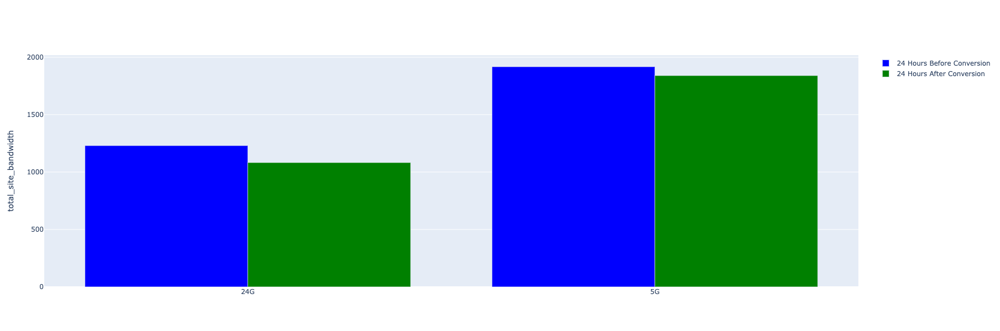

In [9]:
%%local
#ap_available_bandwidth, which is bw * (0.90 - util_interference) and bw=20 or 40.

ybefore=[1230,1917]
yafter=[1082,1840]
x=["24G","5G"]


fig = go.Figure()
fig.add_trace(go.Bar(y=ybefore,x=x,name = "24 Hours Before Conversion",marker=dict(color = "blue")))
fig.add_trace(go.Bar(y=yafter,x=x,name = "24 Hours After Conversion",marker=dict(color = "green")))
#fig.add_bar(y=yafter,x=x,name="24 Hours After Conversion")
fig.update_layout(height=600, width=800)
fig.update_layout(
    yaxis_title="total_site_bandwidth",
)
fig.show()



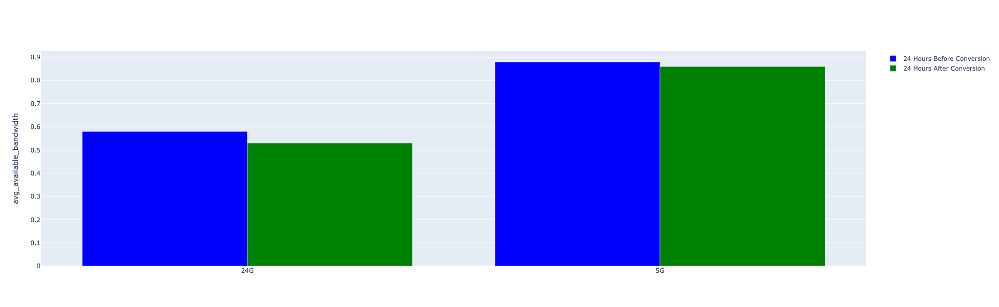

In [24]:
%%local
# +--------------------+----+-----------------+------------------+-------------------+---------------------+---------------------+--------------------+-------------------+
# |             site_id|band|before_conversion|avg_site_bandwidth|       avg_util_all|avg_util_rx_other_bss|avg_util_unknown_wifi|   avg_util_non_wifi|           avg_util|
# +--------------------+----+-----------------+------------------+-------------------+---------------------+---------------------+--------------------+-------------------+
# |93da770b-a9a0-496...|  24|             true|              20.0| 0.6032328239601591|   0.3935505338013172|  0.18051505157643039| 0.17846290127414724| 0.7504763363496116|
# |93da770b-a9a0-496...|  24|            false|              20.0| 0.4423828661619198|  0.24197559400151172|   0.1200629423727237| 0.15443440145879453| 0.5508443969191008|
# |93da770b-a9a0-496...|   5|             true|              40.0|0.24297554556118406|  0.12669512412875242|  0.07293950634725067|0.031090122799429555|0.18887536972761151|
# |93da770b-a9a0-496...|   5|            false|              40.0|0.40074533774800924|  0.23857591398131184|  0.08862370578572154|0.016430581287156954|0.27143707655562577|
# +--------------------+----+-----------------+------------------+-------------------+---------------------+---------------------+--------------------+-------------------+

ybefore=[1-0.75,1-0.18]
yafter=[1-0.55,1-0.27]
x=["24G","5G"]


fig = go.Figure()
fig.add_trace(go.Bar(y=ybefore,x=x,name = "24 Hours Before Conversion",marker=dict(color = "blue")))
fig.add_trace(go.Bar(y=yafter,x=x,name = "24 Hours After Conversion",marker=dict(color = "green")))
#fig.add_bar(y=yafter,x=x,name="24 Hours After Conversion")
fig.update_layout(height=600, width=800)
fig.update_layout(
    yaxis_title="avg_available_bandwidth",
)
fig.show()



### SLE before and after

In [29]:
# sle Before and after
sites = ["93da770b-a9a0-496b-a495-f76054f7d547"]

conversion_date = datetime.strptime("2022-03-08", "%Y-%m-%d")+timedelta(hours=convresion_hr)
dates = set()
dates.add(conversion_date.date())
dates.add((conversion_date-timedelta(hours=24)).date())
dates.add((conversion_date+timedelta(hours=24)).date())
for date in dates:
        df_cov = spark.read.orc("s3://mist-secorapp-production/cv-sle-cov-multipartition/cv-sle-cov-multipartition-production/dt={}".format(date))\
                        .filter(F.col("site_id").isin(sites))\
                        .withColumn("sle",F.when(F.col("classifier")=="","good_cov").otherwise(F.lit("coverage_sle")))\
                        .withColumn("before_conversion",F.col("time") < str(conversion_date))\
                        .groupby("site_id","classifier","ap_mac","band","sle","before_conversion").agg(F.count("site_id").alias("event_count"))\
                        .persist()
        
        df_capacity = spark.read.orc("s3://mist-secorapp-production/cv-sle-cap-multipartition/cv-sle-cap-multipartition-production/dt={}".format(date))\
                        .filter(F.col("site_id").isin(sites))\
                        .withColumn("sle",F.when(F.col("classifier")=="","good_cap").otherwise(F.lit("capacity_sle")))\
                        .withColumn("before_conversion",F.col("time") < str(conversion_date))\
                        .groupby("site_id","classifier","ap_mac","band","sle","before_conversion").agg(F.count("site_id").alias("event_count"))\
                        .persist()

        input_files = "s3://mist-secorapp-production/cv-sle-roaming-multipartition-v2/cv-sle-roaming-multipartition-v2-production/dt={}/hr=*/*.seq".format(date)
        roam_rdd= spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1]))\
                        .filter(lambda x: x["site_id"] in sites)
        df_roaming = spark.createDataFrame(roam_rdd)\
                    .withColumn("sle",F.when(F.col("classifier")=="","good_roam").otherwise(F.lit("roaming_sle")))\
                    .withColumn("before_conversion",F.to_timestamp(F.col("time")/1000) < str(conversion_date))\
                    .groupby("site_id","classifier","ap_mac","band","sle","before_conversion").agg(F.count("site_id").alias("event_count"))\
                    .persist()

        df_final = df_cov.union(df_capacity).union(df_roaming)

        df_final.coalesce(16).write.mode("append").parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_site_sle_moraine_valley/")
        df_cov.unpersist()
        df_capacity.unpersist()
        df_roaming.unpersist()


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

DataFrame[site_id: string, classifier: string, ap_mac: string, band: string, sle: string, before_conversion: boolean, event_count: bigint]
DataFrame[site_id: string, classifier: string, ap_mac: string, band: string, sle: string, before_conversion: boolean, event_count: bigint]
DataFrame[site_id: string, classifier: string, ap_mac: string, band: string, sle: string, before_conversion: boolean, event_count: bigint]
DataFrame[site_id: string, classifier: string, ap_mac: string, band: string, sle: string, before_conversion: boolean, event_count: bigint]
DataFrame[site_id: string, classifier: string, ap_mac: string, band: string, sle: string, before_conversion: boolean, event_count: bigint]
DataFrame[site_id: string, classifier: string, ap_mac: string, band: string, sle: string, before_conversion: boolean, event_count: bigint]
DataFrame[site_id: string, classifier: string, ap_mac: string, band: string, sle: string, before_conversion: boolean, event_count: bigint]
DataFrame[site_id: string, 

In [4]:
df_sle = spark.read.parquet("s3://mist-data-science-dev/may/rrm/rrm_conversion_site_sle_moraine_valley/").persist()
df_sle.show(2)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+-----------+-----------------+----+------------+-----------------+-----------+
|             site_id| classifier|           ap_mac|band|         sle|before_conversion|event_count|
+--------------------+-----------+-----------------+----+------------+-----------------+-----------+
|93da770b-a9a0-496...|weak-signal|ac-23-16-84-90-e8|  24|coverage_sle|            false|          3|
|93da770b-a9a0-496...|weak-signal|ac-23-16-84-8d-af|   5|coverage_sle|            false|         25|
+--------------------+-----------+-----------------+----+------------+-----------------+-----------+
only showing top 2 rows

In [5]:
def find_sle_rate(sle_count):
    good_roam = 0
    total_roam =0
    good_coverage = 0
    total_coverage = 0
    good_capacity = 0
    total_capacity = 0
    for s in sle_count:
        if s["sle"]=="good_cov":
            good_coverage += s["event_count"]
            total_coverage += s["event_count"]
        elif s["sle"] =="coverage_sle":
            total_coverage += s["event_count"]
            
        elif s["sle"]=="good_cap":
            good_capacity += s["event_count"]
            total_capacity += s["event_count"]
        elif s["sle"] =="capacity_sle":
            total_capacity += s["event_count"]
            
        elif s["sle"]=="good_roam":
            good_roam += s["event_count"]
            total_roam += s["event_count"]
        elif s["sle"] =="roaming_sle":
            total_roam += s["event_count"]
    return [round(100*good_roam/total_roam),round(100*good_coverage/total_coverage),round(100*good_capacity/total_capacity)]
        
    
find_sle_rateUDF = F.udf(find_sle_rate,ArrayType(IntegerType()))

df_sle.groupby("site_id","sle","before_conversion","band").agg(F.sum("event_count").alias("event_count"))\
            .groupby("site_id","before_conversion","band").agg(F.collect_list(F.struct("sle","event_count")).alias("sle_event"))\
            .withColumn("sle_rate",find_sle_rateUDF("sle_event"))\
            .select("site_id","before_conversion","band",F.col("sle_rate")[0].alias("roaming_sle"),F.col("sle_rate")[1].alias("coverage_sle"),F.col("sle_rate")[2].alias("capacity_sle")).sort("band","before_conversion").show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

Interrupted by user


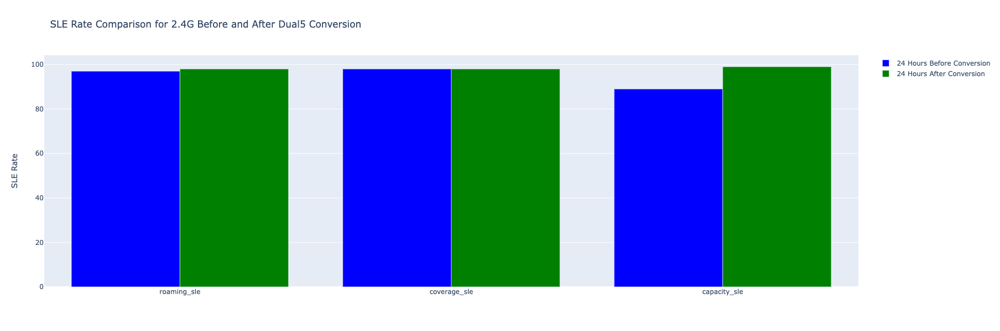

In [52]:
%%local
sle_before  = [97,98,89]
sle_after = [98,98,99]

#sle_before = [94,86,100]
#sle_after =  [93,86,99]
x=["roaming_sle","coverage_sle","capacity_sle"]

fig = go.Figure()
fig.add_trace(go.Bar(y=sle_before,x=x,name = "24 Hours Before Conversion",marker=dict(color = "blue")))
fig.add_trace(go.Bar(y=sle_after,x=x,name = "24 Hours After Conversion",marker=dict(color = "green")))
fig.update_layout(height=600, width=800)
fig.update_layout(
    title = "SLE Rate Comparison for 2.4G Before and After Dual5 Conversion",
    yaxis_title="SLE Rate",
)
fig.show()


# Ap Distribution

In [4]:
fields = ["ap_id","site_id","org_id","model"]
def select(x):
    d = json.loads(x[1])
    op = {}
    for f in fields:
        if f in d:
            op["ap_id"] = d["ap_id"]
            op["site_id"] = d["site_id"]
            op["org_id"] = d["org_id"]
            op["model"] = d["model"]
            for r in d["radios"]:
                if r["bandwidth"] >0:
                    op["band_{}_power".format(r["band"])] = r["max_tx_power"]
    return op
        
    
input_files = "s3://mist-aggregated-stats-production/event_generator/ap_last_seen/"
data_rdd= spark.sparkContext.sequenceFile(input_files).map(lambda x: select(x))
df_ap = spark.createDataFrame(data_rdd).persist()
#df = spark.read.orc(input_files)
df_ap.printSchema()


# input_files = "s3://mist-aggregated-stats-production/event_generator/ap_last_seen/"
# data_rdd= spark.sparkContext.sequenceFile(input_files)
# df = spark.createDataFrame(data_rdd)
# a = df.limit(1).collect()
# [Row(_1='d4dc0920c8e6', _2='{"ap_id": "d4dc0920c8e6", "terminator_timestamp": 1647971021273, "uptime": 1943395, "active_client_count": 2, "firmware_version": "apfw-0.9.22801-ilyn-88e8", 
#      "model": "AP43-US", "config_time": 1647773385, "input_cloud_partition": 4, "inactive_wired_vlans": [3, 6], "switch_ip": "", "switch_name": "sw276701", "switch_port_id": "22", 
#      "switch_model": "MS210-48LP", "switch_version": "", "switch_vendor": "Meraki", "switch_mac": null, "site_id": "faf825c4-8279-4fa0-b6e2-a1b200993fd2",
#      "org_id": "e1bde705-bd39-4089-8e3d-b897d0b660fa", "ip": "10.133.76.13", "radios": [{"dev": "r0", "band": "5", "channel": 44, "bandwidth": 20, "max_tx_power": 17, "radio_missing": false,
#                                                                                          "wlans": ["2e4395e5-3ee1-4830-8da0-854d6e83de19", "b3296e74-47b1-4a4d-8277-e5607a46a28c", "242b889a-db40-4ead-86d6-ece64bac7e37"]}, {"dev": "r1", "band": "24", "channel": 1, "bandwidth": 20, "max_tx_power": 10, "radio_missing": false, "wlans": ["b3296e74-47b1-4a4d-8277-e5607a46a28c", "242b889a-db40-4ead-86d6-ece64bac7e37"]}, 
#      {"dev": "r2", "band": "24", "channel": 165, "bandwidth": 0, "max_tx_power": 0, "radio_missing": false, "wlans": []}], "ext_ip": "74.40.213.194", "first_seen": 1629859742943}')]

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

root
 |-- ap_id: string (nullable = true)
 |-- band_24_power: long (nullable = true)
 |-- band_5_power: long (nullable = true)
 |-- model: string (nullable = true)
 |-- org_id: string (nullable = true)
 |-- site_id: string (nullable = true)

In [5]:
df_ap.show(3)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+-------------+------------+-------+--------------------+--------------------+
|       ap_id|band_24_power|band_5_power|  model|              org_id|             site_id|
+------------+-------------+------------+-------+--------------------+--------------------+
|d4dc09e3714f|           17|          17|AP33-US|bf105f5e-2490-453...|cfbaf77b-25da-42c...|
|d4dc09af0b40|            5|          11|AP33-US|78ded043-90bb-4b9...|82cf26fe-f88f-4b3...|
|5c5b354e2bb1|            3|           7|AP41-US|9de2eacf-bc8a-46c...|9c377362-7fea-427...|
+------------+-------------+------------+-------+--------------------+--------------------+
only showing top 3 rows

In [24]:
df_sites_ap_count = df_ap.groupby("site_id").agg(F.countDistinct("ap_id").alias("ap_count")).filter(F.col('ap_count')>=5)
df_sites_ap_count.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

18365

In [25]:
%%spark -o df_sites_ap_count -n 18365

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [34]:
%%local
sites = df_sites_ap_count["site_id"].unique()

In [35]:
%%local
len(sites)

18365

In [43]:
%%local
# Get dual 5 sites
import requests
import time,json
from requests.adapters import HTTPAdapter
from urllib3.util.retry import Retry
def requests_retry_session(
        retries=3,
        backoff_factor=0.3,
        status_forcelist=(500, 502, 504),
        session=None,
):
    session = session or requests.Session()
    retry = Retry(
        total=retries,
        read=retries,
        connect=retries,
        backoff_factor=backoff_factor,
        status_forcelist=status_forcelist,
    )
    adapter = HTTPAdapter(max_retries=retry)
    session.mount('http://', adapter)
    session.mount('https://', adapter)
    return session

headers={"X-FROM": "rrm-local-test"}
op ={}
op["band_24_usage_5"] = []
op["band_24_usage_auto"] = []
for site_id in sites:
    try:
        query_url = "http://papi-production.mist.pvt/internal/sites/{}/devices/rrm/24".format(site_id)
        response = requests_retry_session().get(query_url, params=None, headers=headers).json()
        if "band_24_usage" in response:
                if response["band_24_usage"] =="5":
                    op["band_24_usage_5"].append(site_id)
                elif response["band_24_usage"] =="auto":
                    op["band_24_usage_auto"].append(site_id)
    except Exception as e:
        print("error >> {}".format(site_id))
        print(str(e))
    
print("Number of site with band_24_usage = 5 >> {}".format(len(op["band_24_usage_5"])))
print("Number of site with band_24_usage = auto >> {}".format(len(op["band_24_usage_auto"])))


Number of site with band_24_usage = 5 >> 137
Number of site with band_24_usage = auto >> 858


In [25]:
%%local
op

{'band_24_usage_5': ['fe9f3df9-260b-42b1-8319-3cb4ac417277',
  '8ef0009e-59c2-4114-b022-fbe2c998dfef',
  '5fae7847-4638-47e1-b7e2-25882640cccb',
  'dbabe0f4-2ddc-4fee-8f2e-b0519e949181',
  '1830368e-a1ae-4aee-a097-c08117f22f48',
  '99ff972e-00f7-4dd4-865e-1c178e26c405',
  '4a516c75-80ab-436e-9e56-a8cc74c82264',
  '5a944ac7-ddee-41a4-aa65-d3c0424efc5d',
  'b7b12a67-0a93-4c66-8835-51e4de7f57b6',
  'ad90e439-6859-4473-aa9d-b14a26368707',
  '742bf504-6760-4007-8035-a47a934836a1',
  'c265ebaa-5e6f-4a04-a47c-8fe802a9e1ff',
  'f6a42798-4109-4b66-bf5c-07545f7cfef4',
  'd0bf0edf-20eb-4bb8-a4a8-cea49bbe017a',
  'dfad33bc-f6d8-4d73-9248-4025f311d94c',
  '0781ebbb-d615-436f-bc26-92f0a9b84563',
  '35b6c1b8-dab6-415d-8298-2fcdeb0f31e9',
  'dbf29fda-53b4-42f0-9584-fe7af9ae064d',
  '338b95c4-8b94-4ccd-ab4c-d03d3f23ef11',
  '69b7f813-7630-4395-bf82-3a6c8c4318d2',
  'adee6c4f-a907-49b6-8eae-312c47ae1f42',
  '1926280f-0f32-4400-bca1-9f7f0a72cc62',
  '132f4b4c-305e-447e-bbb1-6b605d5c5558',
  '4e6e0215-020

In [24]:
%%local
op ={'band_24_usage_5': ['fe9f3df9-260b-42b1-8319-3cb4ac417277',
  '8ef0009e-59c2-4114-b022-fbe2c998dfef',
  '5fae7847-4638-47e1-b7e2-25882640cccb',
  'dbabe0f4-2ddc-4fee-8f2e-b0519e949181',
  '1830368e-a1ae-4aee-a097-c08117f22f48',
  '99ff972e-00f7-4dd4-865e-1c178e26c405',
  '4a516c75-80ab-436e-9e56-a8cc74c82264',
  '5a944ac7-ddee-41a4-aa65-d3c0424efc5d',
  'b7b12a67-0a93-4c66-8835-51e4de7f57b6',
  'ad90e439-6859-4473-aa9d-b14a26368707',
  '742bf504-6760-4007-8035-a47a934836a1',
  'c265ebaa-5e6f-4a04-a47c-8fe802a9e1ff',
  'f6a42798-4109-4b66-bf5c-07545f7cfef4',
  'd0bf0edf-20eb-4bb8-a4a8-cea49bbe017a',
  'dfad33bc-f6d8-4d73-9248-4025f311d94c',
  '0781ebbb-d615-436f-bc26-92f0a9b84563',
  '35b6c1b8-dab6-415d-8298-2fcdeb0f31e9',
  'dbf29fda-53b4-42f0-9584-fe7af9ae064d',
  '338b95c4-8b94-4ccd-ab4c-d03d3f23ef11',
  '69b7f813-7630-4395-bf82-3a6c8c4318d2',
  'adee6c4f-a907-49b6-8eae-312c47ae1f42',
  '1926280f-0f32-4400-bca1-9f7f0a72cc62',
  '132f4b4c-305e-447e-bbb1-6b605d5c5558',
  '4e6e0215-0201-4ad5-b16e-06092260a6f2',
  '0ae5be31-aee5-4cd9-8bd9-6a13b295cdf4',
  '7b1f0539-4ed7-4a87-8432-6b1419ff1cf3',
  '37af3f6b-7d8c-4605-a804-d603629c2e80',
  '96bc21a0-fdf6-44a2-90a4-741d41068e59',
  '61129ca0-1244-45bc-a4a6-ff0b9816f3ae',
  'd071c380-c4e3-488a-a199-62c7b04a28c4',
  'a181b174-c9fc-4c3e-bfd0-3d7204dd46f7',
  '8127b171-af83-44b0-b9c3-8d93eb9c44c0',
  'ed2ef150-d155-415a-83d5-97d18dffbaa7',
  '9d6aeec9-920f-400a-99a2-13f8613477aa',
  'c8482263-acb6-496b-8d30-c21c6210e607',
  '8782eaa0-2d42-4454-8150-85b8e76fb57f',
  'b4959e89-4de8-4308-a00f-c9ac87a285d9',
  '0fe778bb-6340-4d4d-b44c-371ff3f169ba',
  '50fa3df4-053f-4779-86d5-f53d74343077',
  'f08e0103-edb5-4feb-a3d3-b9ba1becc7b8',
  '8986ddb4-7996-4138-9b92-ba6797f518d1',
  'a84ddeaa-8972-44e9-824d-a38abf9f5e71',
  'ea934649-d5e7-454d-bcff-3d10a52027f7',
  'f66afd9a-ed33-4a26-9077-7202798cc5b6',
  '9f874109-9959-4646-be10-0ac6cbd3b5b3',
  'bccd5d51-455e-4810-8d63-68278951071c',
  '2542b331-568a-4e27-8ca1-c77662ef6de4',
  'c40e2944-867f-454d-825e-ff927db83157',
  '678b7c52-41b1-4fc3-9473-33a198f8aaed',
  '87d34b95-b982-4f4c-a911-bb9127675177',
  '9901586a-be46-4743-88cb-ae81855db0b0',
  'ad7bb443-9178-46c3-8945-90bc0fae8218',
  'c338547b-3585-47f2-9439-95b4ab766a8d',
  'd0e6310c-abab-49d9-a21e-2a20d59277ff',
  'e5b218ce-69e7-41f0-9c38-029629008370',
  '9e7f5896-63a0-4e4d-999a-76e5380d5387',
  '96dcdd6b-7233-431e-8f4d-e109ccad0175',
  '8b90fd43-c617-4900-a313-bc16f7ec46c5',
  '6ca8bbdb-9fe2-4aaf-bc5e-3b1a75663eec',
  'a6e66c4d-aa09-4742-9170-88a0094d4209',
  'a331a175-c7fe-424c-9a08-4909605bf54c',
  '3ead98db-d80a-4ec5-b63c-7224481921dc',
  '14361e15-820f-42f9-81c5-a76eb7fe6687',
  '63390959-d0bb-4c15-8b2e-10d26086648a',
  '16f55404-d495-4962-bbf9-1f8c665b8ce8',
  'cfeaeac2-2eb5-4a9d-92a9-435658ab5ffe',
  'e0c6e747-40fc-42aa-81e9-2bae2e420356',
  'a35c1df0-4929-4764-99ac-41cb9e1712b4',
  'ef16e3cf-2ead-45cd-bafe-98fe784f4e91',
  'f294313b-0a2c-4cdc-a90e-745a927d462e',
  'af86fea5-a434-42a6-9a13-45706c24593f',
  '5e195484-0935-462f-9696-4efe0e15fe6f',
  '072a8a51-c504-4259-85e6-b2a6138014e9',
  'eef56bed-0f24-49d3-ae4d-55166d45263e',
  '20e1f48b-3c79-4cd5-bafb-342c8902e5ce',
  'e4d3915e-b04f-4a08-a2b8-9a2ffc701c08',
  '65b004a9-b313-481d-bc6a-fc99c23258fa',
  '4e8b9a31-f3b5-49a4-8667-7067b9a36f3e',
  '51015348-ae3d-4c7f-8e51-02ed44157c82',
  '97c70503-6541-45b2-83e1-2dd7c0ee9a48',
  '243c7419-0a64-4a6d-aa45-a6eeb8a94129',
  '86f7462e-48c3-4bee-826c-7457e085b072',
  'a652d79b-31d1-4b80-9dc4-f14ea23682b1',
  '0188e494-0d7b-40cc-94b2-449dacb302f3',
  '6a2b1eb2-cf27-416e-bad4-61c910e3547a',
  'c005cf13-59bb-4665-b8ec-3e3e1594bf07',
  'c905a2cc-189b-418b-a80f-f90c652f29de',
  'd6393997-e7ee-425a-88a4-5cb71acabc31',
  '623caff3-6d4c-400d-a590-f762c69d8cc9',
  'd9bcc1bb-46dc-46b0-98f3-9a4f3aab688f',
  '588cbc7f-6dd0-4980-99dc-9c9ff33dab0d',
  '0a2c1ca9-4dd3-483a-9cc4-586adeb56678',
  '80512bef-59ce-421d-9991-de586ddab2e9',
  '690ab6fb-aa77-447f-8735-616a06be3e85',
  '69714d5d-76e3-4559-a4a1-09c8e77b3466',
  '2b5d8b89-0308-4895-ad75-81e7cf85519b',
  'f360369f-1d8e-44c2-9a97-5d0989a233dd',
  'b4194afe-9a28-466b-8740-23424328c333',
  '8fec988e-bcc9-49f6-a5f5-0e846dd5877c',
  'b6c7fb85-ba81-4d93-a9ee-ded3423bd2f2',
  '34d1fe77-f972-4c05-91c0-3eefedd9e55b',
  'fd264461-b7a6-401d-a1dd-e9c4233ab495',
  'a5fb81e1-c1c6-4b5e-9fbc-dc0279427b28',
  '14453e00-a9f3-4fc0-a2c4-3fdc99d33147',
  'b032ddac-cbe4-4f4b-913e-05623f75b6f8',
  '9554ee1a-2d02-494b-a775-48bf88156947',
  '1a79aa23-1da1-4974-afc3-4e77e331bf6d',
  '975d82dc-c8a0-4ecf-9a2c-40a3f1615af0',
  'f563f5f3-4d9a-4b5f-9c18-3cda8ff05452',
  'b04989b3-c35a-488b-bb8d-381eb948d1c9',
  '316509d2-a784-47a6-a8c8-95f94488b6ec',
  '8d1fa27d-df10-464c-8858-fbd931e5e57d',
  '68f32265-0f51-45da-9ab7-0ecc136a35fa',
  'e35ce97b-3993-42a6-8755-43b234c80629',
  '76d6f4b2-ce21-4b80-bfef-b2cc06d8b4ca',
  'be58969e-9028-427b-a954-79adf04b8ad1',
  '6d0d7783-5795-4e33-8882-0cacfcd2d1b1',
  '79e1eb2e-3efb-453b-aa00-8e98e4d60b4b',
  '020a0543-cadf-44f6-be46-aa1c34fa6d28',
  'e5f5cf77-064c-4bee-b368-7432511d2ae1',
  '998b54b7-e581-429d-9749-dc58769ec84a',
  '558f8763-69b6-47d3-aba7-8f7040d7adb5',
  '2ceed8f8-ddb5-4c5d-97c0-33b48f2f00d6',
  '92e2544e-3664-4310-982b-aafc99585ae8',
  '89fff6a7-9fef-417e-a67b-f14e02e9e8e9',
  '36c0eac5-eb0a-41b7-a054-a4361efc9913',
  'f2c93ce6-459f-48db-9d93-efe8bc1c4701',
  'd12ed773-b1b8-456a-a88d-7315634bf8da',
  '131da42b-2eef-44c6-9119-669797ddcbeb',
  '048753c1-f5ec-4ccb-9f2e-4fcd3291e542',
  '997b7f05-4623-403a-9b4a-e56805f59425',
  '6a196653-fd16-4df2-9315-7944e6eb7b32',
  '211c08a4-2512-494c-a041-ac9d75ab8b91',
  'd5462f15-b0cc-4f81-9e61-e72922a8649b',
  '74c76e2d-4ce6-4741-a205-8d7f73f69f58',
  '5f6ff025-6184-4326-9125-f0d6700db90e',
  '0f798f0f-a3fa-418c-8968-75c17bb18012'],
 'band_24_usage_auto': ['b396bcdb-778c-4a72-b259-9fd7d6f2d4cb',
  '097d45af-157f-4ba7-a876-2cf3dbf10c1b',
  '2aefefe6-3a71-4859-b107-d05112d67ff6',
  '98912ef5-8cb7-4e2d-bb8c-8d8371df245f',
  '7c20b14f-857c-4442-907d-e915742a6f48',
  'dccfa29b-a6c5-4e2c-ab3b-5622619fa143',
  '4b8c395a-aff4-4ee0-ac76-0607e0c90a72',
  '578d2b21-df3e-41d9-af80-03847ae89fbd',
  'ea3529bf-23a1-4482-945c-6f6d4ad8ed79',
  'e968df79-7c58-4013-bc6a-c8c1120d62ff',
  '1d5c89f3-c49b-42d7-8276-9c1e11e8be20',
  'b70fb641-bc12-47fa-b040-6c6d3bd4af08',
  '973199f0-14e9-4e5c-9433-7f84e463e17b',
  'f782dc90-ce9f-4433-8ed2-db4beee34de3',
  '7b60beda-7563-4a50-9acc-6faefd0f3e59',
  '26d8d1f8-8557-405e-a6e6-be884afc099b',
  'a6b6f9f9-00b4-48cf-884e-bf0d7846dba9',
  '0c7eb66f-f5b9-4e2e-bce7-426fedf6d1aa',
  'c5f60158-7e59-432e-b453-840f0756efa7',
  '51b74e1a-7dfc-4b5c-8206-297b497dae18',
  '25a13561-f077-479e-b24f-e35226426296',
  '71caad65-d0c2-48f0-81cd-dec0c71efe18',
  '092ff78e-eb67-42c1-9a83-61933074d74c',
  'b1fb51ae-5a2f-4ccf-a800-118e83176b00',
  'fa3e9a30-18bb-40d3-b747-4cb7e12c9c01',
  '32a6c0e9-cdd0-4bd6-8088-1078e737d6e2',
  '08f59a99-454f-4023-816b-0cfadfe90a46',
  '0abf5469-82d9-4b32-a744-c228568d4fcd',
  '5f08b7ce-4d64-4f82-93e3-6e704142d8a8',
  'bc8a980b-faaf-4a67-b012-b7ebb06469bb',
  '13e8d0ce-8723-41e8-8ab7-8f8810267eb5',
  '3c67e3dc-778e-4e84-8aec-9cad42ad2582',
  '8589d67e-e6ec-4982-ba7a-735d2bc56ad4',
  '3f1b5d77-ae42-49ec-a6a4-357658ea6a17',
  '1372e308-7d82-4b6b-a64f-3ee330faee07',
  '237831e4-e033-4b71-9b6e-1172cf72bf70',
  '0a0d4e83-76cd-4957-b8af-35393f65775f',
  'fd5bb3fe-5f49-48b4-aeb9-93c6f5cb835b',
  'f7d5d56f-1d9b-4e8e-a6a6-0a521bd502a0',
  'd9123f46-08ac-41fe-be8a-b0df0d9d5946',
  '1b039ccf-bf25-45db-8481-b11d04bd55e9',
  '6a85ccb0-c302-40c5-8f02-e3d562271412',
  '27964771-aec7-4bae-88c7-17876a3c731b',
  '1a63e8a7-1bdf-4dcc-9f15-4c91cad45648',
  '20bfd61f-f5a9-4cc6-b565-9642de0792ff',
  '5d5d83bd-891d-466c-ad91-306c01faba38',
  'fa0544a3-924a-489f-8c80-e584268c3768',
  '6c0da79f-6a3a-428e-a2a5-9725ee6e144a',
  '873e05a4-6e3d-4719-9490-5a14263b5a62',
  'e32e585d-7c23-4cee-9532-4a37613c56ea',
  '3bfa9072-522c-4488-8c2c-d93997a24aeb',
  'deb2576b-6881-4151-ab31-7716c0d86260',
  'aab041d6-0281-4de4-a1c6-cefce7b630f1',
  'eeeb8099-d6b8-4f34-b5a1-4bb8db383e40',
  '6aae8a09-c154-4c01-9488-1d1fdc4d1335',
  '8788da6d-3cc7-4d19-9564-7e0354105887',
  'e0f209e2-1039-41c5-84cd-98afaa3e7cd7',
  '4dbc5060-a47d-4b71-a3a6-0c46d8add98a',
  'cde46d26-7954-4209-836b-a06586512786',
  'b750307a-2bc9-4faa-8221-3964aa79ba22',
  '198631df-1be8-43c5-a5b1-84fab2be0699',
  '76acb846-5154-415b-ae42-d9364a3daffc',
  '7f0298d7-c22b-4f56-9666-488ad785eaa2',
  'd9d87b96-cd25-4faf-be63-8c3a25245985',
  'd006047d-fe87-4384-9040-e71c83cd6f7c',
  '273beb2e-677b-4e9c-b310-7d7034e8a735',
  'a4b28216-50db-4ce1-98a8-e5258e43916c',
  '99a99be1-30a9-492c-a2eb-86bf8566eb87',
  'c9d62939-8dbd-4025-9d49-767ec14ccd44',
  '014e2bf1-779e-4a79-8f6c-a6a2a8e42d46',
  'd31b4f10-303c-4727-9b13-da33465afc44',
  '360876db-b114-4b72-b697-501759fdb14f',
  '044559d8-cc14-48af-abf8-e3b817bae05e',
  '2c20aa38-a69d-4d7b-a517-8cfb31572629',
  '895ad39a-e5bb-4586-8643-7a93a253b22b',
  '1966e2b3-31be-4a48-8d9d-ac4eab31d2fd',
  '10b01761-aadb-464c-a355-344a9199b1c6',
  'cd745afc-9b9c-11e6-bc2d-02e208b2d34f',
  'ff344797-e488-4a80-be99-9b23a3d57f1e',
  '7c3c8791-b63c-44ad-bc58-e8560cf2d0a8',
  '008dd958-2ce1-4294-9618-e734e4c4ed32',
  '931639ed-438d-46b8-9895-bbe7f2f31fdc',
  '37d3f414-ac9b-425f-b654-e5b392b925ee',
  '3d491607-c06a-402e-a20a-13a6abde0418',
  '12b94093-5788-45fe-84ee-ca31476198f8',
  '08627bf1-f16d-4973-bb34-0f16f62e6895',
  'b0b27c2f-d293-4e85-9dee-d122acd83806',
  '0f2770b4-b5f6-4cad-9c1c-ee2f05574ad6',
  '28ce3d81-e314-4f56-b4cc-3b5c0ae9f82e',
  '6ef059fb-f1cb-4008-bd53-3a7b93c079e4',
  'cb367427-28c7-486a-aeb1-b2693dbfb797',
  '91b0434f-6490-4037-aae9-820f4e5af420',
  '995706e9-36ef-49ea-9463-dd3b7d93ce1e',
  '110f4272-3526-4556-b61e-2af29a9befe0',
  'a36cdb26-e024-4ae8-9b39-fe5b9cfce6b9',
  '0f11f75c-cc5b-499c-ac64-43fb5ef4e47c',
  'bf7e1060-b5dc-48f5-be57-0e9e00aeafc7',
  'e00a9b82-7fae-4e3b-9cb7-5a5f2ac5da17',
  '01024a0b-3e0b-43af-89d0-ec3c74d20ac6',
  '925e507c-3efa-4ab8-a976-1b1811728b54',
  'd2a10c14-556a-4fdd-915d-775860dd8b0b',
  'b3fc49e0-0810-44e9-bff1-ccf8fc36b3cf',
  '8bae7aab-6cad-4970-a9a4-3dd0cda3a12d',
  'e003134a-cce5-4317-8fb5-2b303d2ebed5',
  '61fa7a2c-3846-4eb6-b90b-51708a99fe1e',
  '216d8f81-b5a4-4832-9c48-7db8fe812a8f',
  '1f021831-2dc6-488f-a236-a39bf6f2f1a5',
  '838a6cce-cefe-423f-a4d6-bce56ffc4ac3',
  'e92b0043-ab9e-441e-bab6-92bc5c671fe2',
  '9763d16a-4613-481e-ab85-35d289cc5ec4',
  '5bf8355e-81ea-4c3a-8f57-38296d752c45',
  'ad8b6eef-de92-4a84-a262-8230e40fd893',
  'eddd0a96-c390-4fe8-a632-36603a9936a6',
  '344d1c09-0317-4234-b29e-63546a7bff77',
  'b39dd655-6d59-4050-8aca-c6985276e8df',
  'e0facdf7-f6f7-453d-9fd0-46197a920769',
  '60f17a6f-f8e8-453a-996e-ed0851b6d0b6',
  '4f40399a-b932-41d4-b296-465e17bbb718',
  '4da474d9-b33d-4ec0-96d9-dd21cd3e8408',
  'f7755a99-04d7-4c7b-98bd-fffa393de585',
  'c01e9753-1664-44ba-b68a-fd9043eb94da',
  'a99544cd-1a9f-4528-b071-31c552b6764c',
  '3691ae7a-1f08-461b-9c2f-26ee4d5013c1',
  '45e3a2cb-9283-4e96-af44-feb4bdfc5ba2',
  '8ad745d9-a9a6-4904-aaf5-7c18df0a2a85',
  '71bcdbe8-1152-49d1-915b-dfbbf9cc3680',
  '70040901-b69b-47a1-a04f-341ee4111dfb',
  'd66f49be-00d2-4d68-8661-7b7b6255069d',
  'fb78583b-5b86-4273-ac1d-b58ce7cde2d8',
  '8f3727a4-598f-40ce-aca1-0a164ce13ddb',
  'b8d08afc-da61-4876-a14c-444373792218',
  '7d42fc83-d5c9-473f-b701-8cb3a5918dd3',
  '049c8f9a-44de-4a5c-8bea-fdae8e0f515a',
  '9a543c6b-faae-40f1-b148-0acd722d3947',
  '319f74f5-0e67-403b-8464-363f27d92000',
  '47563ae5-db59-483b-820a-5216f9b1f21d',
  '05770fce-4e1e-487e-82a1-6c54ca8dae68',
  'b1593da3-bd62-4e9a-85e8-47a2f354f344',
  'f6d7a27b-347a-4b1f-98a4-1033b60da814',
  '8fbcbbe6-8869-4d44-a59a-2335431ede41',
  'c10fd7e1-3868-46d2-88a5-cb60614a6c90',
  '61417fe9-f759-409f-86de-a96115011fb7',
  '7ff8cff5-dbb0-4906-8c68-f3c87873ea81',
  'a3a4524d-e0ed-49e0-baad-128d14e0227e',
  '5e0d630f-1ad0-4ecd-8527-083829d89524',
  '62952829-1304-47e1-a4f9-ebb817a31e8e',
  '327b06d1-786f-4bc5-9176-8acbfd5f4e0c',
  'ad70d0e3-906f-45b0-8d45-01430ab2a70a',
  '6ba26f43-55b6-46de-92f1-94957b5c306e',
  '6e5f23e4-577f-4206-b63d-1ab03bcffccd',
  '8bb1508b-d45b-4282-b1c5-fc5916332295',
  'f1ed3354-ccdf-4a43-ad61-d7c10350ef6b',
  '3ec4a548-22d3-41fa-9c74-3b557ce2fa8e',
  '140b2c2c-4b45-4c9a-82c0-da51e36b8a74',
  'b2c572ed-1ab8-4aa3-8039-a6d64eb0148b',
  '3d695e2a-9555-439d-8ebf-2f4d681a7929',
  '07433cc9-3f53-4227-b19e-e6aae0ef8436',
  'b3dfeb5b-47b4-4626-b318-e3e71a181217',
  '138cfe49-9c59-400a-a0c2-599454a89fbd',
  'e56cc372-ae56-4d53-b5f0-83919624bcf4',
  '3cfc56db-0c85-442f-8eed-7dcb00adba4a',
  '277f7a6f-fc4c-4c2c-ba54-e1e705333958',
  'b54cbe6f-15ed-4803-9f69-4c022deb1990',
  'b237e588-f859-4d3a-aa1c-ddfe9113a00b',
  '76c46448-6be4-46e4-87fe-e8e9e2a19159',
  '56206427-78f2-4e19-89f8-6806123d0a29',
  '7b970710-4bdd-42b7-8f00-6ed675d25a69',
  '5df6acbf-9e0b-4f8d-9c49-cb247be6eb11',
  '51090d2f-de35-4081-82a6-4fd2fdc4342e',
  '9f4f30d5-f0ae-4169-a41c-4244013e896b',
  '428274dd-aad7-4fb5-a6d9-c48ef9237a0f',
  '38807e76-5df6-4024-87d3-093f4146379e',
  'c9812df8-6af6-439a-85a9-8bf8c033fc79',
  '8979d968-b3c4-4692-be7e-8bd800b964ed',
  'f3af5560-72ee-4941-a2cc-86b59143501e',
  '825b4dc3-f4f6-43ca-8aab-ee4a6207d8e6',
  'd35818b0-822b-43ce-8f6d-623ffb2ab2bf',
  '20c89127-1b43-49e6-bbf0-f9c4e2bb6511',
  '50729ac0-3933-420b-bd1b-0f0342173b98',
  '1df34f6c-a2be-419d-8f83-e79f186d8c7e',
  'f57654bc-f05b-4676-ad8d-8b26ff5b8155',
  '55dee671-27ac-4f3b-a52d-25d79308ba64',
  'a116ffa4-0600-4b50-8c83-a63abe9d705c',
  '7411a5f0-79e7-4171-a118-77d03e6b2d33',
  '9f86c9fc-ad22-4a90-aade-bf93ac71aba3',
  '8785d057-d189-428f-afe0-71e3f909380f',
  '220a81d0-ad86-4792-9b6d-2fc420af3015',
  '242c641b-2d2e-4b54-98ae-8175b21a3e39',
  'ced044fd-5e5d-4f65-9924-5cbaafc24556',
  '79de573b-6e5f-4dfc-a43d-b3601b6e4b6d',
  '5c940048-99b3-4507-92d2-678d8eab3a2c',
  '3a07800b-366f-4ba3-ab8a-48373eca590c',
  '14496ee6-bbed-4582-b102-7e70debb69c1',
  'f2d372e4-0d92-11e6-85aa-02e208b2d34f',
  'b6c30c2a-b343-4c8f-9429-dc3bc1428ea0',
  '609c387a-eefa-43d7-b151-36cff38c858b',
  '507296bb-853e-4f72-81fc-4410b1a50e78',
  'accbbcd0-00d5-4979-baa9-a8a821b86d2c',
  '4c7c224f-0aca-4622-bc1f-9f9aeac13842',
  '976d072a-326a-451b-9c90-14bc3fd31c10',
  'f51d5e64-dba0-41ed-be41-5c9a06e74719',
  '08c437d3-14f6-4faa-8235-3e8e67d8b0b4',
  '809139d2-38a3-4681-8416-7d82f21dc105',
  'd722b02d-d404-4be5-b702-35268a2d7f04',
  '30c58718-9fb8-4bb7-954c-26ea20bbe8b6',
  'efe6f974-14d8-4584-b6ed-48127cd95f3d',
  'ca9f9614-be85-4e10-a788-df48442f843e',
  '064275a1-c4b5-4305-aebf-eaa6c2a57d0e',
  '6ef9d6ed-f301-401d-a35c-a5c950d02988',
  '1b4ac959-d15c-4d19-bdbf-3a67afaddeeb',
  '69bef04f-321d-4333-94d5-45adfdcff883',
  'fa9a77a9-6286-46b7-8179-0c0e81192d1f',
  '9a0acd76-e8cb-4073-82ca-3ac69b387153',
  'fc5f5d9d-069c-469b-87ad-118a2ae5ebe6',
  '366fe977-00ed-4bf3-bc76-a894a47c1094',
  '937ba22c-c5f6-4e02-ab9f-4d6c85c6db24',
  '6551c16e-1b29-48d0-840f-dba85920ed52',
  '6f933fe5-6056-493c-afcf-145884a26099',
  '8eae1d82-27bb-4742-8720-09c8f4192035',
  'b9708b45-fee7-4614-8ffc-cfd4df8b4e53',
  'c5007361-5725-4e95-b4f7-6cd5f905fb37',
  'c2251cd5-3c31-4632-9e31-79117134c142',
  '531c7703-6a21-4965-912d-c6c0915e1a82',
  '61be0798-194d-4c11-9d65-6ab9ab9058de',
  '4f2ff53c-b631-4107-9d51-c8f7dac5053e',
  '6cf57059-af1c-4bac-a2cc-524144e3d5fc',
  '93dfa7e0-7a2c-4abb-9ca1-05039fab5405',
  'b4ee29b6-820c-4f92-a11e-698c8001aae5',
  'd7ff6ae7-bdaa-40dd-a329-b9ba540a9c36',
  '5d612e07-7b8e-439e-9c26-1669ab135a07',
  'a3344348-a43e-46bb-81fa-df034ea311de',
  'aff412dc-bee6-4992-9368-6be6f117e827',
  '799f29ed-50c9-4dac-beac-a29c6a410ad1',
  'f9825794-ccd8-433b-b405-dac9443e5935',
  '1d937250-1630-4266-a3c1-97d51b6abaf1',
  '84073038-f7ce-490e-ac12-b7751194c24a',
  '5ed9016f-fef8-4318-a7db-eaa4524bc698',
  '54154b5a-35e0-4ef4-9574-d95cb57b855d',
  '23e534c8-909b-4779-8225-cc28e3098d34',
  'ffbba2c7-ef26-4cb0-8c56-19b2dd3a254f',
  'b2f9f504-06b5-482b-bcce-c6ae9a41e619',
  'c43d7575-05cd-467d-a614-0e51e2aec843',
  '3f0095f9-3289-45f3-b540-7a9f8adc3069',
  '64fd0b05-b2bb-429b-80e5-933bc1991c0d',
  'e31016dc-77e0-413d-895a-c58748cac606',
  '43313e50-dda3-49cd-a111-a0fc7149568e',
  'f3a09324-418b-4b5f-b413-07b9a1941baa',
  '49713171-2f4c-4a35-9bfb-495463d01ad1',
  'ceab3066-dae9-4e97-96ab-58a4c30071a6',
  'd0417d6d-097a-442e-b5af-4139c7e928be',
  'fee46f7a-e639-409c-b0c6-241c95ab9fda',
  '4b3f83ce-0a1a-420c-8d6f-d30e38068e0f',
  '2c1b51c3-2300-445f-b645-33e05b6e17e7',
  'fd7e2bd9-ab1a-423d-bc56-d6711788698f',
  'd68738a7-ffaa-478e-a8fc-f777e9184d1c',
  '4c0a6c62-2928-410e-8056-0692902560dd',
  '27aefaea-e212-4696-ad2e-f502f44a8790',
  '06daf124-2502-4fff-87e7-d07019c4690d',
  'ca87df05-a4c4-432e-b551-266b805ceb0a',
  'e57de0c5-18a3-405a-a221-4a6a42118e6b',
  '1659e1fe-ef6b-4da9-a6cd-1cd7f8b2a8fe',
  'bbd37225-5529-49f8-91da-00ac93adfc28',
  '69c928d1-aaa5-48ff-b1dd-e73fc2ad4a8c',
  'baf7d514-737b-4af0-a800-2d52335cd9f4',
  '91f61d4b-2e9c-4012-a144-dc04a2d232ba',
  '220e1cda-f4cd-4ef3-a330-49cb8ead3074',
  '6e445492-dcf5-49de-a737-2f66a72f901a',
  'dd426894-e024-412f-99ee-0e02ad7f711a',
  '8566a4a8-dcbc-4619-bfed-414f3725eaf2',
  '1cea74e9-99a4-4c21-ba52-cd883de7fea9',
  'c977f940-24cc-407f-804f-7ce3b3023798',
  '1d6b4867-2ebb-461d-8756-5dc244c6c8fa',
  '5f647ce5-f477-40f0-94c4-c80205ee89b6',
  '93edd9e2-6474-4452-a2e5-d0cf40e99fd0',
  'dc3430a8-a862-4b22-84ac-0e2f4bd7e45e',
  '815161b2-cabe-4fd7-942d-bc164c7d25cf',
  'f9d4ed15-7b68-4380-b6ec-205930a54265',
  '1c4c429c-a681-4310-8030-ee99f26fdd6b',
  '69792045-25b6-4a98-8c62-5c82e5936232',
  '2b51a479-88ad-4dc7-aa5e-8ace2b9c4574',
  '4afad03b-457e-4002-b296-7027f91375bc',
  '02c2458f-7c95-4a19-bacd-bd1edf438519',
  '79274640-77a7-451c-9691-b9b7b4119b68',
  '6cd166e7-8ee7-4fce-984f-41e5b9c5bec5',
  '44cec196-dab3-4b70-a62b-0b2d7a19c40b',
  'a0cf612c-5669-4262-b405-75c206d1ec50',
  'da859416-f856-475f-a0c1-ccf87c25512b',
  '15a86197-4b74-4ac2-beb1-ce84e560f3b6',
  'd022d67c-1342-4d2d-88fd-37863d1717fb',
  '29fedc34-e2d0-4752-a101-0355e5fd57b6',
  'ef003c58-039d-4f25-89e3-fb4afda56e99',
  '3c3c68a6-830c-4f6c-ba1f-57ec2fef5e2b',
  '357b49bf-dc75-45aa-978f-db15ad162dda',
  '9ae029e1-f3a3-4501-970f-5aa225e342af',
  'b4f027d0-651d-4279-9f4c-7dd9f8c6997f',
  '794c3de7-5798-49f2-bbff-8d1c3b7a2d9c',
  'ad68fa7f-e793-4830-a733-9915fc88e222',
  '8d917b59-865b-4d22-943b-a29ff377f5c5',
  'fdf1b743-a8cb-4227-a015-b3d587eb7caf',
  '08fe15fd-e3c2-460c-a81d-e0d7649edfed',
  '194bd8f6-3680-4028-842b-609a5db1676c',
  'f8a801e9-e57b-4659-8cca-1e6caa621ba1',
  '3cb6030f-d661-4a37-8e66-b3013ec56cab',
  '4a5a9ac8-32f0-44fc-b4e7-4891bad852f5',
  '5aec8b57-6efe-4ebd-bc2b-28de064df15a',
  '95be401e-4209-41c7-97f5-3be18529bf9e',
  '813998e7-1db1-4a1b-9e4b-1b44bbe4a870',
  '7d2f03c7-16c1-45a9-9667-17cbc9ef88e8',
  '4a48d008-74d1-49df-a08c-4c00793e7f1c',
  'b057546b-f9f3-4aee-a013-b3cb52328ed6',
  '70bb2f62-38f6-4fdc-b29f-ecd3017b2443',
  '067ce9f5-38e9-49c2-b5da-67f905da4af7',
  '9136963a-d820-4176-8b3c-e77680ebd444',
  '8d365b0a-4333-449b-acc3-8a5ea0946305',
  'e8c4ff0a-479e-49dc-bceb-0b79363ed744',
  '3ba4a012-38f4-4dd2-b24d-0efeb9441173',
  '1c59f5ae-0f0b-482e-a306-cb8ed5507633',
  'c3e50f6c-3380-4973-85a4-451978fcb058',
  'eb6f8393-9825-4762-b756-a5e52fb5377f',
  '9d4ef64d-4efd-43db-8d08-be8f62a9e941',
  'd24cc1e5-c5d1-45e9-aa93-0f2ded05748a',
  '673a6872-a187-4aca-b2f2-9364e6a195d1',
  '92b83672-24b0-4a8b-9a8d-9ff98b43dfc1',
  'ed747522-adad-49cc-81c4-058ae14c114b',
  '935887a7-2105-41b7-9ece-218192093440',
  '0c2e0f2e-8cff-4ac1-a5a9-a121114b7327',
  '3692be64-97ba-4c22-8f91-562332f7541d',
  '348af92c-e9d2-489d-9a84-d6c324e0a367',
  'a9866c65-7545-4640-8d1f-fd74395acbe1',
  'f50cd19c-e00e-42bb-bfa7-a740604c77db',
  '4a55b9ea-3282-4e06-897f-e1cdc70a7a93',
  '9a78994d-bfc2-430d-ad00-cb3457c860e2',
  'ce5e1e6f-3e2c-46fb-ba13-1656555d2f39',
  'd578e4d0-b242-4e2c-825c-408ec5d09696',
  '1f5f3b45-f5d0-4729-ac4b-6f544abbbd26',
  '83672cb3-48a1-4ce7-a808-a3624edfcb51',
  'e021fe0b-89bb-446b-8723-95d555c8e52c',
  '3f4af507-fcaa-4810-9a3e-144326a6dbc7',
  'c9af3f01-9309-472c-97eb-e66d15a971e9',
  '8df8d96f-bbd7-4408-bbe4-06a9b74268bc',
  '53561547-d13a-4255-af03-11711d030a93',
  'be5ee528-0335-455b-a5d7-ef0825bbe7b2',
  '6a393579-4fa7-4663-b77e-daa0101096d5',
  '257b59d6-26ff-45e3-bdf1-698428fc09e5',
  '5eb4b3c5-de56-473c-bb3c-f5b067cd70ec',
  '1db53bf9-b69e-4955-841e-5d18564f3ffd',
  '8cfb69dc-a462-4198-a6f1-b18e0f71859c',
  '850af3be-18a0-412e-82d0-b3825573121d',
  'f9e91aa2-b689-4a60-80c1-0cd3024f2f5f',
  'a78710e3-9854-415e-9bef-da9e95d4e3cf',
  '026a5805-1855-410f-8eb2-1f9c85fd0c9a',
  '371f6d52-a772-4533-a03a-d0cecdb2f153',
  '9fdedcab-e37a-4e08-90b4-6678221f0a7f',
  '980380d8-2404-4fd3-92e9-476e18329d06',
  'ad68267c-95ea-4d77-81cc-0ebd6ac1e8d3',
  '0cc5e1f2-bd04-4b63-a39d-418d69c58d08',
  '6e039c90-c6cd-4b2c-881f-285d043263e5',
  '9e33f380-4977-41d2-9465-718bfba3c850',
  'fb57a8c0-b830-4e1a-a4a1-167fbd0e577f',
  '6e06f93f-c31b-4120-83a4-bc857f46ebc4',
  'e0da2b5c-5998-4c32-8685-e22a8258439f',
  'cc7c9b09-78f1-4bdc-9b62-2be18d239a02',
  '2b5b0e11-5f54-4d12-a2a2-7a7a4cd1a5f8',
  'b0622dde-785a-412a-9af4-c6c3be13e30b',
  'f1315fd8-72a4-4a00-825e-d773786c5c75',
  '8a65e4d7-695d-4780-b176-2e49e4c1402b',
  'f8ef4146-628c-46fe-85b1-c73b58ac219e',
  '533924d2-a856-42eb-9898-809534d0c8dc',
  '1ebcf67e-88a2-4c18-8ad4-f0cc7e75e1f4',
  '8b0b1a15-803c-42f2-bd64-09b980b167f4',
  '7ed0614a-b971-4077-b9d0-8bc571da666d',
  'b7ce1560-207b-4152-82d9-f4507b74a9cc',
  'b74de50d-e775-49b0-9a45-70368c8a1ab6',
  '3187f901-57b2-4e00-bfd3-f84a41400332',
  'e59c4977-b764-47a1-93e6-cc369080b170',
  '5132d445-2789-44dc-8b05-c49d65694f87',
  'ee04d360-97e9-44b6-bcce-2688cd922b04',
  '18738ab7-d066-4c44-b4a7-b2345d89c1ca',
  'b585c812-c16a-4431-a9d4-6e865af692f3',
  '1b520aa4-bc01-46f1-8894-2395798019ad',
  'cf56ed55-6112-40d8-bbda-3497f980fb20',
  '1ffd5169-f83d-4105-8bfd-d909124f6749',
  'f280deb8-25e5-4a63-a2f8-c710edf64db0',
  '7387f649-265a-4f2a-91d1-e4b2904170f2',
  '2fac11ba-db77-42e0-91ad-dfd46102e9b4',
  'b7678c9e-d716-40a3-9961-77dae7081e4a',
  '370ef2cf-0cb3-40c2-a09a-1941a502b892',
  'a0143721-d9dd-41ef-841d-fd3d2a4df41c',
  'cc8821e2-58f8-4381-b6c4-9aecddd2093a',
  '0efc16cd-7024-4401-a6c1-33629d288909',
  '7eee45b7-27b0-48d1-b1ad-185db25ac323',
  '979ce8d2-44cd-4d74-9ba9-a6f61830e3ae',
  'ad4a46ef-3553-496c-891b-85bc41ee2554',
  '6c480928-aeec-450d-bf14-161c48e2ee05',
  '9b8c520b-d95e-459b-9fae-1825d97f28d8',
  'a0b6d33b-e692-49bd-aa92-eae83fe3102c',
  'dd375ca9-02b8-4ed4-b2d3-182f460c4367',
  '4ebcdd13-0e7a-4de2-a732-690cad6b65f2',
  '71c14800-c233-4360-8b8e-dabe029becf7',
  '9fedaca6-ae94-4916-b511-7a0b977b2fb2',
  '3b684358-3c4b-4e02-a3df-a52fed4e9a70',
  'af909340-6a2e-4b38-8e6c-1196b6afac8d',
  '09cce193-7948-4638-942a-50c9fce09fee',
  '807003b0-f066-4edb-be64-5b66b5a19c0f',
  '2f799f90-f3a4-4166-b439-3ca6b9b24804',
  '16c73d96-f9a5-4b6b-b894-f9ffd66e652a',
  '03ba030e-2a1f-4d54-b614-7f28d7d2c380',
  'd91810c9-b8b5-43a4-8f35-fbaf70c280ec',
  '6e9645b3-55b7-4407-9900-d69071b2e88c',
  '57d09052-77d1-449e-8352-d4eeab2b7d7f',
  '43899f28-8481-401d-8cdb-475e30e42c24',
  'c7cfd03c-ab0c-448a-b571-ec0bba8ea111',
  '959d95cb-eead-4ff3-b24a-aa633827ff3f',
  '65bd3aa4-3ef0-49db-a741-7d8d0e85361a',
  'b564432e-25cc-4320-8a4f-a0d62f052b0e',
  '094809dc-508c-4cb4-a8b8-dfa43c831b6d',
  'd2720294-eb58-4214-b70c-bee9b8a2e018',
  'c5d04368-b85a-4581-b9d5-8e30e092ee59',
  '0a85293c-038b-4b6c-86aa-c5d2fa59d31f',
  '8193a948-71d9-419e-865c-586fc5732c4b',
  'fc580fc0-a4f1-4755-9178-874118e7420b',
  'bbb63958-b878-4187-a2ea-8c3ce1a70b57',
  'bb56d129-32de-45aa-86db-9c7cdcf19070',
  '96e84f3f-ec60-4c1f-b3cc-c6ff6bff1fdc',
  '0cf9e64b-d214-4ba8-a29f-7e74eb6782ad',
  '17384c8b-8fe7-4080-bfdc-dc5d761a6d61',
  'c22d8bfb-dff4-46b5-aba3-8ccbaa75e274',
  '8ebbd448-1433-48cf-a38a-2bf00e5a6ce8',
  '22a55806-0b4d-4ac4-bc62-da3d43715064',
  'e04c4368-97dc-4c6e-9150-6b19989a2742',
  'd6ece5ff-f8cc-4373-a223-3f59979a5d62',
  '671210d2-d771-4a9b-8180-34d908d8784b',
  '30b46689-f08d-46b5-894b-8260be6732ce',
  '29f66c38-223c-4004-924a-ff3e5d623345',
  'debaf777-0429-4622-a6bf-8bcc9580cff8',
  'edd896c8-56c8-43d9-8fdc-e9b688190f40',
  '38720cc0-f54f-4735-8fed-43ff982b92b1',
  '69f37185-21d6-4a08-a97f-01fcf00f64fc',
  '2db35163-ecb9-4dab-b161-a745c224278e',
  '1df4f804-cf70-4011-be7b-0a1270ca0658',
  'a86315bd-4439-4c2f-9a36-bcf8dacf984c',
  'c93c3e02-4aa2-4c2b-9a94-cc84b04fdac7',
  '9d57a1e1-1538-4dc1-b7a0-b47b7ac19cd1',
  '899f9371-5720-4feb-8358-6fea5e8599cb',
  '7d7d4c43-820f-462b-9134-6ebdbde3af78',
  '43c59d34-71a8-43f3-b95d-7e7115375369',
  '1b649187-22bf-4aa7-83f4-99309b289d00',
  '73d7b7ac-7c44-4d23-b1c6-ecaa5868175f',
  '9c294291-a673-40bf-8836-a33b86c977bd',
  'e4e145d7-45ec-4fcd-bd32-9ffd35a77a93',
  'd11a8c12-f0af-4421-99d7-311dc4ead510',
  '69dc6756-6e3f-4d13-91b2-9d3bb1d077ea',
  '11406714-a4ef-4ae5-9c9f-42dfcb63deea',
  '4ce3ca9b-7ee1-4c8f-8ff9-0dec5c81c75f',
  'bb1b4c24-edfa-49ae-8651-76548da929b4',
  '3acde749-f2d7-43ec-8cfa-63500a588985',
  '0df67b9b-d15f-4d9b-8364-e2b1dbcf6617',
  '889aa72f-54f2-4053-9751-8c6f8e4f6c2e',
  'a7f51906-e65e-494b-973e-c6ce8657c4d4',
  '603092d0-a3f4-4524-9400-051698671dd0',
  'b2a5b83b-c1ef-493a-ae7c-9ac28919d9cb',
  '04071e46-3728-4663-83d7-5583e6ee91e6',
  '1a557187-cc6f-45ba-a380-5451eaf4ead2',
  'bd801ef9-f88b-46fa-9767-5086c35119f8',
  'c9bc55e6-9aa0-4d52-bea2-8901802eb820',
  '7f3cecb7-f1c1-4ee2-84ab-b5d3fe5747ea',
  '03813555-95ef-4933-b0f1-53745214ef52',
  '256bfabf-4546-41f0-a3c4-dc6f1cab5a4e',
  '4d184def-c4e3-4287-93fa-a55af5410d9f',
  '2afec94b-cad1-46ce-a88b-1932895a119d',
  'e51e873e-61bd-473f-a0ab-9c60a2aedb82',
  '7ff1a1d4-c5a8-4ca8-a609-e270616ad6a8',
  'a8c37fa2-4088-4692-96c7-5b1e8a3dbe95',
  '4cf4b529-39d4-4bb2-823c-b4da45b3489f',
  '1c9c197b-0775-4eab-9fd1-8e355dff0773',
  '2fdef378-f31d-49eb-a987-689b4eb607bb',
  '4f79ea0c-1b03-47f6-9a25-6cdba00ddfe5',
  'c0a656c5-7b78-4b81-9d70-1e44bfe37356',
  '1139d4ce-5e11-4de9-98c2-e6e1d72def4f',
  '9ab18c0b-c80f-4d93-beb8-12bb2c5ba2c7',
  'a6089913-4823-4135-9848-33edd083cf74',
  '9937aff0-8c8d-4a7c-8a2f-ad7e00b497b7',
  'd441485e-2f93-4a78-81c9-cf2672d4fbcd',
  '93793ab6-4c31-42d1-ab9a-723f36a0f089',
  '61a4b085-d148-4350-81d0-077ca2578e78',
  '978c48e6-6ef6-11e6-8bbf-02e208b2d34f',
  '1774a83b-45de-442e-8003-520e5ed2b711',
  '30f2e526-19c9-46b5-8aad-65a737ea09de',
  'af7536f2-99da-454c-836b-31368acd838c',
  'cdc7db33-da6e-4186-bd45-95d62f58c9aa',
  '54e5c2b4-be0e-402d-ba95-c67b6b309513',
  '3ed2f746-9d51-4ea2-ad68-afcbb958d16d',
  'be3a7601-6b1a-4dd2-8c52-d031a9873474',
  '6ab4e9a4-710c-4327-9cdb-2b92dfa2d84d',
  'b05e7644-c669-412f-a75f-beb58138e550',
  'f96d81cd-507f-4f4b-b80e-300400a37c53',
  '29f886d8-d01c-468f-877a-c6e132cda441',
  '16b39e08-d5fb-4f0c-ad39-09a9d07e882e',
  'e0718532-635b-444e-b7b0-36b5c1184b77',
  '4cb62d8d-f6e5-441d-aced-22ee0b55e513',
  'e6fd52fe-fd18-4324-acda-444bedcf739a',
  'a4b10ceb-22df-4272-97dd-e2f88da828b1',
  '56386cbd-86c5-483e-9d66-fdf3e9f0c7bd',
  '18b62753-2f32-4076-9358-76eba6b760fb',
  '85c324fd-76c9-417f-82ff-81499d9278ec',
  'cc2bb0ab-dddd-4e72-bd0f-fd2f7ddb4f65',
  '812d1174-f688-4830-9d15-86df914500a5',
  '2f09c0ef-b010-42f3-9b9b-5367e474d264',
  '09b9569f-ba1a-4ff7-8af4-80c21eec449c',
  '811d10b6-6595-4cae-bae2-82774b9341e7',
  'd8701a30-91f8-4c94-b08b-de95f346f694',
  'e261b35c-59e1-4d3d-9b5d-75c4b4fbe4ca',
  'c389b03a-83e8-4a89-8408-8a203fad92fe',
  '0477f3f5-a7ba-4854-b966-4e3841949956',
  '2af59908-b2e1-4a08-9f34-8d9b888825c4',
  'ec7ae724-8727-46e0-be6d-9be866de3a22',
  'dc53f270-4708-47db-a127-8748ae4a7a1d',
  'fce8ab9d-a430-4879-b414-bc32b8b72ca5',
  '7cf7111a-b9e9-48df-86ef-230fae9c5a58',
  '48140061-d927-42c7-807a-8dc4827da13c',
  'c86dfcb9-4d59-436c-8e79-64904183a65b',
  'f2ae3512-feda-4609-974d-0ea3ac9a6724',
  '97f35ff5-e2ca-4440-8005-f91b6588a917',
  'cf82bb8c-ab7d-4cc2-9cc6-921ceee44d56',
  '5946fb66-82fb-4438-a844-4461ecceab43',
  '6f530bcc-101c-4dfd-b770-491a6ff43c7c',
  'ab878347-19af-4e9d-ba50-f84a4395afab',
  'd24e95d2-4cb8-493a-b7d2-b11efb1c491e',
  'ec832074-480b-44dc-902b-f01a78679df0',
  '5f625c36-1d05-4906-b842-8eadb84b00ea',
  'c5a946d4-4cc2-45a9-a5a8-8ec738536442',
  'eef45a5e-8d86-41cc-972e-e4c731176978',
  'e5606c57-b6a9-4a00-a243-faad37a8b1f5',
  'db8cfb98-8326-4649-9a93-d5ab760ae28f',
  '99d63b50-5fd3-42d3-a459-181f13dcf142',
  'a43e4efc-af5e-44fc-be7b-79e15953a81f',
  '65ec63f0-4e41-4c7a-be66-dcdde6378921',
  '38191493-9def-425c-a3a7-e61a1e655ef3',
  '2d6c2d3a-7ec6-41be-ba48-91c33a7e02ab',
  '4380d509-8bed-42e1-afa4-0cc41d545c5c',
  '8c792610-5ad6-4311-a0c3-ab59e3a96c51',
  'c6d0b4b8-cafd-478a-9c03-44427f436eb9',
  '0a055685-1b49-43d8-9229-e8ccfddacef2',
  '2afd873b-7461-4a92-abf2-1335ab424c5c',
  '308ea5b7-61a6-4dde-84df-2f1a744add88',
  'e8701330-4617-4ff9-813b-d40a2c2a396f',
  'e53a2ae8-344b-4f4f-9187-7024d5f951d3',
  'df9d5d5e-21e9-44c8-a063-c4762185783d',
  '7c82d0d4-7f6c-4a10-8a1d-9f183a90f983',
  '4b4602a8-3c69-486a-be86-ee982a30e8fe',
  '3a3386d9-a0a2-42ab-8cf4-bdc16ef6d65c',
  '6330988c-7d6c-4c03-b637-a480fe86ef4f',
  '38608912-d68d-4660-8bd4-cf4b1891ff39',
  '026aadde-92b5-43e6-a7ac-bb230ef7f602',
  'ae775040-7444-4ef1-81d2-156098da9959',
  '21e35cb1-55e1-4ef2-9cc2-1e8fac9f04eb',
  '5d797ff7-af2d-45e5-8d4c-26bd6273c566',
  '6b5d8e00-7837-4051-96b5-3fdfcc8207d1',
  '4180bfb7-e78e-4bee-8e9f-eddf9122ec07',
  '0a6a1835-797c-4be4-b310-00c08c1c28b8',
  '682dd595-1b7f-4e38-b013-1e0137dcc452',
  '44d5b55c-15b9-4774-ad30-0238e4a34094',
  '0bc57be6-1bb9-4a91-90c5-51d6afe86300',
  '7f96e20d-7f98-4282-99b0-c751de8881d3',
  'ef56e203-66e8-424c-9f37-59913fd04639',
  'd8ed7ffe-59a7-4b1e-a3f4-f9f23e03231b',
  '6628dcf5-4bba-4692-9109-36bec911dc60',
  'de571617-e64b-4bda-8846-b6d4c6fff271',
  '61244d0b-d748-4002-8c53-6557b39daa5d',
  '12682dc2-d50c-4d72-9383-cb25f5e73085',
  '45e1d485-a2a1-4094-8f44-3945ea2671bf',
  'ce0595b9-f567-417d-85e3-5e3c00b6d630',
  '9abb3b1e-c72e-46af-9ba9-cf14963dad0e',
  'c659a24d-7e06-44bb-a65b-ad0d03d164c4',
  '8c1f5845-559e-4c70-84d9-49208d6e4182',
  '1a310c25-4296-4abb-9d02-191990f65da6',
  'f3b6632b-6638-42b8-89d6-2633d2452b9c',
  'b57f67c1-7e89-4d36-8df6-18814c9e8347',
  '0e7aacfe-d13c-418a-ab6e-6308899aa9bd',
  'e41a9128-4cfc-4a64-8bff-a4ce25c8b370',
  'f0c82974-c7e5-4f70-93fb-a7cfa108309b',
  'b8cf6bc1-33fc-4fc3-b335-528cf595b869',
  '57500609-8a68-4a42-8492-4df2c359fbae',
  '12575f6c-bac6-4326-86a4-b481b16e3dbb',
  '0d8f9fb1-ade7-4a44-a478-8b45b0bd5afb',
  'ba45e362-3a75-4575-8e27-8a9629d3fc8a',
  '08633eab-f032-4d3e-be1f-fde2c4c69006',
  'e41c2ea0-b161-4e28-bef4-15564230b7d7',
  '9a9721c7-2a77-4740-9160-79d0fa9aa1de',
  '2926a27f-e994-4df7-8f07-8ffc933f2510',
  'bc988d9d-b64d-4f24-bbd5-d9679ca07f82',
  '8559bf01-a00f-4851-92e4-6641a81091d2',
  'a6126a7f-230e-4a7c-973f-8a129e595389',
  '5098c39e-9a86-4cf5-b082-890560a02012',
  '9a4ce8e2-25b8-45dc-9f65-b457844a62da',
  'a5591b38-eec4-4484-b642-201131c3db11',
  '5c1574ff-c67e-4a87-8144-858d4ea3cc03',
  '6468503e-f3e3-47ae-8961-0b3121673413',
  'df710184-71e3-48ee-9491-1d4c7e16990d',
  '054fdb7e-e066-467e-a049-e9ed28829c18',
  'd2b41239-cc74-40ff-8d1d-067b197ed771',
  '4bc1605c-4d8a-4b7c-a2d8-3b6e9722c844',
  '0f0d5d1c-0d06-4987-b840-3f32410d8600',
  'c646629e-41c3-4b14-9fe3-b00a60cadc5a',
  '4df367bc-5a0b-483e-9eb4-2c2b973bcdb9',
  '0359e435-d295-4f3c-9288-73c0af19f146',
  '38d8a706-d65d-4fc0-8c9b-a6df1be1ff71',
  '9f220c04-37a1-4138-a455-86abdb2af566',
  'ea7b4884-5128-41d5-92d8-1a6bbb44e84c',
  '7c7d119f-5474-462f-ae46-86d56f9b42f8',
  '0a7a624f-f72d-47fd-b7e3-f9a6e32ea0ac',
  'cf2b7f8e-6e33-4d73-8337-4aa3f26ca720',
  '4183e8dd-99bf-4c86-a9a4-2808fff519b0',
  '57623d11-e477-4fc1-862b-4ee1eebdd6d2',
  '5b94f73f-5240-4a74-9113-0ef618433346',
  '2096d31a-90fb-4d0d-b25c-82f0e395c041',
  'ac24f4d8-cec2-4098-b997-1e56e54f2566',
  'd8efc34d-8ffa-41a5-812a-5f438a8365b1',
  'e018af73-42bd-4aae-abfe-a5763d66bc62',
  'edda593d-c5a0-4a6c-9a9c-d4d6c543d18d',
  'ccfb3da8-1ad0-41a0-9741-738c028e9a8d',
  '01f21c7d-085c-4ced-9c36-e7785142442f',
  '3d5ceaf9-4b9d-4562-9bc9-ca82d6883a56',
  'c6933f46-8cac-43ec-99f2-0d9a11ed3e5a',
  '43ab58e8-4a19-4c8d-9400-2dd83771faee',
  '62c3115b-0718-414c-87c5-e9716544b75e',
  'a1b5a9ea-6fda-4cb4-b8e1-b070cd7c09b6',
  '094a6268-328e-434b-a97f-39a32bf3d92c',
  'd08ccc2b-93f7-4d4a-b4dd-12b34eeb1aa8',
  '53ed0707-ab65-4e3d-b0e0-99ef75d66199',
  'fb2307ed-fb82-4dee-a598-376089af712c',
  'ba7998c2-2104-4053-8635-de287c39ab9e',
  '634679c7-32fe-414d-8512-b5cf054e933c',
  '98665da2-614a-41bb-95d2-d7adc55ff5df',
  '2d56ac17-c381-4ddc-b080-9e80393518c1',
  '436b0a1a-6082-4399-ad79-31c0be86e65b',
  '76b2e26a-f5aa-44b3-ad8e-f99dc852840a',
  '3a301b0f-54ba-470e-a393-c3b4e4a85412',
  'e0338de8-7ebf-4a1b-a4bf-1c63f608a477',
  '1cf60a80-b34b-42f0-acb5-032621991476',
  '4e616662-ce21-49f6-9279-296117594dcf',
  '573e2fad-e718-40ee-b486-bca00c656a88',
  'ad81b821-bb69-4fe8-bc5a-ac6211019c3f',
  'cb3c4b41-774f-48a6-aabb-07dc8329e7dd',
  'cd66e5e7-580e-43a4-be57-ff321b991150',
  'a4cb9008-ac6e-4b00-a9dc-62cae81e66a6',
  '4e819a2b-0b63-4c9a-8b96-cb617a88ebce',
  '4a26c9e0-fc9c-4a6a-b2b5-c7d244754b10',
  '796af540-75ec-4392-9c29-6f1cbbf919b6',
  'ec871201-e4ab-42ff-8766-4495cf3a5034',
  'bc8db6e4-77d6-4d72-a9af-2f0cf85b5af1',
  '7de09cbf-5f4d-41db-a23c-e62ebd42d533',
  'd865d17f-efc4-43b0-aaed-ff04fe010c0c',
  '26241f06-f2eb-494c-bed4-802c729ae692',
  '75ac695f-3735-4623-b6a1-41836a067b2d',
  '64cfa82d-10be-43cd-9413-0c9a33f1a01f',
  '0ad44c95-27a6-4a67-a819-70dc2e3605a2',
  '34421110-436f-4907-a152-a258b4827b19',
  '46ebbc44-1deb-4538-b4eb-63e09c720745',
  '04a1fb20-2711-445d-80ae-459cf1dae4fd',
  'ef41eaf4-fde0-4629-9fb3-d83e4e564b7b',
  'e8fbb923-4768-49d1-871b-d6d339825992',
  '5a8083c8-05cf-4f73-8f1e-a67ab5b76446',
  '33131f34-b31b-465d-9f1b-27577f72ee13',
  'dbab6064-c4aa-4939-a1f8-cf3a3f1f77f4',
  'a6b8c563-9c14-4aa1-99c7-8dd83dad8dba',
  'e4dcaf5b-f05b-41d3-9755-b8579720bcb0',
  '7ce18579-b67e-40f3-bf00-e9cb99d910b4',
  '43125d0b-b2bb-498d-816c-e6471ab07d21',
  '4c53bc99-55b2-4679-8a4b-eb5b4bdee50e',
  'c57766c0-b855-4e61-83f1-43e34a33a162',
  '69dcd723-8c70-4583-b35a-d63d42e6c56a',
  'ab07e1a3-e2dc-41c6-88b5-84ccf6104cb9',
  '4dac086f-46a8-444d-9412-86c2c31baaca',
  '6f51db68-6c33-4a29-ba08-1e4fc377f735',
  '06cb63cf-8619-43cb-9a73-02e7b868ec5c',
  'e9b7ded2-1619-4b79-a9bf-aa6ee82e367b',
  'e3d043c9-bcea-4682-9e64-5499e5901c94',
  '8e975f05-e025-4ea3-b512-f6780cfb682c',
  '74dbb69c-8e4b-441d-b288-a05af2d02003',
  'b76c6f00-9706-48e4-91c1-08803f4394de',
  '1de0c047-8705-4787-a7c0-790314efd745',
  'd77fc35a-ee02-45a9-ad3a-755eec922c52',
  'c771487e-85ad-4604-a2e3-d9fd79098660',
  '2748d750-a03f-40c1-9962-a95b4b376f84',
  '2774a39e-4d02-44ba-adc3-d940af1d53a0',
  '55998ae0-44b8-46c4-86dd-16e416c38f54',
  '786c9a16-d609-49da-b4ba-868138167f15',
  'e713a513-614e-458f-a49d-13d42349c846',
  '0a968d08-91b5-46e2-85dc-10a0691dd8e1',
  '139e2e67-c573-4843-83f3-bd789a05be5a',
  '75dab03b-58f8-40f4-9fdf-f89b26aace14',
  'ffff4576-7234-4133-9f2f-15e700f3763e',
  '7d4c33c3-fee1-4f2d-aee8-ece6cf594d19',
  'c8853647-6a00-4054-901e-946b80a3b47a',
  'aa914b66-f1f0-471b-be46-ddab842b8880',
  '22ce12d3-e878-436f-abe5-feabaa908e7b',
  '93da770b-a9a0-496b-a495-f76054f7d547',
  '2c80fa5c-c185-4a6b-8a50-d5a7eadc3ea3',
  '9e6f8727-65f0-4218-87b7-828a35afaed0',
  'aa64658b-8c98-4664-b08b-134cf4671641',
  '597be671-86eb-4349-b759-e21251937f6c',
  '17ebb995-8577-4720-9a0f-427811e3cc1f',
  '841b64f9-55b9-412d-a665-a708226377df',
  '84e81766-98e4-4111-a6b4-897fe2861dd9',
  '64bc421e-3899-4af8-9d76-3fed20d3a56e',
  '4f800ed5-827b-4bfc-8164-03f69be4d03b',
  '4ee6e679-caee-49d3-ae4c-de4f97c76850',
  '1db9a968-c1c2-4171-b202-8240039236db',
  '79d44d1d-a94e-4500-95cc-ec9d0f6697cd',
  'fa72473e-6d8c-42a4-89d2-1b6cc96052c7',
  'badbb8a8-81d6-455a-9013-80dbb57f1d2e',
  '3dcee3a6-f26d-4ebd-b56f-7acc011ca5a5',
  '8db86e3d-2529-41c5-9aee-2f004ec79ca1',
  '8fc39853-6a60-4ba6-8b42-f3a095941c28',
  'cef63fa4-160d-4292-977b-1fcba5c36551',
  'd6352d89-74f0-4553-b5b4-95398805d1ab',
  '76f6a0ba-9d3a-438d-9cb8-ced947b5a90d',
  '44b67a5e-4473-4f62-9502-f8f97297aa60',
  'f985bdca-c43e-47fd-8de1-0baa49d2b2cd',
  '34500d8f-25d0-4094-bb91-18b4ac4026d1',
  '0f428922-eb03-452d-aa85-9c95d180f5ae',
  '68b9e859-5e00-4313-bdba-cb868c8a6bf9',
  'b1b2910b-2a22-4da4-9e1d-9583a7be674a',
  'bf068929-b6b4-48df-aa1a-e4dd3092e2af',
  '00638b36-6912-40c2-87c1-434f516a1385',
  'd4f83e11-b403-4e92-9b25-931fdd14c8af',
  '7b4ea98e-24b7-45d1-93de-ef8e69500c71',
  '006e0fad-1813-455a-a13d-1a3829307abb',
  '3ed31578-73a3-4ecc-953f-58d24462030b',
  'c38f6b00-f897-45b5-9c61-eff4aa7428c7',
  '17943084-a636-4e26-8e15-35aa89987d3b',
  '960036cd-ead0-496d-883e-f7053f7f3c3a',
  'ed29f639-ff19-41bc-8501-789d7ae2f41c',
  '0667053b-34d6-499e-95fa-60b659c374e8',
  'e50f3751-bf18-4f85-a4c2-4a6e997af945',
  '053d5743-3bfe-4b00-ac6e-4410ffde708d',
  '07150664-84e3-490e-96be-c33c8b6ec923',
  'ae48f15f-72d8-406c-9de1-b814befa103e',
  '636b28f8-3b84-42b8-95e3-cc1248764066',
  'f6bd8434-74a3-48a4-8673-2918d8b6f7a9',
  '7b529702-509b-41a8-a6c6-7d7cdb010d66',
  '7c3c532d-4d4b-4d29-8d63-b7f13816b16b',
  '2b310329-8ab1-4dc7-adf7-635270b99a2e',
  '8ed2bcbb-a16a-4336-9e62-915abca62254',
  '45087a82-d3d3-415c-a553-0c165c839fc4',
  '62e009da-fdce-4977-8212-8cd8cea58137',
  '7cee1c39-7f8f-4af2-bf16-f923f4132715',
  '1494d68a-adc8-4abe-afb9-8e851074a55b',
  '6d7d5928-8e06-4284-86a5-4fb8b7a340ce',
  'e244a1f8-cf18-4bff-bc58-d18a0379855b',
  '5586991b-af22-48ac-b1a1-24c02ec31b4c',
  '14bd58e2-8f57-4468-9364-c4e551e08435',
  'a10270b7-5dbc-4c8c-825c-3b350b4c01c8',
  'd63e232d-9620-47d7-9d00-4534083681c3',
  '706f66fe-254d-4473-8fef-568cde6b82bf',
  '2177191e-b324-4bf6-b571-30c31d511de2',
  '142aa8dd-f719-490d-a186-b40e8d456f30',
  'df6791ca-48db-4d9a-b90f-6f54bd9ed424',
  '52fa67c5-1689-427e-ab33-f5f083ecc926',
  'c29a9c46-6f51-4243-8359-9f886435109d',
  'bfc370ab-d398-4d3c-8252-ef7156b125b6',
  'c04b0cef-675e-4637-88b2-240dcde06314',
  '85f9c029-a06b-44fd-b1fb-fa0a9aa6edaf',
  'fdc23f99-03cc-434e-aa0e-901f2d512802',
  '0b2b87eb-0f43-44d8-9c11-9ac02fce6faf',
  '142eee68-b4e1-4041-bde0-0a1464ce16a5',
  '09df1500-f1b3-4501-a805-7af21a1fb90f',
  '39dd5121-3e1c-45ee-98fc-c4118b137233',
  'e8e9d9a4-a870-4cff-bde8-a09792c67cba',
  'faa649b7-d44a-4fa8-b5cb-6a715abe2716',
  '4c468bfc-6106-44f0-be12-6ebb593b2cb4',
  '0f4c9a59-cfcc-4beb-b1ed-06aeeab3d704',
  '6ea4f104-97ac-4b94-979b-efa19b6b8a32',
  '0942bee8-e381-43b5-a708-566f8ce9ecc1',
  'aa89c7fc-c8cb-48a2-a8a2-59b21078c837',
  '9baac801-a308-4be8-96b1-ed00d1313d1b',
  '7347f4ae-9893-48d7-88cc-f315d2013d46',
  'a151ab05-fd5e-4300-93ed-8be0d97acf09',
  'd25d82ae-7a78-4695-8850-25d41d098087',
  '61d36fa1-8159-4304-9573-ac31590f90ee',
  'ea5b2e8c-ddd5-45f4-8bfe-557ceb613677',
  '1724c494-5e7b-495c-8403-1d866df79a30',
  '75a2ace0-34d2-4a91-b6e6-d439939e2d85',
  'f582c770-b95b-4144-a17a-4cd3eb6fbc6e',
  '8f569120-2043-42bd-9151-0f68ef47f770',
  '6e6d3cf4-ef49-44ab-8892-cf19fbd10d3a',
  '54c3e5dc-9a76-4ecf-8bbd-74da04e0b1fa',
  '46d63b06-225d-4c3c-85bb-271fc0a870e3',
  '98132c9d-6d41-4696-9bdd-6975d61c8306',
  'cd38c44f-8494-489f-8370-46165dfa217c',
  '61ea56e2-1c6a-4176-a505-0b5c8bac229a',
  '67a1c979-5982-47f9-84fc-79f8d45f9014',
  '1254aeb7-9bfd-4a9d-8821-d71923e71e5f',
  '7b1e85e9-e819-4197-8622-8eb464c5832f',
  '3af569b6-019f-416a-842d-8be996bc3920',
  'd3cd1636-f6c2-47da-a6de-ae2944b79381',
  'e93de694-53c6-4767-9c12-d96481674330',
  '2512f08c-fc9b-4b02-820d-f613c1bf2ce0',
  'e526b611-b2c3-40a8-a484-891cc10778d5',
  '6067d82f-085a-44c4-8043-ab681f70e137',
  'a77cc3a2-a80d-4120-b213-eef9dd8ffe72',
  '08bbc508-b991-4507-b3c3-3c51377dc54b',
  'aec6b2cf-a7b1-48f2-8c8b-ed207322e95d',
  '0b0e4ff7-ba37-43c8-8107-f1e24b7d5b90',
  '88ccd540-f7df-4440-b97d-f9dc54884396',
  'da9b9778-af54-437f-aa7a-e656106a4cd4',
  '01442017-e218-47fa-a3d5-f555e614b5cd',
  '8a65fbe4-cd2a-46ed-8d4e-db5a331e1d81',
  'cc044def-8007-484b-8875-4109a1cc5d79',
  'cfa4b2ac-0af4-4bb6-a031-d4162a549136',
  'baba41a5-921b-4de5-b96d-b291833d892a',
  '7eb552a8-f8fd-470e-8ee6-b928c3af8971',
  '956e38b1-5b65-4036-94c2-393b7dfd3739',
  'c57f1412-c1f7-47c2-94c3-0e2a525c503a',
  '3698544d-be25-4293-bc6e-b83928a652f1',
  'f7cb3d7a-c1fb-4717-9ecd-b81190342f17',
  'dacc8329-4f87-47de-8ce2-3484b76d1501',
  'ddc11383-74fe-41c4-8b97-2b846a11ef04',
  '6760c075-6e5f-49f0-8cd4-ca341f3887a9',
  'f99f22ff-e628-4a9e-b3d0-2acd761dcded',
  '0f4d5a50-56b9-4d4d-964b-72191c365cd0',
  '9d5cd595-ab92-45a6-82cb-486d4633fa90',
  '98f57427-88c4-405d-b99e-984b428f57d1',
  '52f92f5c-9ac6-40c1-8856-bc7211554a6c',
  '6cb09790-3716-4ae2-8208-4bafbabc28ab',
  '58ba3e72-536e-48af-9db2-fe2a797f1834',
  '382fb564-0ebe-4082-9e46-0320b5465638',
  '850ce9bc-fd04-454f-8f94-ac668cfcd62c',
  '68bf2adb-07a8-4e4c-93e4-2969998ad1cc',
  'c9c261a4-e303-4798-adde-9e434fb85fd4',
  'fd5085bc-a144-4ca8-9413-62b367d1494d',
  '6edaea82-859c-43a3-bea3-6118ae49b0e3',
  '24a12174-3179-456e-8e42-1b9a236b76e7',
  'e363d81a-40e9-48fb-9a2b-3aeb66c25c4a',
  '0f7eea38-628d-4a3d-873f-47bb24584d42',
  'f7346c0c-f503-4cec-add9-dff421a83b00',
  'f7b195e9-a25f-4cda-87f8-e9d2e07321ba',
  '324875e7-0f70-4e4c-a65c-c426c19d5c87',
  '31df1953-4e57-4f37-b288-c689cca91814',
  '5cb11e1d-d0c2-4fc4-82e0-543ae7b8bde0',
  '17850ad9-7b7e-4186-893b-82c08fafdd15',
  'b58d157f-512d-4c92-982d-7baff7aded50',
  '8686b96f-c42d-4568-9b40-2d7f0b3fdd9a',
  'adaf7531-a775-4034-ba47-39d15c743809',
  '150f45a6-a602-492d-9bb4-591134883401',
  'a40b5a6d-8d11-460f-815e-3a29ee305a31',
  '6942175d-23eb-4ea5-b109-9b68737c915b',
  '6fa7dd83-a4b9-47c2-ae51-c1ba883035c3',
  '13528791-74a2-4035-9e69-c3095cc0cd54',
  '3afe69fc-7189-4505-b00a-fe5922765dba',
  'f5e89966-67c6-41ff-af5b-8839249ff356',
  '1f4a442b-9919-4e2d-b612-e66317ab7314',
  'bc8b93c3-f1ee-46bc-95cd-bba41bc5777d',
  'f74495a9-6e7e-46ca-9e20-e8cfd1cd3921',
  'e0070ef7-28aa-42e9-a31f-348f4a95fba6',
  '48347e7c-d400-40a7-a909-fc19fd259c9c',
  'ec8c8fae-fe17-41b3-8b1d-7b351f43d49f']}

In [36]:
%%local
import redis,json
from datetime import datetime,timedelta
env = "production"
redis_server = "redis-proxy-rrm-{env}.mist.pvt".format(env=env)
connection_pool = redis.ConnectionPool(host=redis_server, port=6379)
redis_conn = redis.StrictRedis(connection_pool=connection_pool)
redis_conn.ping()
# Get avg neighbor for all the the site in aws prod. 
all_graph_stats = []
for user_site_id in sites:
    for band in ["24","5"]:
        try:
            redis_key = "rrm:graph:{site}:{band}".format(site=user_site_id, band=band)
            site_graph_stats = json.loads(redis_conn.hget("rrm:global:{}:{}".format(user_site_id,band), "GraphStats"))
            all_graph_stats.append(site_graph_stats)
        except Exception as e:
#             print("Error in getting graph stats from > {}".format(user_site_id))
#             print(str(e))
            continue

In [38]:
%%local
len(all_graph_stats)

36257

In [39]:
%%local
c = 0
c_n =0
for g in all_graph_stats:
    if "avgNeighbors" in g:
        if g["avgNeighbors"] != g["avgLoudNeighbors"]:
            c_n+=1
        else:
            c+=1

In [40]:
%%local
print(c,c_n)

36013 244


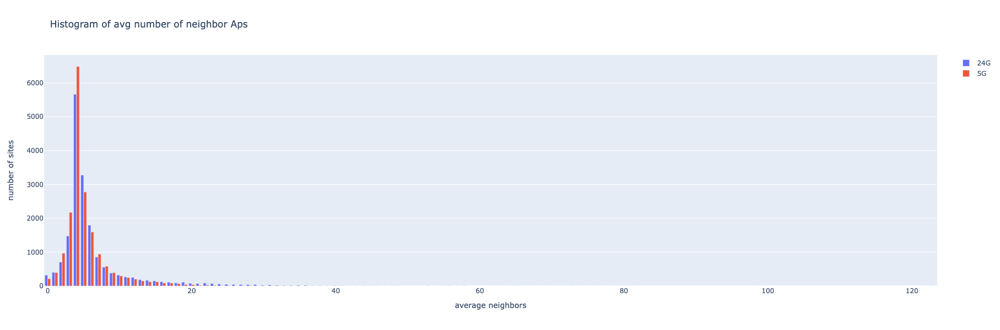

In [41]:
%%local
## Avg Neighbor
avg_neighbor = {}
avg_neighbor["24"] = {}
avg_neighbor["5"] = {}
for g in all_graph_stats:
    if "avgNeighbors" in g:
        t = round(g["avgNeighbors"],0)
        if t not in avg_neighbor[g["band"]]:
            avg_neighbor[g["band"]][t] = 0
        avg_neighbor[g["band"]][t] += 1
import math
x24=[]
y24=[]

for k,v in avg_neighbor["24"].items():
    x24.append(k)
    y24.append(v)
x5=[]
y5=[]
for k,v in avg_neighbor["5"].items():
    x5.append(k)
    y5.append(v)
    
fig = go.Figure()
fig.add_bar(x=x24,y=y24,name="24G")
fig.add_bar(x=x5,y=y5,name="5G")
fig.update_layout(height=600, width=700)
#fig.update_yaxes(type="log")
fig.update_layout(
    title="Histogram of avg number of neighbor Aps",
    xaxis_title="average neighbors",
    yaxis_title="number of sites"
)
fig.show()

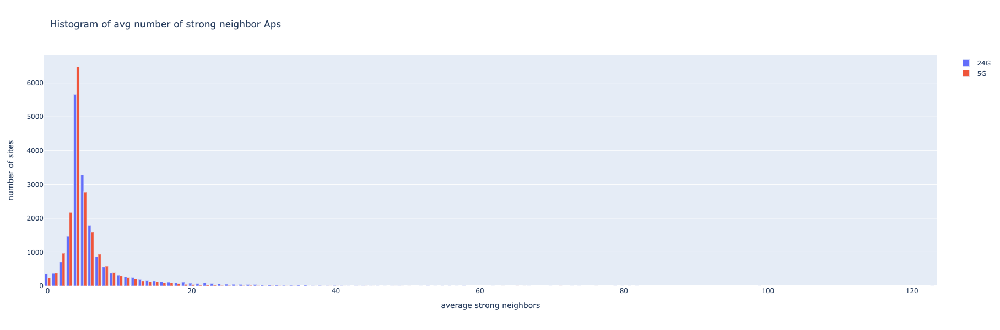

In [42]:
%%local
avg_loud_neighbor = {}
avg_loud_neighbor["24"] = {}
avg_loud_neighbor["5"] = {}
for g in all_graph_stats:
    if "avgLoudNeighbors" in g:
        t = round(g["avgLoudNeighbors"],0)
        if t not in avg_loud_neighbor[g["band"]]:
            avg_loud_neighbor[g["band"]][t] = 0
        avg_loud_neighbor[g["band"]][t] += 1
# Avg Strong Neighbor
import math
x24=[]
y24=[]

for k,v in avg_loud_neighbor["24"].items():
    x24.append(k)
    y24.append(v)
x5=[]
y5=[]
for k,v in avg_loud_neighbor["5"].items():
    x5.append(k)
    y5.append(v)
    
fig = go.Figure()
fig.add_bar(x=x24,y=y24,name="24G")
fig.add_bar(x=x5,y=y5,name="5G")
fig.update_layout(height=600, width=700)
#fig.update_yaxes(type="log")
fig.update_layout(
    title="Histogram of avg number of strong neighbor Aps",
    xaxis_title="average strong neighbors",
    yaxis_title="number of sites"
)
fig.show()

In [122]:
%%local
# dual 5 auto sites ap count
ap_count_dual5 = {}
ap_count = {}
conversion_ratio = {}
total = 0
conversion_site = []
for g in all_graph_stats:
    if g["band"] =="5":
        if g["site"] in op["band_24_usage_auto"]:
            total+=1
            dualn = g["n_radios_dual5"] 
            n = g["n_aps"]
            if dualn not in ap_count_dual5:
                ap_count_dual5[dualn] = 0
            ap_count_dual5[dualn] +=1
            if n not in ap_count:
                ap_count[n] = 0
            ap_count[n] +=1
            r = round(100*dualn/n,0)
            if r not in conversion_ratio:
                conversion_ratio[r] = 0
            conversion_ratio[r] +=1
            if r > 98:
                conversion_site.append(g)
len(conversion_site)

15

In [124]:
%%local
for s in conversion_site:
    print(s["org"],s["site"])

31f3bf67-c408-49ed-81ac-6113c80704a9 e968df79-7c58-4013-bc6a-c8c1120d62ff
538af30d-4e94-4562-a9e8-c9d1f88a0450 7b60beda-7563-4a50-9acc-6faefd0f3e59
f41ed456-3406-4811-acad-29c63573825e 4f40399a-b932-41d4-b296-465e17bbb718
fdd486ff-495f-4573-a184-0a01c6eac3e3 05770fce-4e1e-487e-82a1-6c54ca8dae68
5ad3e248-5fd0-4d01-86f9-18e2ddf2215e f1ed3354-ccdf-4a43-ad61-d7c10350ef6b
8c4cd205-1f73-42df-9a34-c9134906dcca f9d4ed15-7b68-4380-b6ec-205930a54265
eedf7823-9339-413e-9fa5-d233a423f400 4afad03b-457e-4002-b296-7027f91375bc
8475e3f1-1538-4f8b-bc32-02d39ee3853b 1db53bf9-b69e-4955-841e-5d18564f3ffd
16f9ab0f-979f-4c40-974d-f6c3c180ca27 6e039c90-c6cd-4b2c-881f-285d043263e5
9dbc0268-b0f7-4c32-be5c-b012e56a788e 1df4f804-cf70-4011-be7b-0a1270ca0658
31f3bf67-c408-49ed-81ac-6113c80704a9 2afec94b-cad1-46ce-a88b-1932895a119d
1bc7fc2d-2def-4886-90e2-d9d90cef7728 1de0c047-8705-4787-a7c0-790314efd745
8475e3f1-1538-4f8b-bc32-02d39ee3853b d25d82ae-7a78-4695-8850-25d41d098087
8540b0c3-1e5d-4c30-bffa-9e129ddec9bd 9

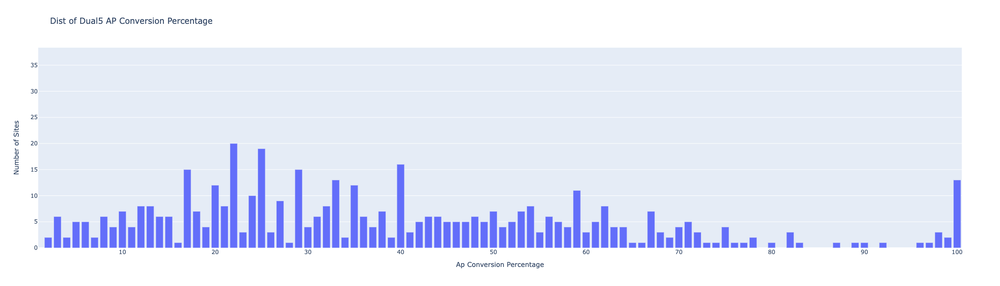

In [72]:
%%local
x=[]
y=[]
for k,v in conversion_ratio.items():
    x.append(k)
    y.append(v)
fig = go.Figure()
fig.add_bar(x=x,y=y,name="Dual5 AP Conversion Percentage")
fig.update_layout(height=600, width=800)
#fig.update_yaxes(type="log")
fig.update_layout(
    title="Dist of Dual5 AP Conversion Percentage",
    xaxis_title="Ap Conversion Percentage",
    yaxis_title="Number of Sites"
)
fig.show()

In [94]:
%%local
g

{'org': '538af30d-4e94-4562-a9e8-c9d1f88a0450',
 'site': '2aefefe6-3a71-4859-b107-d05112d67ff6',
 'rad_id': 'r24',
 'band': '24',
 'channels': [6.0, 1.0, 11.0],
 'bandwidth': 20.0,
 'site_power': 0.0,
 'dfs': False,
 'n_aps': 5.0,
 'channels_chisq': 0.2272727272727273,
 'naps_by_channel': {'11': 2.0, '1': 2.0, '6': 1.0},
 'avg_aps_per_channel': 1.6666666666666667,
 'power_median_weight': 2.5,
 'when': '2022-03-11T10:47:38',
 'usages': [],
 'allow_rrm_disable': False,
 'disable_level': 0.5,
 'rrm_enabled': True,
 'reason': 'rrmG-scheduled',
 'time_start': 1646995658.4059775,
 'data_sources': '->apradio:redis->apscan:redis ',
 'avgNoise': -86.6,
 'site_rf_overlap': 10.0,
 'density': 0.5,
 'graph_density': 0.9,
 'avgNeighbors': 3.6,
 'avgCochannelNeighbors': 0.8,
 'avgLoudNeighbors': 3.6,
 'avgLoudCochannelNeighbors': 0.8,
 'avgCochannelNeighbors_ref': 1.2,
 'aps_off': 0.0,
 'aps_channel_fixed': 0.0,
 'aps_power_fixed': 0.0,
 'naps_by_power': {'3': 5.0},
 'naps_not_in_map': 0.0,
 'channel

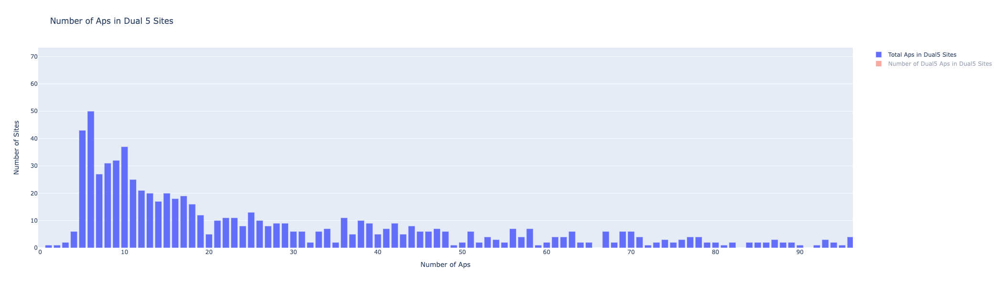

In [73]:
%%local
x=[]
y=[]
for k,v in ap_count.items():
    x.append(k)
    y.append(v)
    
    
x5=[]
y5=[]
for k,v in ap_count_dual5.items():
    x5.append(k)
    y5.append(v)
    
fig = go.Figure()
fig.add_bar(x=x,y=y,name="Total Aps in Dual5 Sites")
fig.add_bar(x=x5,y=y5,name="Number of Dual5 Aps in Dual5 Sites")
fig.update_layout(height=600, width=800)
#fig.update_yaxes(type="log")
fig.update_layout(
    title="Number of Aps in Dual 5 Sites",
    xaxis_title="Number of Aps",
    yaxis_title="Number of Sites"
)
fig.show()

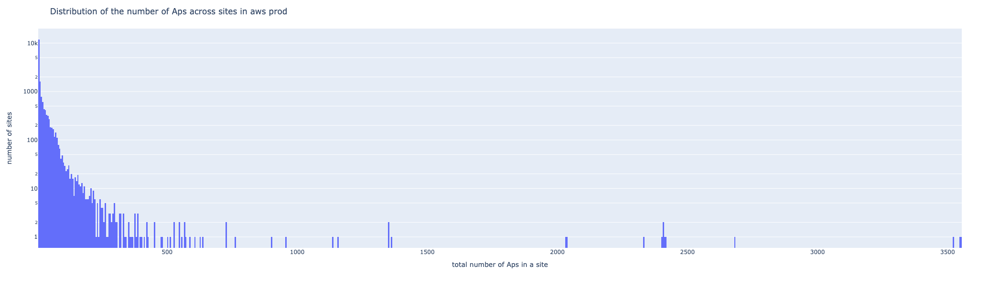

In [32]:
%%local
# filter out sites with less than 5 aps
fig = px.histogram(df_sites_ap_count,x="ap_count",log_y=True)
fig.update_layout(height=600, width=700)

fig.update_layout(
    title="Distribution of the number of Aps across sites in aws prod",
    xaxis_title="total number of Aps in a site",
    yaxis_title="number of sites"
)
fig.show()

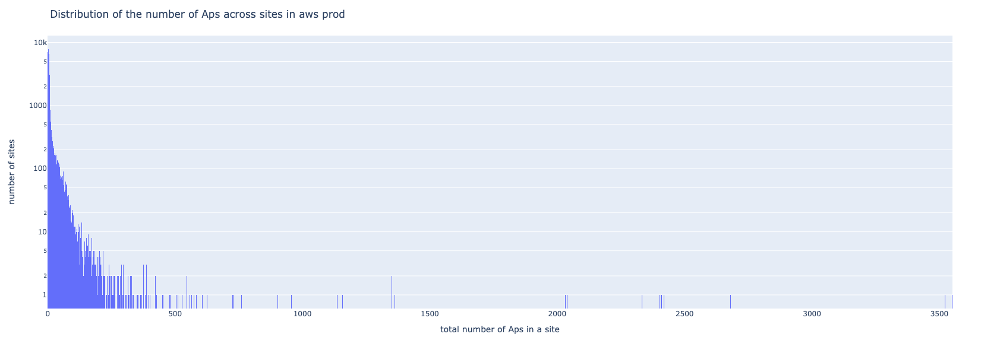

In [29]:
%%local
# all sites
fig = px.histogram(df_sites_ap_count,x="ap_count",log_y=True)
fig.update_layout(height=600, width=700)

fig.update_layout(
    title="Distribution of the number of Aps across sites in aws prod",
    xaxis_title="total number of Aps in a site",
    yaxis_title="number of sites"
)
fig.show()

# RRM Power Difference between 24 and 5

In [4]:
fields = ["ap_id","site_id","org_id","model"]
def select(x):
    d = json.loads(x[1])
    op = {}
    for f in fields:
        if f in d:
            op["ap_id"] = d["ap_id"]
            op["site_id"] = d["site_id"]
            op["org_id"] = d["org_id"]
            op["model"] = d["model"]
            for r in d["radios"]:
                if r["bandwidth"] >0:
                    op["band_{}_power".format(r["band"])] = r["max_tx_power"]
    return op
        
    
input_files = "s3://mist-aggregated-stats-production/event_generator/ap_last_seen/"
data_rdd= spark.sparkContext.sequenceFile(input_files).map(lambda x: select(x))
df_ap = spark.createDataFrame(data_rdd).persist()
#df = spark.read.orc(input_files)
df_ap.printSchema()


# input_files = "s3://mist-aggregated-stats-production/event_generator/ap_last_seen/"
# data_rdd= spark.sparkContext.sequenceFile(input_files)
# df = spark.createDataFrame(data_rdd)
# a = df.limit(1).collect()
# [Row(_1='d4dc0920c8e6', _2='{"ap_id": "d4dc0920c8e6", "terminator_timestamp": 1647971021273, "uptime": 1943395, "active_client_count": 2, "firmware_version": "apfw-0.9.22801-ilyn-88e8", 
#      "model": "AP43-US", "config_time": 1647773385, "input_cloud_partition": 4, "inactive_wired_vlans": [3, 6], "switch_ip": "", "switch_name": "sw276701", "switch_port_id": "22", 
#      "switch_model": "MS210-48LP", "switch_version": "", "switch_vendor": "Meraki", "switch_mac": null, "site_id": "faf825c4-8279-4fa0-b6e2-a1b200993fd2",
#      "org_id": "e1bde705-bd39-4089-8e3d-b897d0b660fa", "ip": "10.133.76.13", "radios": [{"dev": "r0", "band": "5", "channel": 44, "bandwidth": 20, "max_tx_power": 17, "radio_missing": false,
#                                                                                          "wlans": ["2e4395e5-3ee1-4830-8da0-854d6e83de19", "b3296e74-47b1-4a4d-8277-e5607a46a28c", "242b889a-db40-4ead-86d6-ece64bac7e37"]}, {"dev": "r1", "band": "24", "channel": 1, "bandwidth": 20, "max_tx_power": 10, "radio_missing": false, "wlans": ["b3296e74-47b1-4a4d-8277-e5607a46a28c", "242b889a-db40-4ead-86d6-ece64bac7e37"]}, 
#      {"dev": "r2", "band": "24", "channel": 165, "bandwidth": 0, "max_tx_power": 0, "radio_missing": false, "wlans": []}], "ext_ip": "74.40.213.194", "first_seen": 1629859742943}')]

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

root
 |-- ap_id: string (nullable = true)
 |-- band_24_power: long (nullable = true)
 |-- band_5_power: long (nullable = true)
 |-- model: string (nullable = true)
 |-- org_id: string (nullable = true)
 |-- site_id: string (nullable = true)

In [5]:
df_ap.show(3)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+-------------+------------+-------+--------------------+--------------------+
|       ap_id|band_24_power|band_5_power|  model|              org_id|             site_id|
+------------+-------------+------------+-------+--------------------+--------------------+
|d420b002b9ad|            8|           8|AP41-US|5a578f3c-f094-4d1...|2699589f-8716-42f...|
|5c5b358f35d8|            5|          14|AP41-US|a8c903ae-e6d0-42a...|6b69bbc0-1eb8-410...|
|5c5b352f7214|            4|           9|AP41-WW|8d767f8e-21a7-485...|8fcd8757-3c6b-47d...|
+------------+-------------+------------+-------+--------------------+--------------------+
only showing top 3 rows

In [6]:
df_ap.filter(F.col("band_24_power")==8).show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+-------------+------------+--------+------------------------------------+------------------------------------+
|ap_id       |band_24_power|band_5_power|model   |org_id                              |site_id                             |
+------------+-------------+------------+--------+------------------------------------+------------------------------------+
|d420b002b9ad|8            |8           |AP41-US |5a578f3c-f094-4d13-a7dd-96f0aaecb5b6|2699589f-8716-42f8-8e69-25456d0c3f98|
|d420b000d4f8|8            |9           |AP41E-US|56de201d-e63b-4312-9858-40f4cfe35c7f|74194595-00e9-4e7b-aab0-3a122252d1f7|
|5c5b35bf5bad|8            |8           |AP41-US |5a578f3c-f094-4d13-a7dd-96f0aaecb5b6|db10ac09-2971-4f7a-90c5-109eb2753fd8|
|d4dc09ad78e3|8            |8           |AP61-WW |5a578f3c-f094-4d13-a7dd-96f0aaecb5b6|17fa464c-8107-42b1-806e-710ceb6e456c|
|5c5b35cf18aa|8            |11          |AP41-WW |16342635-98c2-4cf7-8798-275f3a7c59b2|9f6e7f61-05f6-4ba4-9574-e3193effabe5|


In [8]:
df_org= spark.read.parquet("s3://mist-secorapp-production/dimension/org").select(F.col("id").alias("org_id"),F.col("name").alias("org_name"))
df_site= spark.read.parquet("s3://mist-secorapp-production/dimension/site").select(F.col("id").alias("site_id"),F.col("name").alias("site_name"),"org_id").join(df_org,"org_id","inner").persist()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [6]:
# power distribution
power_24 = df_ap.groupby("band_24_power").agg(F.countDistinct("ap_id").alias("ap_count"))
power_5 = df_ap.groupby("band_5_power").agg(F.countDistinct("ap_id").alias("ap_count"))

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [7]:
%%spark -o power_24

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [8]:
%%spark -o power_5

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

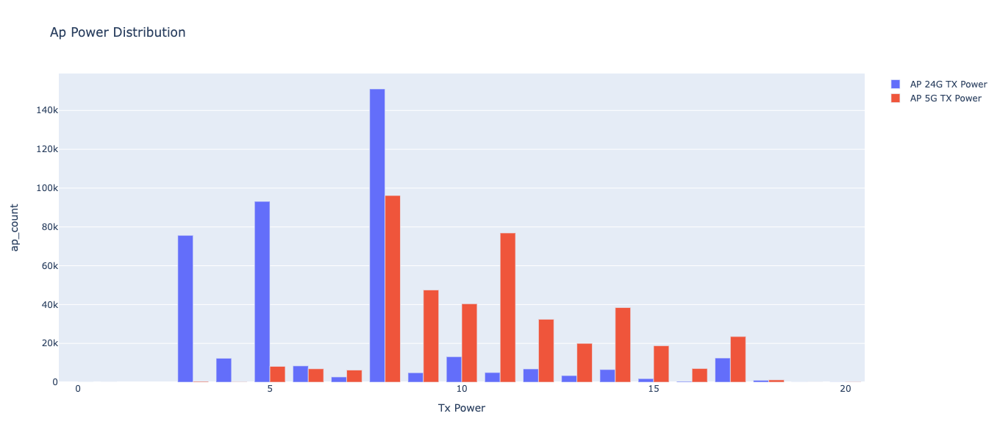

In [10]:
%%local
fig = go.Figure()
fig.add_trace(go.Bar(x=power_24["band_24_power"],y=power_24["ap_count"],name="AP 24G TX Power"))
fig.add_trace(go.Bar(x=power_5["band_5_power"],y=power_5["ap_count"],name="AP 5G TX Power"))
fig.update_layout(height=600, width=800)
fig.update_layout(
    title="Ap Power Distribution",
    xaxis_title="Tx Power",
    yaxis_title="ap_count"
)
fig.show()

In [9]:
df_ap_power_diff = df_ap\
                    .withColumn("power_diff",F.col("band_5_power")-F.col("band_24_power"))\
                    .groupby("org_id","site_id").agg(F.mean("power_diff").alias("avg_power_diff"),\
                                                    F.mean("band_5_power").alias("avg_band_5_power"),\
                                                    F.mean("band_24_power").alias("avg_band_24_power"),\
                                                    F.countDistinct("ap_id").alias("total_ap"))\
                    .join(df_site,["org_id","site_id"])
df_ap_power_diff.show(3)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+--------------------+--------------------+------------------+------------------+-----------------+--------+------------+--------------------+
|              org_id|             site_id|    avg_power_diff|  avg_band_5_power|avg_band_24_power|total_ap|   site_name|            org_name|
+--------------------+--------------------+------------------+------------------+-----------------+--------+------------+--------------------+
|95801b40-7794-11e...|9581123e-7794-11e...|3.6666666666666665|12.591836734693878|8.941176470588236|      52|Primary Site|      Swan & Dolphin|
|cca75a42-a42c-11e...|cca803fc-a42c-11e...|              -2.5|              15.5|             18.0|       2|       Chris|              ChrisG|
|bf105f5e-2490-453...|1502e1e6-0dc4-401...|               0.0|              17.0|             17.0|       2|       00667|CVS Retail Produc...|
+--------------------+--------------------+------------------+------------------+-----------------+--------+------------+--------------------+

In [10]:
df_ap_power_diff.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

35522

In [11]:
%%spark -o df_ap_power_diff -n 35522

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

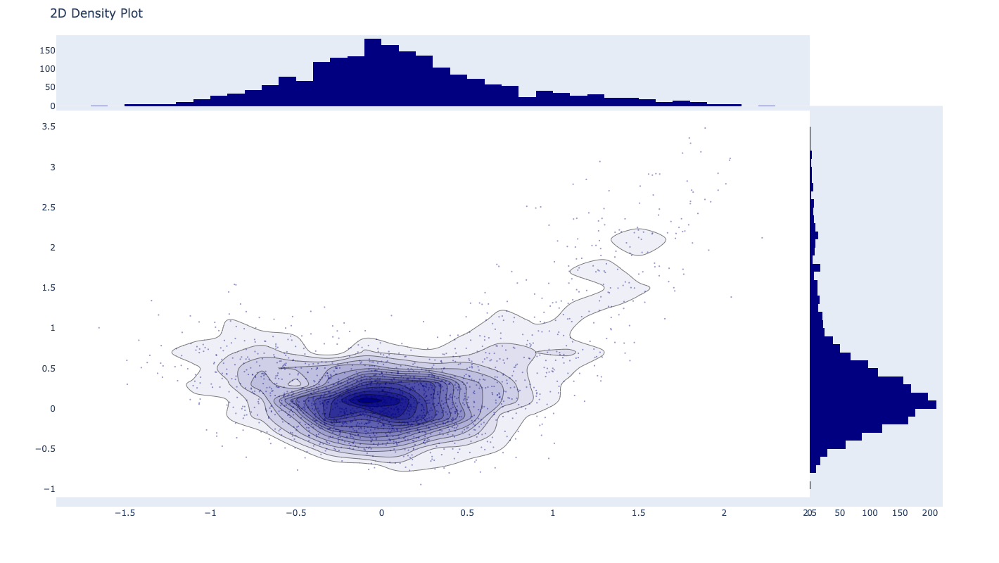

In [59]:
%%local
import plotly as py
import plotly.figure_factory as ff

import numpy as np

t = np.linspace(-1, 1.2, 2000)
x = (t**3) + (0.3 * np.random.randn(2000))
y = (t**6) + (0.3 * np.random.randn(2000))
fig = ff.create_2d_density( x, y)
fig.update_layout(height=800, width=1000)
fig.show()

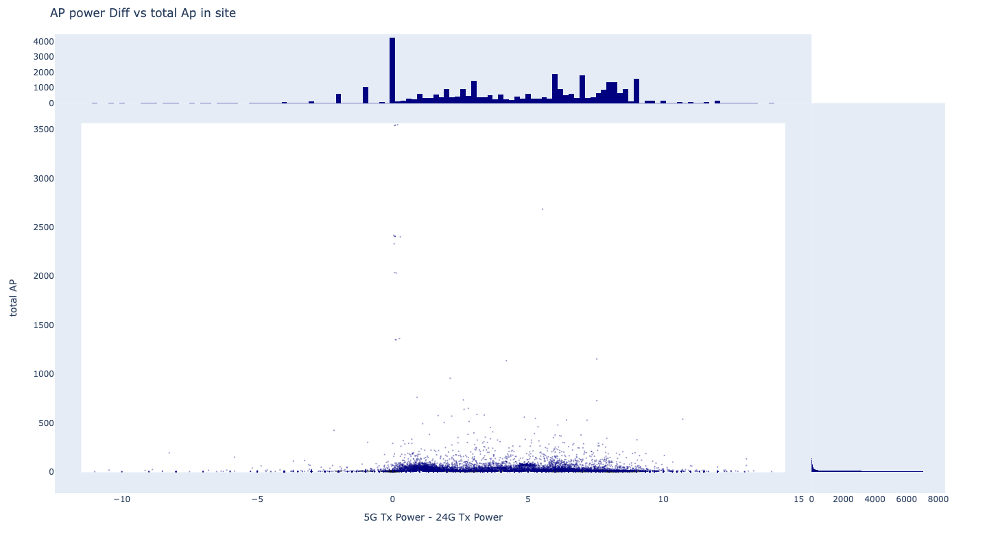

In [15]:
%%local
import plotly as py
import plotly.figure_factory as ff

import numpy as np

x = df_ap_power_diff["avg_power_diff"]
y = df_ap_power_diff["total_ap"]


fig = ff.create_2d_density( x, y)
fig.update_layout(height=800, width=1000)
fig.update_layout(
    title = "AP power Diff vs total Ap in site",
    xaxis_title="5G Tx Power - 24G Tx Power",
    yaxis_title="total AP"
)
#fig.update_xaxes(range=(-5, 20))
#fig.update_yaxes(range=(-5, 20))
fig.show()


In [18]:
%%local
df_ap_power_diff[(df_ap_power_diff["avg_power_diff"]>10) & (df_ap_power_diff["total_ap"]>=5)].head(20)

Output()

In [23]:
%%local
temp  = df_ap_power_diff[(df_ap_power_diff["avg_power_diff"]>3) & (df_ap_power_diff["avg_power_diff"]<5) & (df_ap_power_diff["total_ap"]>=5) & (df_ap_power_diff["total_ap"]<500)][["site_id","org_id"]]
temp["id"]  = temp["org_id"] + ", " + temp["site_id"]
len(temp)

2220

## AP Scan Data

In [11]:
date= "2021-12-25"
hr = "14"
df_ap_scan = spark.read.orc("s3://mist-secorapp-production/cv-ap-scans-multipartition/cv-ap-scans-multipartition-production/dt={}/hr={}".format(date,hr)).persist()
df_ap_scan.show(3)    

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+------------+----+-------+-------+--------------------+-----+--------------------+-------------------+-------------+
|          ap|         ap2|band|channel|in_site|                 org| rssi|                site|               time|radio_channel|
+------------+------------+----+-------+-------+--------------------+-----+--------------------+-------------------+-------------+
|5c5b35d15eeb|5c5b35d16fbc|  24|      1|   true|38a18d4d-1623-498...|-62.0|194ea04d-4dc9-4d9...|2021-12-25 14:12:30|           11|
|5c5b35d15eeb|            |  24|     11|  false|38a18d4d-1623-498...|-67.0|194ea04d-4dc9-4d9...|2021-12-25 14:12:30|           11|
|5c5b353e1ab3|5c5b353e1a86|  24|      6|   true|d8cec22e-e0c2-11e...|-74.0|f7717d51-7619-40c...|2021-12-25 14:12:30|           11|
+------------+------------+----+-------+-------+--------------------+-----+--------------------+-------------------+-------------+
only showing top 3 rows

In [ ]:
df_ap_scan.unpersist()

In [12]:
df_ap_scan_count = df_ap_scan.filter(F.col("ap2").isNotNull()).groupby("band","rssi").agg(F.count("time").alias("event_count"),\
                                                                                         F.countDistinct("ap2").alias("ap2_count"))
df_ap_scan_count.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

196

In [13]:
%%spark -o df_ap_scan_count -n 196

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

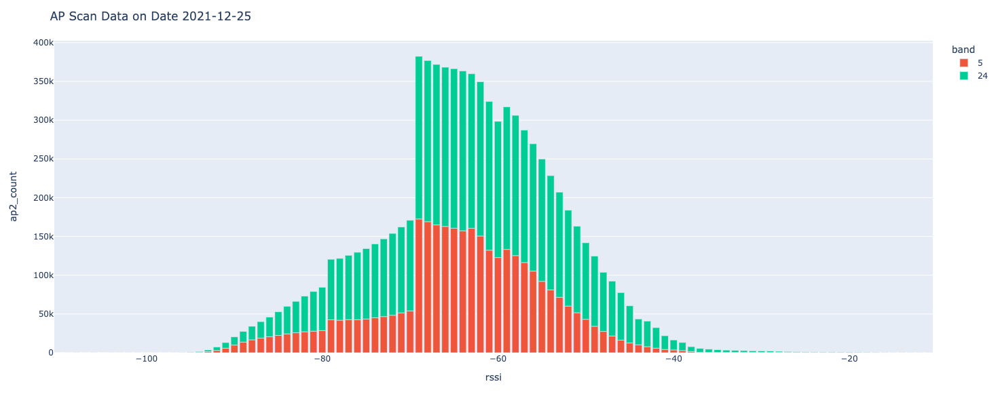

In [14]:
%%local
date= "2021-12-25"
df_ap_scan_count["band"] = df_ap_scan_count["band"].apply(str)
fig = px.bar(df_ap_scan_count,x="rssi",y="ap2_count",color="band",category_orders={"band":["6","5","24"]})
fig.update_layout(title = "AP Scan Data on Date {}".format(date),height=600, width=800)
fig.show()

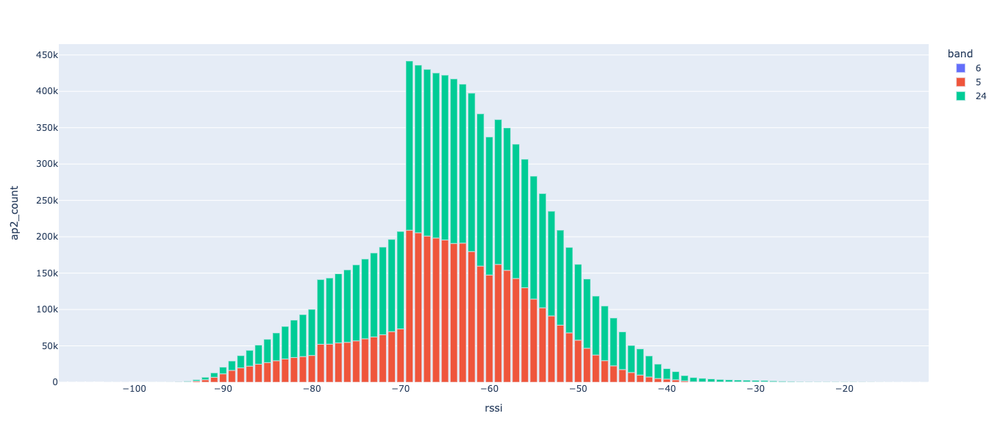

In [19]:
%%local
# dt = 2022-03-24
df_ap_scan_count["band"] = df_ap_scan_count["band"].apply(str)
fig = px.bar(df_ap_scan_count,x="rssi",y="ap2_count",color="band")
fig.update_layout(height=600, width=800)
fig.show()

In [20]:
# Ap count
df_ap_count = df_ap_scan.filter(F.col("ap2").isNotNull()).groupby("band","ap").agg(F.countDistinct("ap2").alias("ap2_count"))\
                        .groupby("band","ap2_count").agg(F.countDistinct("ap").alias("ap_count"))
df_ap_count.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

383

In [21]:
%%spark -o df_ap_count

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

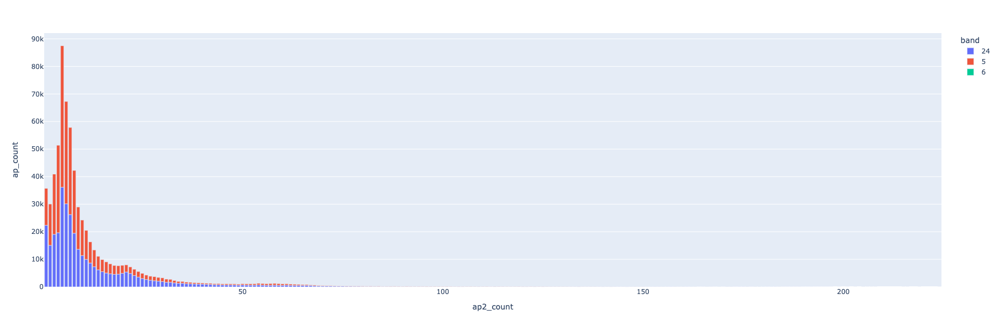

In [24]:
%%local
df_ap_count["band"] = df_ap_count["band"].apply(str)
fig = px.bar(df_ap_count,x="ap2_count",y="ap_count",color="band")
fig.update_layout(height=600, width=800)
fig.show()

## Client Stats

In [27]:
ids = [["efb13699-a0de-4326-866c-e13a2c9bd26b", "dc797fd6-165f-4c46-8165-32f4555dfe75"],
                            ["a7cc1161-cb41-4e5d-aa41-118a1f06cd12", "d3cc54ce-1a86-4b60-b825-14eda077bb04"],
                            ["bd71930f-36c8-4836-851e-825dd4998e29", "b39dd655-6d59-4050-8aca-c6985276e8df"],
                            ["efb13699-a0de-4326-866c-e13a2c9bd26b", "dc797fd6-165f-4c46-8165-32f4555dfe75"],
                            ["4f7ce014-2148-4d41-88f0-07c9c2e6f16c", "ead220ac-87bf-49b6-8e3a-3313411a8de6"],
                            ["2af29430-f6b8-11e5-92c2-02e208b2d34f", "96488ea8-6dee-11e6-a43a-02e208b2d34f"],
                            ["432b9aee-9d41-4634-bad3-d7ce104f629f", "8d7522ea-d5f7-4d3d-aff6-77f0af860d0b"],
                            ["b4f71ea9-1c74-4b6f-902c-34dc72ca5c68", "8193a948-71d9-419e-865c-586fc5732c4b"],
                            ["8b607816-eaad-4522-ad03-aa82fea79280", "8bb1c0c6-3e75-4962-a940-560a22835392"],
                            ["b4f71ea9-1c74-4b6f-902c-34dc72ca5c68", "8d365b0a-4333-449b-acc3-8a5ea0946305"],
                            ["bd71930f-36c8-4836-851e-825dd4998e29", "57500609-8a68-4a42-8492-4df2c359fbae"],
                            ["64119cae-ef76-4aee-b844-a467644895c8", "93cc6a85-de26-4259-8f35-e5f0e2929625"],
                            ["a7cc1161-cb41-4e5d-aa41-118a1f06cd12", "8d85f812-d04b-4d17-a552-0d4ad900bb16"],
                            ["a7cc1161-cb41-4e5d-aa41-118a1f06cd12", "6f9794da-2c41-4885-8c08-6ee49f44e3d5"],
                            ["16f9ab0f-979f-4c40-974d-f6c3c180ca27", "a6e4a15f-9983-4ac4-b738-bf2b4df75a98"],
                            ["efb13699-a0de-4326-866c-e13a2c9bd26b", "e0a323ed-6353-47d7-92bb-e7ce57873ba5"],
                            ["dadba6a6-aa00-4edf-894e-22de0feaca15", "0f50b360-12f3-43ab-baf9-e4de1f1b03ea"],
                            ["0b5e43fd-7ca6-4012-89a7-728dd5d91f9d", "b4959e89-4de8-4308-a00f-c9ac87a285d9"],
                            ["b4f71ea9-1c74-4b6f-902c-34dc72ca5c68", "327b06d1-786f-4bc5-9176-8acbfd5f4e0c"],
                            ["4f7ce014-2148-4d41-88f0-07c9c2e6f16c", "c842a348-b9a6-4dec-b094-dc51fd51f98a"],
                            ["efb13699-a0de-4326-866c-e13a2c9bd26b", "6dc3710d-ab72-47c8-884c-2ff3619090f3"],
                            ["e6c88168-b2ba-4a67-b071-a6494095532e", "30b46689-f08d-46b5-894b-8260be6732ce"],
                            ["2323871a-e304-4eed-be5d-7325eb0ea7ce", "729082b5-8e67-471a-b874-cb4d8124202f"],
                            ["efb13699-a0de-4326-866c-e13a2c9bd26b", "25c16877-561a-4218-8eba-665503783314"],
                            ["a7cc1161-cb41-4e5d-aa41-118a1f06cd12", "623d5371-d272-4256-bea4-e7ad47e6d23f"],
                            ["ee3e78c4-5dd0-4ad4-bc10-4b4f414e4213", "42beee71-4040-474c-9352-f6c4b0662fea"],
                            ["e6c88168-b2ba-4a67-b071-a6494095532e", "995706e9-36ef-49ea-9463-dd3b7d93ce1e"]]

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [28]:
site_ids = []
for i in ids:
    site_ids.append(i[1])

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [29]:
df = spark.read.parquet("s3://mist-secorapp-production/client-stats-analytics/client-stats-analytics-production/dt=2022-03-24/hr=*/*")\
                .filter(F.col("site_id").isin(site_ids)).persist()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [30]:
df_client_rssi = df.groupby("client_band","client_rssi").agg(F.countDistinct("when").alias("event_count"))
#df_client_rssi.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [31]:
%%spark -o df_client_rssi

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

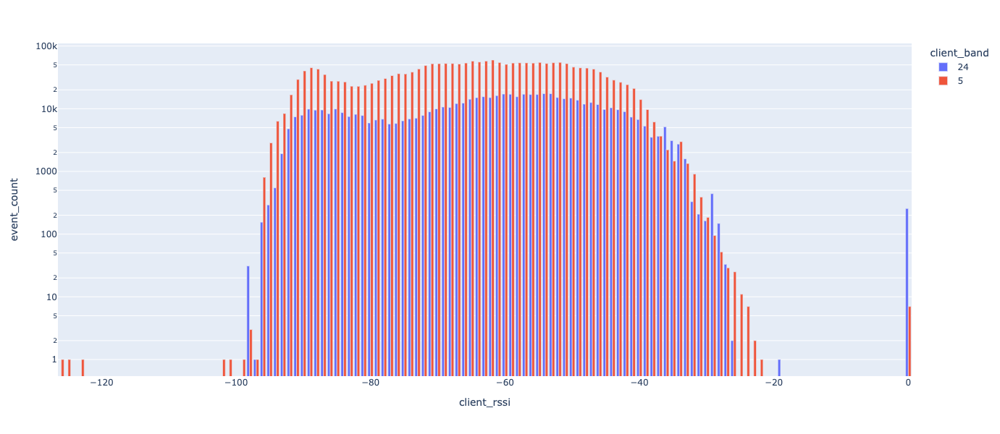

In [32]:
%%local
## selected site( site with power delta more than 10)
df_client_rssi["client_band"] = df_client_rssi["client_band"].apply(str)
fig = px.bar(df_client_rssi,x="client_rssi",y="event_count",color="client_band",barmode="group",log_y=True)
fig.update_layout(height=600, width=800)
fig.show()

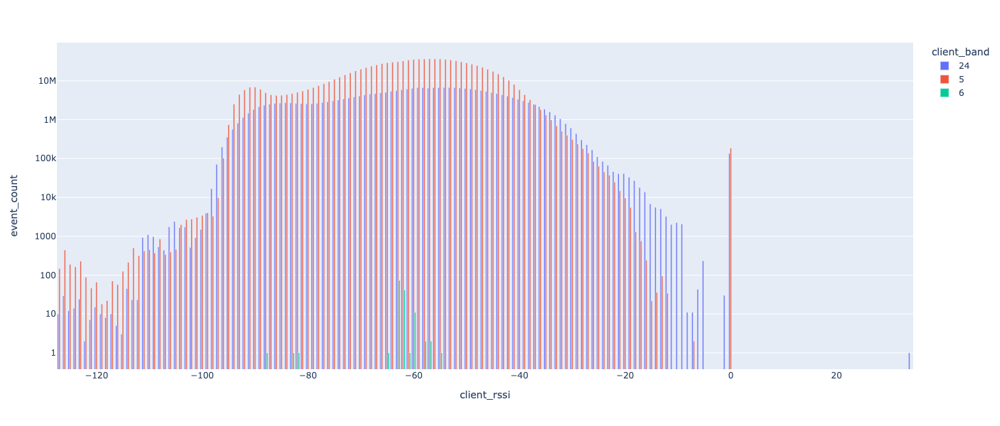

In [26]:
%%local
df_client_rssi["client_band"] = df_client_rssi["client_band"].apply(str)
fig = px.bar(df_client_rssi,x="client_rssi",y="event_count",color="client_band",barmode="group",log_y=True)
fig.update_layout(height=600, width=800)
fig.show()

# Amazon Black Hole AP Analysis (Pace Event)

AP stats done in staging notebook

## AP Scan Data

In [3]:
# (F.col("ap")=="5c5b353e9015")
date = "2022-03-28"
hr = "*"
df_ap_scan = spark.read.orc("s3://mist-secorapp-production/cv-ap-scans-multipartition/cv-ap-scans-multipartition-production/dt={}/hr={}".format(date,hr))\
                .filter((F.col("ap")=="5c5b353e8ff7"))\
                .filter((F.col("ap2")!="")).persist()
df_ap_scan.show(truncate=False)

The code failed because of a fatal error:
	Session 773 did not start up in 60 seconds..

Some things to try:
a) Make sure Spark has enough available resources for Jupyter to create a Spark context.
b) Contact your Jupyter administrator to make sure the Spark magics library is configured correctly.
c) Restart the kernel.


In [7]:
df_ap_scan.groupby("ap","band","channel","ap2").agg(F.mean("rssi").alias("avg_rssi")).sort(F.desc("avg_rssi")).show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+----+-------+------------+-------------------+
|ap          |band|channel|ap2         |avg_rssi           |
+------------+----+-------+------------+-------------------+
|5c5b353e8ff7|24  |6      |5c5b353e9029|-57.44599303135889 |
|5c5b353e8ff7|5   |60     |5c5b353e9029|-57.98606271777003 |
|5c5b353e8ff7|24  |11     |5c5b353e8fed|-58.850174216027874|
|5c5b353e8ff7|5   |44     |5c5b353e8fed|-59.18815331010453 |
|5c5b353e8ff7|24  |11     |5c5b353ec39b|-59.91289198606272 |
|5c5b353e8ff7|24  |6      |5c5b353e90c9|-60.42508710801394 |
|5c5b353e8ff7|24  |1      |5c5b353e9015|-60.98954703832753 |
|5c5b353e8ff7|5   |48     |5c5b353e90c9|-61.9198606271777  |
|5c5b353e8ff7|24  |11     |5c5b353ec31e|-62.00696864111498 |
|5c5b353e8ff7|5   |64     |5c5b353ec39b|-63.801393728223   |
|5c5b353e8ff7|24  |1      |5c5b353e9038|-64.34843205574913 |
|5c5b353e8ff7|5   |56     |5c5b353e8fde|-64.61538461538461 |
|5c5b353e8ff7|5   |157    |5c5b353ec27e|-64.68989547038328 |
|5c5b353e8ff7|24  |1    

In [8]:
df_neighbor = df_ap_scan.groupby("ap","band","radio_channel","ap2").agg(F.mean("rssi").alias("avg_rssi"))
df_neighbor.sort(F.desc("avg_rssi")).show(truncate=False)

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+----+-------------+------------+-------------------+
|ap          |band|radio_channel|ap2         |avg_rssi           |
+------------+----+-------------+------------+-------------------+
|5c5b353e8ff7|5   |153          |5c5b353e9029|-56.333333333333336|
|5c5b353e8ff7|5   |0            |5c5b353e8fed|-57.10344827586207 |
|5c5b353e8ff7|24  |1            |5c5b353e9029|-57.44599303135889 |
|5c5b353e8ff7|5   |52           |5c5b353e9029|-57.95348837209303 |
|5c5b353e8ff7|5   |36           |5c5b353e9029|-57.968503937007874|
|5c5b353e8ff7|5   |0            |5c5b353e9029|-58.59770114942529 |
|5c5b353e8ff7|24  |1            |5c5b353e8fed|-58.850174216027874|
|5c5b353e8ff7|5   |36           |5c5b353e8fed|-59.653543307086615|
|5c5b353e8ff7|24  |1            |5c5b353ec39b|-59.91289198606272 |
|5c5b353e8ff7|5   |52           |5c5b353e8fed|-60.23255813953488 |
|5c5b353e8ff7|24  |1            |5c5b353e90c9|-60.42508710801394 |
|5c5b353e8ff7|24  |1            |5c5b353e9015|-60.989547038327

In [14]:
df_ap_scan.count()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

61100

In [26]:
%%spark -o df_ap_scan -n 6711

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

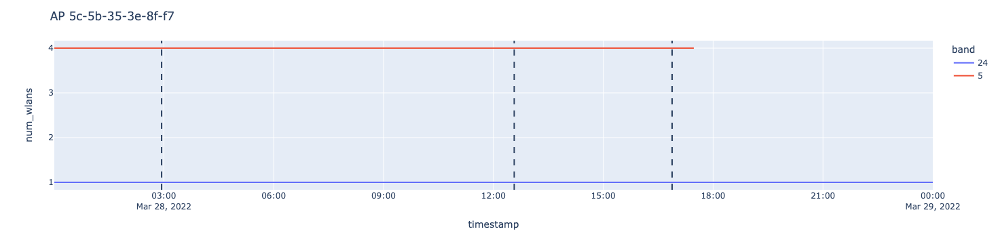

In [15]:
%%local
ap = "5c-5b-35-3e-8f-f7"
fig = px.line(df_ap[df_ap["id"]==ap],x="timestamp",y="num_wlans",color="band")
fig.add_vline(x="2022-03-28 16:52:50", line_dash="dash")
fig.add_vline(x="2022-03-28 12:34:06", line_dash="dash")
fig.add_vline(x="2022-03-28 02:56:22", line_dash="dash")
fig.update_layout(title = "AP {}".format(ap))
fig.show()
# ------------+----+-------+-----------+---------------+---------------+---------+---------+-----+-----------+----------+-------------------+
# |       ap_id|band|channel|rrm_channel|        command|         reason|max_power|min_power|power|source_data| timestamp|               when|
# +------------+----+-------+-----------+---------------+---------------+---------+---------+-----+-----------+----------+-------------------+
# |5c5b353e8ff7|   5|     52|         52|acs-request-api|acs-request-api|     null|     null|   17| random.acs|1648486370|2022-03-28 16:52:50|
# |5c5b353e8ff7|   5|     52|         52|acs-request-api|acs-request-api|     null|     null|    9| random.acs|1648470846|2022-03-28 12:34:06|
# |5c5b353e8ff7|   5|     36|         36|     rrm-global| rrmG-scheduled|       17|        8|   10|  cassandra|1648436182|2022-03-28 02:56:22|
# +------------+----+-------+-----------+---------------+---------------+---------+---------+-----+-----------+----------+-------------------+

In [23]:
input_files = "s3://mist-secorapp-production/ep-pace-event/ep-pace-event-production/dt=2022-03-28/hr=1*/*.seq"
aps = ["5c5b353e8ff7"]
data_rdd = spark.sparkContext.sequenceFile(input_files).map(lambda r: json.loads(r[1])).filter(lambda r: "Topics"in r and "client-pace-event-"in r["Topics"]).map(lambda r: extract(r)).filter(lambda r: r["AP"] in aps)
df_ap_pace= spark.createDataFrame(data_rdd).persist()
df_ap_pace.show()
            

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

An error was encountered:
An error occurred while calling z:org.apache.spark.api.python.PythonRDD.runJob.
: org.apache.spark.SparkException: Job 30 cancelled 
	at org.apache.spark.scheduler.DAGScheduler.failJobAndIndependentStages(DAGScheduler.scala:2470)
	at org.apache.spark.scheduler.DAGScheduler.handleJobCancellation(DAGScheduler.scala:2366)
	at org.apache.spark.scheduler.DAGSchedulerEventProcessLoop.doOnReceive(DAGScheduler.scala:2643)
	at org.apache.spark.scheduler.DAGSchedulerEventProcessLoop.onReceive(DAGScheduler.scala:2626)
	at org.apache.spark.scheduler.DAGSchedulerEventProcessLoop.onReceive(DAGScheduler.scala:2615)
	at org.apache.spark.util.EventLoop$$anon$1.run(EventLoop.scala:49)
	at org.apache.spark.scheduler.DAGScheduler.runJob(DAGScheduler.scala:914)
	at org.apache.spark.SparkContext.runJob(SparkContext.scala:2241)
	at org.apache.spark.SparkContext.runJob(SparkContext.scala:2262)
	at org.apache.spark.SparkContext.runJob(SparkContext.scala:2281)
	at org.apache.spark.api.

In [26]:
df_ap_stats.unpersist()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

DataFrame[id: string, site_id: string, org_id: string, firmware_version: string, model: string, uptime: int, interval: bigint, config_time: bigint, when: bigint, total_client_count: int, active_client_count: int, terminator_remote_addr: string, terminator_timestamp: bigint, dnsServers: array<string>, svis: array<struct<dev:string,vlan:int,ips:array<string>>>, inactive_wired_vlans: array<int>, IPv4Routers: array<struct<dest:string,gateway:string>>, dhcpclients: array<struct<dev:string,ip:string,gateway:string>>, l2tptunnels: array<struct<id:string,state:string,router_id:int,uptime:int,local_connection_id:int,remote_connection_id:int,tx_control_pkts:int,rx_control_pkts:int,sessions:array<struct<dev:string,remote_end_id:string,state:string,local_session_id:int,remote_session_id:int>>,outer_pmtu:int,last_stop_ccnresult:struct<code:int,err_code:int,err_msg:string,when:bigint>,last_peer_stop_ccnresult:struct<code:int,err_code:int,err_msg:string,when:bigint>,peer_mist_id:string,peer_mist_org_

## AP Stats

In [4]:
env = "production"
s3_bucket = "s3://mist-secorapp-{env}/ap-stats-analytics/ap-stats-analytics-{env}/".format(env=env)
s3_bucket += "dt=2022-03-28/hr=*/*.parquet"

df_ap_stats= spark.read.parquet(s3_bucket).filter((F.col("id")=="5c-5b-35-3e-8f-f7")).persist()

The code failed because of a fatal error:
	Session 773 did not start up in 60 seconds..

Some things to try:
a) Make sure Spark has enough available resources for Jupyter to create a Spark context.
b) Contact your Jupyter administrator to make sure the Spark magics library is configured correctly.
c) Restart the kernel.


In [5]:
df_stats = df_ap_stats.withColumn("radios",F.explode("radios"))\
            .filter("radios.dev != 'r2'")\
            .filter(F.col("id")=="5c-5b-35-3e-8f-f7")\
            .select("id","radios.band","radios.channel","radios.bandwidth","radios.noise_floor","radios.max_tx_power","radios.num_active_clients",\
                    "radios.tx_phy_err","radios.utilization_all","radios.utilization_tx","radios.utilization_unknown_wifi",
                    "radios.utilization_non_wifi","radios.utilization_unknown_wifi","radios.tx_retried","radios.tx_retries","radios.rx_dups",\
                    F.from_unixtime(F.col("when")/1_000_000).alias("when"))
df_stats.count()

The code failed because of a fatal error:
	Session 773 did not start up in 60 seconds..

Some things to try:
a) Make sure Spark has enough available resources for Jupyter to create a Spark context.
b) Contact your Jupyter administrator to make sure the Spark magics library is configured correctly.
c) Restart the kernel.


In [35]:
%%spark -o df_stats -n 2385

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

## RRM Local Event

In [16]:
df_rrm.unpersist()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

DataFrame[allow_rrm_disable: boolean, ap_capacity: double, ap_id: string, audit_id: string, band: string, bandwidth: bigint, channel: bigint, channels: array<bigint>, command: string, disabled: boolean, max_power: bigint, min_power: bigint, org_id: string, power: bigint, pre_bandwidth: bigint, pre_channel: bigint, pre_power: bigint, pre_usage: string, prev_rf_overlap: double, rad_id: string, reason: string, rf_overlap: double, rrm_bandwidth: bigint, rrm_channel: bigint, rrm_enabled: boolean, rrm_power: bigint, rrm_usage: string, site_id: string, source_data: string, timestamp: bigint, update_bandwidth: boolean, update_channel: boolean, update_power: boolean, update_usage: boolean, updated: boolean, usage: string, weights: map<string,double>, when: string]

In [3]:
date = "2022-03-2*"
rrm_local = "s3://mist-secorapp-production/rrm-local/rrm-local-production/dt={}/*/*.seq".format(date)
rrm_local_rdd = spark.sparkContext.sequenceFile(rrm_local).map(lambda r: json.loads(r[1])).filter(lambda x: x["site_id"]=="5158ff30-c3ae-4654-a924-bd32f3f8339b")
                                                                                                
df_rrm= spark.createDataFrame(rrm_local_rdd).persist()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [12]:
df_rrm.filter((F.col("ap_id")=="5c5b353e8ff7") | (F.col("ap_id")=="5c-5b-35-3e-8f-f7")).select("ap_id","band","channel","rrm_channel","pre_channel","command",\
                                    "reason","max_power","min_power","power","source_data","timestamp",F.to_timestamp("timestamp").alias("when"))\
            .sort(F.desc("when")).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+-----------------+----+-------+-----------+-----------+-----------------+-----------------+---------+---------+-----+----------------+----------+-------------------+
|            ap_id|band|channel|rrm_channel|pre_channel|          command|           reason|max_power|min_power|power|     source_data| timestamp|               when|
+-----------------+----+-------+-----------+-----------+-----------------+-----------------+---------+---------+-----+----------------+----------+-------------------+
|     5c5b353e8ff7|   5|     52|         52|        153|  acs-request-api|  acs-request-api|     null|     null|   17|      random.acs|1648486370|2022-03-28 16:52:50|
|5c-5b-35-3e-8f-f7|   5|    153|        153|         52|acs-request-cache|acs-request-cache|     null|     null|    8|impacted-by-site|1648474607|2022-03-28 13:36:47|
|     5c5b353e8ff7|   5|     52|         52|         36|  acs-request-api|  acs-request-api|     null|     null|    9|      random.acs|1648470846|2022-03-28 12:34:06

In [13]:
df_rrm.filter((F.col("ap_id")=="5c5b353e9015") | (F.col("ap_id")=="5c-5b-35-3e-90-15")).select("ap_id","band","channel","rrm_channel","pre_channel","command",\
            "reason","max_power","min_power","power","source_data","timestamp",F.to_timestamp("timestamp").alias("when"))\
            .sort(F.desc("when")).show()


FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+----+-------+-----------+-----------+---------------+---------------+---------+---------+-----+-----------+----------+-------------------+
|       ap_id|band|channel|rrm_channel|pre_channel|        command|         reason|max_power|min_power|power|source_data| timestamp|               when|
+------------+----+-------+-----------+-----------+---------------+---------------+---------+---------+-----+-----------+----------+-------------------+
|5c5b353e9015|   5|     52|         52|         40|acs-request-api|acs-request-api|     null|     null|   17| random.acs|1648398537|2022-03-27 16:28:57|
|5c5b353e9015|   5|     36|         36|         36|     rrm-global| rrmG-scheduled|       17|        8|    9|           |1648177049|2022-03-25 02:57:29|
|5c5b353e9015|   5|     36|         36|         36|     rrm-global| rrmG-scheduled|       17|        8|   10|           |1648089493|2022-03-24 02:38:13|
|5c5b353e9015|   5|     36|         36|         36|     rrm-global| rrmG-scheduled

In [34]:
fields = ["ap_id","event_type","org_id","site_id","source","wc_id"]
def select(x):
    op = {}
    for f in fields:
        if f in x:
            op[f] = x.get(f)
    return op
        

env = "production"
dt="2022-04-06"
hr="00"
s3_gs_bucket = 's3://mist-secorapp-{env}/client-events/client-events-{env}'.format(env=env)
s3_gs_bucket += '/dt={dt}/hr={hr}/*.seq'.format(dt=dt, hr=hr)
data_rdd= spark.sparkContext.sequenceFile(s3_gs_bucket).map(lambda r: select(r))
df_ce = spark.createDataFrame(data_rdd).persist()
df_ce.show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

An error was encountered:
The first row in RDD is empty, can not infer schema
Traceback (most recent call last):
  File "/usr/lib/spark/python/lib/pyspark.zip/pyspark/sql/session.py", line 675, in createDataFrame
    return self._create_dataframe(data, schema, samplingRatio, verifySchema)
  File "/usr/lib/spark/python/lib/pyspark.zip/pyspark/sql/session.py", line 698, in _create_dataframe
    rdd, schema = self._createFromRDD(data.map(prepare), schema, samplingRatio)
  File "/usr/lib/spark/python/lib/pyspark.zip/pyspark/sql/session.py", line 486, in _createFromRDD
    struct = self._inferSchema(rdd, samplingRatio, names=schema)
  File "/usr/lib/spark/python/lib/pyspark.zip/pyspark/sql/session.py", line 462, in _inferSchema
    raise ValueError("The first row in RDD is empty, "
ValueError: The first row in RDD is empty, can not infer schema



In [39]:
data_rdd = sc.sequenceFile(s3_gs_bucket).map(lambda x: json.loads(x[1]))\
                                .filter(lambda x: x['event_type'] == 'sticky-client') \
                                .filter(lambda x: x['sticky'] == True)
df_ce = spark.createDataFrame(data_rdd).persist()
df_ce.show()

An error was encountered:
Session 826 unexpectedly reached final status 'dead'. See logs:
stdout: 
#
# java.lang.OutOfMemoryError: Java heap space
# -XX:OnOutOfMemoryError="kill -9 %p"
#   Executing /bin/sh -c "kill -9 28299"...

stderr: 
22/04/07 17:52:18 INFO BlockManagerInfo: Added taskresult_152 in memory on ip-172-31-23-170.us-west-1.compute.internal:42013 (size: 1346.2 KiB, free: 564.8 MiB)
22/04/07 17:52:18 INFO TaskSetManager: Finished task 55.0 in stage 29.0 (TID 152) in 7691 ms on ip-172-31-23-170.us-west-1.compute.internal (executor 108) (58/66)
22/04/07 17:52:18 INFO BlockManagerInfo: Removed taskresult_152 on ip-172-31-23-170.us-west-1.compute.internal:42013 in memory (size: 1346.2 KiB, free: 566.2 MiB)
22/04/07 17:52:18 INFO BlockManagerInfo: Added taskresult_158 in memory on ip-172-31-23-170.us-west-1.compute.internal:35461 (size: 1535.9 KiB, free: 86.9 MiB)
22/04/07 17:52:18 INFO BlockManagerInfo: Added taskresult_157 in memory on ip-172-31-23-170.us-west-1.compute.inte

In [ ]:
a =df.collect()

In [30]:
df_ce.filter(F.col("event_type")=="sticky-client").show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

+------------+-------------+--------------------+--------------------+--------------------+--------------------+
|       ap_id|   event_type|              org_id|             site_id|              source|               wc_id|
+------------+-------------+--------------------+--------------------+--------------------+--------------------+
|d4dc09af3f75|sticky-client|4f7ce014-2148-4d4...|4086def7-1f92-4f3...|{When -> null, Ro...|3d7c4e99-3b8f-57c...|
|d4dc0924c7e3|sticky-client|758a1f7f-6d65-4d8...|6da5a8aa-2a5e-4f3...|{When -> null, As...|d1429edd-39a9-8a4...|
|d420b080283c|sticky-client|4f7ce014-2148-4d4...|3b78b324-757c-4bc...|{When -> null, Ro...|12cbc5f1-2cee-a7c...|
|d4dc09aeec46|sticky-client|4f7ce014-2148-4d4...|e5431d3f-662e-477...|{When -> null, Ro...|50f696d3-898c-2db...|
|d4dc09af3fde|sticky-client|4f7ce014-2148-4d4...|a550aa4e-9ee3-465...|{When -> null, As...|5574115f-ce04-104...|
|ac23160da5f7|sticky-client|71c7a9d9-0670-49a...|71c14800-c233-436...|{When -> null, Ro...|bf173

In [31]:
a = df_ce.filter((F.col("event_type")=="sticky-client")).limit(3).collect()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

In [24]:
a[0]

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

Row(ap_id='d4dc09af3f75', event_type='sticky-client', org_id='4f7ce014-2148-4d41-88f0-07c9c2e6f16c', site_id='4086def7-1f92-4f37-abce-79575bfbd54d', source={'When': None, 'RoamCandidates': None, 'Assoc': None, 'WC': None, 'Version': 3, 'Sticky': None}, timestamp=1649203200014000, wc_id='3d7c4e99-3b8f-57c6-4b5e-50babff517a0', wland_id='86471a69-ebf4-4410-aab3-62ddeeea38d9')

In [25]:
df_ce.filter((F.col("event_type")=="sticky-client") & (F.col(F.col("Sticky").isNotNon))).show()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

An error was encountered:
invalid syntax (<stdin>, line 1)
  File "<stdin>", line 1
    df_ce.filter((F.col("event_type")=="sticky-client") 7(F.col())).show()
                                                        ^
SyntaxError: invalid syntax

